# Sequential Feed Forward Neural Network for MNIST

Batch Normalization helps to keep neuron away from saturation

In [ ]:
from tensorflow.keras.datasets import mnist
import matplotlib.pyplot as plt
import tensorflow.keras as keras 
from tensorflow.keras.models import Sequential 
from tensorflow.keras.layers import Dense 
import matplotlib.image as mpimg
from tensorflow.keras.preprocessing import image as image_utils
import numpy as np  
import tensorflow as tf

In [ ]:
(x_train, y_train),(x_val, y_val) = mnist.load_data() 
print(x_train.shape,x_val.shape)   # 60000 and 10000 samples with 28 * 28 dimension images

11501568/11490434 [==============================] - 0s 0us/step
(60000, 28, 28) (10000, 28, 28)


In [ ]:
print(x_train.dtype)
x_train.min()

uint8


0

In [ ]:
x_train.max()

255

In [ ]:
x_train[0]
y_train[0]

5

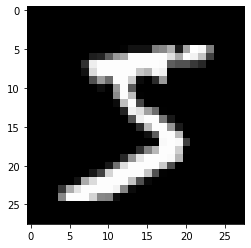

In [ ]:
img = x_train[0]
plt.imshow(img, cmap = 'gray')

Preparing Data for training

In [ ]:
# Flatten to get 1d array for a particular image
x_train = x_train.reshape(60000,784)     # 28 x 28 = 784
x_val = x_val.reshape(10000,784)
x_train.shape

(60000, 784)

In [ ]:
# Normalize the image  <--
x_train = x_train/255   # x - x.min/x.max - x.min == x - 0/255-0 = x/255
x_val = x_val/255 
x_train.dtype

dtype('float64')

In [ ]:
# Now we need to classify the input as number from 0 to 9. So lets do categorical encoding for the output. Here lets do OneHotencoding
num_categories = 10
y_train = keras.utils.to_categorical(y_train, num_categories)
y_val = keras.utils.to_categorical(y_val, num_categories)
y_train[0]

array([0., 0., 0., 0., 0., 1., 0., 0., 0., 0.], dtype=float32)

In [ ]:
y_train[0:3]   # Remember y_train[0] was 5 and so 

array([[0., 0., 0., 0., 0., 1., 0., 0., 0., 0.],
       [1., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 1., 0., 0., 0., 0., 0.]], dtype=float32)

Create a Model

In [ ]:
model = Sequential()
model.add(Dense(units = 784, activation = 'relu', input_shape = (784,)))   # input layer

#Hidden Layer
model.add(Dense(units = 784, activation = 'relu'))
model.add(Dense(units = 784, activation = 'relu'))
model.add(Dense(units = 784, activation = 'relu'))

# Output Layer
model.add(Dense(units = 10, activation = 'softmax'))   # Gives the output of a number which it predicts to be with highest probability

model.summary()


Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 784)               615440    
                                                                 
 dense_1 (Dense)             (None, 784)               615440    
                                                                 
 dense_2 (Dense)             (None, 784)               615440    
                                                                 
 dense_3 (Dense)             (None, 784)               615440    
                                                                 
 dense_4 (Dense)             (None, 10)                7850      
                                                                 
Total params: 2,469,610
Trainable params: 2,469,610
Non-trainable params: 0
_________________________________________________________________


In [ ]:
!pip install visualkeras
!pip install ImageFont
import visualkeras
from PIL import ImageFont
font = ImageFont.truetype("arial.ttf", 28, encoding="unic")

visualkeras.layered_view(model).show() # display using your system viewer
visualkeras.layered_view(model, to_file='output.png') # write to disk
visualkeras.layered_view(model, to_file='output.png').show() # write and show

visualkeras.layered_view(model, legend=True, font=font, draw_volume=False)

In [ ]:
!pip install ann_visualizer
from ann_visualizer.visualize import ann_viz;
ann_viz(model, title="My first neural network")

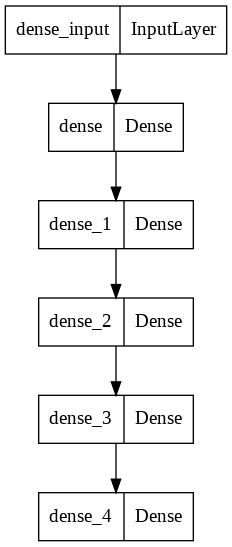

In [ ]:
tf.keras.utils.plot_model(model)

In [ ]:
model.compile(loss = 'categorical_crossentropy', metrics = ['accuracy'])
model.fit(x_train, y_train, epochs = 10, verbose = 1, validation_data = (x_val,y_val)) 

Epoch 1/10
 218/1875 [==>...........................] - ETA: 1:21 - loss: 0.6057 - accuracy: 0.8103

KeyboardInterrupt: ignored

We find the model is able to generalise well. So out model is ready

In [ ]:
model.save('mnist_model')
model2 = keras.models.load_model('mnist_model')

In [ ]:
model2.summary()

In [ ]:
image_path = '/content/7.png'
image = mpimg.imread('/content/7.png')
plt.imshow(image,cmap = 'gray')

In [ ]:
image.shape  # The image dimensions are 225  x 225 but my model is trained on images 25 x 25. So i reshape my image

In [ ]:
image = image_utils.load_img(image_path,color_mode = 'grayscale', target_size = (28,28))
plt.imshow(image,cmap = 'gray')

In [ ]:
type(image)

In [ ]:
# Convert the image to array 
image = image_utils.img_to_array(image)
# Reshape the image
image = image.reshape(1,784)
# Normalise the image <----
image = image/255
prediction = model.predict(image)
print(prediction)    # Shows the probability of each number it thinks the image is.

In [ ]:
np.argmax(prediction)

# Sequential Feed Forward Neural Network for Fashion MNIST with Data Augmentation and CNN for feature extraction

In [ ]:
from tensorflow.keras.datasets import fashion_mnist
import matplotlib.pyplot as plt
import tensorflow.keras as keras
from tensorflow.keras.models import Sequential 
from tensorflow.keras.layers import Dense

In [ ]:
(x_train, y_train),(x_val , y_val) = fashion_mnist.load_data()
print(x_train.shape, x_val.shape)

(60000, 28, 28) (10000, 28, 28)


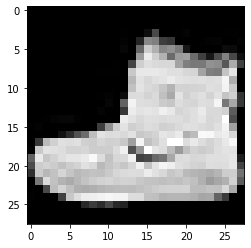

In [ ]:
image = x_train[0]
plt.imshow(image, cmap = 'gray')

In [ ]:
y_train[0]

9

In [ ]:
x_train = x_train.reshape(60000, 784)
x_val = x_val.reshape(10000, 784)
x_train.shape

(60000, 784)

In [ ]:
x_train.min()

0

In [ ]:
x_train.max()

255

In [ ]:
x_train = x_train/255
x_val = x_val/255
x_train.dtype

dtype('float64')

In [ ]:
x_val.max()

1.0

In [ ]:
num_categories = 10
y_train = keras.utils.to_categorical(y_train, num_categories)
y_val = keras.utils.to_categorical(y_val, num_categories)
y_train[0]

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 1.], dtype=float32)

In [ ]:
model = Sequential()
model.add(Dense(units = '784', activation = 'relu', input_shape = (784,)))

model.add(Dense(units = '784', activation = 'relu'))
model.add(Dense(units = '784', activation = 'relu'))
model.add(Dense(units = '784', activation = 'relu'))
model.add(Dense(units = '784', activation = 'relu'))
model.add(Dense(units = '784', activation = 'relu'))
model.add(Dense(units = '784', activation = 'relu'))
model.add(Dense(units = '784', activation = 'relu'))

model.add(Dense(units = '10', activation = 'softmax'))

model.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_15 (Dense)            (None, 784)               615440    
                                                                 
 dense_16 (Dense)            (None, 784)               615440    
                                                                 
 dense_17 (Dense)            (None, 784)               615440    
                                                                 
 dense_18 (Dense)            (None, 784)               615440    
                                                                 
 dense_19 (Dense)            (None, 784)               615440    
                                                                 
 dense_20 (Dense)            (None, 784)               615440    
                                                                 
 dense_21 (Dense)            (None, 784)              

In [ ]:
model.compile(loss = 'categorical_crossentropy', metrics = ['accuracy'])
model.fit(x_train, y_train, epochs = 10, verbose = 1, validation_data = (x_val, y_val))

Epoch 1/10
1875/1875 [==============================] - 12s 6ms/step - loss: 0.8021 - accuracy: 0.7246 - val_loss: 0.5733 - val_accuracy: 0.7945
Epoch 2/10
1875/1875 [==============================] - 10s 5ms/step - loss: 0.6248 - accuracy: 0.8098 - val_loss: 0.5472 - val_accuracy: 0.8189
Epoch 3/10
1875/1875 [==============================] - 10s 5ms/step - loss: 0.6139 - accuracy: 0.8227 - val_loss: 1.5146 - val_accuracy: 0.7371
Epoch 4/10
1875/1875 [==============================] - 10s 5ms/step - loss: 0.6002 - accuracy: 0.8304 - val_loss: 0.9434 - val_accuracy: 0.8232
Epoch 5/10
1875/1875 [==============================] - 10s 5ms/step - loss: 0.5873 - accuracy: 0.8379 - val_loss: 0.9148 - val_accuracy: 0.8323
Epoch 6/10
1875/1875 [==============================] - 10s 6ms/step - loss: 0.6062 - accuracy: 0.8382 - val_loss: 0.5558 - val_accuracy: 0.8219
Epoch 7/10
1875/1875 [==============================] - 10s 6ms/step - loss: 0.6266 - accuracy: 0.8317 - val_loss: 0.7644 - val_ac

We find that model is able to generalise well but not with that good accuracy. So lets augment some data to get larger collection of dataset to try with.

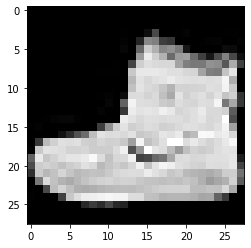

In [ ]:
from tensorflow.keras.datasets import fashion_mnist
import matplotlib.pyplot as plt
import tensorflow.keras as keras
from tensorflow.keras.models import Sequential 
from tensorflow.keras.layers import (Dense, Conv2D,MaxPool2D, Flatten, Dropout, BatchNormalization)

(x_train, y_train),(x_val , y_val) = fashion_mnist.load_data()
plt.imshow(image, cmap = 'gray')

# Reshaping for CNN <----
#x_train = x_train.reshape(60000, 784)
#x_val = x_val.reshape(10000, 784)
x_train = x_train.reshape(-1,28,28,1)
x_val = x_val.reshape(-1,28,28,1)


#x_train = x_train/255
#x_val = x_val/255
num_categories = 10
y_train = keras.utils.to_categorical(y_train, num_categories)
y_val = keras.utils.to_categorical(y_val, num_categories)

# Convolution layer
model = Sequential()
model.add(Conv2D(75,(3,3), strides = 1, padding = 'same', activation = 'relu', input_shape = (28,28,1)))
model.add(BatchNormalization())
model.add(MaxPool2D((2,2), strides = 2, padding = 'same'))
model.add(Conv2D(50,(3,3), strides = 1, padding = 'same', activation = 'relu'))
model.add(BatchNormalization())
model.add(MaxPool2D((2,2), strides = 2, padding = 'same'))
model.add(Dropout(0.2))
model.add(Conv2D(50,(3,3), strides = 1, padding = 'same', activation = 'relu'))
model.add(BatchNormalization())
model.add(MaxPool2D((2,2), strides = 2, padding = 'same'))
model.add(Flatten())

model.add(Dense(units = 784, activation = 'relu'))
model.add(Dropout(0.2))
model.add(Dense(units = 10, activation = 'softmax'))



In [ ]:
model.compile(loss = 'categorical_crossentropy', metrics = ['accuracy'])
model.fit(x_train, y_train, epochs = 10, verbose = 1, validation_data = (x_val, y_val))

Epoch 1/10
1875/1875 [==============================] - 20s 6ms/step - loss: 0.4591 - accuracy: 0.8450 - val_loss: 0.3484 - val_accuracy: 0.8807
Epoch 2/10
1875/1875 [==============================] - 10s 6ms/step - loss: 0.3328 - accuracy: 0.8853 - val_loss: 0.3483 - val_accuracy: 0.8747
Epoch 3/10
1875/1875 [==============================] - 10s 6ms/step - loss: 0.2960 - accuracy: 0.8997 - val_loss: 0.2663 - val_accuracy: 0.9064
Epoch 4/10
1875/1875 [==============================] - 10s 5ms/step - loss: 0.2608 - accuracy: 0.9073 - val_loss: 0.3192 - val_accuracy: 0.8954
Epoch 5/10
1875/1875 [==============================] - 10s 6ms/step - loss: 0.2301 - accuracy: 0.9167 - val_loss: 0.2687 - val_accuracy: 0.9078
Epoch 6/10
1875/1875 [==============================] - 10s 5ms/step - loss: 0.2096 - accuracy: 0.9238 - val_loss: 0.2543 - val_accuracy: 0.9146
Epoch 7/10
1875/1875 [==============================] - 10s 6ms/step - loss: 0.1934 - accuracy: 0.9298 - val_loss: 0.3177 - val_ac

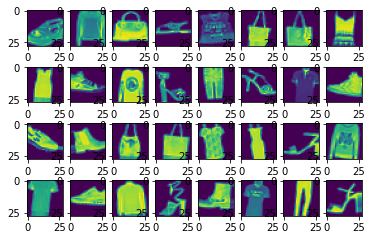

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.datasets import fashion_mnist
import matplotlib.pyplot as plt
import tensorflow.keras as keras
from tensorflow.keras.models import Sequential 
from tensorflow.keras.layers import (Dense, Conv2D,MaxPool2D, Flatten, Dropout, BatchNormalization)

(x_train, y_train),(x_val , y_val) = fashion_mnist.load_data()

# Reshaping for CNN <----
#x_train = x_train.reshape(60000, 784)
#x_val = x_val.reshape(10000, 784)
x_train = x_train.reshape(-1,28,28,1)
x_val = x_val.reshape(-1,28,28,1)


#x_train = x_train/255
#x_val = x_val/255
num_categories = 10
y_train = keras.utils.to_categorical(y_train, num_categories)
y_val = keras.utils.to_categorical(y_val, num_categories)

# Data Augmentation
datagen = ImageDataGenerator(
    rotation_range=10,  # randomly rotate images in the range (degrees, 0 to 180)
    zoom_range=0.1,  # Randomly zoom image
    width_shift_range=0.1,  # randomly shift images horizontally (fraction of total width)
    height_shift_range=0.1,  # randomly shift images vertically (fraction of total height)
    horizontal_flip=True,  # randomly flip images horizontally
    vertical_flip=False, # Don't randomly flip images vertically
)  

import matplotlib.pyplot as plt
import numpy as np
batch_size = 32
img_iter = datagen.flow(x_train, y_train, batch_size=batch_size)

x, y = img_iter.next()
fig, ax = plt.subplots(nrows=4, ncols=8)
for i in range(batch_size):
    image = x[i]
    ax.flatten()[i].imshow(np.squeeze(image))
plt.show()

In [ ]:
datagen.fit(x_train)

In [ ]:
# Convolution layer
model = Sequential()
model.add(Conv2D(75,(3,3), strides = 1, padding = 'same', activation = 'relu', input_shape = (28,28,1)))
model.add(BatchNormalization())
model.add(MaxPool2D((2,2), strides = 2, padding = 'same'))
model.add(Conv2D(50,(3,3), strides = 1, padding = 'same', activation = 'relu'))
model.add(BatchNormalization())
model.add(MaxPool2D((2,2), strides = 2, padding = 'same'))
model.add(Dropout(0.2))
model.add(Conv2D(50,(3,3), strides = 1, padding = 'same', activation = 'relu'))
model.add(BatchNormalization())
model.add(MaxPool2D((2,2), strides = 2, padding = 'same'))
model.add(Flatten())

model.add(Dense(units = 784, activation = 'relu'))
model.add(Dropout(0.2))
model.add(Dense(units = 10, activation = 'softmax'))

model.compile(loss = 'categorical_crossentropy', metrics = ['accuracy'])
model.fit(img_iter,
          epochs=10,
          steps_per_epoch=len(x_train)/batch_size, # Run same number of steps we would if we were not using a generator.
          validation_data=(x_val, y_val))

Epoch 1/10
1875/1875 [==============================] - 24s 12ms/step - loss: 0.6366 - accuracy: 0.7696 - val_loss: 0.6004 - val_accuracy: 0.8178
Epoch 2/10
1875/1875 [==============================] - 23s 12ms/step - loss: 0.4957 - accuracy: 0.8217 - val_loss: 0.5941 - val_accuracy: 0.7800
Epoch 3/10
1875/1875 [==============================] - 23s 13ms/step - loss: 0.4573 - accuracy: 0.8347 - val_loss: 0.3965 - val_accuracy: 0.8623
Epoch 4/10
1875/1875 [==============================] - 23s 12ms/step - loss: 0.4229 - accuracy: 0.8461 - val_loss: 0.3680 - val_accuracy: 0.8723
Epoch 5/10
1875/1875 [==============================] - 23s 12ms/step - loss: 0.3911 - accuracy: 0.8586 - val_loss: 0.3530 - val_accuracy: 0.8796
Epoch 6/10
1875/1875 [==============================] - 23s 12ms/step - loss: 0.3696 - accuracy: 0.8637 - val_loss: 0.3766 - val_accuracy: 0.8702
Epoch 7/10
1875/1875 [==============================] - 24s 13ms/step - loss: 0.3552 - accuracy: 0.8694 - val_loss: 0.4205 -

Here we find that Augmentation of Data did make our predictions better rather than performing only feature extraction

# Feed Forward Network in Pytorch

In [ ]:
import numpy as np
import math
import matplotlib.pyplot as plt
import matplotlib.colors
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, mean_squared_error, log_loss
from tqdm import tqdm_notebook 
import seaborn as sns
import time
from IPython.display import HTML
import warnings
warnings.filterwarnings('ignore')

from sklearn.preprocessing import OneHotEncoder
from sklearn.datasets import make_blobs

import torch
import torch.nn.functional as F
import torch.nn as nn
from torch import optim
torch.manual_seed(0)
my_cmap = matplotlib.colors.LinearSegmentedColormap.from_list("", ["red","yellow","green"])

In [ ]:
data, labels = make_blobs(n_samples=1000, centers=4, n_features=2, random_state=0)
print(data.shape, labels.shape)

(1000, 2) (1000,)


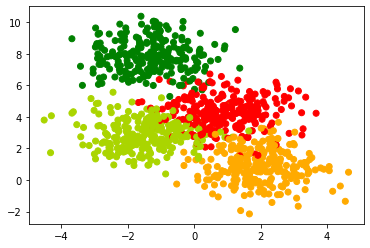

In [ ]:
plt.scatter(data[:,0], data[:,1], c=labels, cmap=my_cmap)
plt.show()

In [ ]:
X_train, X_val, Y_train, Y_val = train_test_split(data, labels, stratify=labels, random_state=0)
print(X_train.shape, X_val.shape, labels.shape)

(750, 2) (250, 2) (1000,)


In [ ]:
X_train, Y_train, X_val, Y_val = map(torch.tensor, (X_train, Y_train, X_val, Y_val))
print(X_train.shape, Y_train.shape)

torch.Size([750, 2]) torch.Size([750])


In [ ]:
X_train = X_train.float()
Y_train = Y_train.long()

In [ ]:
class FirstNetwork_v2(nn.Module):
  
  def __init__(self):
    super().__init__()
    torch.manual_seed(0)
    self.net = nn.Sequential(
        nn.Linear(2, 2),    # summation of a_i * w_i   2x2 2 inputs and 2 output neuron
        nn.Sigmoid(),       # Apply sigmoid
        nn.Linear(2, 4),    #  Output layer      
        nn.Softmax()
    )

  def forward(self, X):
    return self.net(X)

In [ ]:
def accuracy(y_hat, y):
  pred = torch.argmax(y_hat, dim=1)
  return (pred == y).float().mean()

In [ ]:
def fit_v1(epochs = 1000, learning_rate = 1):
  loss_arr = []
  acc_arr = []
  opt = optim.SGD(fn.parameters(), lr=learning_rate)
  
  for epoch in range(epochs):
    y_hat = fn(X_train)
    loss = F.cross_entropy(y_hat, Y_train)
    loss_arr.append(loss.item())
    acc_arr.append(accuracy(y_hat, Y_train))

    loss.backward()
    opt.step()
    opt.zero_grad()
        
  plt.plot(loss_arr, 'r-')
  plt.plot(acc_arr, 'b-')
  plt.show()      
  print('Loss before training', loss_arr[0])
  print('Loss after training', loss_arr[-1])

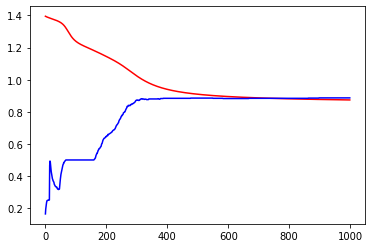

Loss before training 1.3951597213745117
Loss after training 0.873841404914856


In [ ]:
fn = FirstNetwork_v2()
fit_v1()

# Simple RNN Next month Book Sales Prediction

In [ ]:
import numpy as np 
import tensorflow as tf 
from tensorflow import keras 
from tensorflow.keras import layers

In [ ]:
# 3 Built in RNN's
# keras.layers.SimpleRNN
# keras.layers.GRU
# keras.layers.LSTM
model = keras.Sequential()
# Expedted Input vocab size 1000 and o/p embedding dimension is 64
model.add(layers.Embedding(input_dim = 1000, output_dim = 64))
model.add(layers.LSTM(units = 128))   # 128 interal units
model.add(layers.Dense(units = 10))   # 10 Dense units
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, None, 64)          64000     
                                                                 
 lstm (LSTM)                 (None, 128)               98816     
                                                                 
 dense (Dense)               (None, 10)                1290      
                                                                 
Total params: 164,106
Trainable params: 164,106
Non-trainable params: 0
_________________________________________________________________


In [ ]:
# encoder decoder architectures
encoder_vocab = 1000
decoder_vocab = 2000
encoder_input = layers.Input(shape = (None,))
encoder_embedded = layers.Embedding(input_dim = encoder_vocab, output_dim = 64)(encoder_input)

# Return states in addition to input
output, state_h, state_c = layers.LSTM(units = 64, return_state = True, name = 'encoder')(encoder_embedded) 
encoder_state = [state_h, state_c]

decoder_input = layers.Input(shape = (None,))
decoder_embedded = layers.Embedding(input_dim = decoder_vocab, output_dim = 64)(decoder_input)

# Pass 2 states to new LSTM layer as initial state
decoder_output = layers.LSTM(units = 64, name = 'decoder')(decoder_embedded, initial_state = encoder_state) 
output = layers.Dense(10)(decoder_output)
model = keras.Model([encoder_input, decoder_input], output)
model.summary()


Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, None)]       0           []                               
                                                                                                  
 input_4 (InputLayer)           [(None, None)]       0           []                               
                                                                                                  
 embedding_4 (Embedding)        (None, None, 64)     64000       ['input_3[0][0]']                
                                                                                                  
 embedding_5 (Embedding)        (None, None, 64)     128000      ['input_4[0][0]']                
                                                                                            

For sequences other than time series (e.g. text), it is often the case that a RNN model can perform better if it not only processes sequence from start to end, but also backwards. For example, to predict the next word in a sentence, it is often useful to have the context around the word, not only just the words that come before it.

In [ ]:
# keras.layers.Bidirectional
model = keras.Sequential()
model.add(layers.Bidirectional(layers.LSTM(units = 64, return_sequences = True), input_shape = (5,10)))
model.add(layers.Bidirectional(layers.LSTM(units = 32)))
model.add(layers.Dense(units = 10))
model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 bidirectional_2 (Bidirectio  (None, 5, 128)           38400     
 nal)                                                            
                                                                 
 bidirectional_3 (Bidirectio  (None, 64)               41216     
 nal)                                                            
                                                                 
 dense_5 (Dense)             (None, 10)                650       
                                                                 
Total params: 80,266
Trainable params: 80,266
Non-trainable params: 0
_________________________________________________________________


In [ ]:
import numpy as np 
import matplotlib.pyplot as plt
import tensorflow as tf 
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense 
from tensorflow.keras.layers import SimpleRNN 
import logging 
tf.get_logger().setLevel(logging.ERROR)
EPOCHS = 100
BATCH_SIZE = 16
TRAIN_TEST_SPLIT = 0.8
MIN = 12 
FILE_NAME = '/content/book_store_sales.csv'
def readfile(file_name):
    file = open(file_name, 'r', encoding = 'utf-8')
    next(file)
    data = []
    for line in (file):
        values = line.split(",")
        data.append(float(values[1]))
    file.close()
    return np.array(data,dtype = np.float32)

sales = readfile(FILE_NAME)
months = len(sales)
split = int(months * TRAIN_TEST_SPLIT)
train_sales = sales[0:split]
test_sales = sales[split:]


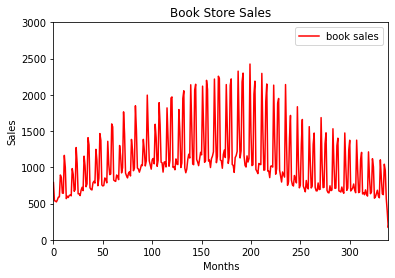

In [ ]:
x = range(len(sales))
plt.plot(x, sales, 'r-', label = 'book sales')
plt.title('Book Store Sales')
plt.axis([0,339,0.0,3000.0])
plt.xlabel('Months')
plt.ylabel('Sales')
plt.legend()
plt.show()

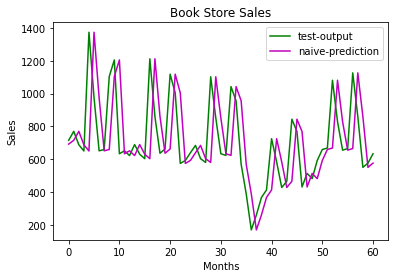

In [ ]:
test_output = test_sales[MIN:]
naive_prediction = test_sales[MIN-1: -1]
x = range(len(test_output))
plt.plot(x,test_output, 'g-', label = 'test-output')
plt.plot(x, naive_prediction, 'm-', label = 'naive-prediction')
plt.title('Book Store Sales')
plt.xlabel('Months')
plt.ylabel('Sales')
plt.legend()
plt.show()

In [ ]:
# We use only training data mean to standardise because in reality we dont get the test data.
mean = np.mean(train_sales)
stddev = np.std(train_sales)
train_sales_std = (train_sales - mean)/stddev
test_sales_std = (test_sales - mean)/stddev

In [ ]:
# I DIDNT UNDERSTAND THIS CELL    # Also did zero padding because DL framework requires all egs in mini-batch to be of same length
# Creating training examples
train_months = len(train_sales)
train_X = np.zeros((train_months - MIN, train_months - 1, 1))
train_Y = np.zeros((train_months - MIN, 1))
for i in range(0, train_months - MIN):
    train_X[i, -(i+MIN):,0] = train_sales_std[0:i+MIN]
    train_Y[i,0] = train_sales_std[i+MIN]

# Creating testing examples
test_months = len(test_sales)
test_X = np.zeros((test_months - MIN, test_months - 1, 1))
test_Y = np.zeros((test_months - MIN, 1))
for i in range(0, test_months - MIN):
    test_X[i, -(i+MIN):,0] = test_sales_std[0:i+MIN]
    test_Y[i,0] = test_sales_std[i+MIN]

In [ ]:
train_X.shape

(279, 290, 1)

In [ ]:
train_Y.shape

(279, 1)

In [ ]:
test_X.shape

(61, 72, 1)

In [ ]:
test_Y.shape

(61, 1)

In [ ]:
train_sales.shape

(291,)

In [ ]:
test_sales.shape

(73,)

In [ ]:
train_sales_std.shape

(291,)

In [ ]:
#RNN Model
model = Sequential()
model.add(SimpleRNN(units = 128, activation = 'relu', input_shape = (None,1))) 
model.add(Dense(units = 1, activation = 'linear'))  # As we are doing prediction or regression task --> Linear
model.compile(loss = 'mean_squared_error', optimizer = 'adam', metrics = ['mean_absolute_error'])
model.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn (SimpleRNN)      (None, 128)               16640     
                                                                 
 dense_6 (Dense)             (None, 1)                 129       
                                                                 
Total params: 16,769
Trainable params: 16,769
Non-trainable params: 0
_________________________________________________________________


https://datascience.stackexchange.com/questions/54159/what-does-an-input-layer-of-shape-none-or-none-12-actually-mean


In [ ]:
history = model.fit(train_X, train_Y, validation_data=(test_X, test_Y), epochs = EPOCHS, batch_size = BATCH_SIZE, verbose = 2, shuffle = True)  # None == BATCH_SIZE now

Epoch 1/100
18/18 - 3s - loss: 0.8038 - mean_absolute_error: 0.6552 - val_loss: 0.2504 - val_mean_absolute_error: 0.4075 - 3s/epoch - 160ms/step
Epoch 2/100
18/18 - 1s - loss: 0.4932 - mean_absolute_error: 0.5166 - val_loss: 0.3995 - val_mean_absolute_error: 0.5583 - 1s/epoch - 67ms/step
Epoch 3/100
18/18 - 1s - loss: 0.2279 - mean_absolute_error: 0.3596 - val_loss: 0.1283 - val_mean_absolute_error: 0.2767 - 1s/epoch - 69ms/step
Epoch 4/100
18/18 - 1s - loss: 0.0856 - mean_absolute_error: 0.2186 - val_loss: 0.1002 - val_mean_absolute_error: 0.2419 - 1s/epoch - 62ms/step
Epoch 5/100
18/18 - 1s - loss: 0.0649 - mean_absolute_error: 0.1860 - val_loss: 0.0638 - val_mean_absolute_error: 0.1848 - 1s/epoch - 61ms/step
Epoch 6/100
18/18 - 1s - loss: 0.0532 - mean_absolute_error: 0.1733 - val_loss: 0.0594 - val_mean_absolute_error: 0.1724 - 1s/epoch - 67ms/step
Epoch 7/100
18/18 - 1s - loss: 0.0407 - mean_absolute_error: 0.1468 - val_loss: 0.0632 - val_mean_absolute_error: 0.1832 - 1s/epoch - 6

In [ ]:
test_output = test_sales_std[MIN:]
naive_prediction = test_sales_std[MIN-1: -1]
mean_squared_error = np.mean(np.square(naive_prediction - test_output))
mean_abs_error = np.mean(np.abs(naive_prediction - test_output))
x = range(len(test_output))
print('Naive test mse: ', mean_squared_error)
print("Naive test mean abs: ", mean_abs_error)

Naive test mse:  0.36472264
Naive test mean abs:  0.4389287


In [ ]:
predicted_test = model.predict(test_X, len(test_X))
predicted_test = np.reshape(predicted_test, (len(predicted_test)))
predicted_test.shape

(61,)

In [ ]:
predicted_test

array([-1.095429  , -0.7807021 , -0.9600602 , -1.0398955 ,  1.0792286 ,
       -0.3922103 , -1.1548514 , -1.1132267 ,  0.09874113,  0.0432156 ,
       -1.0104511 , -1.1685343 , -0.97300845, -1.0093398 , -1.1959941 ,
       -1.26771   ,  0.53886503, -0.53246015, -1.2484639 , -1.1461811 ,
        0.11810928, -0.02321452, -1.2661846 , -1.2749217 , -1.0699284 ,
       -1.148653  , -1.2329197 , -1.3466561 ,  0.05582133, -0.5026707 ,
       -1.3833251 , -1.2397919 , -0.04162653, -0.35006922, -1.3409815 ,
       -1.263766  , -1.2851124 , -1.5861189 , -1.8398678 , -2.0615618 ,
       -0.87148905, -1.0601969 , -1.6343172 , -1.6941895 , -0.72381335,
       -1.0112741 , -1.8107357 , -1.8336484 , -1.6593137 , -1.555948  ,
       -1.4000521 , -1.2830997 , -0.30147317, -0.6188317 , -1.2129507 ,
       -1.149821  ,  0.03395146, -0.29130185, -1.2944598 , -1.0929039 ,
       -1.2096272 ], dtype=float32)

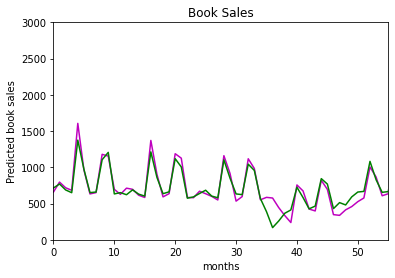

In [ ]:
predicted_test = predicted_test * stddev + mean 
x = range(len(test_sales) - MIN)
plt.plot(x, predicted_test, 'm-', label = 'predicted_test_output')
plt.plot(x, test_sales[-(len(test_sales) - MIN):], 'g-', label = 'actual_test_output')
plt.title('Book Sales')
plt.axis([0,55,0.0,3000.0])
plt.xlabel('months')
plt.ylabel('Predicted book sales')
plt.show()

https://towardsdatascience.com/the-vanishing-gradient-problem-69bf08b15484

For Exploding Gradient Problem: 
*   Gradient become large here
*   So we do gradient clipping by adjusting the gradient to be smaller when it blows up.
*   Note: Batch Normalisation aims to adjust the value during the forward pass through the network to keep neurons in active region whereas grad clipping adjusts the gradient during backward pass.

$\therefore$ Batch Normalisation: Solves Vanishing Gradients

Gradient Clipping: Solves Exploding Gradients



# LSTM
---

* Constant Error Carousel avoids vanishing and exploding gradient problem by somthing similar to setting the weight values to 1 during back prop.
* LSTM is based on CEC technique. 
* Also known as cell which is used as replacement for SimpleNeurons that we have used so far in RNN's
* Frequently used in modern RNN's
* Its consists of logictic sigmoid fn's known as gates in addition to traditional activation functions(mostly tanh or ReLU)
* TO understand LSTM is a cell which is a replacement for neurons in RNN's
* The simplification of LSTM which the same capability is Gated Recurral Network.(GRU)




# Seq2Seq Models


---
https://jalammar.github.io/visualizing-neural-machine-translation-mechanics-of-seq2seq-models-with-attention/

*  Takes sequence of items and outputs another sequence of items
*  Here its a sequence of series of words processed one after another and output is a series of words.
* Another way of looking these are in terms of **Encoder and Decoder Model**. The encoder proceess each item in the input sequence, it compiles the information it captures into a vector and sends it to decoder which produces sequence item by item.
* Encoder and Decoder both are RNN's
* The size of context vec can be set and is usually the no.of hidden units in encoder RNN
* RNN takes an input word as a vector. So we convert the word to vector using word embeddings: Embedding Layer, Word2vec, GloVe
* But sometimes context vector was so big and posed challenging task to deal with long sentences. So a proposal of **Attention** was done.
> * In attention model instead of passing the last hidden state of encoding stage, the encoder passes all the hidden states to the decoder
> * Also decoder does some extra step before computing the output




# Transformer


---
https://jalammar.github.io/illustrated-transformer/

* It uses attention to boost the speed with which a model can be trained.
* It is suitable for parallelization.
* Now we have a stack of encoders where the topmost encoder output is fed to all the decoders in stack of decoders and the last decoder in the top of the stack generates the final output.
* All encoders are identical in structure: Broken down into:
> 1. Self attention  ( it <=> animal )
> 2. Feed Forward
* Decoder
> 1. Self Attention
> 2. Encoder-Decoder Attention
> 3. Feed Forward
* Refer to the website link to understand how to compute self-attention.
* The self attention layer can be refined by adding mechanism called ."multi-headed" attention.
* Transformers deal with long-term dependancies better than LSTMs.

# BERT
---
https://jalammar.github.io/illustrated-bert/
* Used to classify a single piece of text (spam or not)
* Sentiment Analysis
* Fact Checking
* Its a trained Transformer Encoder Stack. It has large number of encoder layers, feed forward layers, attention heads.
* First input token supplied to it is CLS for classification
* BERT works similar to vanialla encoder of transformer:  takes a sequence of words as input which keep flowing up the stack. Each layer applies self-attention, and passes its results through a feed-forward network, and then hands it off to the next encoder.
* It is at the output that we first start seeing how things diverge from transformer: https://jalammar.github.io/illustrated-bert/#:~:text=how%20things%20diverge.-,Model%20Outputs,-Each%20position%20outputs
* ELMO Embedding: Instead of using a fixed embedding for each word, ELMo looks at the entire sentence before assigning each word in it an embedding. It uses a bi-directional LSTM trained on a specific task to be able to create those embeddings.
* ULM-FiT introduced methods to effectively utilize a lot of what the model learns during pre-training – more than just embeddings, and more than contextualized embeddings (ELMO Embedding)




# Transfer Learning using Transformer
---
https://jalammar.github.io/illustrated-bert/
https://jalammar.github.io/illustrated-bert/#:~:text=OpenAI%20Transformer%3A%20Pre%2Dtraining%20a%20Transformer%20Decoder%20for%20Language%20Modeling
* We don’t need an entire Transformer to adopt transfer learning and a fine-tunable language model for NLP tasks. We can do with just the decoder of the transformer.
* As there is no encoder the decoder layers would not have the encoder-decoder attention sublayer that vanilla transformer decoder layers have.
* With this structure, we can proceed to train the model on the same language modeling task: predict the next word using massive (unlabeled) datasets. **Just, throw the text of 7,000 books at it and have it learn! Books are great for this sort of task since it allows the model to learn to associate related information even if they’re separated by a lot of text – something you don’t get for example, when you’re training with tweets, or articles.**
* OpenAI transformer is pre-trained and its layers have been tuned to reasonably handle language.
* ELMo’s language model was bi-directional, but the openAI transformer only trains a forward language model

Could we build a transformer-based model whose language model looks both forward and backwards (in the technical jargon – “is conditioned on both left and right context”)? $⟹$ Masked Language Model


# Word2Vec
---
https://jalammar.github.io/illustrated-word2vec/

1.  It is a method to efficiently create word embeddings.
2. Skipgram: Instead of looking two words before the target word look at 2 words after it. https://jalammar.github.io/illustrated-word2vec/#:~:text=account%20for%20this.-,Skipgram,-%E2%80%9CIntelligence%20takes%20chance   This is called continous bag of words architecture. Instead of guessing a word based on its context this other architecture tries to guess neighboring words using the current word.
3. 3 steps:
> 1. Look up Embeddings
> 2. Calculate Predicition
> 3. Project to output vocabulary



# GPT-2
---
https://jalammar.github.io/illustrated-gpt2/
*  It’s architecture is very similar to the decoder-only transformer
* It's a very large, transformer-based language model trained on a massive dataset.
* A lot of the subsequent research work saw the architecture shed either the encoder or decoder, and use just one stack of transformer blocks – stacking them up as high as practically possible, feeding them massive amounts of training text, and throwing vast amounts of compute at them.
* The GPT-2 is built using transformer decoder blocks. BERT, on the other hand, uses transformer encoder blocks.  But one key difference between the two is that GPT2, like traditional language models, outputs one token at a time.
* The way these models actually work is that after each token is produced, that token is added to the sequence of inputs. And that new sequence becomes the input to the model in its next step. This is an idea called “auto-regression”
* This is the tradeoff.In losing auto-regression, BERT gained the ability to incorporate the context on both sides of a word to gain better results.


# GPT3
---
https://jalammar.github.io/how-gpt3-works-visualizations-animations/
* A trained language model generates text.
* Training is the process of exposing the model to lots of text.  All the experiments you see now are from that one trained model.
* The important calculations of the GPT3 occur inside its stack of 96 transformer decoder layers.


# RNN + LSTM for Classifying Positive or negative reviews

In [ ]:
import numpy as np 
#from tensorflow.keras.preprocessing import sequence  Use this: tf.keras.utils.timeseries_dataset_from_array
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense,Activation,Embedding, LSTM 
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.datasets import imdb 
from tensorflow import keras
import tensorflow as tf
import matplotlib.pyplot as plt

In [ ]:
max_features = 20000
maxlen = 80 # cuts text after this number of words
batch_size = 32

In [ ]:
(x_train, y_train),(x_test,y_test) = imdb.load_data(num_words = max_features)  
# Words are ranked by how often they occur (in the training set) and only the num_words most frequent words are kept.

17473536/17464789 [==============================] - 0s 0us/step


In [ ]:
print(x_train.shape, y_train.shape, x_test.shape, y_test.shape)

(25000,) (25000,) (25000,) (25000,)


In [ ]:
x_train[0]

[1,
 14,
 22,
 16,
 43,
 530,
 973,
 1622,
 1385,
 65,
 458,
 4468,
 66,
 3941,
 4,
 173,
 36,
 256,
 5,
 25,
 100,
 43,
 838,
 112,
 50,
 670,
 2,
 9,
 35,
 480,
 284,
 5,
 150,
 4,
 172,
 112,
 167,
 2,
 336,
 385,
 39,
 4,
 172,
 4536,
 1111,
 17,
 546,
 38,
 13,
 447,
 4,
 192,
 50,
 16,
 6,
 147,
 2025,
 19,
 14,
 22,
 4,
 1920,
 4613,
 469,
 4,
 22,
 71,
 87,
 12,
 16,
 43,
 530,
 38,
 76,
 15,
 13,
 1247,
 4,
 22,
 17,
 515,
 17,
 12,
 16,
 626,
 18,
 19193,
 5,
 62,
 386,
 12,
 8,
 316,
 8,
 106,
 5,
 4,
 2223,
 5244,
 16,
 480,
 66,
 3785,
 33,
 4,
 130,
 12,
 16,
 38,
 619,
 5,
 25,
 124,
 51,
 36,
 135,
 48,
 25,
 1415,
 33,
 6,
 22,
 12,
 215,
 28,
 77,
 52,
 5,
 14,
 407,
 16,
 82,
 10311,
 8,
 4,
 107,
 117,
 5952,
 15,
 256,
 4,
 2,
 7,
 3766,
 5,
 723,
 36,
 71,
 43,
 530,
 476,
 26,
 400,
 317,
 46,
 7,
 4,
 12118,
 1029,
 13,
 104,
 88,
 4,
 381,
 15,
 297,
 98,
 32,
 2071,
 56,
 26,
 141,
 6,
 194,
 7486,
 18,
 4,
 226,
 22,
 21,
 134,
 476,
 26,
 480,
 5,
 144,
 30,

In [ ]:
x_train[0]
len(x_train[0])  # This sentence is or 218 words

218

In [ ]:
y_train[0]

1

In [ ]:
print(len(x_train),'train_sequences')

25000 train_sequences


tf.keras.utils.pad_sequences: This function transforms a list (of length num_samples) of sequences (lists of integers) into a 2D Numpy array of shape (num_samples, num_timesteps). num_timesteps is either the maxlen argument if provided, or the length of the longest sequence in the list.

In [ ]:
x_train = keras.preprocessing.sequence.pad_sequences(x_train, maxlen = maxlen)
x_test = keras.preprocessing.sequence.pad_sequences(x_test, maxlen = maxlen)
print(x_train.shape, x_test.shape)

(25000, 80) (25000, 80)


In [ ]:
x_train[0]
len(x_train[0])   # Now this sentence is truncated to 80 words which frequently occur in the sentence

80

In [ ]:
x_train[0]

array([   15,   256,     4,     2,     7,  3766,     5,   723,    36,
          71,    43,   530,   476,    26,   400,   317,    46,     7,
           4, 12118,  1029,    13,   104,    88,     4,   381,    15,
         297,    98,    32,  2071,    56,    26,   141,     6,   194,
        7486,    18,     4,   226,    22,    21,   134,   476,    26,
         480,     5,   144,    30,  5535,    18,    51,    36,    28,
         224,    92,    25,   104,     4,   226,    65,    16,    38,
        1334,    88,    12,    16,   283,     5,    16,  4472,   113,
         103,    32,    15,    16,  5345,    19,   178,    32],
      dtype=int32)

we create a mapping 
from each word to a unique integer, and we present this integer as input to an 
Embedding layer, which converts the integer to an embedding.

Model setup

In [ ]:
model = Sequential()
model.add(Embedding( input_dim = max_features, output_dim = 64))   # Why is output_dim = 128  
model.add(Dense(units = 128))
model.add(LSTM( units = 128, dropout = 0.2, recurrent_dropout = 0.2))
model.add(Dense(units = 1))
model.add(Activation('sigmoid'))    # Can we merge Activation and Dense 
model.summary()
# input_dim: Integer. Size of the vocabulary, i.e. maximum integer index + 1.
# output_dim: Integer. Dimension of the dense embedding.
# dropout_U (changed to recurrent_dropout): float between 0 and 1. Fraction of the input units to drop for recurrent connections.
# dropout_W (changes to dropout): float between 0 and 1. Fraction of the input units to drop for input gates.

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, None, 64)          1280000   
                                                                 
 dense_5 (Dense)             (None, None, 128)         8320      
                                                                 
 lstm (LSTM)                 (None, 128)               131584    
                                                                 
 dense_6 (Dense)             (None, 1)                 129       
                                                                 
 activation (Activation)     (None, 1)                 0         
                                                                 
Total params: 1,420,033
Trainable params: 1,420,033
Non-trainable params: 0
_________________________________________________________________


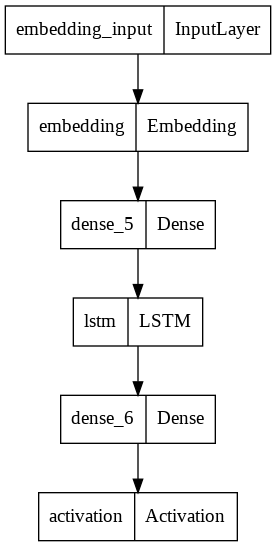

In [ ]:
tf.keras.utils.plot_model(model)

In [ ]:
earlystopping = EarlyStopping(monitor ="val_loss",mode ="min", patience = 5, restore_best_weights = True)
  
history = model.fit(x_train, y_train, batch_size = batch_size, 
                    epochs = 5, verbose = 1,validation_data = (x_test, y_test), 
                    callbacks =[earlystopping])

RuntimeError: ignored

In [ ]:
model.compile(loss = 'binary_crossentropy', optimizer = 'adam', metrics = ['accuracy'])
#model.fit(x_train,y_train,batch_size = batch_size,epochs = 5, verbose = 1, validation_data = (x_test, y_test))

In [ ]:
earlystopping = EarlyStopping(monitor ="val_loss",mode ="min", patience = 5, restore_best_weights = True)
  
history = model.fit(x_train, y_train, batch_size = 32,
                    epochs = 5, verbose = 1,validation_data = (x_test, y_test), 
                    callbacks =[earlystopping])

In [ ]:
x_test.shape

In [ ]:
history.history.keys()

In [ ]:
plt.plot(history.history['accuracy'],label = 'accuracy' )
plt.plot(history.history['val_accuracy'], label = 'val_accuracy')
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend()
plt.show()


In [ ]:
plt.plot(history.history['loss'])

The model overfits

In [ ]:
train_score, train_acc = model.evaluate(x_train, y_train, batch_size = 32)
test_score, test_acc = model.evaluate(x_test, y_test, batch_size = 32)
print('Train score', train_score)
print('Test score', test_score)
print('Train accuracy', train_acc)
print('Train accuarcy', test_acc)


# Evaluating Deep LEarning Models

https://machinelearningmastery.com/evaluate-performance-deep-learning-models-keras/


For Getting accuracy
```python
from rouge_score import rouge_scorer

scorer = rouge_scorer.RougeScorer(['rouge1', 'rougeL'], use_stemmer=True)
scores = scorer.score('The quick brown fox jumps over the lazy dog',
                        'The quick brown dog jumps on the log.')
```

A more commonly used metric when evaluating statistical 
language models is called perplexity. It is a statistical metric 
of how well a sample matches a probability distribution. 

# Word Embeddings

https://machinelearningmastery.com/use-word-embedding-layers-deep-learning-keras/#:~:text=output_dim%3A%20This%20is%20the%20size,different%20values%20for%20your%20problem.

In [ ]:
import numpy as np 
#from tensorflow.keras.preprocessing import sequence  Use this: tf.keras.utils.timeseries_dataset_from_array
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense,Activation,Embedding, LSTM 
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.datasets import imdb 
from tensorflow.keras import layers
from tensorflow import keras
import tensorflow as tf
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.text import one_hot

 We define an Embedding layer with a vocabulary of 200 (e.g. integer encoded words from 0 to 199, inclusive), a vector space of 32 dimensions in which words will be embedded, and input documents that have 50 words each.

In [ ]:
e = Embedding(input_dim = 200, output_dim = 32, input_length = 50)

The Embedding layer has weights that are learned. If you wish to connect a Dense layer directly to an Embedding layer, you must first flatten the 2D output matrix to a 1D vector using the Flatten layer.

In [ ]:
# define documents
docs = ['Well done!',
		'Good work',
		'Great effort',
		'nice work',
		'Excellent!',
		'Weak',
		'Poor effort!',
		'not good',
		'poor work',
		'Could have done better.']
labels = np.array([1,1,1,1,1,0,0,0,0,0])

Keras provides the one_hot() function that creates a hash of each word as an efficient integer encoding.

vocab_size is used to represent the number of the unique words/tokens in the corpus while emb_size is the size of a vector used to represent each word/token. emb_size is a hyper-parameter that we need to determine.

In [ ]:
vocab_size = 50
encoded_docs = [one_hot(d, vocab_size) for d in docs]
print(encoded_docs)

[[18, 31], [26, 39], [20, 13], [48, 39], [5], [16], [7, 13], [15, 26], [7, 39], [28, 41, 31, 27]]


If the sequences have different lengths and Keras prefers inputs to be vectorized and all inputs to have the same length. We will pad all input sequences to have the length of 4

In [ ]:
max_length = 4 
padded_docs = keras.preprocessing.sequence.pad_sequences(encoded_docs, maxlen = max_length, padding = 'post')
print(padded_docs)

[[18 31  0  0]
 [26 39  0  0]
 [20 13  0  0]
 [48 39  0  0]
 [ 5  0  0  0]
 [16  0  0  0]
 [ 7 13  0  0]
 [15 26  0  0]
 [ 7 39  0  0]
 [28 41 31 27]]


The Embedding has a vocabulary of 50 and an input length of 4. We will choose a small embedding space of 8 dimensions. The model is a simple binary classification model. Importantly, the output from the Embedding layer will be 4 vectors of 8 dimensions each, one for each word. We flatten this to a one 32-element vector to pass on to the Dense output layer.

In [ ]:
model = Sequential()
model.add(Embedding(input_dim = vocab_size, output_dim = 8, input_length = max_length))
model.add(layers.Flatten())
model.add(Dense(1,activation = 'sigmoid'))
model.compile(optimizer = 'adam', loss = 'binary_crossentropy', metrics = ['accuracy'])
print(model.summary())

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_6 (Embedding)     (None, 4, 8)              400       
                                                                 
 flatten (Flatten)           (None, 32)                0         
                                                                 
 dense_3 (Dense)             (None, 1)                 33        
                                                                 
Total params: 433
Trainable params: 433
Non-trainable params: 0
_________________________________________________________________
None


In [ ]:
# fit the model
model.fit(padded_docs, labels, epochs=50, verbose=0)
# evaluate the model
loss, accuracy = model.evaluate(padded_docs, labels, verbose=0)
print('Accuracy: %f' % (accuracy*100))

Accuracy: 89.999998


# LSTM With Beam Search NW

Logging is a means of tracking events that happen when some software runs. Logging is important for software developing, debugging, and running. If you don't have any logging record and your program crashes, there are very few chances that you detect the cause of the problem

In [ ]:
import numpy as np 
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM 
import tensorflow as tf
import logging 
#tf.get_logger().setLevel(logging.ERROR)

In [ ]:
EPOCHS = 32
BATCH_SIZE = 256
INPUT_FILE_NAME = '/content/frankenstein.txt'
WINDOW_LENGTH = 40
WINDOW_STEP = 3
BEAM_SIZE = 8
NUM_LETTERS = 11
MAX_LENGTH = 50 

WINDOW_LENGTH and WINDOW_STEP, which are used to 
control the process of splitting up this text file into multiple training examples.


In [ ]:
file = open(INPUT_FILE_NAME, 'r')
text = file.read()
file.close()

In [ ]:
#file = open(INPUT_FILE_NAME, 'r', encoding = 'utf-8')
#text = file.read()
#text

In [ ]:
text

'\nSt. Petersburgh, Dec. 11th, 17--\n\nTO Mrs. Saville, England\n\nYou will rejoice to hear that no disaster has accompanied the\ncommencement of an enterprise which you have regarded with such evil\nforebodings.  I arrived here yesterday, and my first task is to assure\nmy dear sister of my welfare and increasing confidence in the success\nof my undertaking.\n\nI am already far north of London, and as I walk in the streets of\nPetersburgh, I feel a cold northern breeze play upon my cheeks, which\nbraces my nerves and fills me with delight.  Do you understand this\nfeeling?  This breeze, which has travelled from the regions towards\nwhich I am advancing, gives me a foretaste of those icy climes.\nInspirited by this wind of promise, my daydreams become more fervent\nand vivid.  I try in vain to be persuaded that the pole is the seat of\nfrost and desolation; it ever presents itself to my imagination as the\nregion of beauty and delight.  There, Margaret, the sun is forever\nvisible, its

In [ ]:
text = text.lower()
text = text.replace("\n", " ")   # New line with a space
text = text.replace("  ", " ")   # Double spaces with sigle space
text

' st. petersburgh, dec. 11th, 17-- to mrs. saville, england you will rejoice to hear that no disaster has accompanied the commencement of an enterprise which you have regarded with such evil forebodings. i arrived here yesterday, and my first task is to assure my dear sister of my welfare and increasing confidence in the success of my undertaking. i am already far north of london, and as i walk in the streets of petersburgh, i feel a cold northern breeze play upon my cheeks, which braces my nerves and fills me with delight. do you understand this feeling? this breeze, which has travelled from the regions towards which i am advancing, gives me a foretaste of those icy climes. inspirited by this wind of promise, my daydreams become more fervent and vivid. i try in vain to be persuaded that the pole is the seat of frost and desolation; it ever presents itself to my imagination as the region of beauty and delight. there, margaret, the sun is forever visible, its broad disk just skirting th

In [ ]:
l1 = ["eat", "sleep", "repeat"]
 
# creating enumerate objects
obj1 = enumerate(l1)
 
print ("Return type:", type(obj1))
print (list(enumerate(l1)))

Return type: <class 'enumerate'>
[(0, 'eat'), (1, 'sleep'), (2, 'repeat')]


In [ ]:
# Creating a Hash Table
unique_chars = list(set(text))  # Getting unique characters in a text
char_to_index = dict((ch,index) for index, ch in enumerate(unique_chars))  # Creating a dictionary of unqiue character and assigning it a unique number
index_to_char = dict((index,ch) for index,ch in enumerate(unique_chars))   # Index to char mapping similar to above char to index mapping
encoding_width = len(char_to_index)   # This would later be width of each one-hot encoded vector that represents a character

In [ ]:
print(len(text))
print(len(text) - WINDOW_LENGTH)
print(WINDOW_STEP)
print(WINDOW_LENGTH)

418106
418066
3
40


In [ ]:
text

' st. petersburgh, dec. 11th, 17-- to mrs. saville, england you will rejoice to hear that no disaster has accompanied the commencement of an enterprise which you have regarded with such evil forebodings. i arrived here yesterday, and my first task is to assure my dear sister of my welfare and increasing confidence in the success of my undertaking. i am already far north of london, and as i walk in the streets of petersburgh, i feel a cold northern breeze play upon my cheeks, which braces my nerves and fills me with delight. do you understand this feeling? this breeze, which has travelled from the regions towards which i am advancing, gives me a foretaste of those icy climes. inspirited by this wind of promise, my daydreams become more fervent and vivid. i try in vain to be persuaded that the pole is the seat of frost and desolation; it ever presents itself to my imagination as the region of beauty and delight. there, margaret, the sun is forever visible, its broad disk just skirting th

In [ ]:
fragments = []
targets = []
for i in range(0, len(text) - WINDOW_LENGTH, WINDOW_STEP):
    fragments.append(text[i:i + WINDOW_LENGTH])
    targets.append(text[i + WINDOW_LENGTH])
    print("Fragments: ", fragments)
    print("Targets:", targets)
    if i == 3:
        break

Fragments:  [' st. petersburgh, dec. 11th, 17-- to mrs']
Targets: ['.']
Fragments:  [' st. petersburgh, dec. 11th, 17-- to mrs', '. petersburgh, dec. 11th, 17-- to mrs. s']
Targets: ['.', 'a']


In [ ]:
text[0:40]

' st. petersburgh, dec. 11th, 17-- to mrs'

Each training example will consist of a sequence of characters 
and a target output value of a single character immediately following the input 
characters. We create these input examples using a sliding window of length 
WINDOW_LENGTH. Once we have created one training example, we slide the 
window by WINDOW_STEP positions and create the next training example. We add 
the input examples to one list and the output values to another. All of this is done 
by the first for loop

In [ ]:
fragments = []
targets = []
for i in range(0, len(text) - WINDOW_LENGTH, WINDOW_STEP):
    fragments.append(text[i:i + WINDOW_LENGTH])
    targets.append(text[i + WINDOW_LENGTH])

# Preparing One Hot Encoded Data
x = np.zeros((len(fragments), WINDOW_LENGTH, encoding_width))
y = np.zeros((len(fragments), encoding_width))
for i,fragment in enumerate(fragments):
    for j, char in enumerate(fragment):
        x[i,j, char_to_index[char]] = 1
    target_char = targets[i]
    y[i, char_to_index[target_char]] = 1

In [ ]:
y[0]

array([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
       1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.])

Therefore each character is represented by a dimension of size encoding_
width

In [ ]:
print(x.shape)
print(y.shape)
print(encoding_width)

(139356, 40, 51)
(139356, 51)
51


In [ ]:
model = Sequential()
model.add(LSTM(units = 128, return_sequences = True, dropout = 0.2, recurrent_dropout = 0.2, input_shape = (None, encoding_width)))
model.add(LSTM(units = 128, dropout = 0.2, recurrent_dropout = 0.2))
model.add(Dense(units = encoding_width, activation = 'softmax'))
model.compile(loss = 'categorical_crossentropy', optimizer = 'adam')
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, None, 128)         92160     
                                                                 
 lstm_1 (LSTM)               (None, 128)               131584    
                                                                 
 dense (Dense)               (None, 51)                6579      
                                                                 
Total params: 230,323
Trainable params: 230,323
Non-trainable params: 0
_________________________________________________________________


use a dropout value of 0.2 on the connections between layers as well as on the recurrent connections

pass return_sequences=True to the constructor of the first layer because the second layer needs to see the output values for all timesteps from the first layer.

output layer consists of multiple 
neurons using a softmax function instead of a single linear neuron because we will be predicting probabilities for discrete entities (characters) instead of a single numerical value. We use categorical cross-entropy as our loss function, which is the recommended loss function for multicategory classification

In [ ]:
history = model.fit(x,y,validation_split = 0.05, batch_size = BATCH_SIZE, epochs = EPOCHS, verbose = 1, shuffle = True )

Epoch 1/32
518/518 [==============================] - 171s 319ms/step - loss: 2.7788 - val_loss: 2.4311
Epoch 2/32
518/518 [==============================] - 161s 312ms/step - loss: 2.3895 - val_loss: 2.2527
Epoch 3/32
518/518 [==============================] - 159s 308ms/step - loss: 2.2598 - val_loss: 2.1381
Epoch 4/32
518/518 [==============================] - 160s 309ms/step - loss: 2.1740 - val_loss: 2.0627
Epoch 5/32
518/518 [==============================] - 158s 305ms/step - loss: 2.1115 - val_loss: 2.0084
Epoch 6/32
518/518 [==============================] - 159s 307ms/step - loss: 2.0600 - val_loss: 1.9531
Epoch 7/32
  8/518 [..............................] - ETA: 2:37 - loss: 1.9942

KeyboardInterrupt: ignored

a parameter validation_
split=0.05 to the fit() function. Keras will then automatically split our 
training data into a training set and a test set, where the parameter 0.05 indicates 
that 5% of the data will be used as a test set.

In [ ]:
letters = 'the body'
one_hots = []
for i,char in enumerate(letters):
    x = np.zeros(encoding_width)
    x[char_to_index[char]] = 1
    one_hots.append(x)
beams = [(np.log(1.0), letters, one_hots)]  # Beams = [probability, string, one_hot_encoded_string]

# Predict numletters in future
for i in range(NUM_LETTERS):
    minibatch_list = []
    # Create minibatch from one-hot encodings and predict
    for triple in beams:
        minibatch_list.append(triple[2])
    minibatch = np.array(minibatch_list)
    y_predict = model.predict(minibatch, verbose = 1)
    new_beams = []
    for j, softmax_vec in enumerate(y_predict):
        triple = beams[j]
        # Create BEAM_SIZE new beams for each existing beam
        for k in range(BEAM_SIZE):
            char_index = np.argmax(softmax_vec)
            new_prob = triple[0] + np.log(softmax_vec[char_index])
            new_letters = triple[1] + index_to_char[char_index]
            x = np.zeros(encoding_width)
            x[char_index] = 1
            new_one_hots = triple[2].copy()
            new_one_hots.append(x)
            new_beams.append((new_prob, new_letters, new_one_hots))
            softmax_vec[char_index] = 0 
        # Prune tree to only keep BEAM_SIZE most probable beams 
        new_beams.sort(key = lambda tup: tup[0], reverse = True)
        beams = new_beams[0:BEAM_SIZE]
for item in beams:
    print(item[1])   

1/1 [==============================] - 0s 24ms/step


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:15: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  from ipykernel import kernelapp as app


ValueError: ignored

# Language Models
It provides probability for each word in a vocabulary given a sequence of historical words

1. n-gram model: Here it takes (n-1) history words + predicted next word. n=2 bigram model --> Cannot capture long term dependencies. If starting sequence is not found in the table then model predicts 0% and also need lot of training data.

2. Skip gram model: 
>* A skip-gram model is an extension of the n-gram model but where all words do not need to appear sequentially in the training corpus. Instead, some wordscan be skipped. 
> *A k-skip-n-gram model is defined by the two parameters k and 
n, where k determines how many words can be skipped and n determines how many words each skip-gram contains. 
> *For instance, a 1-skip-2-gram model will contain all the bigrams (2-grams) that we discussed previous, but also contain nonconsecutive word pairs that are separated by, at most, one word. If we again 
consider the word sequence “The more I read, . . .” in addition to /the more/ /more i/, and so on, the 1-skip-2-gram model will contain /the i/ /more read/, and so on.

3. As we know the **limitation of FNN:** Inablility to accept variable sized input. So we move to RNN

4. Neural Language Model

5. Word Embedding: A word embedding is a dense representation of a word in a vector space with a smaller number of dimensions than the number of words in the vocabulary.

# Word_embeddings and LSTM to predict next words in sentences

In [ ]:
import numpy as np 
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, Embedding
from tensorflow.keras.preprocessing.text import Tokenizer, text_to_word_sequence
import tensorflow as tf 

text_to_word_sequence: splits the text into a list of individual words. Also removes punctuation and converts the text to lowercase.

In [ ]:
EPOCHS  = 32
BATCH_SIZE = 256
INPUT_FILE_NAME = '/content/frankenstein.txt'
WINDOW_LENGTH = 40
WINDOW_STEP = 3
PREDICT_LENGTH = 6
MAX_WORDS = 10000
EMBEDDING_WIDTH = 100

In [ ]:
file = open(INPUT_FILE_NAME, 'r', encoding = 'utf-8')
text = file.read()
file.close()
text = text_to_word_sequence(text)
fragments = []
targets = []
for i in range(0, len(text) - WINDOW_LENGTH, WINDOW_STEP):
    fragments.append(text[i:i + WINDOW_LENGTH])
    targets.append(text[i+WINDOW_LENGTH])

each input word needs to be encoded to a corresponding 
word index (an integer) instead of one-hot encoding. This index will then be 
converted into an embedding by the Embedding layer. The target (output) word 
should still be one-hot encoded. To simplify how to interpret the output, we want 
the one-hot encoding to be done in such a way that bit N is hot when the network 
outputs the word corresponding to index N in the input encoding.

In [ ]:
fragments[0]
targets[10]

'the'

In [ ]:
# Training Input to Word Indices and Output to One-Hot Encoding
tokenizer = Tokenizer(num_words = MAX_WORDS, oov_token = 'UNK')
tokenizer.fit_on_texts(text)
fragments_indexed = tokenizer.texts_to_sequences(fragments)
targets_indexed = tokenizer.texts_to_sequences(targets)

x = np.array(fragments_indexed, dtype = np.int)
y = np.zeros((len(targets_indexed), MAX_WORDS))
for i, target_index in enumerate(targets_indexed):
    y[i,target_index] = 1 

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  import sys


In [ ]:
fragments_indexed[0]
targets_indexed[10]

[2]

In [ ]:
x[0]
y[10]

array([0., 0., 1., ..., 0., 0., 0.])

 num_words represent size of the vocabulary. 

 Index 1 is reserved for UNKnown (UNK) words because we have declared UNK as an out-of-vocabulary (oov) token. When using the tokenizer to convert text to tokens, any word that is not in the vocabulary will be replaced by the word UNK. Similarly, if we try to convert an index that is not assigned to a word, the tokenizer will return UNK. If we do not set the oov_token parameter, it will simply ignore 
such words/indices.

After instantiating our tokenizer, we call fit_on_texts() with our entire text corpus, which will result in the tokenizer assigning indices to words. We can then use the function texts_to_sequences to convert a text string into a list of indices, where unknown words will be assigned the index 1

Embedding layer, we provide it with its input dimensions (vocabulary size) and 
output dimensions (embedding width) and tell it to mask inputs using index 0. This 
masking is not necessary for our programming example given that we created the 
training input such that all input examples have the same length

input_length=None so that we can feed training examples of any length to the 
network

In [ ]:
model = Sequential()
model.add(Embedding(input_dim = MAX_WORDS, output_dim = EMBEDDING_WIDTH, mask_zero = True, input_length = None))
model.add(LSTM(units = 128, return_sequences = True, dropout = 0.2, recurrent_dropout = 0.2))
model.add(LSTM(units = 128, dropout = 0.2, recurrent_dropout = 0.2))
model.add(Dense(units = 128, activation = 'relu'))
model.add(Dense(units = MAX_WORDS, activation = 'softmax'))
model.compile(loss = 'categorical_crossentropy', optimizer = 'adam')
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, None, 100)         1000000   
                                                                 
 lstm (LSTM)                 (None, None, 128)         117248    
                                                                 
 lstm_1 (LSTM)               (None, 128)               131584    
                                                                 
 dense (Dense)               (None, 128)               16512     
                                                                 
 dense_1 (Dense)             (None, 10000)             1290000   
                                                                 
Total params: 2,555,344
Trainable params: 2,555,344
Non-trainable params: 0
_________________________________________________________________


In [ ]:
model.fit(x, y, validation_split = 0.05, batch_size = BATCH_SIZE, epochs = EPOCHS, verbose = 1, shuffle = True)

Epoch 1/32
93/93 [==============================] - 91s 904ms/step - loss: 7.1775 - val_loss: 6.6815
Epoch 2/32
93/93 [==============================] - 82s 887ms/step - loss: 6.4191 - val_loss: 6.7220
Epoch 3/32
93/93 [==============================] - 82s 887ms/step - loss: 6.2847 - val_loss: 6.6081
Epoch 4/32
93/93 [==============================] - 83s 896ms/step - loss: 6.1667 - val_loss: 6.6577
Epoch 5/32
93/93 [==============================] - 83s 890ms/step - loss: 6.0427 - val_loss: 6.7064
Epoch 6/32
93/93 [==============================] - 83s 891ms/step - loss: 5.9285 - val_loss: 6.7452
Epoch 7/32
93/93 [==============================] - 83s 895ms/step - loss: 5.8352 - val_loss: 6.7902
Epoch 8/32
93/93 [==============================] - 82s 886ms/step - loss: 5.7584 - val_loss: 6.8221
Epoch 9/32
93/93 [==============================] - 83s 889ms/step - loss: 5.6897 - val_loss: 6.8502
Epoch 10/32
93/93 [==============================] - 83s 892ms/step - loss: 5.6240 - val_lo

In [ ]:
# Build stateful model used for prediction.
inference_model = Sequential()
inference_model.add(Embedding(output_dim=EMBEDDING_WIDTH, input_dim=MAX_WORDS,mask_zero=True, batch_input_shape=(1, 1)))
inference_model.add(LSTM(128, return_sequences=True,dropout=0.2, recurrent_dropout=0.2,stateful=True))
inference_model.add(LSTM(128, dropout=0.2,recurrent_dropout=0.2, stateful=True))
inference_model.add(Dense(128, activation='relu'))
inference_model.add(Dense(MAX_WORDS, activation='softmax'))
weights = model.get_weights()
inference_model.set_weights(weights)

We want the LSTM layers to retain their c and h states from one call to another so that the outputs of subsequent calls to predict() will depend on the prior calls to predict(). This can be done by giving the parameter stateful=True to the LSTM layers. A side effect of this is that we manually need to call reset_states() on the model before 
our first prediction.

Therefore now lets create a model that is identical to the training model except that we declare the LSTM layers with stateful=True. Instead of creating this separate inference model, we could have created the training model as a stateful model, but the training model would then assume that consecutive batches of training examples 
were dependent on each other. In other words, we would need to modify either our input dataset or the way we send training examples to the model so that we could call reset_states() at appropriate times. 

For now, we want to keep the training process simple as well as illustrate how to transfer weights from one model to another. Clearly, we cannot train just one model and then use a separate 
untrained model for inference. Therefore, we first read out the weights from the trained model and then initialize it into our inference model. 


Next we present a word to the model and retrieving the word with the highest probability from the output. This word is then fed back as input to the model in the next timestep.

In [ ]:
first_words = ['i', 'saw']
first_words_indexed = tokenizer.texts_to_sequences(first_words)
inference_model.reset_states()
predicted_string = ''

# Feeding initial words to the model
for i, word_index in enumerate(first_words_indexed):
    x = np.zeros((1,1), dtype = np.int)
    x[0][0] = word_index[0]
    predicted_string = predicted_string + first_words[i]
    predicted_string = predicted_string + ' '
    y_predict = inference_model.predict(x , verbose = 0)[0]

# Predict Predict_length words:
for i in range(PREDICT_LENGTH):
    new_word_index = np.argmax(y_predict)
    word = tokenizer.sequences_to_texts([[new_word_index]])
    x[0][0] = new_word_index 
    predicted_string = predicted_string + word[0]
    predicted_string = predicted_string + ' '
    y_predict = inference_model.predict(x, verbose = 0)[0]
print(predicted_string)


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:8: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  


i saw the night and the greatest creatures 


We first read out the word embeddings from the Embedding layer by calling 
get_weights() on layer 0, which represents the Embedding layer

In [ ]:
# Explore embedding similarities.
embeddings = model.layers[0].get_weights()[0]
lookup_words = ['the', 'saw', 'see', 'of', 'and', 
 'monster', 'frankenstein', 'read', 'eat']
for lookup_word in lookup_words:
    lookup_word_indexed = tokenizer.texts_to_sequences([lookup_word])
    print('words close to:', lookup_word)
    lookup_embedding = embeddings[lookup_word_indexed[0]]
    word_indices = {}
    
    # Calculate distances.
    for i, embedding in enumerate(embeddings):
        distance = np.linalg.norm(embedding - lookup_embedding)
        word_indices[distance] = i
    
    # Print sorted by distance.
    for distance in sorted(word_indices.keys())[:5]:
        word_index = word_indices[distance]
        word = tokenizer.sequences_to_texts([[word_index]])[0]
        print(word + ': ', distance)
    print('')

words close to: the
the:  0.0
an:  1.5594054
a:  1.594462
obnoxious:  1.6971627
native:  1.6991084

words close to: saw
saw:  0.0
UNK:  0.4263514
UNK:  0.43021116
UNK:  0.43161026
UNK:  0.43449762

words close to: see
see:  0.0
for:  0.49943256
believes:  0.512355
excite:  0.51515925
murdered:  0.5167906

words close to: of
of:  0.0
in:  0.3457807
at:  0.39432055
to:  0.4859292
by:  0.49406224

words close to: and
and:  0.0
UNK:  0.34932044
UNK:  0.37287283
UNK:  0.3735056
UNK:  0.3766809

words close to: monster
monster:  0.0
UNK:  0.47391075
UNK:  0.47394058
UNK:  0.47655562
UNK:  0.47829878

words close to: frankenstein
frankenstein:  0.0
picked:  0.5097972
shrieked:  0.53244
longer:  0.5325942
does:  0.5378876

words close to: read
read:  0.0
tale:  0.5787856
spoke:  0.59170526
life:  0.59532744
rage:  0.6026003

words close to: eat
eat:  0.0
boats:  0.50570965
recesses:  0.5364399
chamounix:  0.5396281
passions:  0.55606335



Note that because 
we replaced rare words with UNK (for UNKnown) in the training set, the model may well produce an 
output sentence that includes UNK as a word

# Helps to find automatically the best architecture

In [ ]:
!pip install autokeras

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 162 kB 14.2 MB/s 
     |████████████████████████████████| 133 kB 65.2 MB/s 


In [ ]:
import autokeras as ak 
# Initialize the structured data classifier.
clf = ak.StructuredDataClassifier(max_trials = 20)
clf.fit(x, y, validation_split = 0.05, shuffle = True)


Search: Running Trial #1

Value             |Best Value So Far |Hyperparameter
True              |?                 |structured_data_block_1/normalize
2                 |?                 |structured_data_block_1/dense_block_1/num_layers
False             |?                 |structured_data_block_1/dense_block_1/use_batchnorm
0                 |?                 |structured_data_block_1/dense_block_1/dropout
32                |?                 |structured_data_block_1/dense_block_1/units_0
32                |?                 |structured_data_block_1/dense_block_1/units_1
0                 |?                 |classification_head_1/dropout
adam              |?                 |optimizer
0.001             |?                 |learning_rate

Epoch 1/1000
745/745 [==============================] - 13s 15ms/step - loss: 7.0045 - accuracy: 0.0541 - val_loss: 6.6797 - val_accuracy: 0.0541
Epoch 2/1000
745/745 [==============================] - 11s 15ms/step - loss: 6.1851 - accuracy: 0.0590 

KeyboardInterrupt: ignored

In [ ]:
? ak.StructuredDataClassifier()

# Introduction to Transformers

In [ ]:
! pip install transformers
!pip install datasets

In [ ]:
from datasets import list_datasets
from datasets import load_dataset
from transformers import pipeline  
from transformers import set_seed
from transformers import AutoTokenizer
import matplotlib.pyplot as plt
import pandas as pd 

In [ ]:
text = """Dear Amazon, last week I ordered an Optimus Prime action figure \
from your online store in Germany. Unfortunately, when I opened the package, \
I discovered to my horror that I had been sent an action figure of Megatron \
instead! As a lifelong enemy of the Decepticons, I hope you can understand my \
dilemma. To resolve the issue, I demand an exchange of Megatron for the \
Optimus Prime figure I ordered. Enclosed are copies of my records concerning \
this purchase. I expect to hear from you soon. Sincerely, Bumblebee."""

In [ ]:
 classifier = pipeline('sentiment-analysis')   # Provided task_name to the pipeline. Hugging face

No model was supplied, defaulted to distilbert-base-uncased-finetuned-sst-2-english (https://huggingface.co/distilbert-base-uncased-finetuned-sst-2-english)


In [ ]:
outputs = classifier(text)
pd.DataFrame.from_records(outputs)

,label,score
0,NEGATIVE,0.901546


In [ ]:
print(outputs)   # Tells its negative sentimental text

[{'label': 'NEGATIVE', 'score': 0.9015460014343262}]


Predicting the sentiment of customer feedback is a good first step, but you often want to know
if the feedback was about a particular product or service. Names of products, places or people
are called named entities and detecting and extracting them from text is called named entity
recognition (NER).

In [ ]:
ner_tagger = pipeline('ner',aggregation_strategy = 'simple')
outputs = ner_tagger(text)
pd.DataFrame.from_records(outputs)

No model was supplied, defaulted to dbmdz/bert-large-cased-finetuned-conll03-english (https://huggingface.co/dbmdz/bert-large-cased-finetuned-conll03-english)


,entity_group,score,word,start,end
0,ORG,0.879010,Amazon,5,11
1,MISC,0.990859,Optimus Prime,36,49
2,LOC,0.999755,Germany,90,97
3,MISC,0.556570,Mega,208,212
4,PER,0.590256,##tron,212,216
5,ORG,0.669692,Decept,253,259
6,MISC,0.498349,##icons,259,264
7,MISC,0.775362,Megatron,350,358
8,MISC,0.987854,Optimus Prime,367,380
9,PER,0.812096,Bumblebee,502,511


aggregation_strategy argument to group the words according to the model’s predictions

In [ ]:
reader = pipeline('question-answering')
question = "What does the customer want ?"
outputs = reader(question = question, context = text)
pd.DataFrame.from_records([outputs])

No model was supplied, defaulted to distilbert-base-cased-distilled-squad (https://huggingface.co/distilbert-base-cased-distilled-squad)


Downloading:   0%|          | 0.00/473 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/249M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/29.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/208k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/426k [00:00<?, ?B/s]

,score,start,end,answer
0,0.631292,335,358,an exchange of Megatron


start and end integers
which correspond to the character indices where the answer span was found.This particular kind
is called extractive question answering because the answer is extracted directly from the text.

In [ ]:
summarizer = pipeline('summarization')
outputs = summarizer(text, max_length = 60, clean_up_tokenization_spaces = True)
print(outputs[0]['summary_text'])

No model was supplied, defaulted to sshleifer/distilbart-cnn-12-6 (https://huggingface.co/sshleifer/distilbart-cnn-12-6)


 Bumblebee ordered an Optimus Prime action figure from your online store in Germany. Unfortunately, when I opened the package, I discovered to my horror that I had been sent an action figure of Megatron instead. As a lifelong enemy of the Decepticons, I hope you can understand


In [ ]:
set_seed(42)
generator = pipeline('text-generation')
response = 'Dear Bumblebee, I am sorry to hear that your order was mixed up'
prompt = text + "\n\nCustomer service response:\n" + response 
outputs = generator(prompt, max_length = 200)
print(outputs[0]['generated_text'])

No model was supplied, defaulted to gpt2 (https://huggingface.co/gpt2)


Downloading:   0%|          | 0.00/665 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/523M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/0.99M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/446k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.29M [00:00<?, ?B/s]

The attention mask and the pad token id were not set. As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.
Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


Dear Amazon, last week I ordered an Optimus Prime action figure from your online store in Germany. Unfortunately, when I opened the package, I discovered to my horror that I had been sent an action figure of Megatron instead! As a lifelong enemy of the Decepticons, I hope you can understand my dilemma. To resolve the issue, I demand an exchange of Megatron for the Optimus Prime figure I ordered. Enclosed are copies of my records concerning this purchase. I expect to hear from you soon. Sincerely, Bumblebee.

Customer service response:
Dear Bumblebee, I am sorry to hear that your order was mixed up with another package of Transformers toys. We have been very busy in our time, and I sincerely apologize that it could have been difficult to receive this product sooner! We all love the toys with whom we have interacted in the last few weeks, and as such, I thought it might be helpful to take a moment to address those issues and give


The Hugging Face Tokenizers library provides many tokenization strategies and is extremely
fast at tokenizing text

In [ ]:
datasets = list_datasets()
print(len(datasets))

6619


# Transformers NW

In [ ]:
! pip install transformers
!pip install datasets
! pip install umap

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 4.4 MB 34.6 MB/s 
     |████████████████████████████████| 596 kB 58.9 MB/s 
     |████████████████████████████████| 101 kB 11.5 MB/s 
     |████████████████████████████████| 6.6 MB 60.7 MB/s 
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 362 kB 8.4 MB/s 
     |████████████████████████████████| 140 kB 48.9 MB/s 
     |████████████████████████████████| 212 kB 50.8 MB/s 
     |████████████████████████████████| 1.1 MB 10.9 MB/s 
     |████████████████████████████████| 127 kB 57.7 MB/s 
     |████████████████████████████████| 144 kB 56.8 MB/s 
     |████████████████████████████████| 94 kB 4.0 MB/s 
     |████████████

In [ ]:
!pip3 install umap-learn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 88 kB 6.9 MB/s 
     |████████████████████████████████| 1.1 MB 30.0 MB/s 
  Created wheel for umap-learn: filename=umap_learn-0.5.3-py3-none-any.whl size=82829 sha256=bded178210e57f83cdd51e34c1c3f70469782bba0f23a287017b46313b1abda2
  Stored in directory: /root/.cache/pip/wheels/b3/52/a5/1fd9e3e76a7ab34f134c07469cd6f16e27ef3a37aeff1fe821
  Created wheel for pynndescent: filename=pynndescent-0.5.7-py3-none-any.whl size=54286 sha256=0bfc8e5d61e266f1162ba44d39d91591c7c3fd84990fcc6cfa778fc2859976ce
  Stored in directory: /root/.cache/pip/wheels/7f/2a/f8/7bd5dcec71bd5c669f6f574db3113513696b98f3f9b51f496c
Successfully built umap-learn pynndescent


In [ ]:
from datasets import list_datasets
from datasets import load_dataset
from transformers import pipeline  
from transformers import set_seed
from transformers import AutoTokenizer
from transformers import AutoModel 
from umap import UMAP
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LogisticRegression
import matplotlib.pyplot as plt
import pandas as pd 
import tensorflow as tf
import torch
import numpy as np

In [ ]:
datasets = list_datasets()
metadata = list_datasets(with_details=True)[datasets.index("emotion")]
emotions = load_dataset('emotion')
print('Description:', metadata)
print(emotions)

Using custom data configuration default


Generating train split:   0%|          | 0/16000 [00:00<?, ? examples/s]

Generating validation split:   0%|          | 0/2000 [00:00<?, ? examples/s]

Generating test split:   0%|          | 0/2000 [00:00<?, ? examples/s]

Dataset emotion downloaded and prepared to /root/.cache/huggingface/datasets/emotion/default/0.0.0/348f63ca8e27b3713b6c04d723efe6d824a56fb3d1449794716c0f0296072705. Subsequent calls will reuse this data.


  0%|          | 0/3 [00:00<?, ?it/s]

Description: Dataset Name: emotion, Tags: ['pretty_name:Emotion', 'annotations_creators:machine-generated', 'language_creators:machine-generated', 'languages:en', 'licenses:unknown', 'multilinguality:monolingual', 'size_categories:10K<n<100K', 'source_datasets:original', 'task_categories:text-classification', 'task_ids:multi-class-classification', 'task_ids:text-classification-other-emotion-classification']
DatasetDict({
    train: Dataset({
        features: ['text', 'label'],
        num_rows: 16000
    })
    validation: Dataset({
        features: ['text', 'label'],
        num_rows: 2000
    })
    test: Dataset({
        features: ['text', 'label'],
        num_rows: 2000
    })
})


In [ ]:
train_ds = emotions['train'] 
print(train_ds)
print(train_ds[0])
print(train_ds.column_names)
print(train_ds.features)
print(train_ds[:5])
print(train_ds['text'][:5])

Dataset({
    features: ['text', 'label'],
    num_rows: 16000
})
{'text': 'i didnt feel humiliated', 'label': 0}
['text', 'label']
{'text': Value(dtype='string', id=None), 'label': ClassLabel(num_classes=6, names=['sadness', 'joy', 'love', 'anger', 'fear', 'surprise'], id=None)}
{'text': ['i didnt feel humiliated', 'i can go from feeling so hopeless to so damned hopeful just from being around someone who cares and is awake', 'im grabbing a minute to post i feel greedy wrong', 'i am ever feeling nostalgic about the fireplace i will know that it is still on the property', 'i am feeling grouchy'], 'label': [0, 0, 3, 2, 3]}
['i didnt feel humiliated', 'i can go from feeling so hopeless to so damned hopeful just from being around someone who cares and is awake', 'im grabbing a minute to post i feel greedy wrong', 'i am ever feeling nostalgic about the fireplace i will know that it is still on the property', 'i am feeling grouchy']


Converting Datasets to Dataframes

In [ ]:
emotions.set_format(type = 'pandas') 
df = emotions['train'][:]
df.head()

,text,label
0,i didnt feel humiliated,0
1,i can go from feeling so hopeless to so damned...,0
2,im grabbing a minute to post i feel greedy wrong,3
3,i am ever feeling nostalgic about the fireplac...,2
4,i am feeling grouchy,3


In [ ]:
def label_int2str(row, split):
    return emotions[split].features['label'].int2str(row)

df['label_name'] = df['label'].apply(label_int2str, split = 'train')
df.head()

,text,label,label_name
0,i didnt feel humiliated,0,sadness
1,i can go from feeling so hopeless to so damned...,0,sadness
2,im grabbing a minute to post i feel greedy wrong,3,anger
3,i am ever feeling nostalgic about the fireplac...,2,love
4,i am feeling grouchy,3,anger


Text(0.5, 1.0, 'Category Counts')

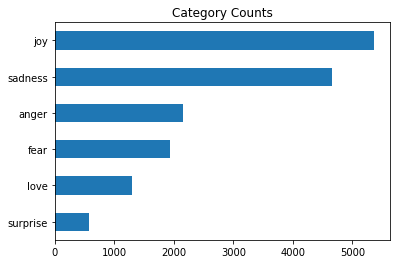

In [ ]:
df['label_name'].value_counts(ascending = True).plot.barh()
plt.title('Category Counts')

Our data is highly imbalanced

/usr/local/lib/python3.7/dist-packages/matplotlib/cbook/__init__.py:1376: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  X = np.atleast_1d(X.T if isinstance(X, np.ndarray) else np.asarray(X))


Text(0.5, 0, '')

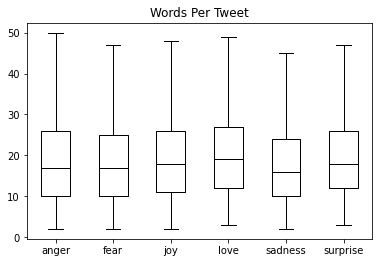

In [ ]:
df['Words Per Tweet'] = df['text'].str.split().apply(len)
df.boxplot('Words Per Tweet', by = 'label_name', grid = False, showfliers = False, color = 'black')
plt.suptitle("")
plt.xlabel("")

From the plot we see that for each emotion, most tweets are around 15 words long and the
longest tweets are well below BERT’s maximum context size of 512 tokens.

Having a large vocabulary is a problem is that it requires neural networks with an enormous number of parameters. A common approach is to
limit the vocabulary and discard rare words by considering say the 100,000 most common words in the corpus. But we miss misspelled and rare words. So we use Subword Tokenisation that allows model to deal with rare characters combinations and mispellings

Here we use DistilBERT which is a variant of BERT and performs equilavalent to bert and a also smaller in size

In [ ]:
model_name = 'distilbert-base-uncased'
tokenizer = AutoTokenizer.from_pretrained(model_name)
print(tokenizer.vocab_size)
print(tokenizer.special_tokens_map)  # UNK: Unknown words ,MASK: masked language modelling, CLS & SEP: to predict is 2 sentences are consecutive
print(tokenizer.model_max_length)     # Max context size
encoded_str = tokenizer.encode('Now we are having NLP Discussion with Mam')
encoded_str

Downloading:   0%|          | 0.00/28.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/483 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/226k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/455k [00:00<?, ?B/s]

30522
{'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'}
512


[101, 2085, 2057, 2024, 2383, 17953, 2361, 6594, 2007, 5003, 2213, 102]

In [ ]:
for token in encoded_str:
    print(token, tokenizer.decode([token]))

101 [CLS]
2085 now
2057 we
2024 are
2383 having
17953 nl
2361 ##p
6594 discussion
2007 with
5003 ma
2213 ##m
102 [SEP]


The ## prefix signifies that
the preceding string is not a whitespace and that it should be merged with the previous token

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available () else "cpu")
model = AutoModel.from_pretrained(model_name).to(device)

Downloading:   0%|          | 0.00/256M [00:00<?, ?B/s]

Some weights of the model checkpoint at distilbert-base-uncased were not used when initializing DistilBertModel: ['vocab_transform.bias', 'vocab_layer_norm.weight', 'vocab_projector.weight', 'vocab_transform.weight', 'vocab_layer_norm.bias', 'vocab_projector.bias']
- This IS expected if you are initializing DistilBertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DistilBertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [ ]:
text = 'this is a test'
text_tensor = tokenizer.encode(text, return_tensors = 'pt').to(device)

return_tensors="pt" ensures that the encodings are in the form of
PyTorch tensors, and we apply the to(device) function to ensure the model and the inputs
are on the same device.

In [ ]:
print(text_tensor)
print(text_tensor.shape)
text_tensor = tokenizer.encode(text, return_tensors = 'pt', padding = True, truncation = True).to(device)
print(text_tensor)
print(text_tensor.shape)

tensor([[ 101, 2023, 2003, 1037, 3231,  102]], device='cuda:0')
torch.Size([1, 6])
tensor([[ 101, 2023, 2003, 1037, 3231,  102]], device='cuda:0')
torch.Size([1, 6])


In [ ]:
output = model(text_tensor)
output.last_hidden_state.shape  #[batch_size, n_tokens,hidden_dim]

torch.Size([1, 6, 768])

In [ ]:
# Tokenizing whole dataset
def tokenize(batch):
    return tokenizer(batch['text'], padding = True, truncation = True)

 padding=True will pad the examples with zeroes to the longest one in a batch, and
truncation=True will truncate the examples to the model’s maximum context size.


In [ ]:
# Resetting the output format from Pandas
emotions.reset_format()

In [ ]:
tokenize(emotions['train'][:3])

{'input_ids': [[101, 1045, 2134, 2102, 2514, 26608, 102, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [101, 1045, 2064, 2175, 2013, 3110, 2061, 20625, 2000, 2061, 9636, 17772, 2074, 2013, 2108, 2105, 2619, 2040, 14977, 1998, 2003, 8300, 102], [101, 10047, 9775, 1037, 3371, 2000, 2695, 1045, 2514, 20505, 3308, 102, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]], 'attention_mask': [[1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]]}

each sequence in input_ids starts with 101 and ends with 102,
followed by zeroes, corresponding to the [CLS], [SEP], and [PAD] tokens respectively

Also note that in addition to returning the encoded tweets as input_ids, the tokenizer also
returns list of attention_mask arrays. This is because we do not want the model to get
confused by the additional padding tokens, so the attention mask allows the model to ignore the
padded parts of the input.

In [ ]:
# Tokenize whole emotion corpus
emotions_encoded = emotions.map(tokenize, batched = True, batch_size = None)

Parameter 'function'=<function tokenize at 0x7fdfe0565b00> of the transform datasets.arrow_dataset.Dataset._map_single couldn't be hashed properly, a random hash was used instead. Make sure your transforms and parameters are serializable with pickle or dill for the dataset fingerprinting and caching to work. If you reuse this transform, the caching mechanism will consider it to be different from the previous calls and recompute everything. This warning is only showed once. Subsequent hashing failures won't be showed.


  0%|          | 0/1 [00:00<?, ?ba/s]

  0%|          | 0/1 [00:00<?, ?ba/s]

  0%|          | 0/1 [00:00<?, ?ba/s]

batched=True will encode the tweets in batches, while batch_size=None
applies our tokenize function in one single batch and ensures that the input tensors and
attention masks have the same shape globally.

In [ ]:
emotions_encoded['train'].features

{'attention_mask': Sequence(feature=Value(dtype='int8', id=None), length=-1, id=None),
 'input_ids': Sequence(feature=Value(dtype='int32', id=None), length=-1, id=None),
 'label': ClassLabel(num_classes=6, names=['sadness', 'joy', 'love', 'anger', 'fear', 'surprise'], id=None),
 'text': Value(dtype='string', id=None)}

In [ ]:
# Extract hidden states from numercally converted tweets to feed it to classifier
def forward_pass(batch):
    input_ids = torch.tensor(batch['input_ids']).to(device)
    attention_mask = torch.tensor(batch['attention_mask']).to(device)

    with torch.no_grad():
        last_hidden_state = model(input_ids, attention_mask).last_hidden_state
        last_hidden_state = last_hidden_state.cpu().numpy()
    
    lhs_shape = last_hidden_state.shape
    boolean_mask = ~np.array(batch['attention_mask']).astype(bool)
    boolean_mask = np.repeat(boolean_mask, lhs_shape[-1], axis = -1)
    boolean_mask = boolean_mask.reshape(lhs_shape)
    masked_mean = np.ma.array(last_hidden_state, mask = boolean_mask).mean(axis = 1)
    batch['hidden_state'] = masked_mean.data 
    return batch 

emotions_encoded = emotions_encoded.map(forward_pass, batched = True, batch_size = 16)

  0%|          | 0/1000 [00:00<?, ?ba/s]

  0%|          | 0/125 [00:00<?, ?ba/s]

  0%|          | 0/125 [00:00<?, ?ba/s]

In [ ]:
emotions_encoded['train'].features 

{'attention_mask': Sequence(feature=Value(dtype='int8', id=None), length=-1, id=None),
 'hidden_state': Sequence(feature=Value(dtype='float64', id=None), length=-1, id=None),
 'input_ids': Sequence(feature=Value(dtype='int32', id=None), length=-1, id=None),
 'label': ClassLabel(num_classes=6, names=['sadness', 'joy', 'love', 'anger', 'fear', 'surprise'], id=None),
 'text': Value(dtype='string', id=None)}

In [ ]:
X_train = np.array(emotions_encoded['train']['hidden_state'])
X_valid = np.array(emotions_encoded['validation']['hidden_state'])
y_train = np.array(emotions_encoded['train']['hidden_state'])
y_valid = np.array(emotions_encoded['validation']['hidden_state'])
print(X_train.shape, X_valid.shape, y_train.shape, y_valid.shape)

(16000, 768) (2000, 768) (16000, 768) (2000, 768)


we’ll use the powerful UMAP
algorithm to project the vectors down to 2D. Since UMAP works best when the features are
scaled to lie in the [0,1] interval, we’ll first apply a MinMaxScaler and then use UMAP to
reduce the hidden states

In [ ]:
X_scaled = MinMaxScaler().fit_transform(X_train)
mapper = UMAP(n_components=2, metric="cosine").fit(X_scaled)
df_emb = pd.DataFrame(mapper.embedding_, columns=['X', 'Y'])
#df_emb['label'] = y_train
df_emb.head()

,X,Y
0,6.157208,5.064087
1,1.440018,4.479034
2,5.696433,2.021717
3,2.350614,3.102145
4,0.466833,6.913999


In [ ]:
y_valid

array([[-0.31691316,  0.25380208,  0.51347301, ...,  0.15304448,
         0.0570747 ,  0.18352036],
       [ 0.2153025 ,  0.27342886,  0.11756505, ..., -0.00571259,
         0.139319  ,  0.2186466 ],
       [ 0.47168607,  0.29588813,  0.30335164, ...,  0.1659347 ,
         0.16078287,  0.1628378 ],
       ...,
       [ 0.0132883 ,  0.32458451,  0.09121259, ...,  0.04413524,
        -0.01558481,  0.03363658],
       [ 0.28357322,  0.14929376,  0.25640363, ..., -0.10758076,
         0.06865153, -0.17617967],
       [ 0.30672715,  0.02154805,  0.23669863, ..., -0.11113019,
         0.10140678,  0.07306386]])

In [ ]:
x_t = X_train
y_t = y_train
print(x_t.shape)
x_t = x_t.reshape(-1,1)
y_t = y_t.reshape(-1,1)
print(x_t.shape)

(16000, 768)
(12288000, 1)


In [ ]:
lr_clf = LogisticRegression(n_jobs = -1, penalty = 'none')
lr_clf.fit(x_t, y_t)
lr_clf.score(X_valid, y_valid)

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


ValueError: ignored

# Language Generation using OpenAI GPT 2 and Text Summarisation using Google AI T5

In [ ]:
!pip install transformers

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 4.4 MB 34.3 MB/s 
     |████████████████████████████████| 596 kB 60.4 MB/s 
     |████████████████████████████████| 6.6 MB 43.7 MB/s 
     |████████████████████████████████| 101 kB 9.6 MB/s 
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


In [ ]:
import torch
from transformers import GPT2LMHeadModel, GPT2Tokenizer
import numpy as np

In [ ]:
tokenizer = GPT2Tokenizer.from_pretrained('gpt2')
model = GPT2LMHeadModel.from_pretrained('gpt2')

Downloading:   0%|          | 0.00/0.99M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/446k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/665 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/523M [00:00<?, ?B/s]

In [ ]:
sequence = ("We have a meeting today on Natural Language Processing. We had to learn about transformers, RNN and github. We learnt a lot from")
inputs = tokenizer.encode(sequence, return_tensors = 'pt')

In [ ]:
outputs = model.generate(inputs, max_length = 200, do_sample = True)

The attention mask and the pad token id were not set. As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.
Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.


In [ ]:
text = tokenizer.decode(outputs[0], skip_special_tokens = True)
print(text)

We have a meeting today on Natural Language Processing. We had to learn about transformers, RNN and github. We learnt a lot from my past work with a bot called RNN. After working with BDD for almost 3 years we decided to start using the new BDD implementation. We use it in our own training system. To get full advantage of BDD you're welcome to write a BDD configuration file (you can even set the parameters to be a batch). Then a post gets posted on the community-blog. A pre-requisites for C/C++ for example need to have knowledge on how to write code.

So, next is the RNN setup. This is the main part of the system. This will handle batch processing, binary transformation and computation. However we also will try to have some general programming tools (Java, F# and C++) and I encourage any users to experiment and use the code below. We hope you like it. The goal


In [ ]:
import torch
from transformers import AutoTokenizer, AutoModelWithLMHead
import numpy as np

In [ ]:
tokenizer = AutoTokenizer.from_pretrained('t5-base')
model = AutoModelWithLMHead.from_pretrained('t5-base', return_dict = True)

Downloading:   0%|          | 0.00/1.17k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/773k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.32M [00:00<?, ?B/s]

/usr/local/lib/python3.7/dist-packages/transformers/models/t5/tokenization_t5_fast.py:166: FutureWarning: This tokenizer was incorrectly instantiated with a model max length of 512 which will be corrected in Transformers v5.
For now, this behavior is kept to avoid breaking backwards compatibility when padding/encoding with `truncation is True`.
- Be aware that you SHOULD NOT rely on t5-base automatically truncating your input to 512 when padding/encoding.
- If you want to encode/pad to sequences longer than 512 you can either instantiate this tokenizer with `model_max_length` or pass `max_length` when encoding/padding.
- To avoid this warning, please instantiate this tokenizer with `model_max_length` set to your preferred value.
  FutureWarning,
/usr/local/lib/python3.7/dist-packages/transformers/models/auto/modeling_auto.py:973: FutureWarning: The class `AutoModelWithLMHead` is deprecated and will be removed in a future version. Please use `AutoModelForCausalLM` for causal language mo

Downloading:   0%|          | 0.00/850M [00:00<?, ?B/s]

In [ ]:
sequence = ("Modern natural language processing techniques are now able to accurately assess in real time the sentiment, toxicity, and hot topics of conversation occurring in a workplace. This is probably something valued by top management but viewed with suspicion by the workforce in general. Everything you say over Teams, phone, and email, could be interpreted by faceless software and evaluated. Obviously, such approaches are open to interpretation. The danger is that some quiet and somewhat anti-social programmer decides that anything rambunctious or enthusiastic is to be labeled as counter-productive and the workplaces get turned into a morgue. But that is only one possible outcome.")

In [ ]:
inputs = tokenizer.encode("summarize: " + sequence, return_tensors = 'pt', max_length = 512, truncation = True)

In [ ]:
outputs = model.generate(inputs, max_length = 60, min_length =  40, length_penalty = 5., num_beams = 2)

In [ ]:
summary = tokenizer.decode(outputs[0])
print(summary)

<pad> natural language processing techniques can assess in real time the sentiment, toxicity, and hot topics of conversation occurring in a workplace. aaron carroll: the danger is that some quiet and somewhat anti-social programmer decides that anything rambunctious or enthusiastic


# Tokenisation

Source: 
* https://web.stanford.edu/~jurafsky/slp3/slides/2_TextProc_Mar_25_2021.pdf
* https://www.geeksforgeeks.org/removing-stop-words-nltk-python/?ref=lbp

In [ ]:
import nltk
from nltk.tokenize import sent_tokenize, word_tokenize
from nltk.corpus import stopwords

In [ ]:
nltk.download('punkt')
nltk.download('stopwords')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

Lets tokenise the sentence. Tokenise means just splitting the sentence into words.

In [ ]:
text = 'Now working with a nltk for tokenisation'
print(sent_tokenize(text))
print(word_tokenize(text))
print(text.split())

['Now working with a nltk for tokenisation']
['Now', 'working', 'with', 'a', 'nltk', 'for', 'tokenisation']
['Now', 'working', 'with', 'a', 'nltk', 'for', 'tokenisation']


We now find similarity: Why dont we use string split() fn rather than tokenise. Tokenise has many other ways of splitting which we will see later and hence goo practice to use it in NLP. 

But wait 'a' doesnt provide any meaningfull sense and should be removed. So we to upgrade our tokenisation using stopwords.

In [ ]:
print(stopwords.words('english'))

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so', 'than', '

In [ ]:
stop_words = set(stopwords.words('english'))
word_tokens = word_tokenize(text)
filtered_sentence = [w for w in word_tokens if not w.lower() in stop_words] 
print(filtered_sentence)

# OR

filtered_sentence = []
for w in  word_tokens:
    if w.lower() not in stop_words:
        filtered_sentence.append(w)
print(word_tokens)
print(filtered_sentence)

['working', 'nltk', 'tokenisation']
['Now', 'working', 'with', 'a', 'nltk', 'for', 'tokenisation']
['working', 'nltk', 'tokenisation']


Hmm now feels good. 

# Other

In [ ]:
!pip install d2l

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 82 kB 611 kB/s 
     |████████████████████████████████| 61 kB 8.9 MB/s 
     |████████████████████████████████| 9.9 MB 50.7 MB/s 
     |████████████████████████████████| 11.2 MB 40.2 MB/s 
     |████████████████████████████████| 15.7 MB 47.1 MB/s 
     |████████████████████████████████| 930 kB 45.9 MB/s 
  Attempting uninstall: numpy
    Found existing installation: numpy 1.21.6
    Uninstalling numpy-1.21.6:
      Successfully uninstalled numpy-1.21.6
  Attempting uninstall: requests
    Found existing installation: requests 2.23.0
    Uninstalling requests-2.23.0:
      Successfully uninstalled requests-2.23.0
  Attempting uninstall: pandas
    Found existing installation: pandas 1.3.5
    Uninstalling pandas-1.3.5:
      Successfully uninstalled pandas-1.3.5
  Attempting uninstall: matplotlib
    Found existing installation: matplotlib 3.2.2
    

In [ ]:
%matplotlib inline
import tensorflow as tf 
from d2l import tensorflow as d2l

In [ ]:
!pip3 uninstall matplotlib -y
!pip3 install matplotlib==3.0.1

Found existing installation: matplotlib 3.5.1
Uninstalling matplotlib-3.5.1:
  Successfully uninstalled matplotlib-3.5.1
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 12.9 MB 6.1 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
plotnine 0.6.0 requires matplotlib>=3.1.1, but you have matplotlib 3.0.1 which is incompatible.
mizani 0.6.0 requires matplotlib>=3.1.1, but you have matplotlib 3.0.1 which is incompatible.
d2l 0.17.5 requires matplotlib==3.5.1, but you have matplotlib 3.0.1 which is incompatible.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.


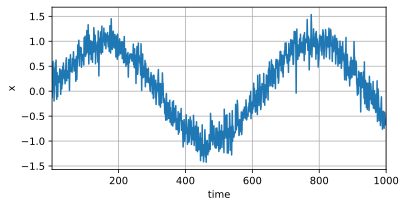

In [ ]:
%matplotlib inline
import tensorflow as tf
from d2l import tensorflow as d2l

T = 1000  # Generate a total of 1000 points
time = tf.range(1, T + 1, dtype=tf.float32)
x = tf.sin(0.01 * time) + tf.random.normal([T], 0, 0.2)
d2l.plot(time, [x], 'time', 'x', xlim=[1, 1000], figsize=(6, 3))

In [ ]:
x

<tf.Tensor: shape=(1000,), dtype=float32, numpy=
array([-1.28696457e-01,  2.20199134e-02,  4.77458686e-01,  5.96655786e-01,
        1.86671138e-01,  4.68406022e-01, -1.96648672e-01,  1.60434484e-01,
        1.77991360e-01,  1.23487502e-01,  5.67856431e-01,  1.32457778e-01,
        6.21750116e-01, -3.18543911e-02, -1.62192002e-01,  3.74953538e-01,
        2.56911606e-01, -1.08990207e-01,  2.86136121e-01,  3.03723782e-01,
        2.95497298e-01,  1.75727606e-01,  2.80505389e-01,  4.47519600e-01,
        4.19796407e-01,  2.27087826e-01, -6.36138022e-02,  4.22962248e-01,
        1.73352540e-01,  4.53080237e-02,  1.70563459e-01,  1.42447636e-01,
        4.92309988e-01,  2.49362856e-01,  5.65133214e-01,  3.37915123e-01,
        4.28331196e-01,  3.47568303e-01,  2.55155474e-01,  1.49266422e-01,
        2.55123436e-01,  4.27273095e-01,  6.20872021e-01,  6.68940187e-01,
        2.07224488e-01,  3.67135972e-01,  3.39580119e-01,  3.91425520e-01,
        4.11949545e-01,  2.58898318e-01,  6.3703817

In [ ]:
x[1:3]

<tf.Tensor: shape=(2,), dtype=float32, numpy=array([0.02201991, 0.4774587 ], dtype=float32)>

In [ ]:
tau = 4
features = tf.Variable(tf.zeros((T-tau, tau)))  # WHY?
print(type(features))
print(features.shape)
features

<class 'tensorflow.python.ops.resource_variable_ops.ResourceVariable'>
(996, 4)


<tf.Variable 'Variable:0' shape=(996, 4) dtype=float32, numpy=
array([[0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       ...,
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.]], dtype=float32)>

In [ ]:
for i in range(tau):
    features[:,i].assign(x[i:T-tau + i])
features

<tf.Variable 'Variable:0' shape=(996, 4) dtype=float32, numpy=
array([[-0.12869646,  0.02201991,  0.4774587 ,  0.5966558 ],
       [ 0.02201991,  0.4774587 ,  0.5966558 ,  0.18667114],
       [ 0.4774587 ,  0.5966558 ,  0.18667114,  0.46840602],
       ...,
       [-0.7440806 , -0.5251223 , -0.42931774, -0.58008754],
       [-0.5251223 , -0.42931774, -0.58008754, -0.6761933 ],
       [-0.42931774, -0.58008754, -0.6761933 , -0.6734669 ]],
      dtype=float32)>

In [ ]:
features[:2]

<tf.Tensor: shape=(2, 4), dtype=float32, numpy=
array([[-0.12869646,  0.02201991,  0.4774587 ,  0.5966558 ],
       [ 0.02201991,  0.4774587 ,  0.5966558 ,  0.18667114]],
      dtype=float32)>

In [ ]:
labels = tf.reshape(x[tau:],(-1,1))
print(labels)

tf.Tensor(
[[ 1.86671138e-01]
 [ 4.68406022e-01]
 [-1.96648672e-01]
 [ 1.60434484e-01]
 [ 1.77991360e-01]
 [ 1.23487502e-01]
 [ 5.67856431e-01]
 [ 1.32457778e-01]
 [ 6.21750116e-01]
 [-3.18543911e-02]
 [-1.62192002e-01]
 [ 3.74953538e-01]
 [ 2.56911606e-01]
 [-1.08990207e-01]
 [ 2.86136121e-01]
 [ 3.03723782e-01]
 [ 2.95497298e-01]
 [ 1.75727606e-01]
 [ 2.80505389e-01]
 [ 4.47519600e-01]
 [ 4.19796407e-01]
 [ 2.27087826e-01]
 [-6.36138022e-02]
 [ 4.22962248e-01]
 [ 1.73352540e-01]
 [ 4.53080237e-02]
 [ 1.70563459e-01]
 [ 1.42447636e-01]
 [ 4.92309988e-01]
 [ 2.49362856e-01]
 [ 5.65133214e-01]
 [ 3.37915123e-01]
 [ 4.28331196e-01]
 [ 3.47568303e-01]
 [ 2.55155474e-01]
 [ 1.49266422e-01]
 [ 2.55123436e-01]
 [ 4.27273095e-01]
 [ 6.20872021e-01]
 [ 6.68940187e-01]
 [ 2.07224488e-01]
 [ 3.67135972e-01]
 [ 3.39580119e-01]
 [ 3.91425520e-01]
 [ 4.11949545e-01]
 [ 2.58898318e-01]
 [ 6.37038171e-01]
 [ 5.14764309e-01]
 [ 1.44093335e-02]
 [ 3.78620505e-01]
 [ 5.88763297e-01]
 [ 7.30296969e-01]
 

In [ ]:
labels[:2]

<tf.Tensor: shape=(2, 1), dtype=float32, numpy=
array([[0.18667114],
       [0.46840602]], dtype=float32)>

In [ ]:
batch_size, n_train = 16,600
train_iter = d2l.load_array((features[:n_train], labels[:n_train]), batch_size, is_train = True)

In [ ]:
def get_net():
    net = tf.keras.Sequential([tf.keras.layers.Dense(10, activation = 'relu'), tf.keras.layers.Dense(1)])
    return net    

loss = tf.keras.losses.MeanSquaredError()

In [ ]:
def train(net, train_iter, loss, epochs, lr):
    trainer = tf.keras.optimizers.Adam()
    for epoch in range(epochs):
        for X,y in train_iter:
            with tf.GradientTape() as g:
                out = net(X)
                l = loss(y,out)
                params = net.trainable_variables
                grads = g.gradient(l,params)
            trainer.apply_gradients(zip(grads, params))
        print(f'epoch {epoch + 1}, 'f'loss: {d2l.evaluate_loss(net, train_iter, loss):f}')

net = get_net()
train(net, train_iter, loss, 5, 0.01)

epoch 1, loss: 0.765438
epoch 2, loss: 0.524389
epoch 3, loss: 0.354335
epoch 4, loss: 0.242400
epoch 5, loss: 0.163221


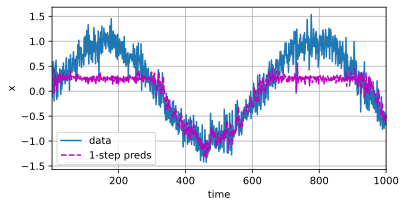

In [ ]:
onestep_preds = net(features)
d2l.plot([time, time[tau:]], [x.numpy(), onestep_preds.numpy()], 'time','x', legend=['data', '1-step preds'], xlim=[1, 1000], figsize=(6, 3))

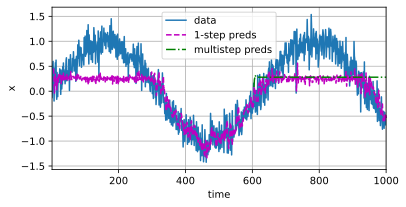

In [ ]:
multistep_preds = tf.Variable(tf.zeros(T))
multistep_preds[:n_train + tau].assign(x[:n_train + tau])
for i in range(n_train + tau, T):
    multistep_preds[i].assign(tf.reshape(net(
        tf.reshape(multistep_preds[i - tau: i], (1, -1))), ()))

d2l.plot([time, time[tau:], time[n_train + tau:]],[x.numpy(), onestep_preds.numpy(),multistep_preds[n_train + tau:].numpy()], 'time','x', legend=['data', '1-step preds', 'multistep preds'],xlim=[1, 1000], figsize=(6, 3))

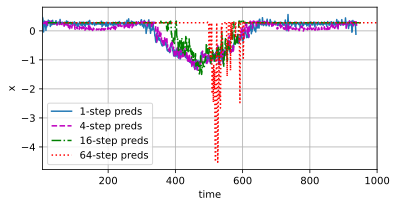

In [ ]:
max_steps = 64

features = tf.Variable(tf.zeros((T - tau - max_steps + 1, tau + max_steps)))
# Column `i` (`i` < `tau`) are observations from `x` for time steps from
# `i + 1` to `i + T - tau - max_steps + 1`
for i in range(tau):
    features[:, i].assign(x[i: i + T - tau - max_steps + 1].numpy())

# Column `i` (`i` >= `tau`) are the (`i - tau + 1`)-step-ahead predictions for
# time steps from `i + 1` to `i + T - tau - max_steps + 1`
for i in range(tau, tau + max_steps):
    features[:, i].assign(tf.reshape(net((features[:, i - tau: i])), -1))

steps = (1, 4, 16, 64)
d2l.plot([time[tau + i - 1: T - max_steps + i] for i in steps],
         [features[:, (tau + i - 1)].numpy() for i in steps], 'time', 'x',
         legend=[f'{i}-step preds' for i in steps], xlim=[5, 1000],
         figsize=(6, 3))

# Text Processing

https://d2l.ai/chapter_recurrent-neural-networks/text-preprocessing.html

In [ ]:
import collections
import re 
from d2l import tensorflow as d2l

In [ ]:
d2l.DATA_HUB['time_machine'] = (d2l.DATA_URL + 'timemachine.txt', '090b5e7e70c295757f55df93cb0a180b9691891a')
def read_time_machine():
    with open(d2l.download('time_machine'), 'r') as f:
        lines = f.readlines()
    return [re.sub('[^A-Za-z]+', ' ', line).strip().lower() for line in lines]   # Ignoring Punctuation and Capitalization

lines = read_time_machine()
print(f"# text_lines: {len(lines)}")
print(lines[0])
print(lines[10])

# text_lines: 3221
the time machine by h g wells
twinkled and his usually pale face was flushed and animated the


In [ ]:
def tokenize(lines, token = 'word'):
    if token == 'word':
        return [line.split() for line in lines] 
    elif token == 'char':
        return [list(line) for line in lines]
    else:
        print('ERROR: unknown token type: '+token)
    
tokens = tokenize(lines)
print(tokens)

[['the', 'time', 'machine', 'by', 'h', 'g', 'wells'], [], [], [], [], ['i'], [], [], ['the', 'time', 'traveller', 'for', 'so', 'it', 'will', 'be', 'convenient', 'to', 'speak', 'of', 'him'], ['was', 'expounding', 'a', 'recondite', 'matter', 'to', 'us', 'his', 'grey', 'eyes', 'shone', 'and'], ['twinkled', 'and', 'his', 'usually', 'pale', 'face', 'was', 'flushed', 'and', 'animated', 'the'], ['fire', 'burned', 'brightly', 'and', 'the', 'soft', 'radiance', 'of', 'the', 'incandescent'], ['lights', 'in', 'the', 'lilies', 'of', 'silver', 'caught', 'the', 'bubbles', 'that', 'flashed', 'and'], ['passed', 'in', 'our', 'glasses', 'our', 'chairs', 'being', 'his', 'patents', 'embraced', 'and'], ['caressed', 'us', 'rather', 'than', 'submitted', 'to', 'be', 'sat', 'upon', 'and', 'there', 'was', 'that'], ['luxurious', 'after', 'dinner', 'atmosphere', 'when', 'thought', 'roams', 'gracefully'], ['free', 'of', 'the', 'trammels', 'of', 'precision', 'and', 'he', 'put', 'it', 'to', 'us', 'in', 'this'], ['way

In [ ]:
#token = tokenize(lines, token = 'char')
#print(token)

In [ ]:
# Vocabulary mapping tokens to numerical inputs
# STEPS:
# Count unique tokens in all documents from training set
# Assign a numerical index to each unique token according to its frequency
# Rarely appeared token are removed
# Any token that does not exist or been removed from corpus is assigned unk token
# Add reserved tokens <pad> for padding and <bos> and <eos> for marking beginning and end of sequence.

class Vocab:
    def __init__(self, tokens = None, min_freq = 0, reserved_tokens = None):
        if tokens is None:
            tokens = []
        if reserved_tokens is None:
            reserved_tokens = []
        
        # Sort according to frequencies
        counter = count_corpus(tokens)
        self._token_freqs = sorted(counter.items(),key = lambda x:x[1], reverse = True)

        # The index for unknown token is 0
        self.idx_to_token = ['<unk>'] + reserved_tokens
        self.token_to_idx = {token: idx for idx, token in enumerate(self.idx_to_token)}

        for token, freq in self._token_freqs:
            if freq < min_freq:
                break
            if token not in self.token_to_idx:
                self.idx_to_token.append(token)
                self.token_to_idx[token] = len(self.idx_to_token) - 1
    
    def __len__(self):
        return len(self.idx_to_token)
    
    def __getitem__(self,tokens):
        if not isinstance(tokens, (list,tuple)):
            return self.token_to_idx.get(tokens, self.unk)
        return [self.__getitem__(token) for token in tokens] 
    
    def to_tokens(self,indices):
        if not isinstance(indices, (list,tuple)):
            return self.idx_to_token[indices]
        return [self.idx_to_token[index] for index in indices]
    
    def unk(self):
        return 0
    
    def token_freqs(self):
        return self._token_freqs

def count_corpus(tokens):
    if len(tokens) == 0 or isinstance(tokens[0], list):
        tokens = [token for line in tokens for token in line]
    return collections.Counter(tokens)

vocab = Vocab(tokens)
print(list(vocab.token_to_idx.items()))


[('<unk>', 0), ('the', 1), ('i', 2), ('and', 3), ('of', 4), ('a', 5), ('to', 6), ('was', 7), ('in', 8), ('that', 9), ('my', 10), ('it', 11), ('had', 12), ('me', 13), ('as', 14), ('at', 15), ('for', 16), ('with', 17), ('but', 18), ('time', 19), ('were', 20), ('this', 21), ('you', 22), ('on', 23), ('then', 24), ('his', 25), ('there', 26), ('he', 27), ('have', 28), ('they', 29), ('from', 30), ('one', 31), ('all', 32), ('not', 33), ('into', 34), ('upon', 35), ('little', 36), ('so', 37), ('is', 38), ('came', 39), ('by', 40), ('some', 41), ('be', 42), ('no', 43), ('could', 44), ('their', 45), ('said', 46), ('saw', 47), ('down', 48), ('them', 49), ('machine', 50), ('which', 51), ('very', 52), ('or', 53), ('an', 54), ('we', 55), ('now', 56), ('what', 57), ('been', 58), ('these', 59), ('like', 60), ('her', 61), ('out', 62), ('seemed', 63), ('up', 64), ('man', 65), ('about', 66), ('s', 67), ('its', 68), ('thing', 69), ('again', 70), ('traveller', 71), ('would', 72), ('more', 73), ('white', 74), 

In [ ]:
tokens

[['the', 'time', 'machine', 'by', 'h', 'g', 'wells'],
 [],
 [],
 [],
 [],
 ['i'],
 [],
 [],
 ['the',
  'time',
  'traveller',
  'for',
  'so',
  'it',
  'will',
  'be',
  'convenient',
  'to',
  'speak',
  'of',
  'him'],
 ['was',
  'expounding',
  'a',
  'recondite',
  'matter',
  'to',
  'us',
  'his',
  'grey',
  'eyes',
  'shone',
  'and'],
 ['twinkled',
  'and',
  'his',
  'usually',
  'pale',
  'face',
  'was',
  'flushed',
  'and',
  'animated',
  'the'],
 ['fire',
  'burned',
  'brightly',
  'and',
  'the',
  'soft',
  'radiance',
  'of',
  'the',
  'incandescent'],
 ['lights',
  'in',
  'the',
  'lilies',
  'of',
  'silver',
  'caught',
  'the',
  'bubbles',
  'that',
  'flashed',
  'and'],
 ['passed',
  'in',
  'our',
  'glasses',
  'our',
  'chairs',
  'being',
  'his',
  'patents',
  'embraced',
  'and'],
 ['caressed',
  'us',
  'rather',
  'than',
  'submitted',
  'to',
  'be',
  'sat',
  'upon',
  'and',
  'there',
  'was',
  'that'],
 ['luxurious',
  'after',
  'dinner',

In [ ]:
for i in [0,10]:
    print('words:',i, tokens[i])
    print('indices:', vocab[tokens[i]])

words: 0 ['the', 'time', 'machine', 'by', 'h', 'g', 'wells']
indices: [1, 19, 50, 40, 2183, 2184, 400]
words: 10 ['twinkled', 'and', 'his', 'usually', 'pale', 'face', 'was', 'flushed', 'and', 'animated', 'the']
indices: [2186, 3, 25, 1044, 362, 113, 7, 1421, 3, 1045, 1]


In [ ]:
def load_corpus_time_machine(max_tokens=-1):  
    """Return token indices and the vocabulary of the time machine dataset."""
    lines = read_time_machine()
    tokens = tokenize(lines, 'char')
    vocab = Vocab(tokens)
    # Since each text line in the time machine dataset is not necessarily a
    # sentence or a paragraph, flatten all the text lines into a single list
    corpus = [vocab[token] for line in tokens for token in line]
    if max_tokens > 0:
        corpus = corpus[:max_tokens]
    return corpus, vocab

corpus, vocab = load_corpus_time_machine()
len(corpus), len(vocab)

(170580, 28)

# Visualising Neural Network Architectures

In [ ]:
%load_ext tensorboard

In [ ]:
from datetime import datetime
from packaging import version

import tensorflow as tf
from tensorflow import keras

print("TensorFlow version: ", tf.__version__)
assert version.parse(tf.__version__).release[0] >= 2, \
    "This notebook requires TensorFlow 2.0 or above."
import tensorboard
tensorboard.__version__

TensorFlow version:  2.8.2


'2.8.0'

In [ ]:
rm -rf ./logs/

In [ ]:
model = keras.models.Sequential([
    keras.layers.Flatten(input_shape=(28, 28)),
    keras.layers.Dense(32, activation='relu'),
    keras.layers.Dropout(0.2),
    keras.layers.Dense(10, activation='softmax')
])

model.compile(
    optimizer='adam',
    loss='sparse_categorical_crossentropy',
    metrics=['accuracy'])

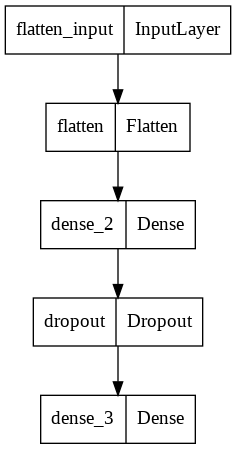

In [ ]:
tf.keras.utils.plot_model(model)

In [ ]:
(train_images, train_labels), _ = keras.datasets.fashion_mnist.load_data()
train_images = train_images / 255.0

4431872/4422102 [==============================] - 0s 0us/step


In [ ]:
# Define the Keras TensorBoard callback.
logdir="logs/fit/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = keras.callbacks.TensorBoard(log_dir=logdir)

# Train the model.
model.fit(
    train_images,
    train_labels, 
    batch_size=64,
    epochs=5, 
    callbacks=[tensorboard_callback])

Epoch 1/5
938/938 [==============================] - 4s 3ms/step - loss: 0.7022 - accuracy: 0.7619
Epoch 2/5
938/938 [==============================] - 3s 3ms/step - loss: 0.4959 - accuracy: 0.8275
Epoch 3/5
938/938 [==============================] - 2s 2ms/step - loss: 0.4551 - accuracy: 0.8372
Epoch 4/5
938/938 [==============================] - 2s 2ms/step - loss: 0.4361 - accuracy: 0.8444
Epoch 5/5
938/938 [==============================] - 2s 2ms/step - loss: 0.4208 - accuracy: 0.8482


In [ ]:
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

In [ ]:
!tensorboard dev upload \
  --logdir logs \
  --name "Sample op-level graph" \
  --one_shot

2022-06-30 15:02:43.839630: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected

***** TensorBoard Uploader *****

This will upload your TensorBoard logs to https://tensorboard.dev/ from
the following directory:

logs

This TensorBoard will be visible to everyone. Do not upload sensitive
data.

Your use of this service is subject to Google's Terms of Service
<https://policies.google.com/terms> and Privacy Policy
<https://policies.google.com/privacy>, and TensorBoard.dev's Terms of Service
<https://tensorboard.dev/policy/terms/>.

This notice will not be shown again while you are logged into the uploader.
To log out, run `tensorboard dev auth revoke`.

Continue? (yes/NO) yes

Please visit this URL to authorize this application: https://accounts.google.com/o/oauth2/auth?response_type=code&client_id=373649185512-8v619h5kft38l4456nm2dj4ubeqsrvh6.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%

In [ ]:
# The function to be traced.
@tf.function
def my_func(x, y):
  # A simple hand-rolled layer.
  return tf.nn.relu(tf.matmul(x, y))

# Set up logging.
stamp = datetime.now().strftime("%Y%m%d-%H%M%S")
logdir = 'logs/func/%s' % stamp
writer = tf.summary.create_file_writer(logdir)

# Sample data for your function.
x = tf.random.uniform((3, 3))
y = tf.random.uniform((3, 3))

# Bracket the function call with
# tf.summary.trace_on() and tf.summary.trace_export().
tf.summary.trace_on(graph=True, profiler=True)
# Call only one tf.function when tracing.
z = my_func(x, y)
with writer.as_default():
  tf.summary.trace_export(
      name="my_func_trace",
      step=0,
      profiler_outdir=logdir)

Instructions for updating:
use `tf.profiler.experimental.start` instead.
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
Instructions for updating:
`tf.python.eager.profiler` has deprecated, use `tf.profiler` instead.
Instructions for updating:
`tf.python.eager.profiler` has deprecated, use `tf.profiler` instead.


In [ ]:
%tensorboard --logdir logs/func

Reusing TensorBoard on port 6007 (pid 1140), started 0:02:22 ago. (Use '!kill 1140' to kill it.)

<IPython.core.display.Javascript object>

# LSTM Sentiment Analysis

https://www.analyticsvidhya.com/blog/2021/06/natural-language-processing-sentiment-analysis-using-lstm/

In [ ]:
import pandas as pd 
import matplotlib.pyplot as plt
import numpy as np

from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import confusion_matrix 
from sklearn.model_selection import train_test_split

from keras.models import Sequential
from keras.preprocessing.text import Tokenizer 
from keras.preprocessing.sequence import pad_sequences 
from keras.layers import Dense, Embedding, LSTM,Dropout
import tensorflow as tf

from nltk.corpus import stopwords  
from nltk.stem import WordNetLemmatizer
from collections import Counter 
import wordcloud
from nltk.corpus import stopwords 
from textblob import Word 
import re
import nltk

In [ ]:
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [ ]:
df = pd.read_csv('amazon_alexa.tsv', sep = '\t')
df.head()

,rating,date,variation,verified_reviews,feedback
0,5,31-Jul-18,Charcoal Fabric,Love my Echo!,1
1,5,31-Jul-18,Charcoal Fabric,Loved it!,1
2,4,31-Jul-18,Walnut Finish,"Sometimes while playing a game, you can answer...",1
3,5,31-Jul-18,Charcoal Fabric,I have had a lot of fun with this thing. My 4 ...,1
4,5,31-Jul-18,Charcoal Fabric,Music,1


In [ ]:
df.isnull().sum()

rating              0
date                0
variation           0
verified_reviews    0
feedback            0
dtype: int64

In [ ]:
df.shape

(3150, 5)

In [ ]:
df.tail()

,rating,date,variation,verified_reviews,feedback
3145,5,30-Jul-18,Black Dot,"Perfect for kids, adults and everyone in betwe...",1
3146,5,30-Jul-18,Black Dot,"Listening to music, searching locations, check...",1
3147,5,30-Jul-18,Black Dot,"I do love these things, i have them running my...",1
3148,5,30-Jul-18,White Dot,Only complaint I have is that the sound qualit...,1
3149,4,29-Jul-18,Black Dot,Good,1


In [ ]:
df.rating.unique()

array([5, 4, 3, 2, 1])

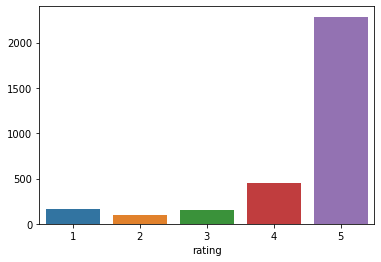

In [ ]:
import seaborn as sns
c = df.groupby('rating')['rating'].count()
sns.barplot(x = c.index, y = c.values)

In [ ]:
print(df['rating'].mean())
print(df['rating'].median())

4.463174603174603
5.0


In [ ]:
# Creating a column if its a review is a +ve review or -ve
def sentiments(df):
    if df['rating'] > 3:
        return 'Positive'
    elif df['rating'] < 3:
        return 'Negative'
df['sentiment'] = df.apply(sentiments, axis = 1)
df.head(5)

,rating,date,variation,verified_reviews,feedback,sentiment
0,5,31-Jul-18,Charcoal Fabric,Love my Echo!,1,Positive
1,5,31-Jul-18,Charcoal Fabric,Loved it!,1,Positive
2,4,31-Jul-18,Walnut Finish,"Sometimes while playing a game, you can answer...",1,Positive
3,5,31-Jul-18,Charcoal Fabric,I have had a lot of fun with this thing. My 4 ...,1,Positive
4,5,31-Jul-18,Charcoal Fabric,Music,1,Positive


In [ ]:
df.dropna(inplace = True)

In [ ]:
import nltk
import re

w_tokenizer = nltk.tokenize.WhitespaceTokenizer()
lemmatizer = nltk.stem.WordNetLemmatizer()

def lemmatize_text(text):
    k = [lemmatizer.lemmatize(w,'v') for w in w_tokenizer.tokenize(text)]
    l = ' '.join(map(str,k))
    return l

def cleaning(df, stopwords):
    # Making all the verified reveiws in small words.  Eg: To make sure that Book and book are represented as same vector in the vector space
    df1['verified_reviews'] = df1['verified_reviews'].apply(lambda x: " ".join(x.lower() for x in x.split()))

    #df1['verified_reviews'] = df1['verified_reviews'].str.replace('^\w', '')
    #df1['verified_reviews'] = df1['verified_reviews'].str.replace('[^a-zA-Z0-9]', ' ')

    df1['verified_reviews'] = df1['verified_reviews'].replace('\!','',regex=True)
    df1['verified_reviews'] = df1['verified_reviews'].replace('\,','',regex=True)
    df1['verified_reviews'] = df1['verified_reviews'].replace('\.','',regex=True)
    df1['verified_reviews'] = df1['verified_reviews'].replace('\&','',regex=True)
    df1['verified_reviews'] = df1['verified_reviews'].replace('\'','',regex=True)
    df1['verified_reviews'] = df1['verified_reviews'].replace('\;','',regex=True)
    df1['verified_reviews'] = df1['verified_reviews'].replace('\#','',regex=True)
    df1['verified_reviews'] = df1['verified_reviews'].replace('\-','',regex=True)
    df1['verified_reviews'] = df1['verified_reviews'].str.replace('\d','')   # Replacing digits and numbers
    df['verified_reviews'] = df['verified_reviews'].apply(lambda x: " ".join(x for x in x.split() if x not in stop_words))
    df['verified_reviews'] = df['verified_reviews'].apply(lemmatize_text)
 # Lemmatizing the word

    return df

df1 = df.copy()
stop_words = stopwords.words('english')
df1 = cleaning(df1,stop_words)
#df = df1.copy()
df1.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:27: FutureWarning: The default value of regex will change from True to False in a future version.


,rating,date,variation,verified_reviews,feedback,sentiment
0,5,31-Jul-18,Charcoal Fabric,love echo,1,Positive
1,5,31-Jul-18,Charcoal Fabric,love,1,Positive
2,4,31-Jul-18,Walnut Finish,sometimes play game answer question correctly ...,1,Positive
3,5,31-Jul-18,Charcoal Fabric,lot fun thing yr old learn dinosaurs control l...,1,Positive
4,5,31-Jul-18,Charcoal Fabric,music,1,Positive


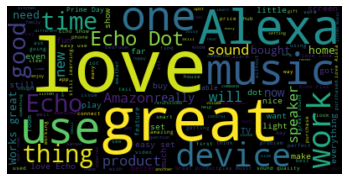

In [ ]:
common_words = ''
for i in df.verified_reviews:
    i = str(i)
    tokens = i.split()
    common_words += " ".join(tokens) + " "
wordcloud = wordcloud.WordCloud().generate(common_words)   
plt.imshow(wordcloud, interpolation = 'bilinear')  # bilinear is used to display smooth images
plt.axis('off')
plt.show()

In [ ]:
# Labelling classes of sentiments from 0 or 1 as here there are only 2 classes. 
lb = LabelEncoder() 
df1['sentiment'] = lb.fit_transform(df1['sentiment'])
df1.head()

,rating,date,variation,verified_reviews,feedback,sentiment
0,5,31-Jul-18,Charcoal Fabric,love echo,1,1
1,5,31-Jul-18,Charcoal Fabric,love,1,1
2,4,31-Jul-18,Walnut Finish,sometimes play game answer question correctly ...,1,1
3,5,31-Jul-18,Charcoal Fabric,lot fun thing yr old learn dinosaurs control l...,1,1
4,5,31-Jul-18,Charcoal Fabric,music,1,1


In [ ]:
k = pd.Series(np.concatenate([x.split() for x in df1.verified_reviews])).value_counts()
a = df1['verified_reviews'].str.lower().str.cat(sep=' ')
words = nltk.tokenize.word_tokenize(a)
word_dist = nltk.FreqDist(words)
print (word_dist)
print(len(word_dist))
rslt = pd.DataFrame(word_dist.most_common(30),
                    columns=['Word', 'Frequency'])
print(rslt)

<FreqDist with 3421 samples and 38788 outcomes>
3421
       Word  Frequency
0      love       1049
1      echo        802
2     great        703
3       use        646
4      work        607
5     alexa        563
6     music        497
7      like        491
8       get        464
9         ’        441
10    sound        385
11      one        331
12     easy        329
13      set        327
14      dot        313
15     play        305
16      buy        303
17     good        253
18  product        237
19     time        231
20   amazon        230
21     home        210
22  speaker        206
23    would        201
24   device        196
25    still        194
26     show        186
27   really        182
28        t        181
29    smart        180


## Base Model

In [ ]:
# Converting reviews into numerical vectors
tokenizer = Tokenizer(num_words = 3421, split = ' ')  # Number of words to keep based on frequency of words. Its a hyperparameter
print("My vocabulary size is: ",3421)
tokenizer.fit_on_texts(df['verified_reviews'].values)
x = tokenizer.texts_to_sequences(df['verified_reviews'].values) # Numerical vectors got created
print(x[0])
print(x[1])
# All neural networks require to have inputs of same size and shape. So we need to pad
x = pad_sequences(x)
print(x[0]) 
print(x[1])

My vocabulary size is:  3421
[10, 7, 12]
[247, 4]
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
 

In [ ]:
print(x.shape)
print(x.shape[1])

(2998, 528)
528


https://keras.io/api/layers/core_layers/embedding/

https://machinelearningmastery.com/how-to-reduce-overfitting-with-dropout-regularization-in-keras/

https://www.sciencedirect.com/science/article/pii/S2405959519303455

In [ ]:
model = Sequential()
model.add(Embedding(input_dim = 3421,output_dim = 120, input_length = x.shape[1]))  # Input dim is vocab size
#model.add(Dropout(0.4))   # 0.4 is again a hyperparameter
model.add(LSTM( units = 176))    # dropout = 0.2, recurrent_dropout = 0.2
model.add(Dense(units = 2, activation = 'softmax'))
model.compile(loss = 'categorical_crossentropy', metrics = ['accuracy'])   #optimizer = 'adam'
print(model.summary())

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_4 (Embedding)     (None, 528, 120)          410520    
                                                                 
 lstm_4 (LSTM)               (None, 176)               209088    
                                                                 
 dense_4 (Dense)             (None, 2)                 354       
                                                                 
Total params: 619,962
Trainable params: 619,962
Non-trainable params: 0
_________________________________________________________________
None


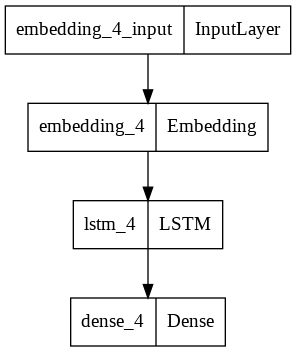

In [ ]:
tf.keras.utils.plot_model(model)

In [ ]:
s = pd.Series(list('abca'))
pd.get_dummies(s)

,a,b,c
0,1,0,0
1,0,1,0
2,0,0,1
3,1,0,0


In [ ]:
# Splitting data into training and testing 
y = pd.get_dummies(df1['sentiment'])
x_train, x_test, y_train, y_test = train_test_split(x,y,test_size = 0.2, random_state = 0)

In [ ]:
print(y)

      0  1
0     0  1
1     0  1
2     0  1
3     0  1
4     0  1
...  .. ..
3145  0  1
3146  0  1
3147  0  1
3148  0  1
3149  0  1

[2998 rows x 2 columns]


In [ ]:
history = model.fit(x_train,y_train, epochs = 10, verbose = 1)  # batch_size = 32

Epoch 1/10
75/75 [==============================] - 4s 27ms/step - loss: 0.2994 - accuracy: 0.9074
Epoch 2/10
75/75 [==============================] - 2s 26ms/step - loss: 0.1847 - accuracy: 0.9291
Epoch 3/10
75/75 [==============================] - 2s 26ms/step - loss: 0.2018 - accuracy: 0.9462
Epoch 4/10
75/75 [==============================] - 2s 26ms/step - loss: 0.0877 - accuracy: 0.9658
Epoch 5/10
75/75 [==============================] - 2s 26ms/step - loss: 0.0664 - accuracy: 0.9758
Epoch 6/10
75/75 [==============================] - 2s 26ms/step - loss: 0.0487 - accuracy: 0.9821
Epoch 7/10
75/75 [==============================] - 4s 48ms/step - loss: 0.0412 - accuracy: 0.9829
Epoch 8/10
75/75 [==============================] - 3s 43ms/step - loss: 0.0325 - accuracy: 0.9858
Epoch 9/10
75/75 [==============================] - 3s 40ms/step - loss: 0.0309 - accuracy: 0.9879
Epoch 10/10
75/75 [==============================] - 3s 40ms/step - loss: 0.0272 - accuracy: 0.9892


In [ ]:
model.evaluate(x_test, y_test)   # Testloss and Test Accuracy

19/19 [==============================] - 1s 18ms/step - loss: 0.3892 - accuracy: 0.9483


[0.3892122209072113, 0.9483333230018616]

In [ ]:
base_accuracy = 0.9383333325386047
base_loss = 0.29819098114967346

### Prediction and Confusion Matrix

In [ ]:
y_pred = model.predict(x_test)

In [ ]:
review_predictions = []
for prediction in y_pred:
    x = prediction
    review_predictions.append(np.argmax(x))

review_predictions = np.array(review_predictions)
review_predictions.reshape(1,-1)
review_predictions.shape

(600,)

In [ ]:
review_predictions1 = pd.get_dummies(review_predictions)
review_predictions1 = review_predictions1.idxmax(axis=1)
y_test = y_test.idxmax(axis=1)

In [ ]:
y_test

324     1
1070    0
1659    1
3088    1
3129    1
       ..
956     1
1495    1
684     1
495     1
1435    1
Length: 600, dtype: int64

In [ ]:
import sklearn
r1 = sklearn.metrics.confusion_matrix(review_predictions1, y_test)
print(r1)

[[ 30   6]
 [ 25 539]]


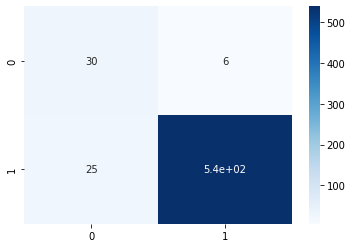

In [ ]:
import seaborn as sns
sns.heatmap(r1, annot=True, cmap = 'Blues')

https://medium.com/@dtuk81/confusion-matrix-visualization-fc31e3f30fea

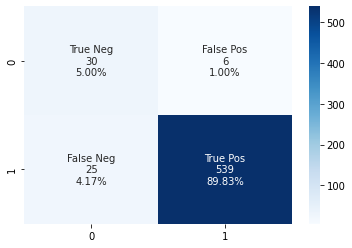

In [ ]:
group_names1 = ['True Neg','False Pos','False Neg','True Pos']
group_counts1 = ['{0:0.0f}'.format(value) for value in r1.flatten()]
group_percentages1 = ['{0:.2%}'.format(value) for value in r1.flatten()/np.sum(r1)]
labels1 = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names1,group_counts1,group_percentages1)]
labels1 = np.asarray(labels1).reshape(2,2)
sns.heatmap(r1, annot=labels1, fmt='', cmap='Blues')

In [ ]:
def make_confusion_matrix(cf,group_names=None,categories='auto',count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    '''
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html
                   
    title:         Title for the heatmap. Default is None.
    '''


    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)
    
    if title:
        plt.title(title)

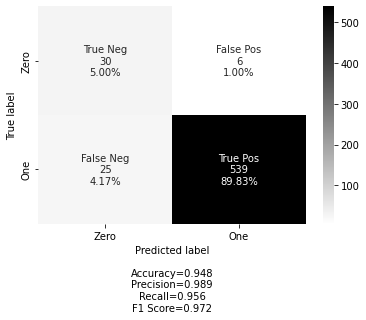

In [ ]:
labels1 = ['True Neg','False Pos','False Neg','True Pos']
categories1 = ['Zero', 'One']
make_confusion_matrix(r1, group_names=labels1, categories=categories1, cmap='binary')

## Tuned Model

In [ ]:
# Converting reviews into numerical vectors
tokenizer = Tokenizer(num_words = 500, split = ' ')  # Number of words to keep based on frequency of words. Its a hyperparameter
print("My vocabulary size is: ",500)
tokenizer.fit_on_texts(df['verified_reviews'].values)
x = tokenizer.texts_to_sequences(df['verified_reviews'].values) # Numerical vectors got created
print(x[0])
print(x[1])
# All neural networks require to have inputs of same size and shape. So we need to pad
x = pad_sequences(x)
print(x[0]) 
print(x[1])

My vocabulary size is:  500
[10, 7, 12]
[247, 4]
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  

In [ ]:
print(x.shape)
print(x.shape[1])

(2998, 442)
442


https://keras.io/api/layers/core_layers/embedding/

https://machinelearningmastery.com/how-to-reduce-overfitting-with-dropout-regularization-in-keras/

https://www.sciencedirect.com/science/article/pii/S2405959519303455

In [ ]:
model = Sequential()
model.add(Embedding(input_dim = 500,output_dim = 120, input_length = x.shape[1]))  # Input dim is vocab size
model.add(Dropout(0.4))   # 0.4 is again a hyperparameter
model.add(LSTM( units = 176, dropout = 0.2, recurrent_dropout = 0.2))
model.add(Dense(units = 2, activation = 'softmax'))
model.compile(loss = 'categorical_crossentropy', optimizer = 'adam', metrics = ['accuracy'])   #
print(model.summary())

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_3 (Embedding)     (None, 442, 120)          60000     
                                                                 
 dropout_2 (Dropout)         (None, 442, 120)          0         
                                                                 
 lstm_3 (LSTM)               (None, 176)               209088    
                                                                 
 dense_3 (Dense)             (None, 2)                 354       
                                                                 
Total params: 269,442
Trainable params: 269,442
Non-trainable params: 0
_________________________________________________________________
None


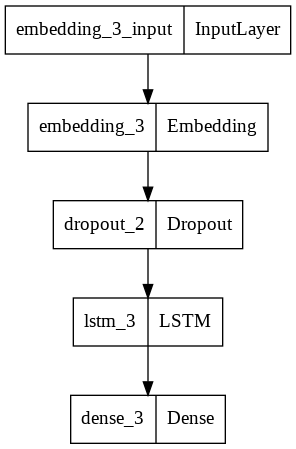

In [ ]:
tf.keras.utils.plot_model(model)

In [ ]:
s = pd.Series(list('abca'))
pd.get_dummies(s)

,a,b,c
0,1,0,0
1,0,1,0
2,0,0,1
3,1,0,0


In [ ]:
# Splitting data into training and testing 
y = pd.get_dummies(df1['sentiment'])
x_train, x_test, y_train, y_test = train_test_split(x,y,test_size = 0.2, random_state = 0)

In [ ]:
print(y)

      0  1
0     0  1
1     0  1
2     0  1
3     0  1
4     0  1
...  .. ..
3145  0  1
3146  0  1
3147  0  1
3148  0  1
3149  0  1

[2998 rows x 2 columns]


In [ ]:
history = model.fit(x_train,y_train, epochs = 10, verbose = 1, batch_size = 32)  # batch_size = 32

Epoch 1/10
75/75 [==============================] - 151s 2s/step - loss: 0.3066 - accuracy: 0.9103
Epoch 2/10
75/75 [==============================] - 133s 2s/step - loss: 0.2081 - accuracy: 0.9283
Epoch 3/10
75/75 [==============================] - 131s 2s/step - loss: 0.1469 - accuracy: 0.9454
Epoch 4/10
75/75 [==============================] - 130s 2s/step - loss: 0.1228 - accuracy: 0.9554
Epoch 5/10
75/75 [==============================] - 157s 2s/step - loss: 0.0897 - accuracy: 0.9666
Epoch 6/10
75/75 [==============================] - 133s 2s/step - loss: 0.0933 - accuracy: 0.9696
Epoch 7/10
75/75 [==============================] - 131s 2s/step - loss: 0.0781 - accuracy: 0.9725
Epoch 8/10
75/75 [==============================] - 132s 2s/step - loss: 0.0672 - accuracy: 0.9754
Epoch 9/10
75/75 [==============================] - 129s 2s/step - loss: 0.0616 - accuracy: 0.9754
Epoch 10/10
75/75 [==============================] - 129s 2s/step - loss: 0.0580 - accuracy: 0.9779


In [ ]:
model.evaluate(x_test, y_test)   # Testloss and Test Accuracy

19/19 [==============================] - 2s 112ms/step - loss: 0.2400 - accuracy: 0.9417


[0.23997561633586884, 0.9416666626930237]

In [ ]:
base_accuracy = 0.9383333325386047
base_loss = 0.29819098114967346

### Prediction and Confusion Matrix

In [ ]:
y_pred = model.predict(x_test)

In [ ]:
review_predictions = []
for prediction in y_pred:
    x = prediction
    review_predictions.append(np.argmax(x))

review_predictions = np.array(review_predictions)
review_predictions.reshape(1,-1)
review_predictions.shape

(600,)

In [ ]:
review_predictions1 = pd.get_dummies(review_predictions)
review_predictions1 = review_predictions1.idxmax(axis=1)
y_test = y_test.idxmax(axis=1)

In [ ]:
y_test

324     1
1070    0
1659    1
3088    1
3129    1
       ..
956     1
1495    1
684     1
495     1
1435    1
Length: 600, dtype: int64

In [ ]:
import sklearn
r = sklearn.metrics.confusion_matrix(review_predictions1, y_test)
print(r)

[[ 22   2]
 [ 33 543]]


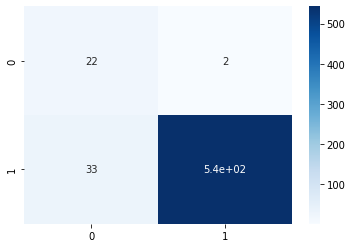

In [ ]:
import seaborn as sns
sns.heatmap(r, annot=True, cmap = 'Blues')

https://medium.com/@dtuk81/confusion-matrix-visualization-fc31e3f30fea

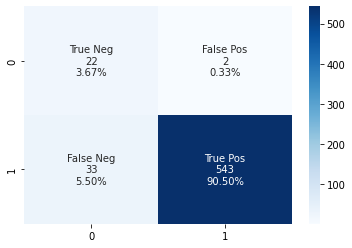

In [ ]:
group_names = ['True Neg','False Pos','False Neg','True Pos']
group_counts = ['{0:0.0f}'.format(value) for value in r.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in r.flatten()/np.sum(r)]
labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(r, annot=labels, fmt='', cmap='Blues')

For Base Model

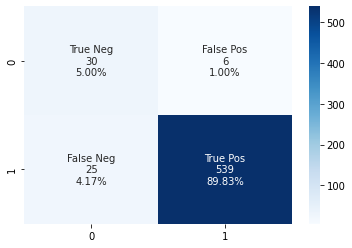

In [ ]:
group_names1 = ['True Neg','False Pos','False Neg','True Pos']
group_counts1 = ['{0:0.0f}'.format(value) for value in r1.flatten()]
group_percentages1 = ['{0:.2%}'.format(value) for value in r1.flatten()/np.sum(r1)]
labels1 = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names1,group_counts1,group_percentages1)]
labels1 = np.asarray(labels1).reshape(2,2)
sns.heatmap(r1, annot=labels1, fmt='', cmap='Blues')

In [ ]:
def make_confusion_matrix(cf,group_names=None,categories='auto',count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    '''
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html
                   
    title:         Title for the heatmap. Default is None.
    '''


    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)
    
    if title:
        plt.title(title)

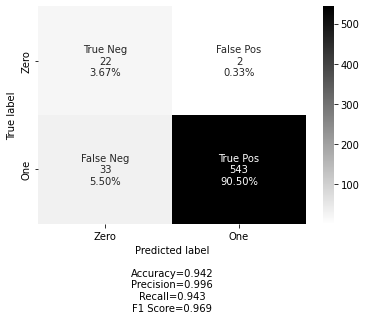

In [ ]:
labels = ['True Neg','False Pos','False Neg','True Pos']
categories = ['Zero', 'One']
make_confusion_matrix(r, group_names=labels, categories=categories, cmap='binary')

# RNN Sentiment Analysis

https://www.youtube.com/watch?v=eMPQw7Xbjd0

In [ ]:
import pandas as pd 
import matplotlib.pyplot as plt
import numpy as np

from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score 
from sklearn.model_selection import train_test_split

from keras.models import Sequential
from keras.preprocessing.text import Tokenizer 
from keras.preprocessing.sequence import pad_sequences 
from keras.layers import Dense, SimpleRNN,Dropout, Activation
import tensorflow as tf

from nltk.corpus import stopwords  
from nltk.stem import WordNetLemmatizer
from string import punctuation
from collections import Counter 
import wordcloud
from nltk.corpus import stopwords 
from textblob import Word 
import re
import nltk

In [ ]:
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [ ]:
df = pd.read_csv('amazon_alexa.tsv', sep = '\t')
df.head()

,rating,date,variation,verified_reviews,feedback
0,5,31-Jul-18,Charcoal Fabric,Love my Echo!,1
1,5,31-Jul-18,Charcoal Fabric,Loved it!,1
2,4,31-Jul-18,Walnut Finish,"Sometimes while playing a game, you can answer...",1
3,5,31-Jul-18,Charcoal Fabric,I have had a lot of fun with this thing. My 4 ...,1
4,5,31-Jul-18,Charcoal Fabric,Music,1


In [ ]:
df['variation'].unique()

array(['Charcoal Fabric ', 'Walnut Finish ', 'Heather Gray Fabric ',
       'Sandstone Fabric ', 'Oak Finish ', 'Black', 'White',
       'Black  Spot', 'White  Spot', 'Black  Show', 'White  Show',
       'Black  Plus', 'White  Plus', 'Configuration: Fire TV Stick',
       'Black  Dot', 'White  Dot'], dtype=object)

In [ ]:
df[['variation','verified_reviews']].groupby('variation').count()

,verified_reviews
variation,
Black,261
Black Dot,516
Black Plus,270
Black Show,265
Black Spot,241
Charcoal Fabric,430
Configuration: Fire TV Stick,350
Heather Gray Fabric,157
Oak Finish,14


In [ ]:
df.isnull().sum()

rating              0
date                0
variation           0
verified_reviews    0
feedback            0
dtype: int64

In [ ]:
df.shape

(3150, 5)

In [ ]:
df.tail()

,rating,date,variation,verified_reviews,feedback
3145,5,30-Jul-18,Black Dot,"Perfect for kids, adults and everyone in betwe...",1
3146,5,30-Jul-18,Black Dot,"Listening to music, searching locations, check...",1
3147,5,30-Jul-18,Black Dot,"I do love these things, i have them running my...",1
3148,5,30-Jul-18,White Dot,Only complaint I have is that the sound qualit...,1
3149,4,29-Jul-18,Black Dot,Good,1


In [ ]:
df.rating.unique()

array([5, 4, 3, 2, 1])

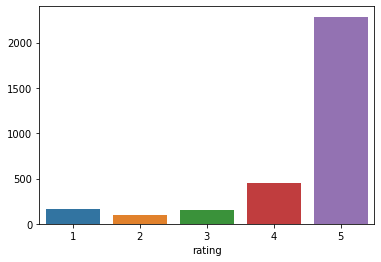

In [ ]:
import seaborn as sns
c = df.groupby('rating')['rating'].count()
sns.barplot(x = c.index, y = c.values)

In [ ]:
print(df['rating'].mean())
print(df['rating'].median())

4.463174603174603
5.0


In [ ]:
# Creating a column if its a review is a +ve review or -ve
def sentiments(df):
    if df['rating'] > 3:
        return 'Positive'
    elif df['rating'] < 3:
        return 'Negative'
df['sentiment'] = df.apply(sentiments, axis = 1)
df.head(5)

,rating,date,variation,verified_reviews,feedback,sentiment
0,5,31-Jul-18,Charcoal Fabric,Love my Echo!,1,Positive
1,5,31-Jul-18,Charcoal Fabric,Loved it!,1,Positive
2,4,31-Jul-18,Walnut Finish,"Sometimes while playing a game, you can answer...",1,Positive
3,5,31-Jul-18,Charcoal Fabric,I have had a lot of fun with this thing. My 4 ...,1,Positive
4,5,31-Jul-18,Charcoal Fabric,Music,1,Positive


In [ ]:
df[['sentiment','variation']].groupby('sentiment').count()

,variation
sentiment,
Negative,257
Positive,2741


In [ ]:
df.dropna(inplace = True)

In [ ]:
# Preprocessing of text @credits: Anish
def tokenization(string):
    words=nltk.word_tokenize(string)
    return ' '.join(words)

def removestopwords(string):
    for i in punctuation:
        string=string.replace(i,'')
    words=nltk.word_tokenize(string)
    k=[]
    eng_stop=stopwords.words('english')
    for each in words:
        if each not in eng_stop:
            k.append(each.lower())
    return ' '.join(k)

def lemmat(string):
    words=nltk.word_tokenize(string)
    ws=WordNetLemmatizer()
    l=[]
    for each in words:
        l.append(ws.lemmatize(each))
    return ' '.join(l)

def Refine(string):
    return lemmat(removestopwords(tokenization(string)))

In [ ]:
df1 = df.copy()
df1['verified_reviews']=df1['verified_reviews'].apply(lambda x: Refine(x))

In [ ]:
df1.head()

,rating,date,variation,verified_reviews,feedback,sentiment
0,5,31-Jul-18,Charcoal Fabric,love echo,1,Positive
1,5,31-Jul-18,Charcoal Fabric,loved,1,Positive
2,4,31-Jul-18,Walnut Finish,sometimes playing game answer question correct...,1,Positive
3,5,31-Jul-18,Charcoal Fabric,i lot fun thing my 4 yr old learns dinosaur co...,1,Positive
4,5,31-Jul-18,Charcoal Fabric,music,1,Positive


In [ ]:
'''
import nltk
import re

w_tokenizer = nltk.tokenize.WhitespaceTokenizer()
lemmatizer = nltk.stem.WordNetLemmatizer()

def lemmatize_text(text):
    k = [lemmatizer.lemmatize(w,'v') for w in w_tokenizer.tokenize(text)]
    l = ' '.join(map(str,k))
    return l

def cleaning(df, stopwords):
    # Making all the verified reveiws in small words.  Eg: To make sure that Book and book are represented as same vector in the vector space
    df1['verified_reviews'] = df1['verified_reviews'].apply(lambda x: " ".join(x.lower() for x in x.split()))

    #df1['verified_reviews'] = df1['verified_reviews'].str.replace('^\w', '')
    #df1['verified_reviews'] = df1['verified_reviews'].str.replace('[^a-zA-Z0-9]', ' ')

    df1['verified_reviews'] = df1['verified_reviews'].replace('\!','',regex=True)
    df1['verified_reviews'] = df1['verified_reviews'].replace('\,','',regex=True)
    df1['verified_reviews'] = df1['verified_reviews'].replace('\.','',regex=True)
    df1['verified_reviews'] = df1['verified_reviews'].replace('\&','',regex=True)
    df1['verified_reviews'] = df1['verified_reviews'].replace('\'','',regex=True)
    df1['verified_reviews'] = df1['verified_reviews'].replace('\;','',regex=True)
    df1['verified_reviews'] = df1['verified_reviews'].replace('\#','',regex=True)
    df1['verified_reviews'] = df1['verified_reviews'].replace('\-','',regex=True)
    df1['verified_reviews'] = df1['verified_reviews'].str.replace('\d','')   # Replacing digits and numbers
    df['verified_reviews'] = df['verified_reviews'].apply(lambda x: " ".join(x for x in x.split() if x not in stop_words))
    df['verified_reviews'] = df['verified_reviews'].apply(lemmatize_text)
 # Lemmatizing the word

    return df

df1 = df.copy()
stop_words = stopwords.words('english')
df1 = cleaning(df1,stop_words)
#df = df1.copy()
df1.head()
'''

'\nimport nltk\nimport re\n\nw_tokenizer = nltk.tokenize.WhitespaceTokenizer()\nlemmatizer = nltk.stem.WordNetLemmatizer()\n\ndef lemmatize_text(text):\n    k = [lemmatizer.lemmatize(w,\'v\') for w in w_tokenizer.tokenize(text)]\n    l = \' \'.join(map(str,k))\n    return l\n\ndef cleaning(df, stopwords):\n    # Making all the verified reveiws in small words.  Eg: To make sure that Book and book are represented as same vector in the vector space\n    df1[\'verified_reviews\'] = df1[\'verified_reviews\'].apply(lambda x: " ".join(x.lower() for x in x.split()))\n\n    #df1[\'verified_reviews\'] = df1[\'verified_reviews\'].str.replace(\'^\\w\', \'\')\n    #df1[\'verified_reviews\'] = df1[\'verified_reviews\'].str.replace(\'[^a-zA-Z0-9]\', \' \')\n\n    df1[\'verified_reviews\'] = df1[\'verified_reviews\'].replace(\'\\!\',\'\',regex=True)\n    df1[\'verified_reviews\'] = df1[\'verified_reviews\'].replace(\'\\,\',\'\',regex=True)\n    df1[\'verified_reviews\'] = df1[\'verified_reviews\'].rep

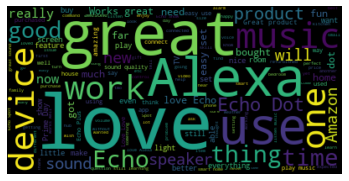

In [ ]:
# Visualizing most common words
common_words = ''
for i in df.verified_reviews:
    i = str(i)
    tokens = i.split()
    common_words += " ".join(tokens) + " "
wordcloud = wordcloud.WordCloud().generate(common_words)
plt.imshow(wordcloud, interpolation = 'bilinear')  # bilinear is used to display smooth images
plt.axis('off')
plt.show()

In [ ]:
# Labelling classes of sentiments from 0 or 1 as here there are only 2 classes. 
lb = LabelEncoder() 
df1['sentiment'] = lb.fit_transform(df1['sentiment'])
df1.head()

,rating,date,variation,verified_reviews,feedback,sentiment
0,5,31-Jul-18,Charcoal Fabric,love echo,1,1
1,5,31-Jul-18,Charcoal Fabric,loved,1,1
2,4,31-Jul-18,Walnut Finish,sometimes playing game answer question correct...,1,1
3,5,31-Jul-18,Charcoal Fabric,i lot fun thing my 4 yr old learns dinosaur co...,1,1
4,5,31-Jul-18,Charcoal Fabric,music,1,1


In [ ]:
# Lets check the words that appear frequently
k = pd.Series(np.concatenate([x.split() for x in df1.verified_reviews])).value_counts()
a = df1['verified_reviews'].str.lower().str.cat(sep=' ')
words = nltk.tokenize.word_tokenize(a)
word_dist = nltk.FreqDist(words)
print (word_dist)
print(len(word_dist))
rslt = pd.DataFrame(word_dist.most_common(30),columns=['Word', 'Frequency'])
#print(rslt)
#rslt1 = pd.DataFrame(word_dist.most_common(3723),columns=['Word', 'Frequency'])
#rslt1.tail(40)

<FreqDist with 3723 samples and 43308 outcomes>
3723


## Base Model

In [ ]:
# Converting reviews into numerical vectors
tokenizer = Tokenizer(num_words = 3421, split = ' ')  # Number of words to keep based on frequency of words. Its a hyperparameter
print("My vocabulary size is: ",3421)     # Often suggested to lower the vocabulary to increase the performance of the model
tokenizer.fit_on_texts(df['verified_reviews'].values)
x = tokenizer.texts_to_sequences(df['verified_reviews'].values) # Numerical vectors got created. As 3421 is the num_words. It accounts each word in the vector. 
print(x[0])
print(x[1])
# All neural networks require to have inputs of same size and shape. So we need to pad
x = pad_sequences(x)
print(x[0]) 
print(x[1])

My vocabulary size is:  3421
[10, 7, 12]
[247, 4]
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
 

In [ ]:
print(x.shape)
print(x.shape[1])

(2998, 528)
528


In [ ]:
s = pd.Series(list('abca'))
pd.get_dummies(s)

,a,b,c
0,1,0,0
1,0,1,0
2,0,0,1
3,1,0,0


In [ ]:
# Splitting data into training and testing 
y = pd.get_dummies(df1['sentiment'])
x_train, x_test, y_train, y_test = train_test_split(x,y,test_size = 0.2, random_state = 0)  # CHECK

In [ ]:
print(x_train.shape)

(2398, 528)


In [ ]:
#x_train = np.array(x_train).reshape((x_train.shape[0], x_train.shape[1],1))
#x_test = np.array(x_test).reshape((x_test.shape[0], x_test.shape[1],1))

In [ ]:
print(x_test.shape)
print(x_train.shape)

(600, 528)
(2398, 528)


In [ ]:
model = Sequential()
model.add(SimpleRNN(units = 50, input_shape = (528,1)))
model.add(Dense(units  = 2))
model.add(Activation('softmax'))
model.compile(loss = 'categorical_crossentropy', metrics = ['accuracy'])   #optimizer = 'adam'
print(model.summary())

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn (SimpleRNN)      (None, 50)                2600      
                                                                 
 dense_5 (Dense)             (None, 2)                 102       
                                                                 
 activation (Activation)     (None, 2)                 0         
                                                                 
Total params: 2,702
Trainable params: 2,702
Non-trainable params: 0
_________________________________________________________________
None


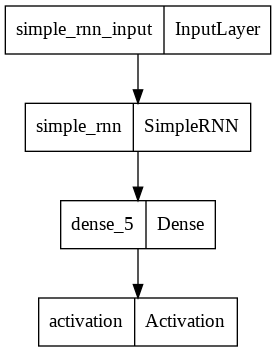

In [ ]:
tf.keras.utils.plot_model(model)

In [ ]:
print(y)

      0  1
0     0  1
1     0  1
2     0  1
3     0  1
4     0  1
...  .. ..
3145  0  1
3146  0  1
3147  0  1
3148  0  1
3149  0  1

[2998 rows x 2 columns]


In [ ]:
history = model.fit(x_train,y_train, epochs = 10, verbose = 1)  # batch_size = 32

Epoch 1/10
75/75 [==============================] - 11s 125ms/step - loss: 0.2894 - accuracy: 0.9141
Epoch 2/10
75/75 [==============================] - 6s 78ms/step - loss: 0.2778 - accuracy: 0.9158
Epoch 3/10
75/75 [==============================] - 6s 77ms/step - loss: 0.2760 - accuracy: 0.9158
Epoch 4/10
75/75 [==============================] - 6s 77ms/step - loss: 0.2757 - accuracy: 0.9158
Epoch 5/10
75/75 [==============================] - 13s 177ms/step - loss: 0.2767 - accuracy: 0.9158
Epoch 6/10
75/75 [==============================] - 10s 128ms/step - loss: 0.2755 - accuracy: 0.9158
Epoch 7/10
75/75 [==============================] - 6s 77ms/step - loss: 0.2753 - accuracy: 0.9158
Epoch 8/10
75/75 [==============================] - 6s 77ms/step - loss: 0.2725 - accuracy: 0.9158
Epoch 9/10
75/75 [==============================] - 6s 78ms/step - loss: 0.2741 - accuracy: 0.9158
Epoch 10/10
75/75 [==============================] - 6s 78ms/step - loss: 0.2750 - accuracy: 0.9153


In [ ]:
model.evaluate(x_test, y_test)   # Testloss and Test Accuracy

19/19 [==============================] - 1s 21ms/step - loss: 0.3023 - accuracy: 0.9083


[0.3022611439228058, 0.9083333611488342]

In [ ]:
base_accuracy = 0.9083333611488342
base_loss = 0.3022611439228058

### Prediction and Confusion Matrix

In [ ]:
y_pred = model.predict(x_test)

In [ ]:
review_predictions = []
for prediction in y_pred:
    x = prediction
    review_predictions.append(np.argmax(x))

review_predictions = np.array(review_predictions)
review_predictions.reshape(1,-1)
review_predictions.shape

In [ ]:
review_predictions

In [ ]:
review_predictions1 = pd.get_dummies(review_predictions)
review_predictions1 = review_predictions1.idxmax(axis=1)
y_test = y_test.idxmax(axis=1)

NameError: ignored

In [ ]:
y_test

324     1
1070    0
1659    1
3088    1
3129    1
       ..
956     1
1495    1
684     1
495     1
1435    1
Length: 600, dtype: int64

In [ ]:
import sklearn
r1 = sklearn.metrics.confusion_matrix(review_predictions1, y_test)
print(r1)

[[  0   0]
 [ 55 545]]


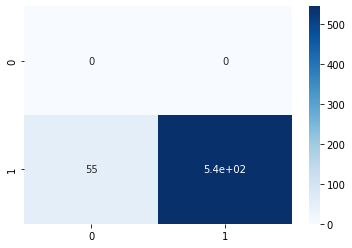

In [ ]:
import seaborn as sns
sns.heatmap(r1, annot=True, cmap = 'Blues')

https://medium.com/@dtuk81/confusion-matrix-visualization-fc31e3f30fea

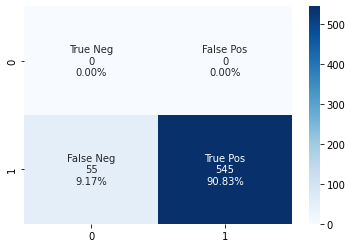

In [ ]:
group_names1 = ['True Neg','False Pos','False Neg','True Pos']
group_counts1 = ['{0:0.0f}'.format(value) for value in r1.flatten()]
group_percentages1 = ['{0:.2%}'.format(value) for value in r1.flatten()/np.sum(r1)]
labels1 = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names1,group_counts1,group_percentages1)]
labels1 = np.asarray(labels1).reshape(2,2)
sns.heatmap(r1, annot=labels1, fmt='', cmap='Blues')

In [ ]:
def make_confusion_matrix(cf,group_names=None,categories='auto',count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    '''
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html
                   
    title:         Title for the heatmap. Default is None.
    '''


    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)
    
    if title:
        plt.title(title)

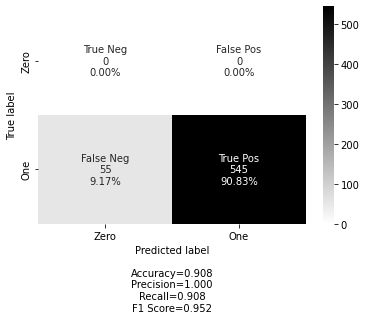

In [ ]:
labels1 = ['True Neg','False Pos','False Neg','True Pos']
categories1 = ['Zero', 'One']
make_confusion_matrix(r1, group_names=labels1, categories=categories1, cmap='binary')

## Tuned Model

In [ ]:
# Converting reviews into numerical vectors
tokenizer = Tokenizer(num_words = 500, split = ' ')  # Number of words to keep based on frequency of words. Its a hyperparameter
print("My vocabulary size is: ",500)
tokenizer.fit_on_texts(df['verified_reviews'].values)
x = tokenizer.texts_to_sequences(df['verified_reviews'].values) # Numerical vectors got created
print(x[0])
print(x[1])
# All neural networks require to have inputs of same size and shape. So we need to pad
x = pad_sequences(x)
print(x[0]) 
print(x[1])

My vocabulary size is:  500
[10, 7, 12]
[247, 4]
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  

In [ ]:
print(x.shape)
print(x.shape[1])

(2998, 442)
442


In [ ]:
s = pd.Series(list('abca'))
pd.get_dummies(s)

,a,b,c
0,1,0,0
1,0,1,0
2,0,0,1
3,1,0,0


In [ ]:
# Splitting data into training and testing 
y = pd.get_dummies(df1['sentiment'])
x_train, x_test, y_train, y_test = train_test_split(x,y,test_size = 0.2, random_state = 0)
x_train = np.array(x_train).reshape((x_train.shape[0], x_train.shape[1],1))
x_test = np.array(x_test).reshape((x_test.shape[0], x_test.shape[1],1))
print(x_test.shape)
print(x_train.shape)

(600, 442, 1)
(2398, 442, 1)


In [ ]:
model = Sequential()
model.add(SimpleRNN(units = 50, input_shape = (442,1), dropout = 0.2, recurrent_dropout = 0.2))
model.add(Dense(units  = 50, activation = 'relu'))
model.add(Dense(units  = 50, activation = 'relu'))
model.add(Dropout(0.2))
model.add(Dense(units  = 50, activation = 'relu'))
model.add(Dense(units  = 50, activation = 'relu'))
model.add(Dropout(0.2))
model.add(Dense(units  = 50, activation = 'relu'))
model.add(Dense(units  = 2))
model.add(Activation('softmax'))
model.compile(loss = 'categorical_crossentropy', optimizer = 'adam', metrics = ['accuracy'])   #optimizer = 'adam'
print(model.summary())

Model: "sequential_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_11 (SimpleRNN)   (None, 50)                2600      
                                                                 
 dense_26 (Dense)            (None, 50)                2550      
                                                                 
 dense_27 (Dense)            (None, 50)                2550      
                                                                 
 dropout_5 (Dropout)         (None, 50)                0         
                                                                 
 dense_28 (Dense)            (None, 50)                2550      
                                                                 
 dense_29 (Dense)            (None, 50)                2550      
                                                                 
 dropout_6 (Dropout)         (None, 50)              

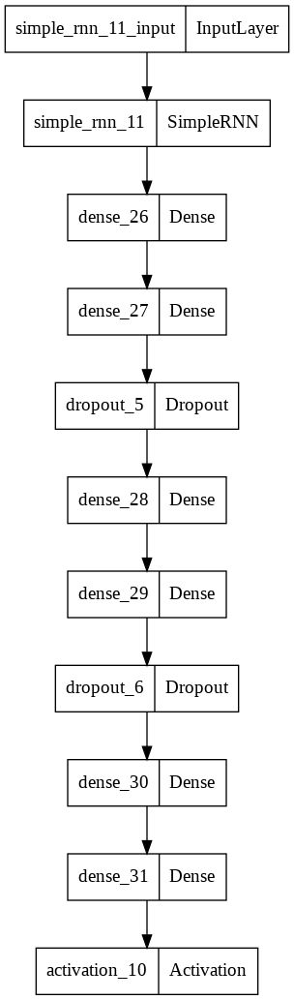

In [ ]:
tf.keras.utils.plot_model(model)

In [ ]:
print(y)

      0  1
0     0  1
1     0  1
2     0  1
3     0  1
4     0  1
...  .. ..
3145  0  1
3146  0  1
3147  0  1
3148  0  1
3149  0  1

[2998 rows x 2 columns]


In [ ]:
history = model.fit(x_train,y_train, epochs = 10, verbose = 1, batch_size = 32)  # batch_size = 32

Epoch 1/10
75/75 [==============================] - 16s 181ms/step - loss: 0.3379 - accuracy: 0.9099
Epoch 2/10
75/75 [==============================] - 14s 183ms/step - loss: 0.2951 - accuracy: 0.9158
Epoch 3/10
75/75 [==============================] - 14s 182ms/step - loss: 0.2947 - accuracy: 0.9158
Epoch 4/10
75/75 [==============================] - 14s 181ms/step - loss: 0.2954 - accuracy: 0.9158
Epoch 5/10
75/75 [==============================] - 13s 179ms/step - loss: 0.2910 - accuracy: 0.9158
Epoch 6/10
75/75 [==============================] - 14s 191ms/step - loss: 0.2948 - accuracy: 0.9158
Epoch 7/10
75/75 [==============================] - 14s 182ms/step - loss: 0.2941 - accuracy: 0.9158
Epoch 8/10
75/75 [==============================] - 17s 228ms/step - loss: 0.2941 - accuracy: 0.9158
Epoch 9/10
75/75 [==============================] - 16s 213ms/step - loss: 0.2922 - accuracy: 0.9158
Epoch 10/10
75/75 [==============================] - 14s 183ms/step - loss: 0.2933 - accura

In [ ]:
model.evaluate(x_test, y_test)   # Testloss and Test Accuracy

19/19 [==============================] - 1s 20ms/step - loss: 0.3051 - accuracy: 0.9083


[0.30510255694389343, 0.9083333611488342]

In [ ]:
base_accuracy = 0.9083333611488342
base_loss = 0.3022611439228058

### Prediction and Confusion Matrix

In [ ]:
y_pred = model.predict(x_test)

In [ ]:
review_predictions = []
for prediction in y_pred:
    x = prediction
    review_predictions.append(np.argmax(x))

review_predictions = np.array(review_predictions)
review_predictions.reshape(1,-1)
review_predictions.shape

(600,)

In [ ]:
review_predictions1 = pd.get_dummies(review_predictions)
review_predictions1 = review_predictions1.idxmax(axis=1)
y_test = y_test.idxmax(axis=1)

In [ ]:
y_test

324     1
1070    0
1659    1
3088    1
3129    1
       ..
956     1
1495    1
684     1
495     1
1435    1
Length: 600, dtype: int64

In [ ]:
import sklearn
r = sklearn.metrics.confusion_matrix(review_predictions1, y_test)
print(r)

[[  0   0]
 [ 55 545]]


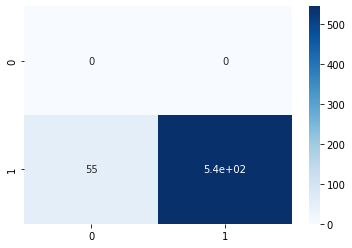

In [ ]:
import seaborn as sns
sns.heatmap(r, annot=True, cmap = 'Blues')

https://medium.com/@dtuk81/confusion-matrix-visualization-fc31e3f30fea

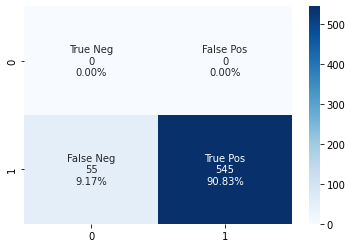

In [ ]:
group_names = ['True Neg','False Pos','False Neg','True Pos']
group_counts = ['{0:0.0f}'.format(value) for value in r.flatten()]
group_percentages = ['{0:.2%}'.format(value) for value in r.flatten()/np.sum(r)]
labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,group_counts,group_percentages)]
labels = np.asarray(labels).reshape(2,2)
sns.heatmap(r, annot=labels, fmt='', cmap='Blues')

For Base Model

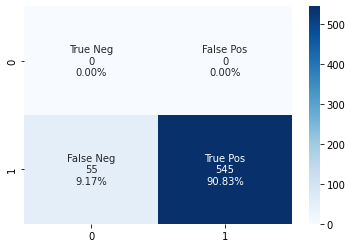

In [ ]:
group_names1 = ['True Neg','False Pos','False Neg','True Pos']
group_counts1 = ['{0:0.0f}'.format(value) for value in r1.flatten()]
group_percentages1 = ['{0:.2%}'.format(value) for value in r1.flatten()/np.sum(r1)]
labels1 = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names1,group_counts1,group_percentages1)]
labels1 = np.asarray(labels1).reshape(2,2)
sns.heatmap(r1, annot=labels1, fmt='', cmap='Blues')

In [ ]:
def make_confusion_matrix(cf,group_names=None,categories='auto',count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    '''
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html
                   
    title:         Title for the heatmap. Default is None.
    '''


    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)
    
    if title:
        plt.title(title)

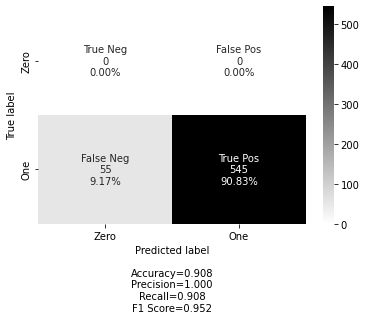

In [ ]:
labels = ['True Neg','False Pos','False Neg','True Pos']
categories = ['Zero', 'One']
make_confusion_matrix(r, group_names=labels, categories=categories, cmap='binary')

# Maslow and Reiss Classifications Part 1

# Without Uniform/Equal class distribution


## T 

In [ ]:
import pandas as pd 
import matplotlib.pyplot as plt
import numpy as np

from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import confusion_matrix 
from sklearn.model_selection import train_test_split

from keras.models import Sequential
from keras.preprocessing.text import Tokenizer 
from tensorflow.keras.preprocessing.sequence import pad_sequences 
from keras.layers import Dense, Embedding, LSTM,Dropout
import tensorflow as tf
import keras

from nltk.corpus import stopwords  
from nltk.stem import WordNetLemmatizer
from collections import Counter 
import wordcloud
from nltk.corpus import stopwords 
from textblob import Word 
import re
from string import punctuation
import nltk

In [ ]:
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [ ]:
df = pd.read_csv('t.csv')

### Cleaning the Data

In [ ]:
df = df.iloc[:,5:]
df1 = df.drop(columns = ['action','motivation'])
#df1.head()

In [ ]:
def clean(string):
    res = string.strip('][').split(', ')
    lis = []
    for word in res:
        q = word.strip('][').split(', ')
        w = q[0].lstrip('\"')[:-1]
        if w == '' or w == 'na':
            lis.append('none')
        else:
            lis.append(w)
    string = lis
    for classes in lis:
        if classes not in uniqueClasses:
            uniqueClasses.append(classes)
    return string

In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['maslow'][i] = clean(df1['maslow'][i]);
uniqueClassesMaslow = uniqueClasses

In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['reiss'][i] = clean(df1['reiss'][i]);
uniqueClassesReiss = uniqueClasses

In [ ]:
df2 = df1
df3 = df2.explode('maslow')

In [ ]:
df3.head()

,sentence,maslow,reiss
0,I began making fish curry for my boyfriend and I.,physiological,[food]
1,I began making fish curry for my boyfriend and I.,love,"[family, romance, food]"
1,I began making fish curry for my boyfriend and I.,physiological,"[family, romance, food]"
2,I began making fish curry for my boyfriend and I.,physiological,[food]
3,I began making fish curry for my boyfriend and I.,none,[none]


### Cleaning the Data for NLP tasks

In [ ]:
df3.shape

(55066, 3)

(array([0, 1, 2, 3, 4, 5]), <a list of 6 Text major ticklabel objects>)

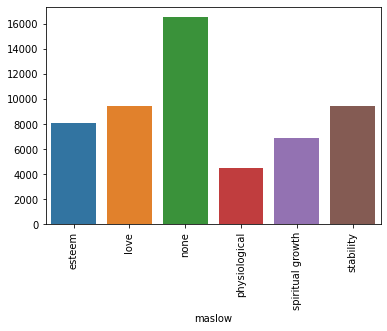

In [ ]:
import seaborn as sns 
c = df3.groupby('maslow')['maslow'].count()
sns.barplot(x = c.index, y = c.values)
plt.xticks(rotation = 90)

In [ ]:
df3[['sentence','maslow']].groupby('maslow').count()

,sentence
maslow,
esteem,8134
love,9483
none,16547
physiological,4487
spiritual growth,6927
stability,9488


In [ ]:
lb = LabelEncoder() 
df3['maslowLabel'] = lb.fit_transform(df3['maslow'])

In [ ]:
df3

,sentence,maslow,reiss,maslowLabel
0,I began making fish curry for my boyfriend and I.,physiological,[food],3
1,I began making fish curry for my boyfriend and I.,love,"[family, romance, food]",1
1,I began making fish curry for my boyfriend and I.,physiological,"[family, romance, food]",3
2,I began making fish curry for my boyfriend and I.,physiological,[food],3
3,I began making fish curry for my boyfriend and I.,none,[none],2
...,...,...,...,...
47542,A crab was inside the shell pinching his leg.,spiritual growth,[curiosity],4
47543,A crab was inside the shell pinching his leg.,spiritual growth,[curiosity],4
47544,A crab was inside the shell pinching his leg.,none,[none],2
47545,A crab was inside the shell pinching his leg.,stability,[tranquility],5


In [ ]:
print(df3['maslow'].unique())
print(df3['maslowLabel'].unique())

['physiological' 'love' 'none' 'spiritual growth' 'esteem' 'stability']
[3 1 2 4 0 5]


https://machinelearningmastery.com/multi-class-imbalanced-classification/

In [ ]:
from collections import Counter
x = df3['sentence']
y = df3['maslowLabel'] 
counter = Counter(y)
for k,v in counter.items():
	per = v / len(y) * 100
	print('Class=%d, n=%d (%.3f%%)' % (k, v, per))

Class=3, n=4487 (8.148%)
Class=1, n=9483 (17.221%)
Class=2, n=16547 (30.049%)
Class=4, n=6927 (12.579%)
Class=0, n=8134 (14.771%)
Class=5, n=9488 (17.230%)


In [ ]:
punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

In [ ]:
def tokenization(string):
    words=nltk.word_tokenize(string)
    return ' '.join(words)

def removestopwords(string):
    for i in punctuation:
        string=string.replace(i,'')
    words=nltk.word_tokenize(string)
    k=[]
    eng_stop=stopwords.words('english')
    for each in words:
        if each not in eng_stop:
            k.append(each.lower())
    return ' '.join(k)

def lemmat(string):
    words=nltk.word_tokenize(string)
    ws=WordNetLemmatizer()
    l=[]
    for each in words:
        l.append(ws.lemmatize(each))
    return ' '.join(l)

def Refine(string):
    return lemmat(removestopwords(tokenization(string)))

In [ ]:
df4 = df3.copy()
df4['sentence']=df4['sentence'].apply(lambda x: Refine(x))
df4

,sentence,maslow,reiss,maslowLabel
0,i began making fish curry boyfriend i,physiological,[food],3
1,i began making fish curry boyfriend i,love,"[family, romance, food]",1
1,i began making fish curry boyfriend i,physiological,"[family, romance, food]",3
2,i began making fish curry boyfriend i,physiological,[food],3
3,i began making fish curry boyfriend i,none,[none],2
...,...,...,...,...
47542,a crab inside shell pinching leg,spiritual growth,[curiosity],4
47543,a crab inside shell pinching leg,spiritual growth,[curiosity],4
47544,a crab inside shell pinching leg,none,[none],2
47545,a crab inside shell pinching leg,stability,[tranquility],5


In [ ]:
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

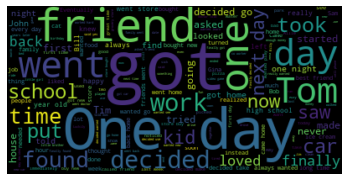

In [ ]:
common_words = ''
for i in df.sentence:
    i = str(i)
    tokens = i.split()
    common_words += " ".join(tokens) + " "
wordcloud = WordCloud().generate(common_words)   
plt.imshow(wordcloud, interpolation = 'bilinear')  # bilinear is used to display smooth images
plt.axis('off')
plt.show()

In [ ]:
k = pd.Series(np.concatenate([x.split() for x in df4.sentence])).value_counts()
a = df4['sentence'].str.lower().str.cat(sep=' ')
words = nltk.tokenize.word_tokenize(a)
word_dist = nltk.FreqDist(words)
print (word_dist)
print(len(word_dist))
rslt = pd.DataFrame(word_dist.most_common(30),
                    columns=['Word', 'Frequency'])
#print(rslt)

<FreqDist with 7254 samples and 295640 outcomes>
7254


In [ ]:
print(df4.sentence.map(lambda x: len(x)).max())

62


In [ ]:
lengths = df4["sentence"].str.len()
argmax = np.where(lengths == lengths.max())[0]
df4.iloc[argmax].head(1)

,sentence,maslow,reiss,maslowLabel
21422,one day i decided i wanted become professional...,spiritual growth,[curiosity],4


### Model LSTM

In [ ]:
from keras.layers import Dense, Flatten, LSTM, Conv1D, MaxPooling1D, Dropout, Activation

In [ ]:
model = Sequential()
model.add(Embedding(7254, 100, input_length=62))
model.add(Dropout(0.2))
model.add(LSTM(200, activation = 'tanh'))
model.add(Dropout(0.2))
model.add(Dense(units = 200, activation = 'relu'))
model.add(Dense(6, activation='softmax'))

In [ ]:
model.summary()

Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_6 (Embedding)     (None, 62, 100)           725400    
                                                                 
 dropout_10 (Dropout)        (None, 62, 100)           0         
                                                                 
 lstm (LSTM)                 (None, 200)               240800    
                                                                 
 dropout_11 (Dropout)        (None, 200)               0         
                                                                 
 dense_24 (Dense)            (None, 200)               40200     
                                                                 
 dense_25 (Dense)            (None, 6)                 1206      
                                                                 
Total params: 1,007,606
Trainable params: 1,007,606
N

In [ ]:
METRICS = [
      keras.metrics.TruePositives(name='tp'),
      keras.metrics.FalsePositives(name='fp'),
      keras.metrics.TrueNegatives(name='tn'),
      keras.metrics.FalseNegatives(name='fn'), 
      keras.metrics.CategoricalCrossentropy(name='categorical_cross_entropy'),
      keras.metrics.Precision(name='precision'),
      keras.metrics.Recall(name='recall'),
      keras.metrics.AUC(name='auc'),
      keras.metrics.AUC(name='prc', curve='PR'), # precision-recall curve
]

In [ ]:
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics= METRICS)

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(df4['sentence'],df4['maslowLabel'],test_size = 0.2, random_state = 0, stratify = df4['maslowLabel'])

In [ ]:
x_train_text = x_train 
x_test_text = x_test
y_train_text = y_train
y_test_text = y_test

In [ ]:
print(x_train.shape)
print(x_test.shape)

(44052,)
(11014,)


In [ ]:
tokenizer = Tokenizer(num_words = 7254, split = ' ')
tokenizer.fit_on_texts(x_train.values)
x = tokenizer.texts_to_sequences(x_train.values) # Numerical vectors got created
x = pad_sequences(x, maxlen=62)
x_train = x

tokenizer = Tokenizer(num_words = 7254, split = ' ')
tokenizer.fit_on_texts(x_test.values)
x = tokenizer.texts_to_sequences(x_test.values) # Numerical vectors got created
x = pad_sequences(x, maxlen=62)
x_test = x

In [ ]:
print(x_train.shape)
print(x_test.shape)

(44052, 62)
(11014, 62)


In [ ]:
from tensorflow.keras.utils import to_categorical
y_train = to_categorical(y_train)
y_test =  to_categorical(y_test)

In [ ]:
model.fit(x_train, y_train,epochs=5,verbose=1,validation_split=0.1)

Epoch 1/5
1239/1239 [==============================] - 223s 177ms/step - loss: 1.6415 - tp: 789.0000 - fp: 668.0000 - tn: 197562.0000 - fn: 38857.0000 - categorical_cross_entropy: 1.6415 - precision: 0.5415 - recall: 0.0199 - auc: 0.6840 - prc: 0.3022 - val_loss: 1.5954 - val_tp: 221.0000 - val_fp: 209.0000 - val_tn: 21821.0000 - val_fn: 4185.0000 - val_categorical_cross_entropy: 1.5954 - val_precision: 0.5140 - val_recall: 0.0502 - val_auc: 0.7127 - val_prc: 0.3276
Epoch 2/5
1239/1239 [==============================] - 207s 167ms/step - loss: 1.4953 - tp: 4171.0000 - fp: 3114.0000 - tn: 195116.0000 - fn: 35475.0000 - categorical_cross_entropy: 1.4953 - precision: 0.5725 - recall: 0.1052 - auc: 0.7567 - prc: 0.3921 - val_loss: 1.5935 - val_tp: 364.0000 - val_fp: 390.0000 - val_tn: 21640.0000 - val_fn: 4042.0000 - val_categorical_cross_entropy: 1.5935 - val_precision: 0.4828 - val_recall: 0.0826 - val_auc: 0.7174 - val_prc: 0.3367
Epoch 3/5
1239/1239 [==============================] - 2

In [ ]:
model.evaluate(x_test, y_test)

169/169 [==============================] - 8s 49ms/step - loss: 3.1755 - tp: 310.0000 - fp: 1448.0000 - tn: 25477.0000 - fn: 5075.0000 - categorical_cross_entropy: 3.1755 - precision: 0.1763 - recall: 0.0576 - auc: 0.5088 - prc: 0.1706 - accuracy: 0.0000e+00


[3.1754701137542725,
 310.0,
 1448.0,
 25477.0,
 5075.0,
 3.1754701137542725,
 0.17633675038814545,
 0.05756731703877449,
 0.5087841153144836,
 0.17064206302165985,
 0.0]

### Evaluation and Analysis

In [ ]:
y_pred = model.predict(x_test)

In [ ]:
y_pred[2]

array([4.2563403e-01, 2.9093364e-05, 2.7402371e-01, 1.7323330e-03,
       8.5822061e-02, 2.1275878e-01], dtype=float32)

In [ ]:
print(history.history.keys())

dict_keys(['loss', 'tp', 'fp', 'tn', 'fn', 'categorical_cross_entropy', 'precision', 'recall', 'auc', 'prc', 'accuracy', 'val_loss', 'val_tp', 'val_fp', 'val_tn', 'val_fn', 'val_categorical_cross_entropy', 'val_precision', 'val_recall', 'val_auc', 'val_prc', 'val_accuracy'])


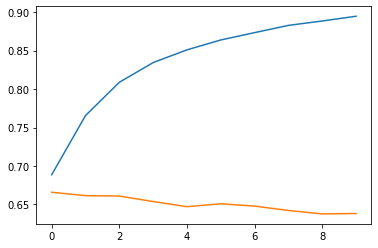

In [ ]:
plt.plot(history.history['auc'])
plt.plot(history.history['val_auc'])

In [ ]:
review_predictions = []
for prediction in y_pred:
    x = prediction
    review_predictions.append(np.argmax(x))

review_predictions = np.array(review_predictions)
review_predictions.reshape(1,-1)
review_predictions.shape

(5385,)

In [ ]:
review_predictions

array([5, 2, 0, ..., 0, 3, 0])

In [ ]:
k = pd.DataFrame(review_predictions, columns = ['Label'])
k.groupby('Label')['Label'].count()

Label
0     956
1    1178
2     799
3     819
4     695
5     938
Name: Label, dtype: int64

In [ ]:
type(y_test_text)

pandas.core.series.Series

In [ ]:
import sklearn
r1 = sklearn.metrics.confusion_matrix(review_predictions, y_test_text)
print(r1)

[[172 153 159 155 152 165]
 [190 202 186 216 197 187]
 [147 123 152 125 146 106]
 [121 149 112 149 127 161]
 [103 122 125 102 115 128]
 [165 148 163 151 161 150]]


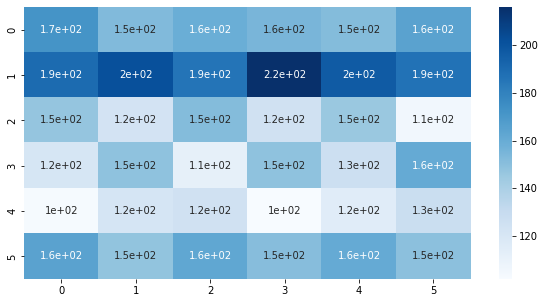

In [ ]:
import seaborn as sns
f = plt.figure()
f.set_figwidth(10)
f.set_figheight(5)
sns.heatmap(r1, annot=True, cmap = 'Blues')

In [ ]:
lb.classes_

array(['esteem', 'love', 'none', 'physiological', 'spiritual growth',
       'stability'], dtype=object)

In [ ]:
#y_test_text

In [ ]:
text_label = pd.Series(lb.inverse_transform(y_test_text))
integer_label = pd.Series(y_test_text)

In [ ]:
integer_label = integer_label.reset_index(drop = True)
#integer_label[0:20]

In [ ]:
#text_label[0:20]

In [ ]:
def make_confusion_matrix(cf,group_names=None,categories='auto',count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    '''
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html
                   
    title:         Title for the heatmap. Default is None.
    '''


    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)
    
    if title:
        plt.title(title)

In [ ]:
uniqueClassesMaslow = list(df4['maslow'].unique())
uniqueClassesMaslowLabel = list(df4['maslowLabel'].unique())

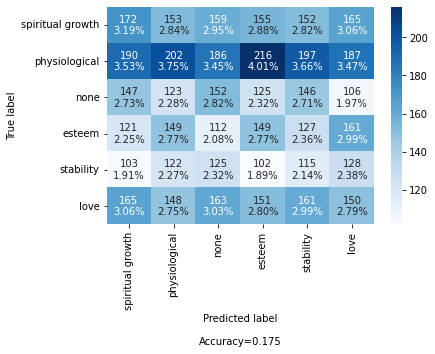

In [ ]:
make_confusion_matrix(r1, group_names=uniqueClassesMaslowLabel, categories=uniqueClassesMaslow, cmap='Blues')

In [ ]:
x_test_text = x_test_text.reset_index(drop = True)
#x_test_text[0:5]

In [ ]:
print(uniqueClassesMaslow)
print(uniqueClassesMaslowLabel)

['spiritual growth', 'physiological', 'none', 'esteem', 'stability', 'love']
[4, 3, 2, 0, 5, 1]


In [ ]:
count = 0
for i in range(0,len(review_predictions)):
    if review_predictions[i] != 4 and integer_label[i] == 4 and count != 10:
        print(x_test_text[i])
        count = count + 1

she promised take time happy
ben determined become best writer possible
i respond
it turn family would come see instead
he passed interview offered job bank teller
an artist making anime show
mila working sewing project
but unfortunately would missing favorite show
her teacher submitted statewide contest
she trained hard long time


In [ ]:
from sklearn.metrics import precision_recall_fscore_support as score

precision, recall, fscore, support = score(integer_label, review_predictions)

print('Labels::{}'.format(uniqueClassesMaslow))
print('precision: {}'.format(precision))
print('recall: {}'.format(recall))
print('fscore: {}'.format(fscore))
print('support: {}'.format(support))

Labels::['spiritual growth', 'physiological', 'none', 'esteem', 'stability', 'love']
precision: [0.17991632 0.17147708 0.1902378  0.18192918 0.16546763 0.15991471]
recall: [0.19153675 0.22519509 0.16945373 0.16592428 0.12806236 0.16722408]
fscore: [0.18554477 0.1946988  0.17924528 0.17355853 0.14438167 0.16348774]
support: [898 897 897 898 898 897]


In [ ]:
#The Kappa score tell you how much better, or worse, your classifier is than what would be expected by random chance. 
#If you were to randomly assign cases to classes (i.e. a kind of terribly uninformed classifier), you'd get some correct simply by chance. 
#Therefore, you will always find that the Kappa value is lower than the overall accuracy. 
#The Kappa index is however considered to be a more conservative measure than the overall classification accuracy. 
#Your KIA value is telling you essentially that your classifier is about 66% better than a random assignment of cases to the various classes. That's not bad!
#A kappa value of 1 represents perfect agreement, while a value of 0 represents no agreement.
from sklearn.metrics import cohen_kappa_score
cohen_score = cohen_kappa_score(integer_label, review_predictions)
print(cohen_score)

0.009479872263702505


## T 2

In [ ]:
import pandas as pd 
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns 

from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import confusion_matrix 
from sklearn.model_selection import train_test_split
import sklearn

from keras.models import Sequential
from keras.preprocessing.text import Tokenizer 
from tensorflow.keras.preprocessing.sequence import pad_sequences 
from keras.layers import Dense, Embedding, LSTM,Dropout, Conv1D, MaxPooling1D, Dropout, Activation
import tensorflow as tf

from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from nltk.corpus import stopwords  
from nltk.stem import WordNetLemmatizer
from nltk.stem import PorterStemmer
from collections import Counter 
import wordcloud
from nltk.corpus import stopwords 
from textblob import Word 
import re
from string import punctuation
import nltk

In [ ]:
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [ ]:
df = pd.read_csv('t.csv')


### Cleaning the Data

In [ ]:
df1 = df.drop(columns = ['action','motivation'])

In [ ]:
def clean(string):
    res = string.strip('][').split(', ')
    lis = []
    for word in res:
        q = word.strip('][').split(', ')
        w = q[0].lstrip('\"')[:-1]
        if w == '' or w == 'na':
            lis.append('none')
        else:
            lis.append(w)
    string = lis
    for classes in lis:
        if classes not in uniqueClasses:
            uniqueClasses.append(classes)
    return string

In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['maslow'][i] = clean(df1['maslow'][i]);
uniqueClassesMaslow = uniqueClasses

AttributeError: ignored

In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['reiss'][i] = clean(df1['reiss'][i]);
uniqueClassesReiss = uniqueClasses

In [ ]:
df2 = df1
df3 = df2.explode('maslow')

### Cleaning the Data for NLP tasks

In [ ]:
df3.shape

(55066, 8)

(array([0, 1, 2, 3, 4, 5]), <a list of 6 Text major ticklabel objects>)

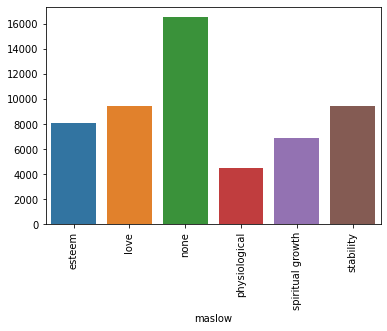

In [ ]:
c = df3.groupby('maslow')['maslow'].count()
sns.barplot(x = c.index, y = c.values)
plt.xticks(rotation = 90)

In [ ]:
df3[['sentence','maslow']].groupby('maslow').count()

,sentence
maslow,
esteem,8134
love,9483
none,16547
physiological,4487
spiritual growth,6927
stability,9488


In [ ]:
lb = LabelEncoder() 
df3['maslowLabel'] = lb.fit_transform(df3['maslow'])

In [ ]:
print(df3['maslow'].unique())
print(df3['maslowLabel'].unique())

['physiological' 'love' 'none' 'spiritual growth' 'esteem' 'stability']
[3 1 2 4 0 5]


In [ ]:
uniqueClassesMaslow = list(df3['maslow'].unique())
uniqueClassesMaslowLabel = list(df3['maslowLabel'].unique())
print(uniqueClassesMaslowLabel)
print(uniqueClassesMaslow)

[3, 1, 2, 4, 0, 5]
['physiological', 'love', 'none', 'spiritual growth', 'esteem', 'stability']


In [ ]:
punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

In [ ]:
def tokenization(string):
    words=nltk.word_tokenize(string)
    return ' '.join(words)

def removestopwords(string):
    for i in punctuation:
        string=string.replace(i,'')
    words=nltk.word_tokenize(string)
    k=[]
    eng_stop=stopwords.words('english')
    for each in words:
        if each not in eng_stop:
            k.append(each.lower())
    return ' '.join(k)

def stemmer(string):
    words = nltk.word_tokenize(string)
    ps = PorterStemmer()
    s = []
    for each in words:
        s.append(ps.stem(each))
    return ' '.join(s)

def lemmat(string):
    words=nltk.word_tokenize(string)
    ws=WordNetLemmatizer()
    l=[]
    for each in words:
        l.append(ws.lemmatize(each))
    return ' '.join(l)

def Refine(string):
    #return stemmer(lemmat(removestopwords(tokenization(string))))
    return stemmer(removestopwords(tokenization(string)))

In [ ]:
df4 = df3.copy()
df4['sentence']=df4['sentence'].apply(lambda x: Refine(x))

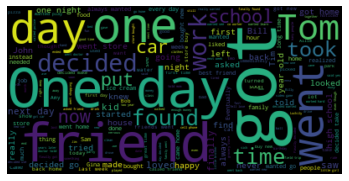

In [ ]:
common_words = ''
for i in df.sentence:
    i = str(i)
    tokens = i.split()
    common_words += " ".join(tokens) + " "
wordcloud = WordCloud().generate(common_words)   
plt.imshow(wordcloud, interpolation = 'bilinear')  # bilinear is used to display smooth images
plt.axis('off')
plt.show()

In [ ]:
k = pd.Series(np.concatenate([x.split() for x in df4.sentence])).value_counts()
a = df4['sentence'].str.lower().str.cat(sep=' ')
words = nltk.tokenize.word_tokenize(a)
word_dist = nltk.FreqDist(words)
print (word_dist)
print(len(word_dist))
rslt = pd.DataFrame(word_dist.most_common(30),
                    columns=['Word', 'Frequency'])
print(rslt)

<FreqDist with 5832 samples and 295640 outcomes>
5832
      Word  Frequency
0       he       6874
1        i       6037
2      she       5583
3      the       3627
4   friend       2513
5      day       2495
6      one       2408
7     went       2401
8       nt       2396
9     they       2361
10   decid       2333
11     got       2247
12    want       2011
13      go       1681
14     get       1498
15     new       1438
16   would       1376
17    work       1353
18    play       1308
19    home       1253
20    time       1245
21    when       1238
22    told       1218
23   could       1192
24     tri       1180
25     dog       1111
26    call       1087
27    took       1082
28     ask       1075
29      my       1065


In [ ]:
print(df4.sentence.map(lambda x: len(x)).max())

57


In [ ]:
lengths = df4["sentence"].str.len()
argmax = np.where(lengths == lengths.max())[0]
df4.iloc[argmax].head(1)

,storyid,linenum,char,motiveworkerid,context,sentence,maslow,reiss,maslowLabel
28387,13ec7161-69f7-499a-8060-4ea87fc8f8ed,4,Villanova,none,The field for the final four has been establis...,in stunner 10th seed syracus upset number 1 se...,none,[none],2


### Model BERT

https://www.section.io/engineering-education/classification-model-using-bert-and-tensorflow/

In [ ]:
!pip install -q -U "tensorflow-text==2.8.*"
!pip install -q tf-models-official==2.7.0

     |████████████████████████████████| 4.9 MB 8.4 MB/s 
     |████████████████████████████████| 1.8 MB 8.7 MB/s 
     |████████████████████████████████| 237 kB 67.2 MB/s 
     |████████████████████████████████| 352 kB 71.8 MB/s 
     |████████████████████████████████| 92 kB 6.3 MB/s 
     |████████████████████████████████| 596 kB 69.1 MB/s 
     |████████████████████████████████| 1.1 MB 69.1 MB/s 
     |████████████████████████████████| 43 kB 2.5 MB/s 
     |████████████████████████████████| 48.3 MB 1.4 MB/s 
     |████████████████████████████████| 99 kB 11.6 MB/s 
     |████████████████████████████████| 1.2 MB 47.2 MB/s 


In [ ]:
import os
import shutil
import tensorflow as tf
import tensorflow_hub as hub
import tensorflow_text as text
from official.nlp import optimization  # to create AdamW optimizer
import matplotlib.pyplot as plt
tf.get_logger().setLevel('ERROR')

In [ ]:
bert_preprocess = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_preprocess/3")
bert_encoder = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4")

In [ ]:
text_input = tf.keras.layers.Input(shape=(), dtype=tf.string, name='text')
preprocessed_text = bert_preprocess(text_input)
outputs = bert_encoder(preprocessed_text)
l = tf.keras.layers.Dropout(0.1, name="dropout")(outputs['pooled_output'])
l = tf.keras.layers.Dense(6, activation='softmax', name="output")(l)

In [ ]:
model = tf.keras.Model(inputs=[text_input], outputs = [l])

In [ ]:
'''
model = Sequential()
model.add(Embedding(7254, 100, input_length=62))
model.add(Dropout(0.2))
model.add(LSTM(200, activation = 'tanh'))
model.add(Dropout(0.2))
model.add(Dense(units = 200, activation = 'relu'))
model.add(Dense(6, activation='softmax'))
'''
#model.summary()

"\nmodel = Sequential()\nmodel.add(Embedding(7254, 100, input_length=62))\nmodel.add(Dropout(0.2))\nmodel.add(LSTM(200, activation = 'tanh'))\nmodel.add(Dropout(0.2))\nmodel.add(Dense(units = 200, activation = 'relu'))\nmodel.add(Dense(6, activation='softmax'))\n"

In [ ]:
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(df4['sentence'],df4['maslowLabel'],test_size = 0.2, random_state = 0, stratify = df4['maslowLabel'])

In [ ]:
x_train_text = x_train 
x_test_text = x_test
y_train_text = y_train
y_test_text = y_test

In [ ]:
print(x_train.shape)
print(x_test.shape)

(44052,)
(11014,)


In [ ]:
print(x_train.shape)
print(x_test.shape)

(44052,)
(11014,)


In [ ]:
from tensorflow.keras.utils import to_categorical
y_train = to_categorical(y_train)
y_test =  to_categorical(y_test)

In [ ]:
model.fit(x_train, y_train,epochs=5,verbose=1,validation_split= 0.1)

Epoch 1/5
1239/1239 [==============================] - 463s 373ms/step - loss: 1.6885 - accuracy: 0.2985 - val_loss: 1.6641 - val_accuracy: 0.3055
Epoch 2/5
1239/1239 [==============================] - 461s 372ms/step - loss: 1.6833 - accuracy: 0.3022 - val_loss: 1.6796 - val_accuracy: 0.2907
Epoch 3/5
1239/1239 [==============================] - 461s 372ms/step - loss: 1.6784 - accuracy: 0.3057 - val_loss: 1.7030 - val_accuracy: 0.2744
Epoch 4/5
1239/1239 [==============================] - 460s 371ms/step - loss: 1.6765 - accuracy: 0.3053 - val_loss: 1.6795 - val_accuracy: 0.3198
Epoch 5/5
1239/1239 [==============================] - 459s 371ms/step - loss: 1.6716 - accuracy: 0.3073 - val_loss: 1.6774 - val_accuracy: 0.3134


In [ ]:
model.evaluate(x_test, y_test)

345/345 [==============================] - 115s 333ms/step - loss: 1.6868 - accuracy: 0.3034


[1.6868268251419067, 0.30343198776245117]

### Evaluation and Analysis

In [ ]:
y_pred = model.predict(x_test)

In [ ]:
y_pred[2]

array([0.1419845 , 0.19710651, 0.29690412, 0.05900456, 0.15983005,
       0.14517029], dtype=float32)

In [ ]:
review_predictions = []
for prediction in y_pred:
    x = prediction
    review_predictions.append(np.argmax(x))

review_predictions = np.array(review_predictions)
review_predictions.reshape(1,-1)
review_predictions.shape

(11014,)

In [ ]:
review_predictions

array([2, 2, 2, ..., 2, 2, 2])

In [ ]:
k = pd.DataFrame(review_predictions, columns = ['Label'])
k.groupby('Label')['Label'].count()

Label
0     119
1      61
2    9684
3      94
4       1
5    1055
Name: Label, dtype: int64

In [ ]:
type(y_test_text)

pandas.core.series.Series

In [ ]:
r1 = sklearn.metrics.confusion_matrix(review_predictions, y_test_text)
print(r1)

[[  36   14   25    3   23   18]
 [   9   30    9    2    5    6]
 [1422 1709 2967  756 1242 1588]
 [   6   14   19   37    4   14]
 [   0    0    1    0    0    0]
 [ 154  130  289   99  111  272]]


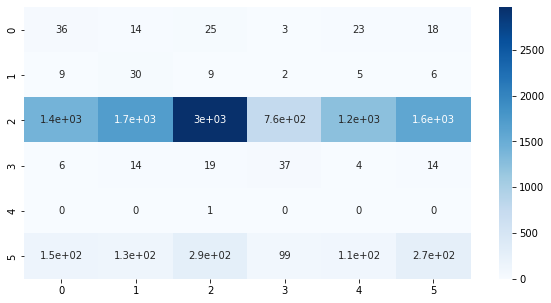

In [ ]:
f = plt.figure()
f.set_figwidth(10)
f.set_figheight(5)
sns.heatmap(r1, annot=True, cmap = 'Blues')

In [ ]:
lb.classes_

array(['esteem', 'love', 'none', 'physiological', 'spiritual growth',
       'stability'], dtype=object)

In [ ]:
y_test_text

12966    4
38839    1
10485    1
30649    3
3592     2
        ..
34501    5
18501    2
23482    2
5892     0
264      5
Name: maslowLabel, Length: 11014, dtype: int64

In [ ]:
text_label = pd.Series(lb.inverse_transform(y_test_text))
integer_label = pd.Series(y_test_text)

In [ ]:
integer_label = integer_label.reset_index(drop = True)
integer_label[0:20]

0     4
1     1
2     1
3     3
4     2
5     1
6     5
7     5
8     0
9     2
10    3
11    2
12    4
13    0
14    5
15    2
16    0
17    1
18    3
19    1
Name: maslowLabel, dtype: int64

In [ ]:
text_label[0:20]

0     spiritual growth
1                 love
2                 love
3        physiological
4                 none
5                 love
6            stability
7            stability
8               esteem
9                 none
10       physiological
11                none
12    spiritual growth
13              esteem
14           stability
15                none
16              esteem
17                love
18       physiological
19                love
dtype: object

In [ ]:
def make_confusion_matrix(cf,group_names=None,categories='auto',count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    '''
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html
                   
    title:         Title for the heatmap. Default is None.
    '''


    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)
    
    if title:
        plt.title(title)

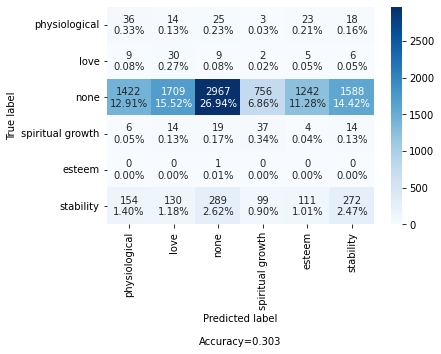

In [ ]:
make_confusion_matrix(r1, group_names=uniqueClassesMaslowLabel, categories=uniqueClassesMaslow, cmap='Blues')

In [ ]:
x_test_text = x_test_text.reset_index(drop = True)
x_test_text[0:5]

0                      the bow pick shoot father
1        the note ask jim like ami ask answer ye
2    we becam close friend made time much easier
3                     she pick cutest littl doll
4    the insur specialist assur would better car
Name: sentence, dtype: object

In [ ]:
print(uniqueClassesMaslowLabel)
print(uniqueClassesMaslow)

[3, 1, 2, 4, 0, 5]
['physiological', 'love', 'none', 'spiritual growth', 'esteem', 'stability']


In [ ]:
y_test

array([[0., 0., 0., 0., 1., 0.],
       [0., 1., 0., 0., 0., 0.],
       [0., 1., 0., 0., 0., 0.],
       ...,
       [0., 0., 1., 0., 0., 0.],
       [1., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 1.]], dtype=float32)

In [ ]:
count = 0
for i in range(0,len(review_predictions)):
    if review_predictions[i] != 0 and integer_label[i] == 0 and count != 10:
        print(x_test_text[i])
        count = count + 1

two boy knock book arm hallway
we becam close friend made time much easier
hi instructor shook head disappointingli
everi month mail gift
he famou antic attract new custom
he made varsiti squad
her scienc teacher encourag compet scienc fair
the band contact two month wed
within week everyon knew
my wife daughter went shop queen


In [ ]:
count = 0
for i in range(0,len(review_predictions)):
    if review_predictions[i] != 1 and integer_label[i] == 1 and count != 10:
        print(x_test_text[i])
        count = count + 1

the note ask jim like ami ask answer ye
we becam close friend made time much easier
no one town could believ phil left wife laurel
jane apolog slow
howev dan girlfriend move need larger bed
teddi got elect becom presid
andrea shock delight tell husband news
one kid dad said look like antiqu
bob mike want go lake fish trip
we decid go rock climb


## Error pg268 NLP in action

In [ ]:
import pandas as pd 
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns 

from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import confusion_matrix 
from sklearn.model_selection import train_test_split
import sklearn

from keras.models import Sequential
from keras.preprocessing.text import Tokenizer 
from tensorflow.keras.preprocessing.sequence import pad_sequences 
from keras.layers import Dense, Embedding, LSTM,Dropout, Conv1D, MaxPooling1D, Dropout, Activation
import tensorflow as tf

from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from nltk.corpus import stopwords  
from nltk.stem import WordNetLemmatizer
from nltk.stem import PorterStemmer
from collections import Counter 
import wordcloud
from nltk.corpus import stopwords 
from textblob import Word 
import re
from string import punctuation
import nltk

In [ ]:
from nltk.tokenize import TreebankWordTokenizer 
from gensim.models import KeyedVectors
import gensim.downloader as api
word_vectors = api.load("glove-wiki-gigaword-100") 

In [ ]:
df = pd.read_csv('t.csv')

### Cleaning the Data

In [ ]:
df1 = df.drop(columns = ['action','motivation'])

In [ ]:
def clean(string):
    res = string.strip('][').split(', ')
    lis = []
    for word in res:
        q = word.strip('][').split(', ')
        w = q[0].lstrip('\"')[:-1]
        if w == '' or w == 'na':
            lis.append('none')
        else:
            lis.append(w)
    string = lis
    for classes in lis:
        if classes not in uniqueClasses:
            uniqueClasses.append(classes)
    return string

In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['maslow'][i] = clean(df1['maslow'][i]);
uniqueClassesMaslow = uniqueClasses

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['reiss'][i] = clean(df1['reiss'][i]);
uniqueClassesReiss = uniqueClasses

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
df2 = df1
df3 = df2.explode('maslow')
lb = LabelEncoder() 
df3['maslowLabel'] = lb.fit_transform(df3['maslow'])

In [ ]:
df3.head(1)

,storyid,linenum,char,motiveworkerid,context,sentence,maslow,reiss,maslowLabel
0,a2ddbb50-e45b-4ad3-becf-b2d8475172bf,1,I (myself),ann0,NaN,I began making fish curry for my boyfriend and I.,physiological,[food],3


In [ ]:
def tokenize_and_vectorize(dataset):
    tokenizer = TreebankWordTokenizer()
    vectorized_data = []
    expected = []
    for sample in dataset:
        tokens = tokenizer.tokenize(sample[1])
        sample_vecs = []
        for token in tokens:
            try:
                sample_vecs.append(word_vectors[token])
            except KeyError:
                pass 
        vectorized_data.append(sample_vecs)
    return vectorized_data

In [ ]:
d = df['sentence'].tolist()

In [ ]:
vectorized_data = tokenize_and_vectorize(d)

In [ ]:
len(d)

47547

In [ ]:
expected = df3['maslow']
len(vectorized_data)

47547

In [ ]:
vectorized_data[47530]

[array([-0.27086  ,  0.044006 , -0.02026  , -0.17395  ,  0.6444   ,
         0.71213  ,  0.3551   ,  0.47138  , -0.29637  ,  0.54427  ,
        -0.72294  , -0.0047612,  0.040611 ,  0.043236 ,  0.29729  ,
         0.10725  ,  0.40156  , -0.53662  ,  0.033382 ,  0.067396 ,
         0.64556  , -0.085523 ,  0.14103  ,  0.094539 ,  0.74947  ,
        -0.194    , -0.68739  , -0.41741  , -0.22807  ,  0.12     ,
        -0.48999  ,  0.80945  ,  0.045138 , -0.11898  ,  0.20161  ,
         0.39276  , -0.20121  ,  0.31354  ,  0.75304  ,  0.25907  ,
        -0.11566  , -0.029319 ,  0.93499  , -0.36067  ,  0.5242   ,
         0.23706  ,  0.52715  ,  0.22869  , -0.51958  , -0.79349  ,
        -0.20368  , -0.50187  ,  0.18748  ,  0.94282  , -0.44834  ,
        -3.6792   ,  0.044183 , -0.26751  ,  2.1997   ,  0.241    ,
        -0.033425 ,  0.69553  , -0.64472  , -0.0072277,  0.89575  ,
         0.20015  ,  0.46493  ,  0.61933  , -0.1066   ,  0.08691  ,
        -0.4623   ,  0.18262  , -0.15849  ,  0.0

In [ ]:
split_point = int(len(vectorized_data)*0.8)
print(split_point)

38037


In [ ]:
x_train = vectorized_data[:split_point]
y_train = expected[:split_point]
x_test = vectorized_data[split_point:]
y_test = expected[split_point:]
maxlen = 8 
batch_size = 32
embedding_dims = 50
filters = 250
kernel_size = 3
hidden_dims = 250
epochs = 2

def pad_trunc(data, maxlen):
    new_data = []
    zero_vector = []
    for i in range(len(data)):
        zero_vector.append(0)
    for sample in data:
        if len(sample) > maxlen:
            temp = sample[:maxlen]
        elif len(sample) < maxlen:
            temp = sample
            additional_elems = maxlen - len(sample)
            for _ in range(additional_elems):
                temp.append(zero_vector)
        else:
            temp = sample 
        new_data.append(temp)
    return new_data

In [ ]:
x_train = pad_trunc(x_train, maxlen)
x_test = pad_trunc(x_test, maxlen)

In [ ]:
len(x_train)

38037

In [ ]:
x_train = np.reshape(x_train, (len(x_train), maxlen, embedding_dims))
y_train = np.array(y_train)
x_test = np.reshape(x_test, (len(x_test), maxlen, embedding_dims))
y_test = np.array(y_test)

/usr/local/lib/python3.7/dist-packages/numpy/core/fromnumeric.py:43: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  result = getattr(asarray(obj), method)(*args, **kwds)


ValueError: ignored

## T 4

In [ ]:
import pandas as pd 
import matplotlib.pyplot as plt
import numpy as np

from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import confusion_matrix 
from sklearn.model_selection import train_test_split

from keras.models import Sequential
from keras.preprocessing.text import Tokenizer 
from tensorflow.keras.preprocessing.sequence import pad_sequences 
from keras.layers import Dense, Embedding, LSTM,Dropout
import tensorflow as tf
import keras

from nltk.corpus import stopwords  
from nltk.stem import WordNetLemmatizer
from collections import Counter 
import wordcloud
from nltk.corpus import stopwords 
from textblob import Word 
import re
from string import punctuation
import nltk

In [ ]:
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [ ]:
df = pd.read_csv('t.csv')

### Cleaning the Data

In [ ]:
df = df.iloc[:,5:]
df1 = df.drop(columns = ['action','motivation'])
#df1.head()

In [ ]:
def clean(string):
    res = string.strip('][').split(', ')
    lis = []
    for word in res:
        q = word.strip('][').split(', ')
        w = q[0].lstrip('\"')[:-1]
        if w == '' or w == 'na':
            lis.append('none')
        else:
            lis.append(w)
    string = lis
    for classes in lis:
        if classes not in uniqueClasses:
            uniqueClasses.append(classes)
    return string

In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['maslow'][i] = clean(df1['maslow'][i]);
uniqueClassesMaslow = uniqueClasses

In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['reiss'][i] = clean(df1['reiss'][i]);
uniqueClassesReiss = uniqueClasses

In [ ]:
df2 = df1
df3 = df2.explode('maslow')

In [ ]:
df3.head()

,sentence,maslow,reiss
0,I began making fish curry for my boyfriend and I.,physiological,[food]
1,I began making fish curry for my boyfriend and I.,love,"[family, romance, food]"
1,I began making fish curry for my boyfriend and I.,physiological,"[family, romance, food]"
2,I began making fish curry for my boyfriend and I.,physiological,[food]
3,I began making fish curry for my boyfriend and I.,none,[none]


### Cleaning the Data for NLP tasks

In [ ]:
df3.shape

(55066, 3)

(array([0, 1, 2, 3, 4, 5]), <a list of 6 Text major ticklabel objects>)

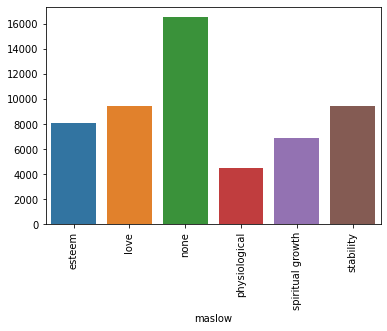

In [ ]:
import seaborn as sns 
c = df3.groupby('maslow')['maslow'].count()
sns.barplot(x = c.index, y = c.values)
plt.xticks(rotation = 90)

In [ ]:
df3[['sentence','maslow']].groupby('maslow').count()

,sentence
maslow,
esteem,8134
love,9483
none,16547
physiological,4487
spiritual growth,6927
stability,9488


In [ ]:
lb = LabelEncoder() 
df3['maslowLabel'] = lb.fit_transform(df3['maslow'])

In [ ]:
df3

,sentence,maslow,reiss,maslowLabel
0,I began making fish curry for my boyfriend and I.,physiological,[food],3
1,I began making fish curry for my boyfriend and I.,love,"[family, romance, food]",1
1,I began making fish curry for my boyfriend and I.,physiological,"[family, romance, food]",3
2,I began making fish curry for my boyfriend and I.,physiological,[food],3
3,I began making fish curry for my boyfriend and I.,none,[none],2
...,...,...,...,...
47542,A crab was inside the shell pinching his leg.,spiritual growth,[curiosity],4
47543,A crab was inside the shell pinching his leg.,spiritual growth,[curiosity],4
47544,A crab was inside the shell pinching his leg.,none,[none],2
47545,A crab was inside the shell pinching his leg.,stability,[tranquility],5


In [ ]:
print(df3['maslow'].unique())
print(df3['maslowLabel'].unique())

['physiological' 'love' 'none' 'spiritual growth' 'esteem' 'stability']
[3 1 2 4 0 5]


https://machinelearningmastery.com/multi-class-imbalanced-classification/

In [ ]:
from collections import Counter
x = df3['sentence']
y = df3['maslowLabel'] 
counter = Counter(y)
for k,v in counter.items():
	per = v / len(y) * 100
	print('Class=%d, n=%d (%.3f%%)' % (k, v, per))

Class=3, n=4487 (8.148%)
Class=1, n=9483 (17.221%)
Class=2, n=16547 (30.049%)
Class=4, n=6927 (12.579%)
Class=0, n=8134 (14.771%)
Class=5, n=9488 (17.230%)


In [ ]:
punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

In [ ]:
def tokenization(string):
    words=nltk.word_tokenize(string)
    return ' '.join(words)

def removestopwords(string):
    for i in punctuation:
        string=string.replace(i,'')
    words=nltk.word_tokenize(string)
    k=[]
    eng_stop=stopwords.words('english')
    for each in words:
        if each not in eng_stop:
            k.append(each.lower())
    return ' '.join(k)

def lemmat(string):
    words=nltk.word_tokenize(string)
    ws=WordNetLemmatizer()
    l=[]
    for each in words:
        l.append(ws.lemmatize(each))
    return ' '.join(l)

def Refine(string):
    return lemmat(removestopwords(tokenization(string)))

In [ ]:
df4 = df3.copy()
df4['sentence']=df4['sentence'].apply(lambda x: Refine(x))
df4

,sentence,maslow,reiss,maslowLabel
0,i began making fish curry boyfriend i,physiological,[food],3
1,i began making fish curry boyfriend i,love,"[family, romance, food]",1
1,i began making fish curry boyfriend i,physiological,"[family, romance, food]",3
2,i began making fish curry boyfriend i,physiological,[food],3
3,i began making fish curry boyfriend i,none,[none],2
...,...,...,...,...
47542,a crab inside shell pinching leg,spiritual growth,[curiosity],4
47543,a crab inside shell pinching leg,spiritual growth,[curiosity],4
47544,a crab inside shell pinching leg,none,[none],2
47545,a crab inside shell pinching leg,stability,[tranquility],5


In [ ]:
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

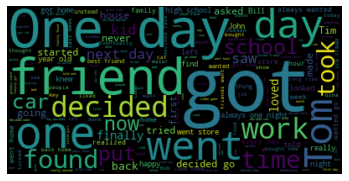

In [ ]:
common_words = ''
for i in df.sentence:
    i = str(i)
    tokens = i.split()
    common_words += " ".join(tokens) + " "
wordcloud = WordCloud().generate(common_words)   
plt.imshow(wordcloud, interpolation = 'bilinear')  # bilinear is used to display smooth images
plt.axis('off')
plt.show()

In [ ]:
k = pd.Series(np.concatenate([x.split() for x in df4.sentence])).value_counts()
a = df4['sentence'].str.lower().str.cat(sep=' ')
words = nltk.tokenize.word_tokenize(a)
word_dist = nltk.FreqDist(words)
print (word_dist)
print(len(word_dist))
rslt = pd.DataFrame(word_dist.most_common(30),
                    columns=['Word', 'Frequency'])
#print(rslt)

<FreqDist with 7254 samples and 295640 outcomes>
7254


In [ ]:
print(df4.sentence.map(lambda x: len(x)).max())

62


In [ ]:
lengths = df4["sentence"].str.len()
argmax = np.where(lengths == lengths.max())[0]
df4.iloc[argmax].head(1)

,sentence,maslow,reiss,maslowLabel
21422,one day i decided i wanted become professional...,spiritual growth,[curiosity],4


### Model FFN with CNN

In [ ]:
from keras.layers import Dense, Flatten, LSTM, Conv1D, MaxPooling1D, Dropout, Activation
from keras.layers import GlobalMaxPooling1D

In [ ]:
#input_array = np.random.randint(1000, size=(32, 10))
#print(input_array.ndim)
#print(input_array.shape)
#print(input_array.size)
#k = input_array.flatten()
#print(len(k))
#print(input_array)

In [ ]:
batch_size = 32
filters = 250
kernel_size = 3
hidden_dims = 250
epochs = 10

In [ ]:
model = Sequential()
model.add(Embedding(7254, 100, input_length=62))
model.add(Conv1D(filters, kernel_size, padding = 'valid', activation = 'relu', strides = 1, input_shape = (44052, 62)))
model.add(GlobalMaxPooling1D())
model.add(Dense(hidden_dims))
model.add(Dropout(0.2))
model.add(Activation('relu'))
model.add(Dense(6))
model.add(Activation('sigmoid'))

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, 62, 100)           725400    
                                                                 
 conv1d (Conv1D)             (None, 60, 250)           75250     
                                                                 
 global_max_pooling1d (Globa  (None, 250)              0         
 lMaxPooling1D)                                                  
                                                                 
 dense (Dense)               (None, 250)               62750     
                                                                 
 dropout (Dropout)           (None, 250)               0         
                                                                 
 activation (Activation)     (None, 250)               0         
                                                        

In [ ]:
'''
METRICS = [
      keras.metrics.TruePositives(name='tp'),
      keras.metrics.FalsePositives(name='fp'),
      keras.metrics.TrueNegatives(name='tn'),
      keras.metrics.FalseNegatives(name='fn'), 
      keras.metrics.CategoricalCrossentropy(name='categorical_cross_entropy'),
      keras.metrics.Precision(name='precision'),
      keras.metrics.Recall(name='recall'),
      keras.metrics.AUC(name='auc'),
      keras.metrics.AUC(name='prc', curve='PR'), # precision-recall curve
]
'''

"\nMETRICS = [\n      keras.metrics.TruePositives(name='tp'),\n      keras.metrics.FalsePositives(name='fp'),\n      keras.metrics.TrueNegatives(name='tn'),\n      keras.metrics.FalseNegatives(name='fn'), \n      keras.metrics.CategoricalCrossentropy(name='categorical_cross_entropy'),\n      keras.metrics.Precision(name='precision'),\n      keras.metrics.Recall(name='recall'),\n      keras.metrics.AUC(name='auc'),\n      keras.metrics.AUC(name='prc', curve='PR'), # precision-recall curve\n]\n"

In [ ]:
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics= 'accuracy')

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(df4['sentence'],df4['maslowLabel'],test_size = 0.2, random_state = 0, stratify = df4['maslowLabel'])

In [ ]:
x_train_text = x_train 
x_test_text = x_test
y_train_text = y_train
y_test_text = y_test

In [ ]:
print(x_train.shape)
print(x_test.shape)

(44052,)
(11014,)


In [ ]:
tokenizer = Tokenizer(num_words = 7254, split = ' ')
tokenizer.fit_on_texts(x_train.values)
x = tokenizer.texts_to_sequences(x_train.values) # Numerical vectors got created
x = pad_sequences(x, maxlen=62)
x_train = x

tokenizer = Tokenizer(num_words = 7254, split = ' ')
tokenizer.fit_on_texts(x_test.values)
x = tokenizer.texts_to_sequences(x_test.values) # Numerical vectors got created
x = pad_sequences(x, maxlen=62)
x_test = x

In [ ]:
print(x_train.ndim)
print(x_train.shape)
print(x_test.shape)

2
(44052, 62)
(11014, 62)


In [ ]:
from tensorflow.keras.utils import to_categorical
y_train = to_categorical(y_train)
y_test =  to_categorical(y_test)

In [ ]:
model.fit(x_train, y_train,verbose=1, validation_data = (x_test, y_test), batch_size = 32, epochs = epochs)

Epoch 1/10
1377/1377 [==============================] - 57s 40ms/step - loss: 1.6314 - accuracy: 0.3348 - val_loss: 1.7998 - val_accuracy: 0.2584
Epoch 2/10
1377/1377 [==============================] - 64s 47ms/step - loss: 1.4744 - accuracy: 0.4066 - val_loss: 1.8779 - val_accuracy: 0.2330
Epoch 3/10
1377/1377 [==============================] - 55s 40ms/step - loss: 1.3705 - accuracy: 0.4376 - val_loss: 1.8776 - val_accuracy: 0.2261
Epoch 4/10
1377/1377 [==============================] - 50s 37ms/step - loss: 1.2897 - accuracy: 0.4540 - val_loss: 1.9926 - val_accuracy: 0.2272
Epoch 5/10
1377/1377 [==============================] - 53s 39ms/step - loss: 1.2199 - accuracy: 0.4635 - val_loss: 2.1604 - val_accuracy: 0.2400
Epoch 6/10
1377/1377 [==============================] - 49s 35ms/step - loss: 1.1627 - accuracy: 0.4685 - val_loss: 2.2345 - val_accuracy: 0.2468
Epoch 7/10
1377/1377 [==============================] - 51s 37ms/step - loss: 1.1166 - accuracy: 0.4737 - val_loss: 2.3498 -

In [ ]:
model.evaluate(x_test, y_test)

345/345 [==============================] - 3s 9ms/step - loss: 2.6645 - accuracy: 0.2214


[2.6644864082336426, 0.2213546335697174]

### Evaluation and Analysis

In [ ]:
y_pred = model.predict(x_test)

In [ ]:
y_pred[2]

array([0.03046741, 0.5054372 , 0.23377813, 0.12541716, 0.01784164,
       0.08705846], dtype=float32)

In [ ]:
review_predictions = []
for prediction in y_pred:
    x = prediction
    review_predictions.append(np.argmax(x))

review_predictions = np.array(review_predictions)
review_predictions.reshape(1,-1)
review_predictions.shape

(11014,)

In [ ]:
review_predictions

array([0, 2, 1, ..., 2, 0, 5])

In [ ]:
k = pd.DataFrame(review_predictions, columns = ['Label'])
k.groupby('Label')['Label'].count()

Label
0    1521
1    2360
2    4147
3     931
4     600
5    1455
Name: Label, dtype: int64

In [ ]:
type(y_test_text)

pandas.core.series.Series

In [ ]:
import sklearn
r1 = sklearn.metrics.confusion_matrix(review_predictions, y_test_text)
print(r1)

[[ 214  303  452  104  205  243]
 [ 334  408  702  200  299  417]
 [ 591  722 1242  387  502  703]
 [ 154  130  269   66  132  180]
 [ 106   99  185   48   67   95]
 [ 228  235  460   92  180  260]]


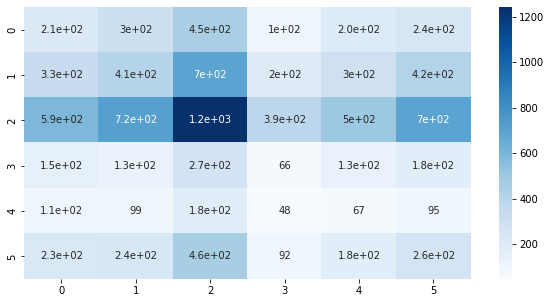

In [ ]:
import seaborn as sns
f = plt.figure()
f.set_figwidth(10)
f.set_figheight(5)
sns.heatmap(r1, annot=True, cmap = 'Blues')

In [ ]:
lb.classes_

array(['esteem', 'love', 'none', 'physiological', 'spiritual growth',
       'stability'], dtype=object)

In [ ]:
#y_test_text

In [ ]:
text_label = pd.Series(lb.inverse_transform(y_test_text))
integer_label = pd.Series(y_test_text)

In [ ]:
integer_label = integer_label.reset_index(drop = True)
#integer_label[0:20]

In [ ]:
#text_label[0:20]

In [ ]:
def make_confusion_matrix(cf,group_names=None,categories='auto',count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    '''
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html
                   
    title:         Title for the heatmap. Default is None.
    '''


    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)
    
    if title:
        plt.title(title)

In [ ]:
uniqueClassesMaslow = list(df4['maslow'].unique())
uniqueClassesMaslowLabel = list(df4['maslowLabel'].unique())

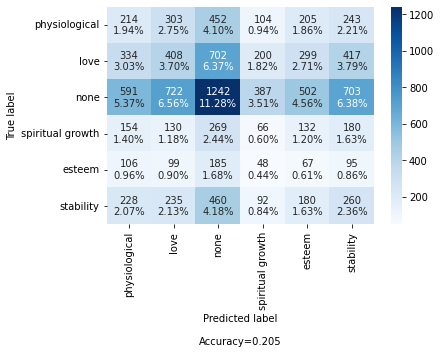

In [ ]:
make_confusion_matrix(r1, group_names=uniqueClassesMaslowLabel, categories=uniqueClassesMaslow, cmap='Blues')

In [ ]:
x_test_text = x_test_text.reset_index(drop = True)
#x_test_text[0:5]

In [ ]:
count = 0
for i in range(0,len(review_predictions)):
    if review_predictions[i] != 0 and integer_label[i] == 0 and count != 10:
        print(x_test_text[i])
        count = count + 1

two boy knocked book arm hallway
we became close friend made time much easier
his instructor shook head disappointingly
every month mailed gift
he famous antic attracted new customer
he made varsity squad
her science teacher encouraged compete science fair
the band contacted two month wedding
within week everyone knew
my wife daughter went shopping queen


In [ ]:
from sklearn.metrics import precision_recall_fscore_support as score

precision, recall, fscore, support = score(integer_label, review_predictions)

print('Labels::{}'.format(uniqueClassesMaslow))
print('precision: {}'.format(precision))
print('recall: {}'.format(recall))
print('fscore: {}'.format(fscore))
print('support: {}'.format(support))

Labels::['physiological', 'love', 'none', 'spiritual growth', 'esteem', 'stability']
precision: [0.14069691 0.17288136 0.29949361 0.07089151 0.11166667 0.17869416]
recall: [0.13153042 0.21507644 0.37522659 0.0735786  0.04837545 0.1369863 ]
fscore: [0.13595934 0.19168428 0.33310983 0.07221007 0.0675063  0.155085  ]
support: [1627 1897 3310  897 1385 1898]


In [ ]:
#The Kappa score tell you how much better, or worse, your classifier is than what would be expected by random chance. 
#If you were to randomly assign cases to classes (i.e. a kind of terribly uninformed classifier), you'd get some correct simply by chance. 
#Therefore, you will always find that the Kappa value is lower than the overall accuracy. 
#The Kappa index is however considered to be a more conservative measure than the overall classification accuracy. 
#Your KIA value is telling you essentially that your classifier is about 66% better than a random assignment of cases to the various classes. That's not bad!
#A kappa value of 1 represents perfect agreement, while a value of 0 represents no agreement.
from sklearn.metrics import cohen_kappa_score
cohen_score = cohen_kappa_score(integer_label, review_predictions)
print(cohen_score)

-0.0025701661192405467


## Error Roberta T5

In [ ]:
import pandas as pd 
import matplotlib.pyplot as plt
import numpy as np
from nltk.corpus import stopwords  
from nltk.stem import WordNetLemmatizer
from collections import Counter 
import wordcloud
from nltk.corpus import stopwords 
import re
from string import punctuation
import nltk

In [ ]:
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [ ]:
df = pd.read_csv('t.csv')

### Cleaning the Data

In [ ]:
df = df.iloc[:,5:]
df1 = df.drop(columns = ['action','motivation'])
#df1.head()

In [ ]:
def clean(string):
    res = string.strip('][').split(', ')
    lis = []
    for word in res:
        q = word.strip('][').split(', ')
        w = q[0].lstrip('\"')[:-1]
        if w == '' or w == 'na':
            lis.append('none')
        else:
            lis.append(w)
    string = lis
    for classes in lis:
        if classes not in uniqueClasses:
            uniqueClasses.append(classes)
    return string

In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['maslow'][i] = clean(df1['maslow'][i]);
uniqueClassesMaslow = uniqueClasses

In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['reiss'][i] = clean(df1['reiss'][i]);
uniqueClassesReiss = uniqueClasses

In [ ]:
df2 = df1
df3 = df2.explode('maslow')

In [ ]:
df3.head()

,sentence,maslow,reiss
0,I began making fish curry for my boyfriend and I.,physiological,[food]
1,I began making fish curry for my boyfriend and I.,love,"[family, romance, food]"
1,I began making fish curry for my boyfriend and I.,physiological,"[family, romance, food]"
2,I began making fish curry for my boyfriend and I.,physiological,[food]
3,I began making fish curry for my boyfriend and I.,none,[none]


### Cleaning the Data for NLP tasks

In [ ]:
df3[['sentence','maslow']].groupby('maslow').count()

,sentence
maslow,
esteem,8134
love,9483
none,16547
physiological,4487
spiritual growth,6927
stability,9488


In [ ]:
lb = LabelEncoder() 
df3['maslowLabel'] = lb.fit_transform(df3['maslow'])

In [ ]:
print(df3['maslow'].unique())
print(df3['maslowLabel'].unique())

['physiological' 'love' 'none' 'spiritual growth' 'esteem' 'stability']
[3 1 2 4 0 5]


https://machinelearningmastery.com/multi-class-imbalanced-classification/

In [ ]:
def tokenization(string):
    words=nltk.word_tokenize(string)
    return ' '.join(words)

def removestopwords(string):
    for i in punctuation:
        string=string.replace(i,'')
    words=nltk.word_tokenize(string)
    k=[]
    eng_stop=stopwords.words('english')
    for each in words:
        if each not in eng_stop:
            k.append(each.lower())
    return ' '.join(k)

def lemmat(string):
    words=nltk.word_tokenize(string)
    ws=WordNetLemmatizer()
    l=[]
    for each in words:
        l.append(ws.lemmatize(each))
    return ' '.join(l)

def Refine(string):
    return lemmat(removestopwords(tokenization(string)))

In [ ]:
df4 = df3.copy()
df4['sentence']=df4['sentence'].apply(lambda x: Refine(x))
df4

,sentence,maslow,reiss,maslowLabel
0,i began making fish curry boyfriend i,physiological,[food],3
1,i began making fish curry boyfriend i,love,"[family, romance, food]",1
1,i began making fish curry boyfriend i,physiological,"[family, romance, food]",3
2,i began making fish curry boyfriend i,physiological,[food],3
3,i began making fish curry boyfriend i,none,[none],2
...,...,...,...,...
47542,a crab inside shell pinching leg,spiritual growth,[curiosity],4
47543,a crab inside shell pinching leg,spiritual growth,[curiosity],4
47544,a crab inside shell pinching leg,none,[none],2
47545,a crab inside shell pinching leg,stability,[tranquility],5


In [ ]:
print(df4.sentence.map(lambda x: len(x)).max())

lengths = df4["sentence"].str.len()
argmax = np.where(lengths == lengths.max())[0]
df4.iloc[argmax].head(1)

62


,sentence,maslow,reiss,maslowLabel
21422,one day i decided i wanted become professional...,spiritual growth,[curiosity],4


In [ ]:
x_train = df4['sentence']

In [ ]:
!pip install transformers
!pip install scipy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 4.4 MB 5.2 MB/s 
     |████████████████████████████████| 6.6 MB 41.0 MB/s 
     |████████████████████████████████| 101 kB 10.0 MB/s 
     |████████████████████████████████| 596 kB 65.7 MB/s 
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from transformers import AutoTokenizer, AutoModelForSequenceClassification
from scipy.special import softmax

In [ ]:
x_train[3]

'i began making fish curry boyfriend i'

In [ ]:
# load model and tokenizer
roberta = "cardiffnlp/twitter-roberta-base-sentiment"

model = AutoModelForSequenceClassification.from_pretrained(roberta)
tokenizer = AutoTokenizer.from_pretrained(roberta)

labels = ['Negative', 'Neutral', 'Positive']
output_list = []
lis_sentence = df4['sentence'].to_list()
for i in range(len(lis_sentence)):
    encoded_tweet = tokenizer(lis_sentence[i], return_tensors='pt')
    output = model(**encoded_tweet)
    scores = output[0][0].detach().numpy()
    scores = softmax(scores)
    output_list.append(labels[np.argmax(scores)])


KeyboardInterrupt: ignored

In [ ]:
print(x_train.shape[0])
print(len(output_list))

55066

## T5

In [ ]:
! pip install nlpia

In [ ]:
import pandas as pd 
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns 
import os 

from random import shuffle
from nlpia.loaders import get_data 
from nltk.tokenize import TreebankWordTokenizer 
from nltk.corpus import stopwords  
from nltk.stem import WordNetLemmatizer
from nltk.stem import PorterStemmer
from collections import Counter 
from nltk.corpus import stopwords 
import re
from string import punctuation
import nltk

/usr/local/lib/python3.7/dist-packages/pugnlp/constants.py:136: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  [datetime.datetime, pd.datetime, pd.Timestamp])
/usr/local/lib/python3.7/dist-packages/pugnlp/constants.py:158: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  MIN_TIMESTAMP = pd.Timestamp(pd.datetime(1677, 9, 22, 0, 12, 44), tz='utc')
/usr/local/lib/python3.7/dist-packages/pugnlp/tutil.py:100: FutureWarning: The pandas.np module is deprecated and will be removed from pandas in a future version. Import numpy directly instead
  np = pd.np
/usr/local/lib/python3.7/dist-packages/pugnlp/util.py:80: FutureWarning: The pandas.np module is deprecated and will be removed from pandas in a future version. Import numpy directly instead
  np = pd.np
/usr/local/lib/python3.7/dist-packages/nlpia

In [ ]:
df = pd.read_csv('t.csv')

### Cleaning the Data

In [ ]:
df = df.iloc[:,5:]
df1 = df.drop(columns = ['action','motivation'])
#df1.head()

In [ ]:
def clean(string):
    res = string.strip('][').split(', ')
    lis = []
    for word in res:
        q = word.strip('][').split(', ')
        w = q[0].lstrip('\"')[:-1]
        if w == '' or w == 'na':
            lis.append('none')
        else:
            lis.append(w)
    string = lis
    for classes in lis:
        if classes not in uniqueClasses:
            uniqueClasses.append(classes)
    return string

In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['maslow'][i] = clean(df1['maslow'][i]);
uniqueClassesMaslow = uniqueClasses

In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['reiss'][i] = clean(df1['reiss'][i]);
uniqueClassesReiss = uniqueClasses

In [ ]:
df2 = df1
df3 = df2.explode('maslow')

In [ ]:
df3.head()

,sentence,maslow,reiss
0,I began making fish curry for my boyfriend and I.,physiological,[food]
1,I began making fish curry for my boyfriend and I.,love,"[family, romance, food]"
1,I began making fish curry for my boyfriend and I.,physiological,"[family, romance, food]"
2,I began making fish curry for my boyfriend and I.,physiological,[food]
3,I began making fish curry for my boyfriend and I.,none,[none]


### Cleaning the Data for NLP tasks

In [ ]:
df3.shape

(55066, 3)

In [ ]:
df3[['sentence','maslow']].groupby('maslow').count()

,sentence
maslow,
esteem,8134
love,9483
none,16547
physiological,4487
spiritual growth,6927
stability,9488


In [ ]:
lb = LabelEncoder() 
df3['maslowLabel'] = lb.fit_transform(df3['maslow'])

In [ ]:
print(df3['maslow'].unique())
print(df3['maslowLabel'].unique())

['physiological' 'love' 'none' 'spiritual growth' 'esteem' 'stability']
[3 1 2 4 0 5]


In [ ]:
punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

In [ ]:
def tokenization(string):
    words=nltk.word_tokenize(string)
    return ' '.join(words)

def removestopwords(string):
    for i in punctuation:
        string=string.replace(i,'')
    words=nltk.word_tokenize(string)
    k=[]
    eng_stop=stopwords.words('english')
    for each in words:
        if each not in eng_stop:
            k.append(each.lower())
    return ' '.join(k)

def lemmat(string):
    words=nltk.word_tokenize(string)
    ws=WordNetLemmatizer()
    l=[]
    for each in words:
        l.append(ws.lemmatize(each))
    return ' '.join(l)

def Refine(string):
    return lemmat(removestopwords(tokenization(string)))

In [ ]:
df4 = df3.copy()
df4['sentence']=df4['sentence'].apply(lambda x: Refine(x))
df4.head(1)

,sentence,maslow,reiss,maslowLabel
0,i began making fish curry boyfriend i,physiological,[food],3


In [ ]:
k = pd.Series(np.concatenate([x.split() for x in df4.sentence])).value_counts()
a = df4['sentence'].str.lower().str.cat(sep=' ')
words = nltk.tokenize.word_tokenize(a)
word_dist = nltk.FreqDist(words)
print (word_dist)
print(len(word_dist))
rslt = pd.DataFrame(word_dist.most_common(30),
                    columns=['Word', 'Frequency'])
#print(rslt)

<FreqDist with 7254 samples and 295640 outcomes>
7254


In [ ]:
print(df4.sentence.map(lambda x: len(x)).max())

62


In [ ]:
lengths = df4["sentence"].str.len()
argmax = np.where(lengths == lengths.max())[0]
df4.iloc[argmax].head(1)

,sentence,maslow,reiss,maslowLabel
21422,one day i decided i wanted become professional...,spiritual growth,[curiosity],4


In [ ]:
# Number of unique words in df4['sentence']
results = set()
len(df4['sentence'].str.lower().str.split().apply(results.update))

55066

### RNN + LSTM for Classifying Positive or negative reviews

In [ ]:
import numpy as np 
#from tensorflow.keras.preprocessing import sequence  Use this: tf.keras.utils.timeseries_dataset_from_array
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense,Activation,Embedding, LSTM 
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.datasets import imdb 
from tensorflow import keras
import tensorflow as tf
import matplotlib.pyplot as plt

In [ ]:
max_features = 20000
maxlen = 62 # cuts text after this number of words
batch_size = 32

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(df4['sentence'],df4['maslowLabel'],test_size = 0.2, random_state = 0, stratify = df4['maslowLabel'])

In [ ]:
x_train_text = x_train 
x_test_text = x_test
y_train_text = y_train
y_test_text = y_test
print(x_train.shape)
print(x_test.shape)

(44052,)
(11014,)


In [ ]:
from tensorflow.keras.utils import to_categorical
y_train = to_categorical(y_train)
y_test =  to_categorical(y_test)

In [ ]:
tokenizer = Tokenizer(num_words = 55066, split = ' ')
tokenizer.fit_on_texts(x_train.values)
x = tokenizer.texts_to_sequences(x_train.values) # Numerical vectors got created
x = pad_sequences(x, maxlen=62)
x_train = x

tokenizer = Tokenizer(num_words = 55066, split = ' ')
tokenizer.fit_on_texts(x_test.values)
x = tokenizer.texts_to_sequences(x_test.values) # Numerical vectors got created
x = pad_sequences(x, maxlen=62)
x_test = x

In [ ]:
x_train[0]

array([  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0, 909, 550,  19, 205], dtype=int32)

In [ ]:
x_train[0]
len(x_train[0])  # This sentence is or 218 words

62

In [ ]:
y_train[0]

array([0., 1., 0., 0., 0., 0.], dtype=float32)

In [ ]:
print(len(x_train),'train_sequences')

44052 train_sequences


tf.keras.utils.pad_sequences: This function transforms a list (of length num_samples) of sequences (lists of integers) into a 2D Numpy array of shape (num_samples, num_timesteps). num_timesteps is either the maxlen argument if provided, or the length of the longest sequence in the list.

In [ ]:
x_train = keras.preprocessing.sequence.pad_sequences(x_train, maxlen = maxlen)
x_test = keras.preprocessing.sequence.pad_sequences(x_test, maxlen = maxlen)
print(x_train.shape, x_test.shape)

(44052, 62) (11014, 62)


In [ ]:
x_train[0]
len(x_train[0])   # Now this sentence is truncated to 80 words which frequently occur in the sentence

62

In [ ]:
x_train[0]

array([  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0, 909, 550,  19, 205], dtype=int32)

we create a mapping 
from each word to a unique integer, and we present this integer as input to an 
Embedding layer, which converts the integer to an embedding.

Model setup

In [ ]:
model = Sequential()
model.add(Embedding( input_dim = max_features, output_dim = 64))   # Why is output_dim = 128  
model.add(Dense(units = 128))
model.add(LSTM( units = 128, dropout = 0.2, recurrent_dropout = 0.2))
model.add(Dense(units = 6, activation = 'softmax'))   # Can we merge Activation and Dense 
model.summary()
# input_dim: Integer. Size of the vocabulary, i.e. maximum integer index + 1.
# output_dim: Integer. Dimension of the dense embedding.
# dropout_U (changed to recurrent_dropout): float between 0 and 1. Fraction of the input units to drop for recurrent connections.
# dropout_W (changes to dropout): float between 0 and 1. Fraction of the input units to drop for input gates.

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_1 (Embedding)     (None, None, 64)          1280000   
                                                                 
 dense_2 (Dense)             (None, None, 128)         8320      
                                                                 
 lstm_1 (LSTM)               (None, 128)               131584    
                                                                 
 dense_3 (Dense)             (None, 6)                 774       
                                                                 
Total params: 1,420,678
Trainable params: 1,420,678
Non-trainable params: 0
_________________________________________________________________


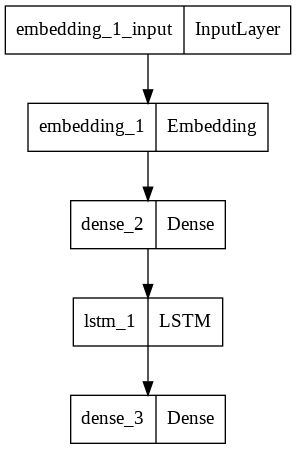

In [ ]:
tf.keras.utils.plot_model(model)

In [ ]:
model.compile(loss = 'categorical_crossentropy', optimizer = 'adam', metrics = ['accuracy'])
#model.fit(x_train,y_train,batch_size = batch_size,epochs = 5, verbose = 1, validation_data = (x_test, y_test))

In [ ]:
earlystopping = EarlyStopping(monitor ="val_loss",mode ="min", patience = 5, restore_best_weights = True)
  
history = model.fit(x_train, y_train, batch_size = 32,
                    epochs = 5, verbose = 1,validation_data = (x_test, y_test), 
                    callbacks =[earlystopping])

Epoch 1/5
1377/1377 [==============================] - 380s 269ms/step - loss: 1.6238 - accuracy: 0.3346 - val_loss: 1.8054 - val_accuracy: 0.2548
Epoch 2/5
1377/1377 [==============================] - 326s 236ms/step - loss: 1.4800 - accuracy: 0.4028 - val_loss: 1.8603 - val_accuracy: 0.2284
Epoch 3/5
1377/1377 [==============================] - 322s 234ms/step - loss: 1.4056 - accuracy: 0.4266 - val_loss: 1.9579 - val_accuracy: 0.2244
Epoch 4/5
1377/1377 [==============================] - 321s 233ms/step - loss: 1.3542 - accuracy: 0.4418 - val_loss: 1.9942 - val_accuracy: 0.2112
Epoch 5/5
1377/1377 [==============================] - 324s 236ms/step - loss: 1.3111 - accuracy: 0.4513 - val_loss: 2.0808 - val_accuracy: 0.2234


In [ ]:
x_test.shape

In [ ]:
history.history.keys()

In [ ]:
plt.plot(history.history['accuracy'],label = 'accuracy' )
plt.plot(history.history['val_accuracy'], label = 'val_accuracy')
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend()
plt.show()


In [ ]:
plt.plot(history.history['loss'])

The model overfits

In [ ]:
train_score, train_acc = model.evaluate(x_train, y_train, batch_size = 32)
test_score, test_acc = model.evaluate(x_test, y_test, batch_size = 32)
print('Train score', train_score)
print('Test score', test_score)
print('Train accuracy', train_acc)
print('Train accuarcy', test_acc)


# With Uniform Classes

## T 

In [ ]:
import pandas as pd 
import matplotlib.pyplot as plt
import numpy as np

from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import confusion_matrix 
from sklearn.model_selection import train_test_split

from keras.models import Sequential
from keras.preprocessing.text import Tokenizer 
from tensorflow.keras.preprocessing.sequence import pad_sequences 
from keras.layers import Dense, Embedding, LSTM,Dropout
import tensorflow as tf
import keras

from nltk.corpus import stopwords  
from nltk.stem import WordNetLemmatizer
from collections import Counter 
import wordcloud
from nltk.corpus import stopwords 
from textblob import Word 
import re
from string import punctuation
import nltk

In [ ]:
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [ ]:
df = pd.read_csv('t.csv')

### Cleaning the Data

In [ ]:
df = df.iloc[:,5:]
df1 = df.drop(columns = ['action','motivation'])
#df1.head()

In [ ]:
def clean(string):
    res = string.strip('][').split(', ')
    lis = []
    for word in res:
        q = word.strip('][').split(', ')
        w = q[0].lstrip('\"')[:-1]
        if w == '' or w == 'na':
            lis.append('none')
        else:
            lis.append(w)
    string = lis
    for classes in lis:
        if classes not in uniqueClasses:
            uniqueClasses.append(classes)
    return string

In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['maslow'][i] = clean(df1['maslow'][i]);
uniqueClassesMaslow = uniqueClasses

In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['reiss'][i] = clean(df1['reiss'][i]);
uniqueClassesReiss = uniqueClasses

In [ ]:
df2 = df1
df3 = df2.explode('maslow')

In [ ]:
df3.head()

,sentence,maslow,reiss
0,I began making fish curry for my boyfriend and I.,physiological,[food]
1,I began making fish curry for my boyfriend and I.,love,"[family, romance, food]"
1,I began making fish curry for my boyfriend and I.,physiological,"[family, romance, food]"
2,I began making fish curry for my boyfriend and I.,physiological,[food]
3,I began making fish curry for my boyfriend and I.,none,[none]


### Cleaning the Data for NLP tasks

In [ ]:
df3.shape

(55066, 3)

In [ ]:
df3[['sentence','maslow']].groupby('maslow').count()

,sentence
maslow,
esteem,8134
love,9483
none,16547
physiological,4487
spiritual growth,6927
stability,9488


In [ ]:
df3.head(1)

,sentence,maslow,reiss
0,I began making fish curry for my boyfriend and I.,physiological,[food]


In [ ]:
undersampling_count = df3[['sentence','maslow']].groupby('maslow').count().min()[0]
print(undersampling_count)   # Therefore we dont sample Phsycological as it has the minimum number of sample i.e dataframe[0]

4487


In [ ]:
dontSeeIndex = 0

In [ ]:
from sklearn.utils import shuffle
lis = list(df3['maslow'].unique())
print(type(lis))
print(lis)
dataframes = []
for i in range(len(lis)):
    dataframe = 't' + str(i)
    dataframe = df3[df3['maslow'] == lis[i]]
    dataframe = dataframe.reset_index()
    dataframe = dataframe.drop(columns = 'index')
    if i!=dontSeeIndex:
        dataframe = shuffle(dataframe)
        dataframe = dataframe.iloc[:4487][:]
    dataframes.append(dataframe)
dataframes[0].head(1)
dataframes[5].head(1)

<class 'list'>
['physiological', 'love', 'none', 'spiritual growth', 'esteem', 'stability']


,sentence,maslow,reiss
2767,The bartender poured him a glass of red.,stability,"[savings, food]"


In [ ]:
df3 = pd.concat(dataframes)
df3 = shuffle(df3)
df3 = df3.reset_index()
df3 = df3.drop(columns = 'index')
df3[['sentence','maslow']].groupby('maslow').count()

,sentence
maslow,
esteem,4487
love,4487
none,4487
physiological,4487
spiritual growth,4487
stability,4487


In [ ]:
lb = LabelEncoder() 
df3['maslowLabel'] = lb.fit_transform(df3['maslow'])

In [ ]:
df3

,sentence,maslow,reiss,maslowLabel
0,She accidentally over-boiled it.,spiritual growth,[indep],4
1,Sara then takes a cup to work.,physiological,[food],3
2,Lexi was playing at the park.,none,[none],2
3,The person he hit died a few days later.,esteem,"[power, status, approval]",0
4,Jasper notices his hands are very cold when he...,stability,[health],5
...,...,...,...,...
26917,Jason burnt one of his fingers on a match and ...,stability,[tranquility],5
26918,Henry's wife calls him.,love,[romance],1
26919,He really liked the flip phone.,none,[none],2
26920,They learned a lot about their history.,love,[family],1


In [ ]:
print(df3['maslow'].unique())
print(df3['maslowLabel'].unique())

['spiritual growth' 'physiological' 'none' 'esteem' 'stability' 'love']
[4 3 2 0 5 1]


https://machinelearningmastery.com/multi-class-imbalanced-classification/

In [ ]:
from collections import Counter
x = df3['sentence']
y = df3['maslowLabel'] 
counter = Counter(y)
for k,v in counter.items():
	per = v / len(y) * 100
	print('Class=%d, n=%d (%.3f%%)' % (k, v, per))

Class=4, n=4487 (16.667%)
Class=3, n=4487 (16.667%)
Class=2, n=4487 (16.667%)
Class=0, n=4487 (16.667%)
Class=5, n=4487 (16.667%)
Class=1, n=4487 (16.667%)


In [ ]:
punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

In [ ]:
def tokenization(string):
    words=nltk.word_tokenize(string)
    return ' '.join(words)

def removestopwords(string):
    for i in punctuation:
        string=string.replace(i,'')
    words=nltk.word_tokenize(string)
    k=[]
    eng_stop=stopwords.words('english')
    for each in words:
        if each not in eng_stop:
            k.append(each.lower())
    return ' '.join(k)

def lemmat(string):
    words=nltk.word_tokenize(string)
    ws=WordNetLemmatizer()
    l=[]
    for each in words:
        l.append(ws.lemmatize(each))
    return ' '.join(l)

def Refine(string):
    return lemmat(removestopwords(tokenization(string)))

In [ ]:
df4 = df3.copy()
df4['sentence']=df4['sentence'].apply(lambda x: Refine(x))
df4

,sentence,maslow,reiss,maslowLabel
0,she accidentally overboiled,spiritual growth,[indep],4
1,sara take cup work,physiological,[food],3
2,lexi playing park,none,[none],2
3,the person hit died day later,esteem,"[power, status, approval]",0
4,jasper notice hand cold drive work,stability,[health],5
...,...,...,...,...
26917,jason burnt one finger match accidentally dropped,stability,[tranquility],5
26918,henry wife call,love,[romance],1
26919,he really liked flip phone,none,[none],2
26920,they learned lot history,love,[family],1


In [ ]:
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

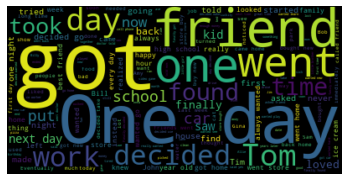

In [ ]:
common_words = ''
for i in df.sentence:
    i = str(i)
    tokens = i.split()
    common_words += " ".join(tokens) + " "
wordcloud = WordCloud().generate(common_words)   
plt.imshow(wordcloud, interpolation = 'bilinear')  # bilinear is used to display smooth images
plt.axis('off')
plt.show()

In [ ]:
k = pd.Series(np.concatenate([x.split() for x in df4.sentence])).value_counts()
a = df4['sentence'].str.lower().str.cat(sep=' ')
words = nltk.tokenize.word_tokenize(a)
word_dist = nltk.FreqDist(words)
print (word_dist)
print(len(word_dist))
rslt = pd.DataFrame(word_dist.most_common(30),
                    columns=['Word', 'Frequency'])
#print(rslt)

<FreqDist with 6774 samples and 144815 outcomes>
6774


In [ ]:
print(df4.sentence.map(lambda x: len(x)).max())

62


In [ ]:
lengths = df4["sentence"].str.len()
argmax = np.where(lengths == lengths.max())[0]
df4.iloc[argmax].head(1)

,sentence,maslow,reiss,maslowLabel
1333,one day i decided i wanted become professional...,spiritual growth,[curiosity],4


### Model LSTM

In [ ]:
from keras.layers import Dense, Flatten, LSTM, Conv1D, MaxPooling1D, Dropout, Activation

In [ ]:
model = Sequential()
model.add(Embedding(26922, 50, input_length=62))
model.add(Dropout(0.2))
model.add(LSTM(200, activation = 'tanh'))
model.add(Dropout(0.2))
model.add(Dense(units = 200, activation = 'relu'))
model.add(Dense(6, activation='softmax'))

In [ ]:
model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_3 (Embedding)     (None, 62, 50)            1346100   
                                                                 
 dropout_2 (Dropout)         (None, 62, 50)            0         
                                                                 
 lstm_3 (LSTM)               (None, 200)               200800    
                                                                 
 dropout_3 (Dropout)         (None, 200)               0         
                                                                 
 dense_6 (Dense)             (None, 200)               40200     
                                                                 
 dense_7 (Dense)             (None, 6)                 1206      
                                                                 
Total params: 1,588,306
Trainable params: 1,588,306
No

In [ ]:
METRICS = [
      keras.metrics.TruePositives(name='tp'),
      keras.metrics.FalsePositives(name='fp'),
      keras.metrics.TrueNegatives(name='tn'),
      keras.metrics.FalseNegatives(name='fn'), 
      keras.metrics.CategoricalCrossentropy(name='categorical_cross_entropy'),
      keras.metrics.Precision(name='precision'),
      keras.metrics.Recall(name='recall'),
      keras.metrics.AUC(name='auc'),
      keras.metrics.AUC(name='prc', curve='PR'), # precision-recall curve
      keras.metrics.Accuracy(name = 'accuracy')
]

In [ ]:
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics= METRICS)

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(df4['sentence'],df4['maslowLabel'],test_size = 0.2, random_state = 0, stratify = df4['maslowLabel'])

In [ ]:
x_train_text = x_train 
x_test_text = x_test
y_train_text = y_train
y_test_text = y_test

In [ ]:
print(x_train.shape)
print(x_test.shape)

(21537,)
(5385,)


In [ ]:
tokenizer = Tokenizer(num_words = 26922, split = ' ')
tokenizer.fit_on_texts(x_train.values)
x = tokenizer.texts_to_sequences(x_train.values) # Numerical vectors got created
x = pad_sequences(x, maxlen=62)
x_train = x

tokenizer = Tokenizer(num_words = 7254, split = ' ')
tokenizer.fit_on_texts(x_test.values)
x = tokenizer.texts_to_sequences(x_test.values) # Numerical vectors got created
x = pad_sequences(x, maxlen=62)
x_test = x

In [ ]:
print(x_train.shape)
print(x_test.shape)

(21537, 62)
(5385, 62)


In [ ]:
from tensorflow.keras.utils import to_categorical
y_train = to_categorical(y_train)
y_test =  to_categorical(y_test)

In [ ]:
history = model.fit(x_train, y_train,epochs=10,verbose=1,validation_split=0.1)

Epoch 1/10
606/606 [==============================] - 133s 219ms/step - loss: 1.6273 - tp: 1041.0000 - fp: 682.0000 - tn: 96233.0000 - fn: 18342.0000 - categorical_cross_entropy: 1.6273 - precision: 0.6042 - recall: 0.0537 - auc: 0.6885 - prc: 0.3290 - accuracy: 0.0000e+00 - val_loss: 1.6719 - val_tp: 129.0000 - val_fp: 126.0000 - val_tn: 10644.0000 - val_fn: 2025.0000 - val_categorical_cross_entropy: 1.6719 - val_precision: 0.5059 - val_recall: 0.0599 - val_auc: 0.6658 - val_prc: 0.3027 - val_accuracy: 0.0000e+00
Epoch 2/10
606/606 [==============================] - 113s 187ms/step - loss: 1.4699 - tp: 2966.0000 - fp: 1947.0000 - tn: 94968.0000 - fn: 16417.0000 - categorical_cross_entropy: 1.4699 - precision: 0.6037 - recall: 0.1530 - auc: 0.7655 - prc: 0.4256 - accuracy: 0.0000e+00 - val_loss: 1.7182 - val_tp: 197.0000 - val_fp: 239.0000 - val_tn: 10531.0000 - val_fn: 1957.0000 - val_categorical_cross_entropy: 1.7182 - val_precision: 0.4518 - val_recall: 0.0915 - val_auc: 0.6614 - va

In [ ]:
model.evaluate(x_test, y_test)

169/169 [==============================] - 8s 49ms/step - loss: 3.1755 - tp: 310.0000 - fp: 1448.0000 - tn: 25477.0000 - fn: 5075.0000 - categorical_cross_entropy: 3.1755 - precision: 0.1763 - recall: 0.0576 - auc: 0.5088 - prc: 0.1706 - accuracy: 0.0000e+00


[3.1754701137542725,
 310.0,
 1448.0,
 25477.0,
 5075.0,
 3.1754701137542725,
 0.17633675038814545,
 0.05756731703877449,
 0.5087841153144836,
 0.17064206302165985,
 0.0]

### Evaluation and Analysis

In [ ]:
y_pred = model.predict(x_test)

In [ ]:
y_pred[2]

array([4.2563403e-01, 2.9093364e-05, 2.7402371e-01, 1.7323330e-03,
       8.5822061e-02, 2.1275878e-01], dtype=float32)

In [ ]:
review_predictions = []
for prediction in y_pred:
    x = prediction
    review_predictions.append(np.argmax(x))

review_predictions = np.array(review_predictions)
review_predictions.reshape(1,-1)
review_predictions.shape

(5385,)

In [ ]:
review_predictions

array([5, 2, 0, ..., 0, 3, 0])

In [ ]:
k = pd.DataFrame(review_predictions, columns = ['Label'])
k.groupby('Label')['Label'].count()

Label
0     956
1    1178
2     799
3     819
4     695
5     938
Name: Label, dtype: int64

In [ ]:
type(y_test_text)

pandas.core.series.Series

In [ ]:
import sklearn
r1 = sklearn.metrics.confusion_matrix(review_predictions, y_test_text)
print(r1)

[[172 153 159 155 152 165]
 [190 202 186 216 197 187]
 [147 123 152 125 146 106]
 [121 149 112 149 127 161]
 [103 122 125 102 115 128]
 [165 148 163 151 161 150]]


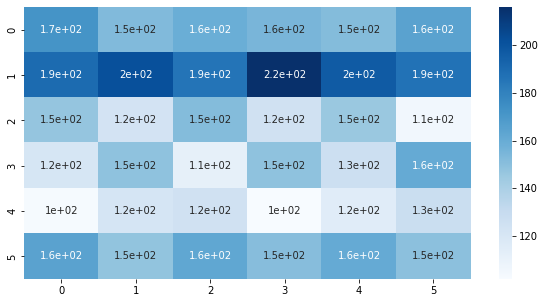

In [ ]:
import seaborn as sns
f = plt.figure()
f.set_figwidth(10)
f.set_figheight(5)
sns.heatmap(r1, annot=True, cmap = 'Blues')

In [ ]:
lb.classes_

array(['esteem', 'love', 'none', 'physiological', 'spiritual growth',
       'stability'], dtype=object)

In [ ]:
#y_test_text

In [ ]:
text_label = pd.Series(lb.inverse_transform(y_test_text))
integer_label = pd.Series(y_test_text)

In [ ]:
integer_label = integer_label.reset_index(drop = True)
#integer_label[0:20]

In [ ]:
#text_label[0:20]

In [ ]:
def make_confusion_matrix(cf,group_names=None,categories='auto',count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    '''
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html
                   
    title:         Title for the heatmap. Default is None.
    '''


    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)
    
    if title:
        plt.title(title)

In [ ]:
uniqueClassesMaslow = list(df4['maslow'].unique())
uniqueClassesMaslowLabel = list(df4['maslowLabel'].unique())

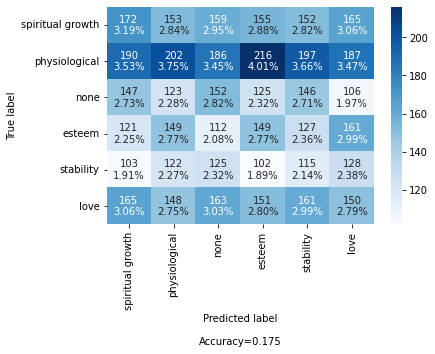

In [ ]:
make_confusion_matrix(r1, group_names=uniqueClassesMaslowLabel, categories=uniqueClassesMaslow, cmap='Blues')

In [ ]:
x_test_text = x_test_text.reset_index(drop = True)
#x_test_text[0:5]

In [ ]:
count = 0
for i in range(0,len(review_predictions)):
    if review_predictions[i] != 0 and integer_label[i] == 0 and count != 10:
        print(x_test_text[i])
        count = count + 1

last friday got ticket red sox game yankee stadium
he gave ticket
mila working sewing project
he amazed good kisser i become
the instructor introduced talking
sheila afraid dentist
john invited friend taste
people sympathetic first george would nt stop
jerome decided buy brother video game system
she began meet people make friend


In [ ]:
from sklearn.metrics import precision_recall_fscore_support as score

precision, recall, fscore, support = score(integer_label, review_predictions)

print('Labels::{}'.format(uniqueClassesMaslow))
print('precision: {}'.format(precision))
print('recall: {}'.format(recall))
print('fscore: {}'.format(fscore))
print('support: {}'.format(support))

Labels::['spiritual growth', 'physiological', 'none', 'esteem', 'stability', 'love']
precision: [0.17991632 0.17147708 0.1902378  0.18192918 0.16546763 0.15991471]
recall: [0.19153675 0.22519509 0.16945373 0.16592428 0.12806236 0.16722408]
fscore: [0.18554477 0.1946988  0.17924528 0.17355853 0.14438167 0.16348774]
support: [898 897 897 898 898 897]


In [ ]:
#The Kappa score tell you how much better, or worse, your classifier is than what would be expected by random chance. 
#If you were to randomly assign cases to classes (i.e. a kind of terribly uninformed classifier), you'd get some correct simply by chance. 
#Therefore, you will always find that the Kappa value is lower than the overall accuracy. 
#The Kappa index is however considered to be a more conservative measure than the overall classification accuracy. 
#Your KIA value is telling you essentially that your classifier is about 66% better than a random assignment of cases to the various classes. That's not bad!
#A kappa value of 1 represents perfect agreement, while a value of 0 represents no agreement.
from sklearn.metrics import cohen_kappa_score
cohen_score = cohen_kappa_score(integer_label, review_predictions)
print(cohen_score)

0.009479872263702505


## T 2

In [ ]:
import pandas as pd 
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns 

from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import confusion_matrix 
from sklearn.model_selection import train_test_split
import sklearn

from keras.models import Sequential
from keras.preprocessing.text import Tokenizer 
from tensorflow.keras.preprocessing.sequence import pad_sequences 
from keras.layers import Dense, Embedding, LSTM,Dropout, Conv1D, MaxPooling1D, Dropout, Activation
import tensorflow as tf

from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from nltk.corpus import stopwords  
from nltk.stem import WordNetLemmatizer
from nltk.stem import PorterStemmer
from collections import Counter 
import wordcloud
from nltk.corpus import stopwords 
from textblob import Word 
import re
from string import punctuation
import nltk

In [ ]:
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [ ]:
df = pd.read_csv('t.csv')

### Cleaning the Data

In [ ]:
df1 = df.drop(columns = ['action','motivation'])

In [ ]:
def clean(string):
    res = string.strip('][').split(', ')
    lis = []
    for word in res:
        q = word.strip('][').split(', ')
        w = q[0].lstrip('\"')[:-1]
        if w == '' or w == 'na':
            lis.append('none')
        else:
            lis.append(w)
    string = lis
    for classes in lis:
        if classes not in uniqueClasses:
            uniqueClasses.append(classes)
    return string

In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['maslow'][i] = clean(df1['maslow'][i]);
uniqueClassesMaslow = uniqueClasses

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['reiss'][i] = clean(df1['reiss'][i]);
uniqueClassesReiss = uniqueClasses

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
df2 = df1
df3 = df2.explode('maslow')

In [ ]:
df3.head()

,storyid,linenum,char,motiveworkerid,context,sentence,maslow,reiss
0,a2ddbb50-e45b-4ad3-becf-b2d8475172bf,1,I (myself),ann0,NaN,I began making fish curry for my boyfriend and I.,physiological,[food]
1,a2ddbb50-e45b-4ad3-becf-b2d8475172bf,1,I (myself),ann1,NaN,I began making fish curry for my boyfriend and I.,love,"[family, romance, food]"
1,a2ddbb50-e45b-4ad3-becf-b2d8475172bf,1,I (myself),ann1,NaN,I began making fish curry for my boyfriend and I.,physiological,"[family, romance, food]"
2,a2ddbb50-e45b-4ad3-becf-b2d8475172bf,1,I (myself),ann2,NaN,I began making fish curry for my boyfriend and I.,physiological,[food]
3,a2ddbb50-e45b-4ad3-becf-b2d8475172bf,1,Boyfriend,none,NaN,I began making fish curry for my boyfriend and I.,none,[none]


,sentence
maslow,
esteem,8134
love,9483
none,16547
physiological,4487
spiritual growth,6927
stability,9488


### Cleaning the Data for NLP tasks

In [ ]:
df3.shape

(55066, 8)

(array([0, 1, 2, 3, 4, 5]), <a list of 6 Text major ticklabel objects>)

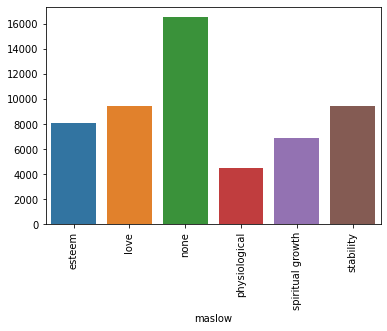

In [ ]:
c = df3.groupby('maslow')['maslow'].count()
sns.barplot(x = c.index, y = c.values)
plt.xticks(rotation = 90)

In [ ]:
df3[['sentence','maslow']].groupby('maslow').count()

,sentence
maslow,
esteem,8134
love,9483
none,16547
physiological,4487
spiritual growth,6927
stability,9488


In [ ]:
# UNDERSAMPLING
undersampling_count = df3[['sentence','maslow']].groupby('maslow').count().min()[0]
dontSeeIndex = 0

from sklearn.utils import shuffle
lis = list(df3['maslow'].unique())
print(type(lis))
print(lis)
dataframes = []
for i in range(len(lis)):
    dataframe = 't' + str(i)
    dataframe = df3[df3['maslow'] == lis[i]]
    dataframe = dataframe.reset_index()
    dataframe = dataframe.drop(columns = 'index')
    if i!=dontSeeIndex:
        dataframe = shuffle(dataframe)
        dataframe = dataframe.iloc[:4487][:]
    dataframes.append(dataframe)
dataframes[0].head(1)
dataframes[5].head(1)

<class 'list'>
['physiological', 'love', 'none', 'spiritual growth', 'esteem', 'stability']


,storyid,linenum,char,motiveworkerid,context,sentence,maslow,reiss
6740,66d24bf8-2666-4a13-90cd-15b93c3e60d3,1,Kay,ann0,NaN,Kay was at work when a headache started.,stability,[health]


In [ ]:
df3 = pd.concat(dataframes)
df3 = shuffle(df3)
df3 = df3.reset_index()
df3 = df3.drop(columns = 'index')
df3[['sentence','maslow']].groupby('maslow').count()

,sentence
maslow,
esteem,4487
love,4487
none,4487
physiological,4487
spiritual growth,4487
stability,4487


In [ ]:
k1 = df3[df3['maslow'] == 'none'] 
k2 = df3[df3['maslow'] == 'physiological']
df3 = pd.concat([k1,k2],axis = 0)
df3 = shuffle(df3)
df3 = df3.reset_index()
df3 = df3.drop(columns = 'index')

In [ ]:
df3.tail()

,storyid,linenum,char,motiveworkerid,context,sentence,maslow,reiss,maslowLabel
8969,efd5baba-71a7-46a7-974f-33043029f548,2,Charity,none,Rita decided she wanted to raise money for her...,She first tried to get people to donate money.,none,[none],0
8970,e9adcf0a-dccd-4f77-b476-f5d76bf7c453,5,Detective,ann1,In the first police interrogation Ike was very...,Ike decided to stop talking and wait until he ...,none,[none],0
8971,9db1c645-4a9f-4e45-817e-6d08434982b6,3,Cliff,ann0,Cliff still lived with his parents.|He had bee...,Cliff would stay out until three in the morning.,physiological,[none],1
8972,36f0e5cf-0066-40c2-bdfd-540691f0d018,1,The murderer,none,NaN,A detective received a call about an unsolved ...,none,[none],0
8973,74fb272f-034c-4846-89ce-0e2f6884c32e,5,I (myself),ann1,My wife and I went out to dinner on Valentine'...,"We still gave a good tip, as the waitress was ...",physiological,"[contact, food]",1


In [ ]:
lb = LabelEncoder() 
df3['maslowLabel'] = lb.fit_transform(df3['maslow'])

In [ ]:
print(df3['maslow'].unique())
print(df3['maslowLabel'].unique())

['none' 'physiological']
[0 1]


In [ ]:
uniqueClassesMaslow = list(df3['maslow'].unique())
uniqueClassesMaslowLabel = list(df3['maslowLabel'].unique())
print(uniqueClassesMaslowLabel)
print(uniqueClassesMaslow)

[0, 1]
['none', 'physiological']


In [ ]:
df4 = df3.copy()

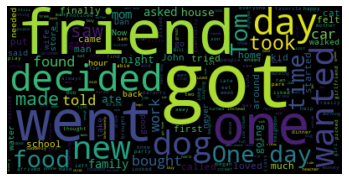

In [ ]:
common_words = ''
for i in df4.sentence:
    i = str(i)
    tokens = i.split()
    common_words += " ".join(tokens) + " "
wordcloud = WordCloud().generate(common_words)   
plt.imshow(wordcloud, interpolation = 'bilinear')  # bilinear is used to display smooth images
plt.axis('off')
plt.show()

In [ ]:
k = pd.Series(np.concatenate([x.split() for x in df4.sentence])).value_counts()
a = df4['sentence'].str.lower().str.cat(sep=' ')
words = nltk.tokenize.word_tokenize(a)
word_dist = nltk.FreqDist(words)
print (word_dist)
print(len(word_dist))
rslt = pd.DataFrame(word_dist.most_common(30),
                    columns=['Word', 'Frequency'])
print(rslt)

<FreqDist with 5749 samples and 90221 outcomes>
5749
    Word  Frequency
0      .       8657
1    the       4078
2     to       3131
3      a       2660
4    was       2126
5     he       1951
6    and       1721
7    she       1720
8    her       1323
9      ,       1315
10   his       1109
11    it       1064
12     i        961
13    in        927
14    of        856
15   for        792
16   had        745
17    on        709
18  they        635
19    at        508
20    up        487
21   out        464
22    's        447
23    my        446
24  that        420
25  when        408
26  went        403
27  with        399
28   got        397
29   day        392


In [ ]:
print(df4.sentence.map(lambda x: len(x)).max())

72


In [ ]:
lengths = df4["sentence"].str.len()
argmax = np.where(lengths == lengths.max())[0]
df4.iloc[argmax].head(1)

,storyid,linenum,char,motiveworkerid,context,sentence,maslow,reiss,maslowLabel
796,d1c1e785-5fd0-4d0a-ad88-79a2e5eaafc1,5,Monitor,none,I walked into detention with an attitude.|The ...,"Just then, Bethany walked in and told him it w...",none,[none],0


### Model BERT

https://www.section.io/engineering-education/classification-model-using-bert-and-tensorflow/

In [ ]:
!pip install -q -U "tensorflow-text==2.8.*"
!pip install -q tf-models-official==2.7.0

     |████████████████████████████████| 4.9 MB 17.5 MB/s 
     |████████████████████████████████| 1.8 MB 18.2 MB/s 
     |████████████████████████████████| 238 kB 48.0 MB/s 
     |████████████████████████████████| 48.3 MB 138 kB/s 
     |████████████████████████████████| 1.1 MB 45.1 MB/s 
     |████████████████████████████████| 92 kB 8.1 MB/s 
     |████████████████████████████████| 43 kB 2.4 MB/s 
     |████████████████████████████████| 596 kB 55.0 MB/s 
     |████████████████████████████████| 1.2 MB 32.8 MB/s 
     |████████████████████████████████| 99 kB 5.2 MB/s 
     |████████████████████████████████| 352 kB 70.2 MB/s 


In [ ]:
import os
import shutil
import tensorflow as tf
import tensorflow_hub as hub
import tensorflow_text as text
from official.nlp import optimization  # to create AdamW optimizer
import matplotlib.pyplot as plt
tf.get_logger().setLevel('ERROR')

In [ ]:
bert_preprocess = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_preprocess/3")
bert_encoder = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4")

In [ ]:
text_input = tf.keras.layers.Input(shape=(), dtype=tf.string, name='text')
preprocessed_text = bert_preprocess(text_input)
outputs = bert_encoder(preprocessed_text)
l = tf.keras.layers.Dropout(0.1, name="dropout")(outputs['pooled_output'])
l = tf.keras.layers.Dense(2, activation='softmax', name="output")(l)

In [ ]:
model = tf.keras.Model(inputs=[text_input], outputs = [l])

In [ ]:
import keras
METRICS = [
      keras.metrics.TruePositives(name='tp'),
      keras.metrics.FalsePositives(name='fp'),
      keras.metrics.TrueNegatives(name='tn'),
      keras.metrics.FalseNegatives(name='fn'), 
      keras.metrics.CategoricalCrossentropy(name='categorical_cross_entropy'),
      keras.metrics.Precision(name='precision'),
      keras.metrics.Recall(name='recall'),
      keras.metrics.AUC(name='auc'),
      keras.metrics.AUC(name='prc', curve='PR'), # precision-recall curve
      keras.metrics.Accuracy(name = 'accuracy')
]

In [ ]:
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=METRICS)

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(df4['sentence'],df4['maslowLabel'],test_size = 0.2, random_state = 0, stratify = df4['maslowLabel'])

In [ ]:
x_train_text = x_train 
x_test_text = x_test
y_train_text = y_train
y_test_text = y_test

In [ ]:
print(x_train.shape)
print(x_test.shape)

(7179,)
(1795,)


In [ ]:
print(x_train.shape)
print(x_test.shape)

(7179,)
(1795,)


In [ ]:
from tensorflow.keras.utils import to_categorical
y_train = to_categorical(y_train)
y_test =  to_categorical(y_test)

In [ ]:
model.fit(x_train, y_train,epochs=10,verbose=1,validation_split= 0.1)   

Epoch 1/10
  2/202 [..............................] - ETA: 58:58 - loss: 0.6840 - tp: 37.0000 - fp: 27.0000 - tn: 37.0000 - fn: 27.0000 - categorical_cross_entropy: 0.6840 - precision: 0.5781 - recall: 0.5781 - auc: 0.6211 - prc: 0.5980 - accuracy: 0.0000e+00  

KeyboardInterrupt: ignored

In [ ]:
model.evaluate(x_test, y_test)

### Evaluation and Analysis

In [ ]:
y_pred = model.predict(x_test)

In [ ]:
y_pred[2]

array([0.10600586, 0.17121187, 0.15059093, 0.1605388 , 0.17641205,
       0.23524052], dtype=float32)

In [ ]:
review_predictions = []
for prediction in y_pred:
    x = prediction
    review_predictions.append(np.argmax(x))

review_predictions = np.array(review_predictions)
review_predictions.reshape(1,-1)
review_predictions.shape

(5385,)

In [ ]:
review_predictions

array([1, 5, 5, ..., 1, 0, 3])

In [ ]:
k = pd.DataFrame(review_predictions, columns = ['Label'])
k.groupby('Label')['Label'].count()

Label
0     187
1    1878
2     274
3    1189
4     424
5    1433
Name: Label, dtype: int64

In [ ]:
type(y_test_text)

pandas.core.series.Series

In [ ]:
r1 = sklearn.metrics.confusion_matrix(review_predictions, y_test_text)
print(r1)

[[ 77  20  35   9  27  19]
 [315 530 301 190 318 224]
 [ 45  27  89  32  33  48]
 [ 98 131 155 435 182 188]
 [ 98  35  73  40 127  51]
 [265 154 244 192 211 367]]


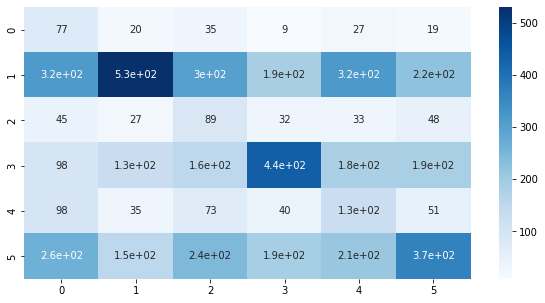

In [ ]:
f = plt.figure()
f.set_figwidth(10)
f.set_figheight(5)
sns.heatmap(r1, annot=True, cmap = 'Blues')

In [ ]:
lb.classes_

array(['esteem', 'love', 'none', 'physiological', 'spiritual growth',
       'stability'], dtype=object)

In [ ]:
y_test_text

9490     1
23768    5
6019     2
12073    2
1926     3
        ..
20959    2
9324     1
25035    1
14299    0
26542    2
Name: maslowLabel, Length: 5385, dtype: int64

In [ ]:
text_label = pd.Series(lb.inverse_transform(y_test_text))
integer_label = pd.Series(y_test_text)

In [ ]:
integer_label = integer_label.reset_index(drop = True)
integer_label[0:20]

0     1
1     5
2     2
3     2
4     3
5     5
6     1
7     1
8     5
9     4
10    0
11    3
12    0
13    3
14    2
15    4
16    2
17    5
18    5
19    0
Name: maslowLabel, dtype: int64

In [ ]:
text_label[0:20]

0                 love
1            stability
2                 none
3                 none
4        physiological
5            stability
6                 love
7                 love
8            stability
9     spiritual growth
10              esteem
11       physiological
12              esteem
13       physiological
14                none
15    spiritual growth
16                none
17           stability
18           stability
19              esteem
dtype: object

In [ ]:
def make_confusion_matrix(cf,group_names=None,categories='auto',count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    '''
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html
                   
    title:         Title for the heatmap. Default is None.
    '''


    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)
    
    if title:
        plt.title(title)

In [ ]:
print(uniqueClassesMaslowLabel)
print(uniqueClassesMaslow)

[4, 1, 5, 0, 3, 2]
['spiritual growth', 'love', 'stability', 'esteem', 'physiological', 'none']


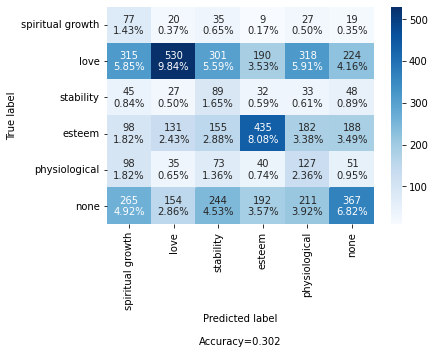

In [ ]:
make_confusion_matrix(r1, group_names=uniqueClassesMaslowLabel, categories=uniqueClassesMaslow, cmap='Blues')

In [ ]:
x_test_text = x_test_text.reset_index(drop = True)
x_test_text[0:5]

0                 they married share physical intimacy
1                       soon robber ran joe got shaken
2                                       i decided give
3             she covered returned cubicle fix problem
4    she kept looking around hoping one would see h...
Name: sentence, dtype: object

In [ ]:
print(uniqueClassesMaslowLabel)
print(uniqueClassesMaslow)

[4, 1, 5, 0, 3, 2]
['spiritual growth', 'love', 'stability', 'esteem', 'physiological', 'none']


In [ ]:
y_test

array([[0., 1., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 1.],
       [0., 0., 1., 0., 0., 0.],
       ...,
       [0., 1., 0., 0., 0., 0.],
       [1., 0., 0., 0., 0., 0.],
       [0., 0., 1., 0., 0., 0.]], dtype=float32)

In [ ]:
count = 0
for i in range(0,len(review_predictions)):
    if review_predictions[i] != 0 and integer_label[i] == 0 and count != 10:
        print(x_test_text[i])
        count = count + 1

after teammate created screen made threepointer
she became desperate score final season soccer
today horrible manager got back vacation
farad entered friend information tinder without knowing
now lenny sell software living
the principal said would permitted older
they decorated repainted room light green
ben would terrorize kid school
andrea shocked delighted tell husband news
lisa clean clothes decided laundry


## T 4  To Be changed to uniform distirbution

In [ ]:
import pandas as pd 
import matplotlib.pyplot as plt
import numpy as np

from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import confusion_matrix 
from sklearn.model_selection import train_test_split

from keras.models import Sequential
from keras.preprocessing.text import Tokenizer 
from tensorflow.keras.preprocessing.sequence import pad_sequences 
from keras.layers import Dense, Embedding, LSTM,Dropout
import tensorflow as tf
import keras

from nltk.corpus import stopwords  
from nltk.stem import WordNetLemmatizer
from collections import Counter 
import wordcloud
from nltk.corpus import stopwords 
from textblob import Word 
import re
from string import punctuation
import nltk

In [ ]:
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [ ]:
df = pd.read_csv('t.csv')

### Cleaning the Data

In [ ]:
df = df.iloc[:,5:]
df1 = df.drop(columns = ['action','motivation'])
#df1.head()

In [ ]:
def clean(string):
    res = string.strip('][').split(', ')
    lis = []
    for word in res:
        q = word.strip('][').split(', ')
        w = q[0].lstrip('\"')[:-1]
        if w == '' or w == 'na':
            lis.append('none')
        else:
            lis.append(w)
    string = lis
    for classes in lis:
        if classes not in uniqueClasses:
            uniqueClasses.append(classes)
    return string

In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['maslow'][i] = clean(df1['maslow'][i]);
uniqueClassesMaslow = uniqueClasses

In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['reiss'][i] = clean(df1['reiss'][i]);
uniqueClassesReiss = uniqueClasses

In [ ]:
df2 = df1
df3 = df2.explode('maslow')

In [ ]:
df3.head()

,sentence,maslow,reiss
0,I began making fish curry for my boyfriend and I.,physiological,[food]
1,I began making fish curry for my boyfriend and I.,love,"[family, romance, food]"
1,I began making fish curry for my boyfriend and I.,physiological,"[family, romance, food]"
2,I began making fish curry for my boyfriend and I.,physiological,[food]
3,I began making fish curry for my boyfriend and I.,none,[none]


### Cleaning the Data for NLP tasks

In [ ]:
df3.shape

(55066, 3)

(array([0, 1, 2, 3, 4, 5]), <a list of 6 Text major ticklabel objects>)

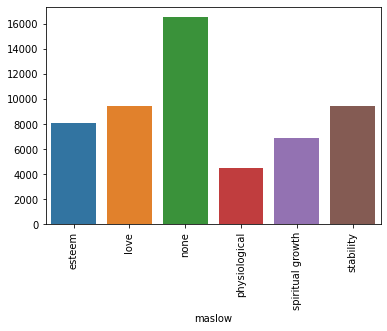

In [ ]:
import seaborn as sns 
c = df3.groupby('maslow')['maslow'].count()
sns.barplot(x = c.index, y = c.values)
plt.xticks(rotation = 90)

In [ ]:
df3[['sentence','maslow']].groupby('maslow').count()

,sentence
maslow,
esteem,8134
love,9483
none,16547
physiological,4487
spiritual growth,6927
stability,9488


In [ ]:
lb = LabelEncoder() 
df3['maslowLabel'] = lb.fit_transform(df3['maslow'])

In [ ]:
df3

,sentence,maslow,reiss,maslowLabel
0,I began making fish curry for my boyfriend and I.,physiological,[food],3
1,I began making fish curry for my boyfriend and I.,love,"[family, romance, food]",1
1,I began making fish curry for my boyfriend and I.,physiological,"[family, romance, food]",3
2,I began making fish curry for my boyfriend and I.,physiological,[food],3
3,I began making fish curry for my boyfriend and I.,none,[none],2
...,...,...,...,...
47542,A crab was inside the shell pinching his leg.,spiritual growth,[curiosity],4
47543,A crab was inside the shell pinching his leg.,spiritual growth,[curiosity],4
47544,A crab was inside the shell pinching his leg.,none,[none],2
47545,A crab was inside the shell pinching his leg.,stability,[tranquility],5


In [ ]:
print(df3['maslow'].unique())
print(df3['maslowLabel'].unique())

['physiological' 'love' 'none' 'spiritual growth' 'esteem' 'stability']
[3 1 2 4 0 5]


https://machinelearningmastery.com/multi-class-imbalanced-classification/

In [ ]:
from collections import Counter
x = df3['sentence']
y = df3['maslowLabel'] 
counter = Counter(y)
for k,v in counter.items():
	per = v / len(y) * 100
	print('Class=%d, n=%d (%.3f%%)' % (k, v, per))

Class=3, n=4487 (8.148%)
Class=1, n=9483 (17.221%)
Class=2, n=16547 (30.049%)
Class=4, n=6927 (12.579%)
Class=0, n=8134 (14.771%)
Class=5, n=9488 (17.230%)


In [ ]:
punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

In [ ]:
def tokenization(string):
    words=nltk.word_tokenize(string)
    return ' '.join(words)

def removestopwords(string):
    for i in punctuation:
        string=string.replace(i,'')
    words=nltk.word_tokenize(string)
    k=[]
    eng_stop=stopwords.words('english')
    for each in words:
        if each not in eng_stop:
            k.append(each.lower())
    return ' '.join(k)

def lemmat(string):
    words=nltk.word_tokenize(string)
    ws=WordNetLemmatizer()
    l=[]
    for each in words:
        l.append(ws.lemmatize(each))
    return ' '.join(l)

def Refine(string):
    return lemmat(removestopwords(tokenization(string)))

In [ ]:
df4 = df3.copy()
df4['sentence']=df4['sentence'].apply(lambda x: Refine(x))
df4

,sentence,maslow,reiss,maslowLabel
0,i began making fish curry boyfriend i,physiological,[food],3
1,i began making fish curry boyfriend i,love,"[family, romance, food]",1
1,i began making fish curry boyfriend i,physiological,"[family, romance, food]",3
2,i began making fish curry boyfriend i,physiological,[food],3
3,i began making fish curry boyfriend i,none,[none],2
...,...,...,...,...
47542,a crab inside shell pinching leg,spiritual growth,[curiosity],4
47543,a crab inside shell pinching leg,spiritual growth,[curiosity],4
47544,a crab inside shell pinching leg,none,[none],2
47545,a crab inside shell pinching leg,stability,[tranquility],5


In [ ]:
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

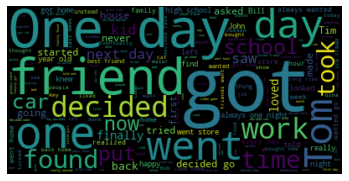

In [ ]:
common_words = ''
for i in df.sentence:
    i = str(i)
    tokens = i.split()
    common_words += " ".join(tokens) + " "
wordcloud = WordCloud().generate(common_words)   
plt.imshow(wordcloud, interpolation = 'bilinear')  # bilinear is used to display smooth images
plt.axis('off')
plt.show()

In [ ]:
k = pd.Series(np.concatenate([x.split() for x in df4.sentence])).value_counts()
a = df4['sentence'].str.lower().str.cat(sep=' ')
words = nltk.tokenize.word_tokenize(a)
word_dist = nltk.FreqDist(words)
print (word_dist)
print(len(word_dist))
rslt = pd.DataFrame(word_dist.most_common(30),
                    columns=['Word', 'Frequency'])
#print(rslt)

<FreqDist with 7254 samples and 295640 outcomes>
7254


In [ ]:
print(df4.sentence.map(lambda x: len(x)).max())

62


In [ ]:
lengths = df4["sentence"].str.len()
argmax = np.where(lengths == lengths.max())[0]
df4.iloc[argmax].head(1)

,sentence,maslow,reiss,maslowLabel
21422,one day i decided i wanted become professional...,spiritual growth,[curiosity],4


### Model FFN with CNN

In [ ]:
from keras.layers import Dense, Flatten, LSTM, Conv1D, MaxPooling1D, Dropout, Activation
from keras.layers import GlobalMaxPooling1D

In [ ]:
#input_array = np.random.randint(1000, size=(32, 10))
#print(input_array.ndim)
#print(input_array.shape)
#print(input_array.size)
#k = input_array.flatten()
#print(len(k))
#print(input_array)

In [ ]:
batch_size = 32
filters = 250
kernel_size = 3
hidden_dims = 250
epochs = 10

In [ ]:
model = Sequential()
model.add(Embedding(7254, 100, input_length=62))
model.add(Conv1D(filters, kernel_size, padding = 'valid', activation = 'relu', strides = 1, input_shape = (44052, 62)))
model.add(GlobalMaxPooling1D())
model.add(Dense(hidden_dims))
model.add(Dropout(0.2))
model.add(Activation('relu'))
model.add(Dense(6))
model.add(Activation('sigmoid'))

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, 62, 100)           725400    
                                                                 
 conv1d (Conv1D)             (None, 60, 250)           75250     
                                                                 
 global_max_pooling1d (Globa  (None, 250)              0         
 lMaxPooling1D)                                                  
                                                                 
 dense (Dense)               (None, 250)               62750     
                                                                 
 dropout (Dropout)           (None, 250)               0         
                                                                 
 activation (Activation)     (None, 250)               0         
                                                        

In [ ]:
'''
METRICS = [
      keras.metrics.TruePositives(name='tp'),
      keras.metrics.FalsePositives(name='fp'),
      keras.metrics.TrueNegatives(name='tn'),
      keras.metrics.FalseNegatives(name='fn'), 
      keras.metrics.CategoricalCrossentropy(name='categorical_cross_entropy'),
      keras.metrics.Precision(name='precision'),
      keras.metrics.Recall(name='recall'),
      keras.metrics.AUC(name='auc'),
      keras.metrics.AUC(name='prc', curve='PR'), # precision-recall curve
]
'''

"\nMETRICS = [\n      keras.metrics.TruePositives(name='tp'),\n      keras.metrics.FalsePositives(name='fp'),\n      keras.metrics.TrueNegatives(name='tn'),\n      keras.metrics.FalseNegatives(name='fn'), \n      keras.metrics.CategoricalCrossentropy(name='categorical_cross_entropy'),\n      keras.metrics.Precision(name='precision'),\n      keras.metrics.Recall(name='recall'),\n      keras.metrics.AUC(name='auc'),\n      keras.metrics.AUC(name='prc', curve='PR'), # precision-recall curve\n]\n"

In [ ]:
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics= 'accuracy')

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(df4['sentence'],df4['maslowLabel'],test_size = 0.2, random_state = 0, stratify = df4['maslowLabel'])

In [ ]:
x_train_text = x_train 
x_test_text = x_test
y_train_text = y_train
y_test_text = y_test

In [ ]:
print(x_train.shape)
print(x_test.shape)

(44052,)
(11014,)


In [ ]:
tokenizer = Tokenizer(num_words = 7254, split = ' ')
tokenizer.fit_on_texts(x_train.values)
x = tokenizer.texts_to_sequences(x_train.values) # Numerical vectors got created
x = pad_sequences(x, maxlen=62)
x_train = x

tokenizer = Tokenizer(num_words = 7254, split = ' ')
tokenizer.fit_on_texts(x_test.values)
x = tokenizer.texts_to_sequences(x_test.values) # Numerical vectors got created
x = pad_sequences(x, maxlen=62)
x_test = x

In [ ]:
print(x_train.ndim)
print(x_train.shape)
print(x_test.shape)

2
(44052, 62)
(11014, 62)


In [ ]:
from tensorflow.keras.utils import to_categorical
y_train = to_categorical(y_train)
y_test =  to_categorical(y_test)

In [ ]:
model.fit(x_train, y_train,verbose=1, validation_data = (x_test, y_test), batch_size = 32, epochs = epochs)

Epoch 1/10
1377/1377 [==============================] - 57s 40ms/step - loss: 1.6314 - accuracy: 0.3348 - val_loss: 1.7998 - val_accuracy: 0.2584
Epoch 2/10
1377/1377 [==============================] - 64s 47ms/step - loss: 1.4744 - accuracy: 0.4066 - val_loss: 1.8779 - val_accuracy: 0.2330
Epoch 3/10
1377/1377 [==============================] - 55s 40ms/step - loss: 1.3705 - accuracy: 0.4376 - val_loss: 1.8776 - val_accuracy: 0.2261
Epoch 4/10
1377/1377 [==============================] - 50s 37ms/step - loss: 1.2897 - accuracy: 0.4540 - val_loss: 1.9926 - val_accuracy: 0.2272
Epoch 5/10
1377/1377 [==============================] - 53s 39ms/step - loss: 1.2199 - accuracy: 0.4635 - val_loss: 2.1604 - val_accuracy: 0.2400
Epoch 6/10
1377/1377 [==============================] - 49s 35ms/step - loss: 1.1627 - accuracy: 0.4685 - val_loss: 2.2345 - val_accuracy: 0.2468
Epoch 7/10
1377/1377 [==============================] - 51s 37ms/step - loss: 1.1166 - accuracy: 0.4737 - val_loss: 2.3498 -

In [ ]:
model.evaluate(x_test, y_test)

345/345 [==============================] - 3s 9ms/step - loss: 2.6645 - accuracy: 0.2214


[2.6644864082336426, 0.2213546335697174]

### Evaluation and Analysis

In [ ]:
y_pred = model.predict(x_test)

In [ ]:
y_pred[2]

array([0.03046741, 0.5054372 , 0.23377813, 0.12541716, 0.01784164,
       0.08705846], dtype=float32)

In [ ]:
review_predictions = []
for prediction in y_pred:
    x = prediction
    review_predictions.append(np.argmax(x))

review_predictions = np.array(review_predictions)
review_predictions.reshape(1,-1)
review_predictions.shape

(11014,)

In [ ]:
review_predictions

array([0, 2, 1, ..., 2, 0, 5])

In [ ]:
k = pd.DataFrame(review_predictions, columns = ['Label'])
k.groupby('Label')['Label'].count()

Label
0    1521
1    2360
2    4147
3     931
4     600
5    1455
Name: Label, dtype: int64

In [ ]:
type(y_test_text)

pandas.core.series.Series

In [ ]:
import sklearn
r1 = sklearn.metrics.confusion_matrix(review_predictions, y_test_text)
print(r1)

[[ 214  303  452  104  205  243]
 [ 334  408  702  200  299  417]
 [ 591  722 1242  387  502  703]
 [ 154  130  269   66  132  180]
 [ 106   99  185   48   67   95]
 [ 228  235  460   92  180  260]]


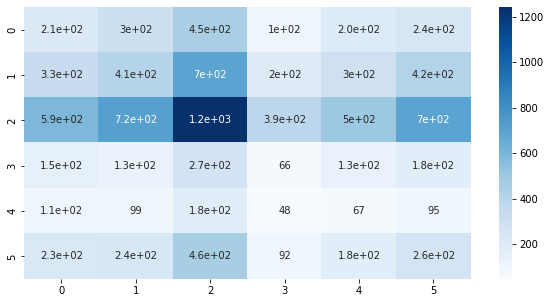

In [ ]:
import seaborn as sns
f = plt.figure()
f.set_figwidth(10)
f.set_figheight(5)
sns.heatmap(r1, annot=True, cmap = 'Blues')

In [ ]:
lb.classes_

array(['esteem', 'love', 'none', 'physiological', 'spiritual growth',
       'stability'], dtype=object)

In [ ]:
#y_test_text

In [ ]:
text_label = pd.Series(lb.inverse_transform(y_test_text))
integer_label = pd.Series(y_test_text)

In [ ]:
integer_label = integer_label.reset_index(drop = True)
#integer_label[0:20]

In [ ]:
#text_label[0:20]

In [ ]:
def make_confusion_matrix(cf,group_names=None,categories='auto',count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    '''
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html
                   
    title:         Title for the heatmap. Default is None.
    '''


    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)
    
    if title:
        plt.title(title)

In [ ]:
uniqueClassesMaslow = list(df4['maslow'].unique())
uniqueClassesMaslowLabel = list(df4['maslowLabel'].unique())

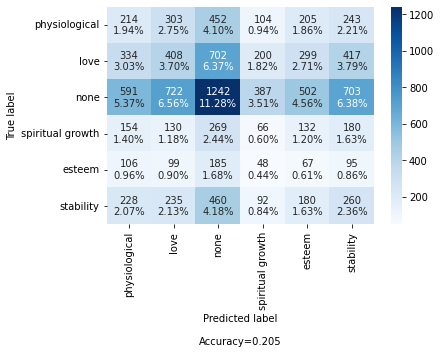

In [ ]:
make_confusion_matrix(r1, group_names=uniqueClassesMaslowLabel, categories=uniqueClassesMaslow, cmap='Blues')

In [ ]:
x_test_text = x_test_text.reset_index(drop = True)
#x_test_text[0:5]

In [ ]:
count = 0
for i in range(0,len(review_predictions)):
    if review_predictions[i] != 0 and integer_label[i] == 0 and count != 10:
        print(x_test_text[i])
        count = count + 1

two boy knocked book arm hallway
we became close friend made time much easier
his instructor shook head disappointingly
every month mailed gift
he famous antic attracted new customer
he made varsity squad
her science teacher encouraged compete science fair
the band contacted two month wedding
within week everyone knew
my wife daughter went shopping queen


In [ ]:
from sklearn.metrics import precision_recall_fscore_support as score

precision, recall, fscore, support = score(integer_label, review_predictions)

print('Labels::{}'.format(uniqueClassesMaslow))
print('precision: {}'.format(precision))
print('recall: {}'.format(recall))
print('fscore: {}'.format(fscore))
print('support: {}'.format(support))

Labels::['physiological', 'love', 'none', 'spiritual growth', 'esteem', 'stability']
precision: [0.14069691 0.17288136 0.29949361 0.07089151 0.11166667 0.17869416]
recall: [0.13153042 0.21507644 0.37522659 0.0735786  0.04837545 0.1369863 ]
fscore: [0.13595934 0.19168428 0.33310983 0.07221007 0.0675063  0.155085  ]
support: [1627 1897 3310  897 1385 1898]


In [ ]:
#The Kappa score tell you how much better, or worse, your classifier is than what would be expected by random chance. 
#If you were to randomly assign cases to classes (i.e. a kind of terribly uninformed classifier), you'd get some correct simply by chance. 
#Therefore, you will always find that the Kappa value is lower than the overall accuracy. 
#The Kappa index is however considered to be a more conservative measure than the overall classification accuracy. 
#Your KIA value is telling you essentially that your classifier is about 66% better than a random assignment of cases to the various classes. That's not bad!
#A kappa value of 1 represents perfect agreement, while a value of 0 represents no agreement.
from sklearn.metrics import cohen_kappa_score
cohen_score = cohen_kappa_score(integer_label, review_predictions)
print(cohen_score)

-0.0025701661192405467


# With Uniform Reiss Classification

## T 

In [ ]:
import pandas as pd 
import matplotlib.pyplot as plt
import numpy as np

from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import confusion_matrix 
from sklearn.model_selection import train_test_split

from keras.models import Sequential
from keras.preprocessing.text import Tokenizer 
from tensorflow.keras import regularizers
from tensorflow.keras.preprocessing.sequence import pad_sequences 
from keras.layers import Dense, Embedding, LSTM,Dropout
import tensorflow as tf
import keras

from nltk.corpus import stopwords  
from nltk.stem import WordNetLemmatizer
from collections import Counter 
import wordcloud
from nltk.corpus import stopwords 
from textblob import Word 
import re
from string import punctuation
import nltk

In [ ]:
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [ ]:
df = pd.read_csv('t.csv')

### Cleaning the Data

In [ ]:
df = df.iloc[:,5:]
df1 = df.drop(columns = ['action','motivation'])
#df1.head()

In [ ]:
def clean(string):
    res = string.strip('][').split(', ')
    lis = []
    for word in res:
        q = word.strip('][').split(', ')
        w = q[0].lstrip('\"')[:-1]
        if w == '' or w == 'na':
            lis.append('none')
        else:
            lis.append(w)
    string = lis
    for classes in lis:
        if classes not in uniqueClasses:
            uniqueClasses.append(classes)
    return string

In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['maslow'][i] = clean(df1['maslow'][i]);
uniqueClassesMaslow = uniqueClasses

In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['reiss'][i] = clean(df1['reiss'][i]);
uniqueClassesReiss = uniqueClasses

In [ ]:
df2 = df1
df3 = df2.explode('reiss')

In [ ]:
df3.head()

,sentence,maslow,reiss
0,I began making fish curry for my boyfriend and I.,[physiological],food
1,I began making fish curry for my boyfriend and I.,"[love, physiological]",family
1,I began making fish curry for my boyfriend and I.,"[love, physiological]",romance
1,I began making fish curry for my boyfriend and I.,"[love, physiological]",food
2,I began making fish curry for my boyfriend and I.,[physiological],food


### Cleaning the Data for NLP tasks

In [ ]:
df3.shape

(65503, 3)

In [ ]:
df3[['sentence','reiss']].groupby('reiss').count()

,sentence
reiss,
approval,3183
belonging,681
competition,2837
contact,4179
curiosity,3037
family,3248
food,2444
health,2129
honor,1645


In [ ]:
df3.head(1)

,sentence,maslow,reiss
0,I began making fish curry for my boyfriend and I.,[physiological],food


In [ ]:
list(df3['reiss'].unique())

['food',
 'family',
 'romance',
 'none',
 'indep',
 'competition',
 'approval',
 'health',
 'contact',
 'serenity',
 'rest',
 'order',
 'status',
 'idealism',
 'power',
 'curiosity',
 'honor',
 'belonging',
 'savings',
 'tranquility']

In [ ]:
undersampling_count = df3[['sentence','reiss']].groupby('reiss').count().min()[0]
print(undersampling_count)   # Therefore we dont sample Phsycological as it has the minimum number of sample i.e dataframe[0]

681


In [ ]:
dontSeeIndex = 10
lis = list(df3['reiss'].unique())
print(lis[10])

rest


In [ ]:
from sklearn.utils import shuffle
lis = list(df3['reiss'].unique())
print(type(lis))
print(lis)
dataframes = []
for i in range(len(lis)):
    dataframe = 't' + str(i)
    dataframe = df3[df3['reiss'] == lis[i]]
    dataframe = dataframe.reset_index()
    dataframe = dataframe.drop(columns = 'index')
    if i!=dontSeeIndex:
        dataframe = shuffle(dataframe)
        dataframe = dataframe.iloc[:681][:]
    dataframes.append(dataframe)
#dataframes[2].head(10)
dataframes[10].head(10)

<class 'list'>
['food', 'family', 'romance', 'none', 'indep', 'competition', 'approval', 'health', 'contact', 'serenity', 'rest', 'order', 'status', 'idealism', 'power', 'curiosity', 'honor', 'belonging', 'savings', 'tranquility']


,sentence,maslow,reiss
0,"That night, he turned the radio on and got int...",[physiological],rest
1,"That night, he turned the radio on and got int...","[stability, physiological]",rest
2,"That night, he turned the radio on and got int...",[physiological],rest
3,The radio played song after song all night lon...,[physiological],rest
4,The radio played song after song all night lon...,[physiological],rest
5,Gina returned to her desk from the bathroom.,[physiological],rest
6,"Tomorrow, I'll try putting a hot towel on it t...",[physiological],rest
7,I immediately fell asleep when I got home.,"[spiritual growth, physiological]",rest
8,I immediately fell asleep when I got home.,[physiological],rest
9,Matt walked on to the bus looked for a seat.,"[stability, physiological]",rest


In [ ]:
df3 = pd.concat(dataframes)
df3 = shuffle(df3)
df3 = df3.reset_index()
df3 = df3.drop(columns = 'index')
df3[['sentence','reiss']].groupby('reiss').count()

,sentence
reiss,
approval,681
belonging,681
competition,681
contact,681
curiosity,681
family,681
food,681
health,681
honor,681


In [ ]:
lb = LabelEncoder() 
df3['reissLabel'] = lb.fit_transform(df3['reiss'])

In [ ]:
df3

,sentence,maslow,reiss,reissLabel
0,Ivan took a few landscapes and some of himself.,[esteem],status,18
1,It was the most peaceful place I've ever visited.,[spiritual growth],serenity,17
2,Dave had entered a raffle at work this past we...,[esteem],competition,2
3,She liked to take a nice hot bath at the end o...,[physiological],rest,14
4,We moved across two states to be together.,[love],romance,15
...,...,...,...,...
13832,"He is terrified at first, but loves the adrena...","[spiritual growth, esteem]",status,18
13833,He offered to buy her a drink.,"[esteem, love]",contact,3
13834,He was supposed to board his plane soon.,[spiritual growth],serenity,17
13835,I laughed and told Bill that he really had it ...,[spiritual growth],idealism,9


In [ ]:
print(df3['reiss'].unique())
print(df3['reissLabel'].unique())

['status' 'serenity' 'competition' 'rest' 'romance' 'contact' 'idealism'
 'indep' 'health' 'none' 'food' 'power' 'tranquility' 'order' 'curiosity'
 'honor' 'savings' 'approval' 'belonging' 'family']
[18 17  2 14 15  3  9 10  7 11  6 13 19 12  4  8 16  0  1  5]


https://machinelearningmastery.com/multi-class-imbalanced-classification/

In [ ]:
from collections import Counter
x = df3['sentence']
y = df3['reissLabel'] 
counter = Counter(y)
for k,v in counter.items():
	per = v / len(y) * 100
	print('Class=%d, n=%d (%.3f%%)' % (k, v, per))

Class=18, n=681 (4.922%)
Class=17, n=681 (4.922%)
Class=2, n=681 (4.922%)
Class=14, n=898 (6.490%)
Class=15, n=681 (4.922%)
Class=3, n=681 (4.922%)
Class=9, n=681 (4.922%)
Class=10, n=681 (4.922%)
Class=7, n=681 (4.922%)
Class=11, n=681 (4.922%)
Class=6, n=681 (4.922%)
Class=13, n=681 (4.922%)
Class=19, n=681 (4.922%)
Class=12, n=681 (4.922%)
Class=4, n=681 (4.922%)
Class=8, n=681 (4.922%)
Class=16, n=681 (4.922%)
Class=0, n=681 (4.922%)
Class=1, n=681 (4.922%)
Class=5, n=681 (4.922%)


In [ ]:
punctuation

'!"#$%&\'()*+,-./:;<=>?@[\\]^_`{|}~'

In [ ]:
def tokenization(string):
    words=nltk.word_tokenize(string)
    return ' '.join(words)

def removestopwords(string):
    for i in punctuation:
        string=string.replace(i,'')
    words=nltk.word_tokenize(string)
    k=[]
    eng_stop=stopwords.words('english')
    for each in words:
        if each not in eng_stop:
            k.append(each.lower())
    return ' '.join(k)

def lemmat(string):
    words=nltk.word_tokenize(string)
    ws=WordNetLemmatizer()
    l=[]
    for each in words:
        l.append(ws.lemmatize(each))
    return ' '.join(l)

def Refine(string):
    return lemmat(removestopwords(tokenization(string)))

In [ ]:
df4 = df3.copy()
df4['sentence']=df4['sentence'].apply(lambda x: Refine(x))
df4

,sentence,maslow,reiss,reissLabel
0,ivan took landscape,[esteem],status,18
1,it peaceful place i ever visited,[spiritual growth],serenity,17
2,dave entered raffle work past weekend,[esteem],competition,2
3,she liked take nice hot bath end day,[physiological],rest,14
4,we moved across two state together,[love],romance,15
...,...,...,...,...
13832,he terrified first love adrenaline rush,"[spiritual growth, esteem]",status,18
13833,he offered buy drink,"[esteem, love]",contact,3
13834,he supposed board plane soon,[spiritual growth],serenity,17
13835,i laughed told bill really coming,[spiritual growth],idealism,9


In [ ]:
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

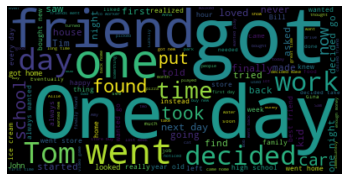

In [ ]:
common_words = ''
for i in df.sentence:
    i = str(i)
    tokens = i.split()
    common_words += " ".join(tokens) + " "
wordcloud = WordCloud().generate(common_words)   
plt.imshow(wordcloud, interpolation = 'bilinear')  # bilinear is used to display smooth images
plt.axis('off')
plt.show()

In [ ]:
k = pd.Series(np.concatenate([x.split() for x in df4.sentence])).value_counts()
a = df4['sentence'].str.lower().str.cat(sep=' ')
words = nltk.tokenize.word_tokenize(a)
word_dist = nltk.FreqDist(words)
print (word_dist)
print(len(word_dist))
rslt = pd.DataFrame(word_dist.most_common(30),
                    columns=['Word', 'Frequency'])
#print(rslt)

<FreqDist with 5804 samples and 74472 outcomes>
5804


In [ ]:
print(df4.sentence.map(lambda x: len(x)).max())

62


In [ ]:
lengths = df4["sentence"].str.len()
argmax = np.where(lengths == lengths.max())[0]
df4.iloc[argmax].head(1)

,sentence,maslow,reiss,reissLabel
1111,in stunner 10th seeded syracuse upset number 1...,[esteem],competition,2


### Model LSTM

In [ ]:
from keras.layers import Dense, Flatten, LSTM, Conv1D, MaxPooling1D, Dropout, Activation

In [ ]:
model = Sequential()
model.add(Embedding(5780, 50, input_length=62))
model.add(Dropout(0.3))
model.add(LSTM(200, activation = 'tanh',kernel_regularizer=regularizers.l2(0.03)))
model.add(Dropout(0.2))
model.add(Dense(units = 200, activation = 'relu'))
model.add(Dense(20, activation='softmax'))

In [ ]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_1 (Embedding)     (None, 62, 50)            289000    
                                                                 
 dropout_2 (Dropout)         (None, 62, 50)            0         
                                                                 
 lstm_1 (LSTM)               (None, 200)               200800    
                                                                 
 dropout_3 (Dropout)         (None, 200)               0         
                                                                 
 dense_2 (Dense)             (None, 200)               40200     
                                                                 
 dense_3 (Dense)             (None, 20)                4020      
                                                                 
Total params: 534,020
Trainable params: 534,020
Non-tr

In [ ]:
METRICS = [
      keras.metrics.TruePositives(name='tp'),
      keras.metrics.FalsePositives(name='fp'),
      keras.metrics.TrueNegatives(name='tn'),
      keras.metrics.FalseNegatives(name='fn'), 
      keras.metrics.CategoricalCrossentropy(name='categorical_cross_entropy'),
      keras.metrics.Precision(name='precision'),
      keras.metrics.Recall(name='recall'),
      keras.metrics.AUC(name='auc'),
      keras.metrics.AUC(name='prc', curve='PR'), # precision-recall curve
      keras.metrics.Accuracy(name = 'accuracy')
]

In [ ]:
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics= 'accuracy')

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(df4['sentence'],df4['reissLabel'],test_size = 0.2, random_state = 0, stratify = df4['reissLabel'])

In [ ]:
x_train_text = x_train 
x_test_text = x_test
y_train_text = y_train
y_test_text = y_test

In [ ]:
print(x_train.shape)
print(x_test.shape)

(11069,)
(2768,)


In [ ]:
tokenizer = Tokenizer(num_words = 5780, split = ' ')
tokenizer.fit_on_texts(x_train.values)
x = tokenizer.texts_to_sequences(x_train.values) # Numerical vectors got created
x = pad_sequences(x, maxlen=62)
x_train = x

tokenizer = Tokenizer(num_words = 5780, split = ' ')
tokenizer.fit_on_texts(x_test.values)
x = tokenizer.texts_to_sequences(x_test.values) # Numerical vectors got created
x = pad_sequences(x, maxlen=62)
x_test = x

In [ ]:
print(x_train.shape)
print(x_test.shape)

(11069, 62)
(2768, 62)


In [ ]:
from tensorflow.keras.utils import to_categorical
y_train = to_categorical(y_train)
y_test =  to_categorical(y_test)

In [ ]:
history = model.fit(x_train, y_train,epochs=20,verbose=1,validation_split=0.1)

Epoch 1/20
312/312 [==============================] - 5s 10ms/step - loss: 3.2121 - accuracy: 0.0630 - val_loss: 2.9982 - val_accuracy: 0.0614
Epoch 2/20
312/312 [==============================] - 3s 8ms/step - loss: 2.9954 - accuracy: 0.0652 - val_loss: 2.9966 - val_accuracy: 0.0614
Epoch 3/20
312/312 [==============================] - 3s 9ms/step - loss: 2.9871 - accuracy: 0.0726 - val_loss: 2.9576 - val_accuracy: 0.0967
Epoch 4/20
312/312 [==============================] - 3s 9ms/step - loss: 2.8995 - accuracy: 0.1081 - val_loss: 2.9033 - val_accuracy: 0.0840
Epoch 5/20
312/312 [==============================] - 3s 10ms/step - loss: 2.8035 - accuracy: 0.1227 - val_loss: 2.8932 - val_accuracy: 0.0949
Epoch 6/20
312/312 [==============================] - 3s 8ms/step - loss: 2.7421 - accuracy: 0.1291 - val_loss: 2.8971 - val_accuracy: 0.0976
Epoch 7/20
312/312 [==============================] - 3s 8ms/step - loss: 2.7011 - accuracy: 0.1446 - val_loss: 2.9074 - val_accuracy: 0.1220
Epoc

In [ ]:
model.evaluate(x_test, y_test)

87/87 [==============================] - 1s 7ms/step - loss: 4.3535 - accuracy: 0.0542


[4.353510856628418, 0.054190751165151596]

### Evaluation and Analysis

In [ ]:
y_pred = model.predict(x_test)

In [ ]:
y_pred[2]

array([6.95191184e-03, 1.72844005e-03, 4.16448200e-03, 5.77787519e-04,
       7.28652701e-02, 6.01142831e-02, 1.79873634e-04, 6.75302057e-04,
       7.15091601e-02, 3.78202647e-01, 7.09536150e-02, 1.95248369e-02,
       1.22928254e-01, 1.23361565e-01, 3.69800728e-05, 3.85598923e-06,
       1.37765463e-02, 9.19624232e-03, 1.42586529e-02, 2.89903004e-02],
      dtype=float32)

In [ ]:
review_predictions = []
for prediction in y_pred:
    x = prediction
    review_predictions.append(np.argmax(x))

review_predictions = np.array(review_predictions)
review_predictions.reshape(1,-1)
review_predictions.shape

(2768,)

In [ ]:
review_predictions

array([ 0,  4,  9, ...,  5,  9, 10])

In [ ]:
k = pd.DataFrame(review_predictions, columns = ['Label'])
k.groupby('Label')['Label'].count()

Label
0      92
1     164
2     103
3     185
4      61
5     189
6      70
7     191
8      60
9     239
10    158
11     77
12    146
13     67
14    126
15    226
16    201
17    146
18    188
19     79
Name: Label, dtype: int64

In [ ]:
type(y_test_text)

pandas.core.series.Series

In [ ]:
import sklearn
r1 = sklearn.metrics.confusion_matrix(review_predictions, y_test_text)
print(r1)

[[ 4  3  3  6  2  3  8  7  5  4  3  0  3  8  6  6  4  5  6  6]
 [ 7 10  8  8 11  8  9 10  7 11  6  7  9  8  8  9  7  6  5 10]
 [ 5  6  1  6  9  7  6  6  5  4  5  6  5  7  7  5  2  1  4  6]
 [ 7  4  7  9  6  7 11  9  8 10 12 11 12  6 15  4 15  9 10 13]
 [ 3  2  6  3  2  3  4  4  2  1  3  5  3  1  3  5  5  2  2  2]
 [ 6 11  6  9 13 12  7 11 10 15  6 10  6  8  9  8 10 11 11 10]
 [ 7  2  2  5  5  4  2  3  5  4  3  2  2  2  7  4  2  2  5  2]
 [ 6  9  6 13 15 11  7 13  5  9  7 14 14  6 13  8  8  9 10  8]
 [ 2  4  7  3  4  3  2  1  4  3  3  3  1  2  0  3  6  3  4  2]
 [15 12 19 10 11  6 10  6  6 12  9 10 14 20 16 10 10 18 14 11]
 [ 5 12  6  7  4  4  7 11 13  9 12  8  8  9 11 10  4  7  7  4]
 [ 3  3  4  8  1  4  5  5  4  4  7  5  1  1  8  1  2  2  8  1]
 [ 7 12 10  9  7  4  6  7  7  6  6 10  9  4  6  6 12  7  6  5]
 [ 2  5  1  4  4  2  1  4  4  6  5  4  4  5  4  3  1  2  3  3]
 [ 6  4  8  2  8  9  3  9  8  5  8  2  5 11  7  8  7  6  4  6]
 [14 11 11  9 11 13 19 10 10  8 12  8  7 11 21 13 10 11

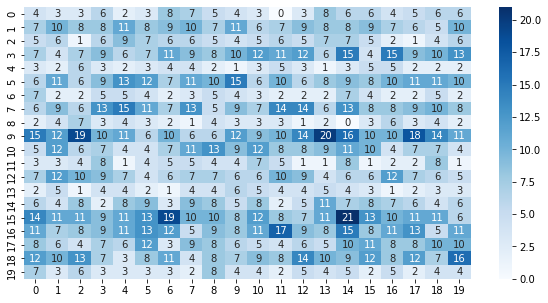

In [ ]:
import seaborn as sns
f = plt.figure()
f.set_figwidth(10)
f.set_figheight(5)
sns.heatmap(r1, annot=True, cmap = 'Blues')

In [ ]:
lb.classes_

array(['approval', 'belonging', 'competition', 'contact', 'curiosity',
       'family', 'food', 'health', 'honor', 'idealism', 'indep', 'none',
       'order', 'power', 'rest', 'romance', 'savings', 'serenity',
       'status', 'tranquility'], dtype=object)

In [ ]:
#y_test_text

In [ ]:
text_label = pd.Series(lb.inverse_transform(y_test_text))
integer_label = pd.Series(y_test_text)

In [ ]:
integer_label = integer_label.reset_index(drop = True)
#integer_label[0:20]

In [ ]:
#text_label[0:20]

In [ ]:
def make_confusion_matrix(cf,group_names=None,categories='auto',count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    '''
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html
                   
    title:         Title for the heatmap. Default is None.
    '''


    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = (20,20)

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)
    
    if title:
        plt.title(title)

In [ ]:
uniqueClassesReiss = list(df4['reiss'].unique())
uniqueClassesReissLabel = list(df4['reissLabel'].unique())

<Figure size 2160x2160 with 0 Axes>

<Figure size 2160x2160 with 0 Axes>

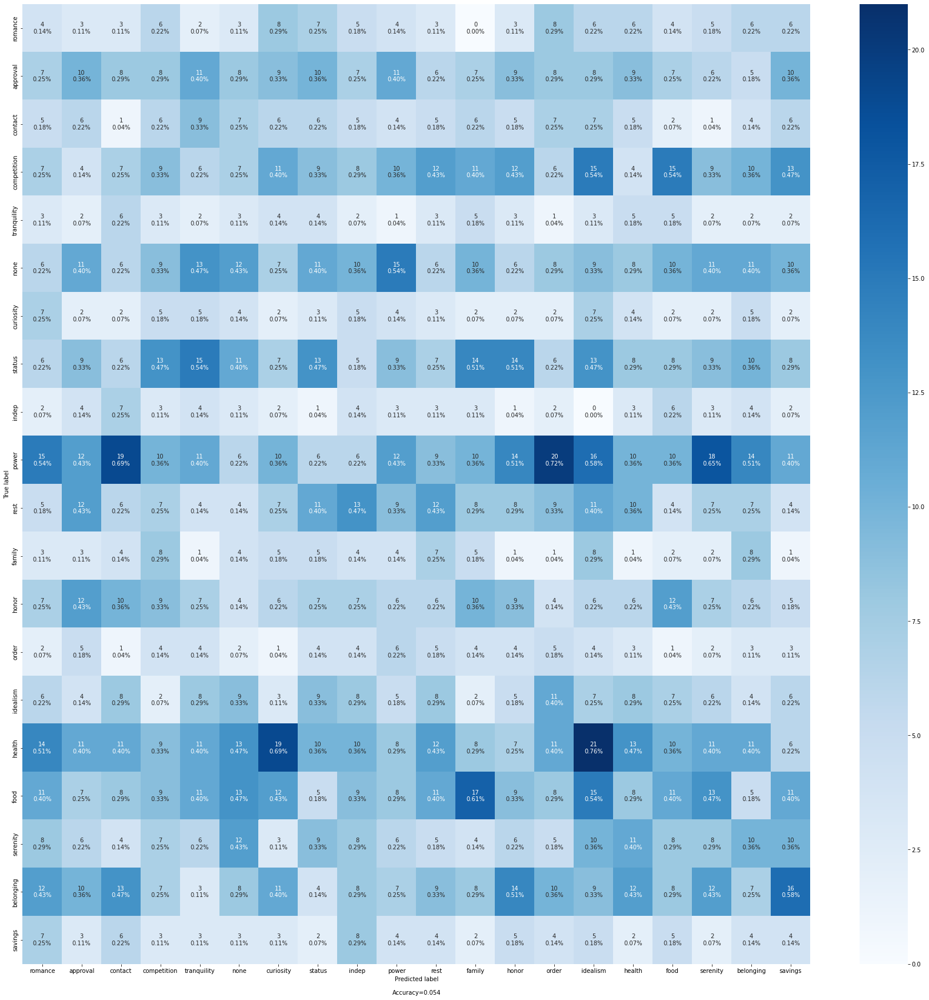

In [ ]:
f = plt.figure()
f.set_figwidth(30)
f.set_figheight(30)
make_confusion_matrix(r1, group_names=uniqueClassesReissLabel, categories=uniqueClassesReiss, cmap='Blues')
plt.show()

In [ ]:
x_test_text = x_test_text.reset_index(drop = True)
#x_test_text[0:5]

In [ ]:
count = 0
for i in range(0,len(review_predictions)):
    if review_predictions[i] != 0 and integer_label[i] == 0 and count != 10:
        print(x_test_text[i])
        count = count + 1

she tried different store expensive
instead racing stopped help injured runner
ray tried blame friend sense humor
she looked absolutely beautiful
she also interned local health department gain experience
her saving dwindling quickly
martin proceeded pick nice design name
his family nt think could live alone anymore
charlie stood decide jump kick walk away
a man went gas station fill gas tank


In [ ]:
from sklearn.metrics import precision_recall_fscore_support as score

precision, recall, fscore, support = score(integer_label, review_predictions)

print('Labels::{}'.format(uniqueClassesMaslow))
print('precision: {}'.format(precision))
print('recall: {}'.format(recall))
print('fscore: {}'.format(fscore))
print('support: {}'.format(support))

Labels::['romance', 'approval', 'contact', 'competition', 'tranquility', 'none', 'curiosity', 'status', 'indep', 'power', 'rest', 'family', 'honor', 'order', 'idealism', 'health', 'food', 'serenity', 'belonging', 'savings']
precision: [0.04347826 0.06097561 0.00970874 0.04864865 0.03278689 0.06349206
 0.02857143 0.06806283 0.06666667 0.05020921 0.07594937 0.06493506
 0.06164384 0.07462687 0.05555556 0.05752212 0.05472637 0.05479452
 0.03723404 0.05063291]
recall: [0.02919708 0.07352941 0.00735294 0.06569343 0.01470588 0.08823529
 0.01470588 0.09558824 0.02941176 0.08823529 0.08823529 0.03676471
 0.06569343 0.03676471 0.03888889 0.09558824 0.08029197 0.05882353
 0.05147059 0.02941176]
fscore: [0.0349345  0.06666667 0.0083682  0.05590062 0.02030457 0.07384615
 0.01941748 0.0795107  0.04081633 0.064      0.08163265 0.04694836
 0.06360424 0.04926108 0.04575163 0.0718232  0.06508876 0.05673759
 0.04320988 0.0372093 ]
support: [137 136 136 137 136 136 136 136 136 136 136 136 137 136 180 136 

In [ ]:
#The Kappa score tell you how much better, or worse, your classifier is than what would be expected by random chance. 
#If you were to randomly assign cases to classes (i.e. a kind of terribly uninformed classifier), you'd get some correct simply by chance. 
#Therefore, you will always find that the Kappa value is lower than the overall accuracy. 
#The Kappa index is however considered to be a more conservative measure than the overall classification accuracy. 
#Your KIA value is telling you essentially that your classifier is about 66% better than a random assignment of cases to the various classes. That's not bad!
#A kappa value of 1 represents perfect agreement, while a value of 0 represents no agreement.
from sklearn.metrics import cohen_kappa_score
cohen_score = cohen_kappa_score(integer_label, review_predictions)
print(cohen_score)

0.004476311159126167


## Reiss Another Model

In [ ]:
!pip install -q -U "tensorflow-text==2.8.*"
!pip install -q tf-models-official==2.7.0
#!pip install official

     |████████████████████████████████| 4.9 MB 13.4 MB/s 
     |████████████████████████████████| 1.8 MB 14.5 MB/s 
     |████████████████████████████████| 48.3 MB 95 kB/s 
     |████████████████████████████████| 43 kB 2.3 MB/s 
     |████████████████████████████████| 238 kB 57.4 MB/s 
     |████████████████████████████████| 99 kB 9.8 MB/s 
     |████████████████████████████████| 596 kB 57.5 MB/s 
     |████████████████████████████████| 352 kB 65.7 MB/s 
     |████████████████████████████████| 92 kB 11.2 MB/s 
     |████████████████████████████████| 1.2 MB 59.6 MB/s 
     |████████████████████████████████| 1.1 MB 69.9 MB/s 


In [ ]:
import pandas as pd 
import matplotlib.pyplot as plt
import numpy as np

from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import confusion_matrix 
from sklearn.model_selection import train_test_split

from keras.models import Sequential
from tensorflow.keras.callbacks import EarlyStopping
from keras.preprocessing.text import Tokenizer 
from tensorflow.keras.preprocessing.sequence import pad_sequences 
from tensorflow.keras import regularizers
from keras.layers import Dense, Embedding, LSTM,Dropout,Activation, Conv1D, MaxPooling1D, SimpleRNN, GRU
import tensorflow as tf
import keras
import tensorflow_hub as hub
import tensorflow_text as text

from official.nlp import optimization
from nltk.corpus import stopwords  
from nltk.stem import WordNetLemmatizer
from collections import Counter 
import wordcloud
from nltk.corpus import stopwords 
from textblob import Word 
import re
from string import punctuation
import nltk

tf.get_logger().setLevel('ERROR')

Rerun above cleaning again

### Model

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(df4['sentence'],df4['reissLabel'],test_size = 0.2, random_state = 0, stratify = df4['reissLabel'])

In [ ]:
x_train_text = x_train 
x_test_text = x_test
y_train_text = y_train
y_test_text = y_test

In [ ]:
print(x_train.shape)
print(x_test.shape)

(11069,)
(2768,)


In [ ]:
'''
# CNN
batch_size = 32
filters = 250
kernel_size = 3
hidden_dims = 250
epochs = 10

model = Sequential()
model.add(Embedding(7254, 100, input_length=62))
model.add(Conv1D(filters, kernel_size, padding = 'valid', activation = 'relu', strides = 1, input_shape = (44052, 62)))
model.add(GlobalMaxPooling1D())
model.add(Dense(hidden_dims))
model.add(Dropout(0.2))
model.add(Activation('relu'))
model.add(Dense(6))
model.add(Activation('sigmoid'))
'''

"\n# CNN\nbatch_size = 32\nfilters = 250\nkernel_size = 3\nhidden_dims = 250\nepochs = 10\n\nmodel = Sequential()\nmodel.add(Embedding(7254, 100, input_length=62))\nmodel.add(Conv1D(filters, kernel_size, padding = 'valid', activation = 'relu', strides = 1, input_shape = (44052, 62)))\nmodel.add(GlobalMaxPooling1D())\nmodel.add(Dense(hidden_dims))\nmodel.add(Dropout(0.2))\nmodel.add(Activation('relu'))\nmodel.add(Dense(6))\nmodel.add(Activation('sigmoid'))\n"

In [ ]:
'''
# WANT TO USE BERT: Here only change y to categorical rest to embeddings bert will take care
bert_preprocess = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_preprocess/3")
bert_encoder = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4")
text_input = tf.keras.layers.Input(shape=(), dtype=tf.string, name='text')
preprocessed_text = bert_preprocess(text_input)
outputs = bert_encoder(preprocessed_text)
l = tf.keras.layers.Dropout(0.1, name="dropout")(outputs['pooled_output'])
l = tf.keras.layers.Dense(6, activation='softmax', name="output")(l)
model = tf.keras.Model(inputs=[text_input], outputs = [l])
'''

'\n# WANT TO USE BERT: Here only change y to categorical rest to embeddings bert will take care\nbert_preprocess = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_preprocess/3")\nbert_encoder = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4")\ntext_input = tf.keras.layers.Input(shape=(), dtype=tf.string, name=\'text\')\npreprocessed_text = bert_preprocess(text_input)\noutputs = bert_encoder(preprocessed_text)\nl = tf.keras.layers.Dropout(0.1, name="dropout")(outputs[\'pooled_output\'])\nl = tf.keras.layers.Dense(6, activation=\'softmax\', name="output")(l)\nmodel = tf.keras.Model(inputs=[text_input], outputs = [l])\n'

In [ ]:
tokenizer = Tokenizer(num_words = 5780, split = ' ')
tokenizer.fit_on_texts(x_train.values)
x = tokenizer.texts_to_sequences(x_train.values) # Numerical vectors got created
x = pad_sequences(x, maxlen=62)
x_train = x

tokenizer = Tokenizer(num_words = 5780, split = ' ')
tokenizer.fit_on_texts(x_test.values)
x = tokenizer.texts_to_sequences(x_test.values) # Numerical vectors got created
x = pad_sequences(x, maxlen=62)
x_test = x

In [ ]:
from tensorflow.keras.utils import to_categorical
y_train = to_categorical(y_train)
y_test =  to_categorical(y_test)

In [ ]:
print(x_train.shape)
print(x_test.shape)

(11069, 62)
(2768, 62)


In [ ]:
#bert_preprocess = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_preprocess/3")
#bert_encoder = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4")

In [ ]:
from tensorflow.keras.layers import Bidirectional
batch_size = 32
filters = 250
kernel_size = 3
hidden_dims = 250
epochs = 10
model = Sequential()
model.add(Embedding(input_dim = 5780, output_dim = 131, input_length=62))
model.add(Conv1D(filters = 250, kernel_size = 3, padding = 'valid', activation = 'relu', strides = 1))
model.add(MaxPooling1D(pool_size=2))
model.add(Bidirectional(LSTM(300, activation = 'tanh', recurrent_dropout=0.2, dropout=0.2, return_sequences=True, kernel_regularizer=regularizers.l2(0.01))))
model.add(Dropout(0.2))
model.add(LSTM(300, activation = 'tanh', recurrent_dropout=0.2, dropout=0.2, return_sequences = True, kernel_regularizer=regularizers.l2(0.02)))
model.add(Dropout(0.2))
model.add(GRU(256, return_sequences=True, kernel_regularizer=regularizers.l2(0.03)))
model.add(SimpleRNN(128))
model.add(Dropout(0.2))
model.add(Dense(units = 250, activation = 'relu'))
model.add(Dropout(0.2))
model.add(Dense(units = 200, activation = 'relu'))
model.add(Dense(20, activation='softmax'))
model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_2 (Embedding)     (None, 62, 131)           757180    
                                                                 
 conv1d (Conv1D)             (None, 60, 250)           98500     
                                                                 
 max_pooling1d (MaxPooling1D  (None, 30, 250)          0         
 )                                                               
                                                                 
 bidirectional (Bidirectiona  (None, 30, 600)          1322400   
 l)                                                              
                                                                 
 dropout_4 (Dropout)         (None, 30, 600)           0         
                                                                 
 lstm_3 (LSTM)               (None, 30, 300)          

In [ ]:
'''
model = Sequential()
model.add(Embedding(6799, 131, input_length=62))
model.add(Dropout(0.2))
model.add(LSTM(200, activation = 'tanh'))
model.add(Dropout(0.2))
model.add(Dense(units = 200, activation = 'relu'))
model.add(Dense(6, activation='softmax'))
model.summary()
'''

"\nmodel = Sequential()\nmodel.add(Embedding(6799, 131, input_length=62))\nmodel.add(Dropout(0.2))\nmodel.add(LSTM(200, activation = 'tanh'))\nmodel.add(Dropout(0.2))\nmodel.add(Dense(units = 200, activation = 'relu'))\nmodel.add(Dense(6, activation='softmax'))\nmodel.summary()\n"

In [ ]:
METRICS = [
      keras.metrics.TruePositives(name='tp'),
      keras.metrics.FalsePositives(name='fp'),
      keras.metrics.TrueNegatives(name='tn'),
      keras.metrics.FalseNegatives(name='fn'), 
      keras.metrics.CategoricalCrossentropy(name='categorical_cross_entropy'),
      keras.metrics.Precision(name='precision'),
      keras.metrics.Recall(name='recall'),
      keras.metrics.AUC(name='auc'),
      keras.metrics.AUC(name='prc', curve='PR'), # precision-recall curve
      tf.keras.metrics.Accuracy(name="accuracy", dtype=None)
]

In [ ]:
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics= ['accuracy'])

In [ ]:
history = model.fit(x_train, y_train,epochs=10,verbose=1,validation_data = (x_test, y_test))

Epoch 1/10
346/346 [==============================] - 178s 471ms/step - loss: 4.9892 - accuracy: 0.0589 - val_loss: 2.9952 - val_accuracy: 0.0650
Epoch 2/10
346/346 [==============================] - 161s 467ms/step - loss: 2.9958 - accuracy: 0.0645 - val_loss: 2.9941 - val_accuracy: 0.0650
Epoch 3/10
346/346 [==============================] - 159s 460ms/step - loss: 2.9955 - accuracy: 0.0649 - val_loss: 2.9939 - val_accuracy: 0.0650
Epoch 4/10
346/346 [==============================] - 160s 463ms/step - loss: 2.9951 - accuracy: 0.0649 - val_loss: 2.9940 - val_accuracy: 0.0650
Epoch 5/10
346/346 [==============================] - 159s 458ms/step - loss: 2.9949 - accuracy: 0.0649 - val_loss: 2.9939 - val_accuracy: 0.0650
Epoch 6/10
346/346 [==============================] - 161s 464ms/step - loss: 2.9947 - accuracy: 0.0649 - val_loss: 2.9937 - val_accuracy: 0.0650
Epoch 7/10
346/346 [==============================] - 158s 457ms/step - loss: 2.9947 - accuracy: 0.0649 - val_loss: 2.9939 -

In [ ]:
model.evaluate(x_test, y_test)

87/87 [==============================] - 4s 44ms/step - loss: 2.9937 - accuracy: 0.0650


[2.9936509132385254, 0.06502889841794968]

In [ ]:
print(history.history.keys())

dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])


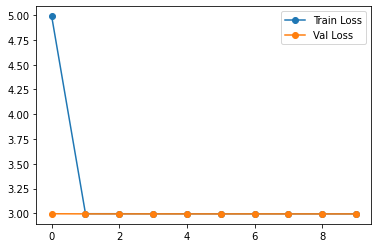

In [ ]:
plt.plot(history.history['loss'], '-o', label='Train Loss')
plt.plot(history.history['val_loss'], '-o', label = 'Val Loss')
plt.legend()

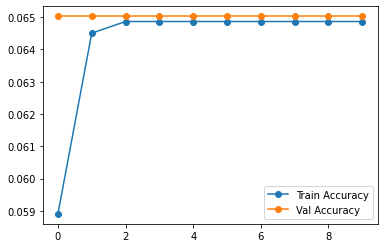

In [ ]:
plt.plot(history.history['accuracy'], '-o', label='Train Accuracy')
plt.plot(history.history['val_accuracy'], '-o', label = 'Val Accuracy')
plt.legend()

In [ ]:
y_pred_test = model.predict(x_test)
y_pred_train = model.predict(x_train)

In [ ]:
review_predictions_test = []
for prediction in y_pred_test:
    x = prediction
    review_predictions_test.append(np.argmax(x))

review_predictions_test = np.array(review_predictions_test)
review_predictions_test.reshape(1,-1)
review_predictions_test.shape

(2768,)

In [ ]:
review_predictions_train = []
for prediction in y_pred_train:
    x = prediction
    review_predictions_train.append(np.argmax(x))

review_predictions_train = np.array(review_predictions_train)
review_predictions_train.reshape(1,-1)
review_predictions_train.shape

(11069,)

In [ ]:
k = pd.DataFrame(review_predictions_train, columns = ['trainPredictedLabel'])
k.groupby('trainPredictedLabel')['trainPredictedLabel'].count()

trainPredictedLabel
14    11069
Name: trainPredictedLabel, dtype: int64

In [ ]:
actual = y_train_text.reset_index()
actual.head(3)

,index,reissLabel
0,13618,0
1,6400,9
2,4994,7


In [ ]:
k['actualLabel'] = actual['reissLabel']
k.head(1)

,trainPredictedLabel,actualLabel
0,14,0


In [ ]:
from sklearn.metrics import accuracy_score
train_acc = accuracy_score(k['actualLabel'], k['trainPredictedLabel'])

In [ ]:
k = pd.DataFrame(review_predictions_test, columns = ['testPredictedLabel'])
k.groupby('testPredictedLabel')['testPredictedLabel'].count()
actual = y_test_text.reset_index()
k['actualLabel'] = actual['reissLabel']
test_acc = accuracy_score(k['actualLabel'], k['testPredictedLabel'])

In [ ]:
print('Training Accuracy:',train_acc)
print('Testing accuracy:',test_acc)

Training Accuracy: 0.06486584153943446
Testing accuracy: 0.06502890173410404


In [ ]:
import sklearn
r1 = sklearn.metrics.confusion_matrix(review_predictions_test, y_test_text)
print(r1)

[[  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0]
 [  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0]
 [  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0]
 [  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0]
 [  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0]
 [  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0]
 [  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0]
 [  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0]
 [  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0]
 [  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0]
 [  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
    0   0]
 [  0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0

Resources: 

1. https://www.analyticssteps.com/blogs/what-stemming-and-lemmatization-nlp
2. https://www.tensorflow.org/api_docs/python/tf/keras/layers/Embedding


# With Uniform Classification BERT

### Uniform Classes Bert Classifier

In [ ]:
import pandas as pd 
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns 

from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import confusion_matrix 
from sklearn.model_selection import train_test_split
import sklearn

from keras.models import Sequential
from keras.preprocessing.text import Tokenizer 
from tensorflow.keras.preprocessing.sequence import pad_sequences 
from keras.layers import Dense, Embedding, LSTM,Dropout, Conv1D, MaxPooling1D, Dropout, Activation
import tensorflow as tf

from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from nltk.corpus import stopwords  
from nltk.stem import WordNetLemmatizer
from nltk.stem import PorterStemmer
from collections import Counter 
import wordcloud
from nltk.corpus import stopwords 
from textblob import Word 
import re
from string import punctuation
import nltk

In [ ]:
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [ ]:
df = pd.read_csv('t.csv')

#### All Classes Maslow

##### Cleaning the Data

In [ ]:
df1 = df.drop(columns = ['action','motivation'])

In [ ]:
def clean(string):
    res = string.strip('][').split(', ')
    lis = []
    for word in res:
        q = word.strip('][').split(', ')
        w = q[0].lstrip('\"')[:-1]
        if w == '' or w == 'na':
            lis.append('none')
        else:
            lis.append(w)
    string = lis
    for classes in lis:
        if classes not in uniqueClasses:
            uniqueClasses.append(classes)
    return string

In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['maslow'][i] = clean(df1['maslow'][i]);
uniqueClassesMaslow = uniqueClasses

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['reiss'][i] = clean(df1['reiss'][i]);
uniqueClassesReiss = uniqueClasses

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
df2 = df1
df3 = df2.explode('maslow')

In [ ]:
df2.head(60)

,storyid,linenum,char,motiveworkerid,context,sentence,maslow,reiss
0,a2ddbb50-e45b-4ad3-becf-b2d8475172bf,1,I (myself),ann0,NaN,I began making fish curry for my boyfriend and I.,[physiological],[food]
1,a2ddbb50-e45b-4ad3-becf-b2d8475172bf,1,I (myself),ann1,NaN,I began making fish curry for my boyfriend and I.,"[love, physiological]","[family, romance, food]"
2,a2ddbb50-e45b-4ad3-becf-b2d8475172bf,1,I (myself),ann2,NaN,I began making fish curry for my boyfriend and I.,[physiological],[food]
3,a2ddbb50-e45b-4ad3-becf-b2d8475172bf,1,Boyfriend,none,NaN,I began making fish curry for my boyfriend and I.,[none],[none]
4,a2ddbb50-e45b-4ad3-becf-b2d8475172bf,2,I (myself),ann0,I began making fish curry for my boyfriend and I.,I decided not to read a recipe since I've made...,[spiritual growth],[indep]
5,a2ddbb50-e45b-4ad3-becf-b2d8475172bf,2,I (myself),ann1,I began making fish curry for my boyfriend and I.,I decided not to read a recipe since I've made...,[physiological],[food]
6,a2ddbb50-e45b-4ad3-becf-b2d8475172bf,2,I (myself),ann2,I began making fish curry for my boyfriend and I.,I decided not to read a recipe since I've made...,[spiritual growth],[indep]
7,a2ddbb50-e45b-4ad3-becf-b2d8475172bf,2,Boyfriend,none,I began making fish curry for my boyfriend and I.,I decided not to read a recipe since I've made...,[none],[none]
8,a2ddbb50-e45b-4ad3-becf-b2d8475172bf,3,I (myself),ann0,I began making fish curry for my boyfriend and...,I let the curry sit before tasting.,"[esteem, love]","[competition, approval, romance]"
9,a2ddbb50-e45b-4ad3-becf-b2d8475172bf,3,I (myself),ann1,I began making fish curry for my boyfriend and...,I let the curry sit before tasting.,"[spiritual growth, esteem]","[indep, competition]"


In [ ]:
df3 = df3[df3['motiveworkerid'] != 'none']
df3 = df3[['motiveworkerid','sentence','maslow','reiss']]


In [ ]:
df3 = df3.drop_duplicates(subset = ['sentence']).reset_index(drop = True)

In [ ]:
df3.head(10)

,motiveworkerid,sentence,maslow,reiss
0,ann0,I began making fish curry for my boyfriend and I.,physiological,[food]
1,ann0,I decided not to read a recipe since I've made...,spiritual growth,[indep]
2,ann0,I let the curry sit before tasting.,esteem,"[competition, approval, romance]"
3,ann0,"When it was time to taste, I was disgusted.",spiritual growth,[none]
4,ann0,I accidentally used a whole garlic instead of ...,none,[none]
5,ann0,He wants to have a girlfriend.,love,[romance]
6,ann0,One day he meets a nice girl at the grocery st...,love,"[contact, romance]"
7,ann0,They begin to date.,love,"[contact, romance]"
8,ann0,Jervis is happy that he is no longer single.,love,[romance]
9,ann0,Ray couldn't get an irritating tune out of his...,none,[none]


In [ ]:
'''
from sklearn.utils import shuffle
k1 = df3[df3['maslow'] == 'none'] 
k2 = df3[df3['maslow'] == 'physiological']
df3 = pd.concat([k1,k2],axis = 0)
df3 = shuffle(df3)
df3 = df3.reset_index()
df3 = df3.drop(columns = 'index')
'''

"\nfrom sklearn.utils import shuffle\nk1 = df3[df3['maslow'] == 'none'] \nk2 = df3[df3['maslow'] == 'physiological']\ndf3 = pd.concat([k1,k2],axis = 0)\ndf3 = shuffle(df3)\ndf3 = df3.reset_index()\ndf3 = df3.drop(columns = 'index')\n"

##### Cleaning the Data for NLP tasks

In [ ]:
df3.head()

,motiveworkerid,sentence,maslow,reiss
0,ann0,I began making fish curry for my boyfriend and I.,physiological,[food]
1,ann0,I decided not to read a recipe since I've made...,spiritual growth,[indep]
2,ann0,I let the curry sit before tasting.,esteem,"[competition, approval, romance]"
3,ann0,"When it was time to taste, I was disgusted.",spiritual growth,[none]
4,ann0,I accidentally used a whole garlic instead of ...,none,[none]


In [ ]:
from google.colab import files

df.to_csv('output.csv', encoding = 'utf-8-sig') 
files.download('output.csv')
df3.to_csv('file1.csv')

In [ ]:
df3.shape

(10670, 4)

(array([0, 1, 2, 3, 4, 5]), <a list of 6 Text major ticklabel objects>)

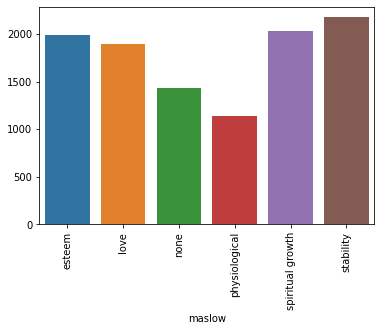

In [ ]:
c = df3.groupby('maslow')['maslow'].count()
sns.barplot(x = c.index, y = c.values)
plt.xticks(rotation = 90)

In [ ]:
df3.shape[0]

10670

In [ ]:
df3[['sentence','maslow']].groupby('maslow').count()

,sentence
maslow,
esteem,1990
love,1896
none,1436
physiological,1139
spiritual growth,2035
stability,2174


In [ ]:
undersampling_count = df3[['sentence','maslow']].groupby('maslow').count().min()[0]
print(undersampling_count)
print(list(df3['maslow'].unique()))

1139
['physiological', 'spiritual growth', 'esteem', 'none', 'love', 'stability']


In [ ]:
# UNDERSAMPLING

dontSeeIndex = 5
from sklearn.utils import shuffle
lis = list(df3['maslow'].unique())
print(type(lis))
print(lis)
dataframes = []
for i in range(len(lis)):
    dataframe = 't' + str(i)
    dataframe = df3[df3['maslow'] == lis[i]]
    dataframe = dataframe.reset_index()
    dataframe = dataframe.drop(columns = 'index')
    if i!=dontSeeIndex:
        dataframe = shuffle(dataframe)
        dataframe = dataframe.iloc[:1139][:]
    dataframes.append(dataframe)
dataframes[0].head(1)
dataframes[5].head(1)

<class 'list'>
['physiological', 'spiritual growth', 'esteem', 'none', 'love', 'stability']


,motiveworkerid,sentence,maslow,reiss
0,ann0,She was trying to come up with extra money.,stability,[savings]


In [ ]:
df3 = pd.concat(dataframes)
df3 = shuffle(df3)
df3 = df3.reset_index()
df3 = df3.drop(columns = 'index')
df3[['sentence','maslow']].groupby('maslow').count()

,sentence
maslow,
esteem,1139
love,1139
none,1139
physiological,1139
spiritual growth,1139
stability,2174


In [ ]:
lb = LabelEncoder() 
df3['maslowLabel'] = lb.fit_transform(df3['maslow'])

In [ ]:
print(df3['maslow'].unique())
print(df3['maslowLabel'].unique())

['physiological' 'stability' 'spiritual growth' 'love' 'esteem' 'none']
[3 5 4 1 0 2]


In [ ]:
uniqueClassesMaslow = list(df3['maslow'].unique())
uniqueClassesMaslowLabel = list(df3['maslowLabel'].unique())
print(uniqueClassesMaslowLabel)
print(uniqueClassesMaslow)

[3, 5, 4, 1, 0, 2]
['physiological', 'stability', 'spiritual growth', 'love', 'esteem', 'none']


In [ ]:
df4 = df3.copy()

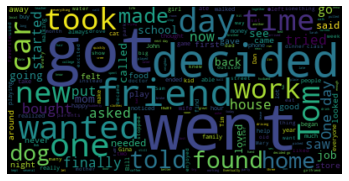

In [ ]:
common_words = ''
for i in df4.sentence:
    i = str(i)
    tokens = i.split()
    common_words += " ".join(tokens) + " "
wordcloud = WordCloud().generate(common_words)   
plt.imshow(wordcloud, interpolation = 'bilinear')  # bilinear is used to display smooth images
plt.axis('off')
plt.show()

In [ ]:
k = pd.Series(np.concatenate([x.split() for x in df4.sentence])).value_counts()
a = df4['sentence'].str.lower().str.cat(sep=' ')
words = nltk.tokenize.word_tokenize(a)
word_dist = nltk.FreqDist(words)
print (word_dist)
print(len(word_dist))
rslt = pd.DataFrame(word_dist.most_common(30),
                    columns=['Word', 'Frequency'])
print(rslt)

<FreqDist with 6628 samples and 79634 outcomes>
6628
       Word  Frequency
0         .       7605
1       the       3326
2        to       2962
3         a       2329
4        he       1920
5       was       1791
6       she       1635
7       and       1546
8       her       1217
9         ,       1104
10      his       1103
11        i        960
12       it        894
13       in        807
14       of        735
15      for        713
16      had        704
17       on        604
18     they        489
19       at        443
20       up        419
21     that        416
22     with        413
23       my        384
24     went        368
25      out        368
26      him        363
27      n't        352
28     when        341
29  decided        338


In [ ]:
print(df4.sentence.map(lambda x: len(x)).max())

71


In [ ]:
lengths = df4["sentence"].str.len()
argmax = np.where(lengths == lengths.max())[0]
df4.iloc[argmax].head(1)

,motiveworkerid,sentence,maslow,reiss,maslowLabel
26,ann0,My friend talked me into playing it even thoug...,esteem,[competition],0


##### Model BERT

https://www.section.io/engineering-education/classification-model-using-bert-and-tensorflow/

In [ ]:
!pip install -q -U "tensorflow-text==2.8.*"
!pip install -q tf-models-official==2.7.0

     |████████████████████████████████| 4.9 MB 5.0 MB/s 
     |████████████████████████████████| 1.8 MB 3.7 MB/s 
     |████████████████████████████████| 43 kB 1.6 MB/s 
     |████████████████████████████████| 238 kB 35.7 MB/s 
     |████████████████████████████████| 116 kB 48.5 MB/s 
     |████████████████████████████████| 1.2 MB 45.5 MB/s 
     |████████████████████████████████| 99 kB 7.0 MB/s 
     |████████████████████████████████| 48.3 MB 132 kB/s 
     |████████████████████████████████| 596 kB 41.9 MB/s 
     |████████████████████████████████| 352 kB 49.3 MB/s 
     |████████████████████████████████| 1.1 MB 48.3 MB/s 


In [ ]:
import os
import shutil
import tensorflow as tf
import tensorflow_hub as hub
import tensorflow_text as text
from official.nlp import optimization  # to create AdamW optimizer
import matplotlib.pyplot as plt
tf.get_logger().setLevel('ERROR')

In [ ]:
bert_preprocess = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_preprocess/3")
bert_encoder = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4")

KeyboardInterrupt: ignored

In [ ]:
text_input = tf.keras.layers.Input(shape=(), dtype=tf.string, name='text')
preprocessed_text = bert_preprocess(text_input)
outputs = bert_encoder(preprocessed_text)
l = tf.keras.layers.Dropout(0.1, name="dropout")(outputs['pooled_output'])
l = tf.keras.layers.Dense(6, activation='softmax', name="output")(l)

In [ ]:
model = tf.keras.Model(inputs=[text_input], outputs = [l])

In [ ]:
import keras
METRICS = [
      keras.metrics.TruePositives(name='tp'),
      keras.metrics.FalsePositives(name='fp'),
      keras.metrics.TrueNegatives(name='tn'),
      keras.metrics.FalseNegatives(name='fn'), 
      keras.metrics.CategoricalCrossentropy(name='categorical_cross_entropy'),
      keras.metrics.Precision(name='precision'),
      keras.metrics.Recall(name='recall'),
      keras.metrics.AUC(name='auc'),
      keras.metrics.AUC(name='prc', curve='PR'), # precision-recall curve
]

In [ ]:
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics='accuracy')

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(df4['sentence'],df4['maslowLabel'],test_size = 0.2, random_state = 0, stratify = df4['maslowLabel'])

In [ ]:
x_train_text = x_train 
x_test_text = x_test
y_train_text = y_train
y_test_text = y_test

In [ ]:
print(x_train.shape)
print(x_test.shape)

In [ ]:
print(x_train.shape)
print(x_test.shape)

In [ ]:
from tensorflow.keras.utils import to_categorical
y_train = to_categorical(y_train)
y_test =  to_categorical(y_test)

In [ ]:
checkpoint_filepath = '/tmp/checkpoint'
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True)

callback = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    min_delta=0,
    patience=5,
    verbose=0,
    mode='auto',
    baseline=None,
    restore_best_weights=False
)

# Model weights are saved at the end of every epoch, if it's the best seen
# so far.
history = model.fit(x_train, y_train,epochs=50, verbose=1, validation_data = (x_test,y_test),callbacks=[model_checkpoint_callback, callback])
#history = model.fit(x_train, y_train,epochs=10,verbose=1,validation_data = (x_test,y_test))   

In [ ]:
model.load_weights(checkpoint_filepath)
model.evaluate(x_test, y_test)

In [ ]:
print(history.history.keys())

In [ ]:
plt.plot(history.history['loss'], '-o', label='Train Loss')
plt.plot(history.history['val_loss'], '-o', label = 'Val Loss')
plt.legend()

In [ ]:
plt.plot(history.history['accuracy'], '-o', label='Train Accuracy')
plt.plot(history.history['val_accuracy'], '-o', label = 'Val Accuracy')
plt.legend()

##### Evaluation and Analysis

In [ ]:
y_pred = model.predict(x_test)

In [ ]:
y_pred[2]

In [ ]:
review_predictions = []
for prediction in y_pred:
    x = prediction
    review_predictions.append(np.argmax(x))

review_predictions = np.array(review_predictions)
review_predictions.reshape(1,-1)
review_predictions.shape

In [ ]:
review_predictions

In [ ]:
k = pd.DataFrame(review_predictions, columns = ['Label'])
k.groupby('Label')['Label'].count()

In [ ]:
type(y_test_text)

In [ ]:
r1 = sklearn.metrics.confusion_matrix(review_predictions, y_test_text)
print(r1)

In [ ]:
f = plt.figure()
f.set_figwidth(10)
f.set_figheight(5)
sns.heatmap(r1, annot=True, cmap = 'Blues')

In [ ]:
lb.classes_

In [ ]:
y_test_text

In [ ]:
text_label = pd.Series(lb.inverse_transform(y_test_text))
integer_label = pd.Series(y_test_text)

In [ ]:
integer_label = integer_label.reset_index(drop = True)
integer_label[0:20]

In [ ]:
text_label[0:20]

In [ ]:
def make_confusion_matrix(cf,group_names=None,categories='auto',count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    '''
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html
                   
    title:         Title for the heatmap. Default is None.
    '''


    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)
    
    if title:
        plt.title(title)

In [ ]:
print(uniqueClassesMaslowLabel)
print(uniqueClassesMaslow)

In [ ]:
make_confusion_matrix(r1, group_names=uniqueClassesMaslowLabel, categories=uniqueClassesMaslow, cmap='Blues')

In [ ]:
x_test_text = x_test_text.reset_index(drop = True)
x_test_text[0:5]

In [ ]:
print(uniqueClassesMaslowLabel)
print(uniqueClassesMaslow)

In [ ]:
y_test

In [ ]:
count = 0
for i in range(0,len(review_predictions)):
    if review_predictions[i] != 0 and integer_label[i] == 0 and count != 10:
        print(x_test_text[i])
        count = count + 1

#### One Vs All -> Physiological and ALL 

##### Cleaning the Data

In [ ]:
df1 = df.drop(columns = ['action','motivation'])

In [ ]:
def clean(string):
    res = string.strip('][').split(', ')
    lis = []
    for word in res:
        q = word.strip('][').split(', ')
        w = q[0].lstrip('\"')[:-1]
        if w == '' or w == 'na':
            lis.append('none')
        else:
            lis.append(w)
    string = lis
    for classes in lis:
        if classes not in uniqueClasses:
            uniqueClasses.append(classes)
    return string

In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['maslow'][i] = clean(df1['maslow'][i]);
uniqueClassesMaslow = uniqueClasses

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['reiss'][i] = clean(df1['reiss'][i]);
uniqueClassesReiss = uniqueClasses

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
df2 = df1
df3 = df2.explode('maslow')

In [ ]:
df3 = df3[df3['motiveworkerid'] != 'none']
df3 = df3[['motiveworkerid','sentence','maslow','reiss']]
df3 = df3.drop_duplicates(subset = ['sentence']).reset_index(drop = True)

In [ ]:
df3.head()

,motiveworkerid,sentence,maslow,reiss
0,ann0,I began making fish curry for my boyfriend and I.,physiological,[food]
1,ann0,I decided not to read a recipe since I've made...,spiritual growth,[indep]
2,ann0,I let the curry sit before tasting.,esteem,"[competition, approval, romance]"
3,ann0,"When it was time to taste, I was disgusted.",spiritual growth,[none]
4,ann0,I accidentally used a whole garlic instead of ...,none,[none]


In [ ]:
df3.maslow.unique()

array(['physiological', 'spiritual growth', 'esteem', 'none', 'love',
       'stability'], dtype=object)

In [ ]:
df3 = df3.replace(to_replace = ["esteem","spiritual growth",'love','stability'], value = "none")
df3.head()

,motiveworkerid,sentence,maslow,reiss
0,ann0,I began making fish curry for my boyfriend and I.,physiological,[food]
1,ann0,I decided not to read a recipe since I've made...,none,[indep]
2,ann0,I let the curry sit before tasting.,none,"[competition, approval, romance]"
3,ann0,"When it was time to taste, I was disgusted.",none,[none]
4,ann0,I accidentally used a whole garlic instead of ...,none,[none]


##### Cleaning the Data for NLP tasks

In [ ]:
df3.shape

(10670, 4)

(array([0, 1]), <a list of 2 Text major ticklabel objects>)

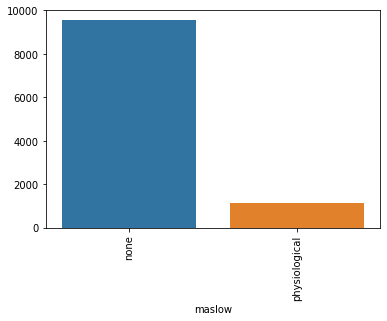

In [ ]:
c = df3.groupby('maslow')['maslow'].count()
sns.barplot(x = c.index, y = c.values)
plt.xticks(rotation = 90)

In [ ]:
df3[['sentence','maslow']].groupby('maslow').count()

,sentence
maslow,
none,9531
physiological,1139


In [ ]:
undersampling_count = df3[['sentence','maslow']].groupby('maslow').count().min()[0]
print(undersampling_count)
print(list(df3['maslow'].unique()))

1139
['physiological', 'none']


In [ ]:
# UNDERSAMPLING

dontSeeIndex = 0
from sklearn.utils import shuffle
lis = list(df3['maslow'].unique())
print(type(lis))
print(lis)
dataframes = []
for i in range(len(lis)):
    dataframe = 't' + str(i)
    dataframe = df3[df3['maslow'] == lis[i]]
    dataframe = dataframe.reset_index()
    dataframe = dataframe.drop(columns = 'index')
    if i!=dontSeeIndex:
        dataframe = shuffle(dataframe)
        dataframe = dataframe.iloc[:1139][:]
    dataframes.append(dataframe)
dataframes[0].head(1)

<class 'list'>
['physiological', 'none']


,motiveworkerid,sentence,maslow,reiss
0,ann0,I began making fish curry for my boyfriend and I.,physiological,[food]


In [ ]:
df3 = pd.concat(dataframes)
df3 = shuffle(df3)
df3 = df3.reset_index()
df3 = df3.drop(columns = 'index')
df3[['sentence','maslow']].groupby('maslow').count()

,sentence
maslow,
none,1139
physiological,1139


In [ ]:
lb = LabelEncoder() 
df3['maslowLabel'] = lb.fit_transform(df3['maslow'])

In [ ]:
print(df3['maslow'].unique())
print(df3['maslowLabel'].unique())

['none' 'physiological']
[0 1]


In [ ]:
uniqueClassesMaslow = list(df3['maslow'].unique())
uniqueClassesMaslowLabel = list(df3['maslowLabel'].unique())
print(uniqueClassesMaslowLabel)
print(uniqueClassesMaslow)

[0, 1]
['none', 'physiological']


In [ ]:
df4 = df3.copy()

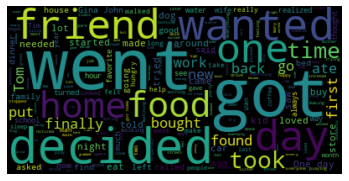

In [ ]:
common_words = ''
for i in df4.sentence:
    i = str(i)
    tokens = i.split()
    common_words += " ".join(tokens) + " "
wordcloud = WordCloud().generate(common_words)   
plt.imshow(wordcloud, interpolation = 'bilinear')  # bilinear is used to display smooth images
plt.axis('off')
plt.show()

In [ ]:
k = pd.Series(np.concatenate([x.split() for x in df4.sentence])).value_counts()
a = df4['sentence'].str.lower().str.cat(sep=' ')
words = nltk.tokenize.word_tokenize(a)
word_dist = nltk.FreqDist(words)
print (word_dist)
print(len(word_dist))
rslt = pd.DataFrame(word_dist.most_common(30),
                    columns=['Word', 'Frequency'])
print(rslt)

<FreqDist with 3324 samples and 22623 outcomes>
3324
       Word  Frequency
0         .       2209
1       the        957
2        to        840
3         a        640
4        he        557
5       was        532
6       she        489
7       and        429
8         ,        331
9       her        330
10      his        275
11       it        267
12        i        264
13       in        245
14       of        213
15      for        200
16      had        192
17       on        188
18     they        153
19       up        133
20       at        127
21      out        123
22     went        117
23     that        117
24  decided        113
25      got        111
26      day        107
27     when        102
28      one         99
29      n't         97


In [ ]:
print(df4.sentence.map(lambda x: len(x)).max())

71


In [ ]:
lengths = df4["sentence"].str.len()
argmax = np.where(lengths == lengths.max())[0]
df4.iloc[argmax].head(1)

,motiveworkerid,sentence,maslow,reiss,maslowLabel
86,ann0,Jon's day went by slow but he's finally headin...,physiological,[none],1


##### Model BERT

https://www.section.io/engineering-education/classification-model-using-bert-and-tensorflow/

In [ ]:
!pip install -q -U "tensorflow-text==2.8.*"
!pip install -q tf-models-official==2.7.0

In [ ]:
import os
import shutil
import tensorflow as tf
import tensorflow_hub as hub
import tensorflow_text as text
from official.nlp import optimization  # to create AdamW optimizer
import matplotlib.pyplot as plt
tf.get_logger().setLevel('ERROR')

In [ ]:
bert_preprocess = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_preprocess/3")
bert_encoder = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4")

In [ ]:
text_input = tf.keras.layers.Input(shape=(), dtype=tf.string, name='text')
preprocessed_text = bert_preprocess(text_input)
outputs = bert_encoder(preprocessed_text)
l = tf.keras.layers.Dropout(0.1, name="dropout")(outputs['pooled_output'])
l = tf.keras.layers.Dense(2, activation='softmax', name="output")(l)

In [ ]:
model = tf.keras.Model(inputs=[text_input], outputs = [l])

In [ ]:
import keras
METRICS = [
      keras.metrics.TruePositives(name='tp'),
      keras.metrics.FalsePositives(name='fp'),
      keras.metrics.TrueNegatives(name='tn'),
      keras.metrics.FalseNegatives(name='fn'), 
      keras.metrics.CategoricalCrossentropy(name='categorical_cross_entropy'),
      keras.metrics.Precision(name='precision'),
      keras.metrics.Recall(name='recall'),
      keras.metrics.AUC(name='auc'),
      keras.metrics.AUC(name='prc', curve='PR'), # precision-recall curve
]

In [ ]:
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics='accuracy')

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(df4['sentence'],df4['maslowLabel'],test_size = 0.2, random_state = 0, stratify = df4['maslowLabel'])

In [ ]:
x_train_text = x_train 
x_test_text = x_test
y_train_text = y_train
y_test_text = y_test

In [ ]:
print(x_train.shape)
print(x_test.shape)

(1822,)
(456,)


In [ ]:
print(x_train.shape)
print(x_test.shape)

(1822,)
(456,)


In [ ]:
from tensorflow.keras.utils import to_categorical
y_train = to_categorical(y_train)
y_test =  to_categorical(y_test)

In [ ]:
history = model.fit(x_train, y_train,epochs=10,verbose=1,validation_data = (x_test,y_test))   

Epoch 1/10
57/57 [==============================] - 34s 462ms/step - loss: 0.7339 - accuracy: 0.5143 - val_loss: 0.6883 - val_accuracy: 0.5307
Epoch 2/10
57/57 [==============================] - 25s 434ms/step - loss: 0.7038 - accuracy: 0.5401 - val_loss: 0.6844 - val_accuracy: 0.5285
Epoch 3/10
57/57 [==============================] - 24s 420ms/step - loss: 0.6885 - accuracy: 0.5554 - val_loss: 0.6655 - val_accuracy: 0.6009
Epoch 4/10
57/57 [==============================] - 24s 428ms/step - loss: 0.6826 - accuracy: 0.5670 - val_loss: 0.6501 - val_accuracy: 0.6338
Epoch 5/10
57/57 [==============================] - 25s 437ms/step - loss: 0.6771 - accuracy: 0.5895 - val_loss: 0.6580 - val_accuracy: 0.5965
Epoch 6/10
57/57 [==============================] - 25s 432ms/step - loss: 0.6852 - accuracy: 0.5823 - val_loss: 0.6396 - val_accuracy: 0.6447
Epoch 7/10
57/57 [==============================] - 24s 425ms/step - loss: 0.6616 - accuracy: 0.5950 - val_loss: 0.6400 - val_accuracy: 0.6404

In [ ]:
model.evaluate(x_test, y_test)

15/15 [==============================] - 5s 316ms/step - loss: 0.6158 - accuracy: 0.6886


[0.6158313155174255, 0.6885964870452881]

In [ ]:
print(history.history.keys())

dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])


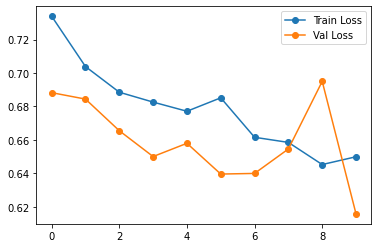

In [ ]:
plt.plot(history.history['loss'], '-o', label='Train Loss')
plt.plot(history.history['val_loss'], '-o', label = 'Val Loss')
plt.legend()

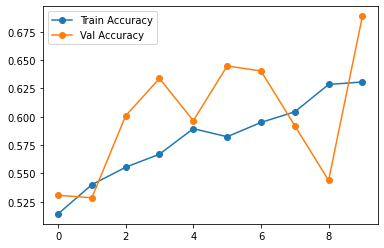

In [ ]:
plt.plot(history.history['accuracy'], '-o', label='Train Accuracy')
plt.plot(history.history['val_accuracy'], '-o', label = 'Val Accuracy')
plt.legend()

##### Evaluation and Analysis

In [ ]:
y_pred = model.predict(x_test)

In [ ]:
y_pred[2]

array([0.32647425, 0.67352575], dtype=float32)

In [ ]:
review_predictions = []
for prediction in y_pred:
    x = prediction
    review_predictions.append(np.argmax(x))

review_predictions = np.array(review_predictions)
review_predictions.reshape(1,-1)
review_predictions.shape

(456,)

In [ ]:
review_predictions

array([0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0,
       1, 0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 0,
       0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0,
       0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0,
       0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 1,
       1, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0,
       1, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 1, 0,
       0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 0, 0, 1,
       1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1,
       0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1,
       1, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1,
       0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0,

In [ ]:
k = pd.DataFrame(review_predictions, columns = ['Label'])
k.groupby('Label')['Label'].count()

Label
0    252
1    204
Name: Label, dtype: int64

In [ ]:
type(y_test_text)

pandas.core.series.Series

In [ ]:
r1 = sklearn.metrics.confusion_matrix(review_predictions, y_test_text)
print(r1)

[[169  83]
 [ 59 145]]


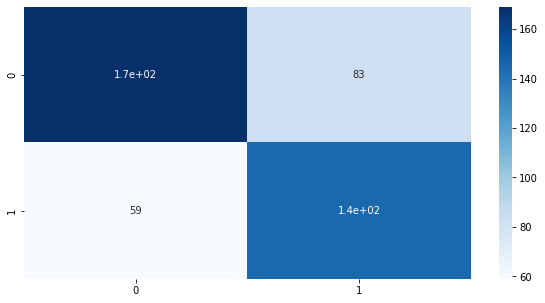

In [ ]:
f = plt.figure()
f.set_figwidth(10)
f.set_figheight(5)
sns.heatmap(r1, annot=True, cmap = 'Blues')

In [ ]:
lb.classes_

array(['none', 'physiological'], dtype=object)

In [ ]:
y_test_text

1472    0
1121    0
380     1
44      0
180     0
       ..
1667    0
1429    0
803     0
1649    0
1477    1
Name: maslowLabel, Length: 456, dtype: int64

In [ ]:
text_label = pd.Series(lb.inverse_transform(y_test_text))
integer_label = pd.Series(y_test_text)

In [ ]:
integer_label = integer_label.reset_index(drop = True)
integer_label[0:20]

0     0
1     0
2     1
3     0
4     0
5     1
6     1
7     1
8     0
9     0
10    1
11    1
12    1
13    0
14    0
15    1
16    1
17    0
18    0
19    0
Name: maslowLabel, dtype: int64

In [ ]:
text_label[0:20]

0              none
1              none
2     physiological
3              none
4              none
5     physiological
6     physiological
7     physiological
8              none
9              none
10    physiological
11    physiological
12    physiological
13             none
14             none
15    physiological
16    physiological
17             none
18             none
19             none
dtype: object

In [ ]:
def make_confusion_matrix(cf,group_names=None,categories='auto',count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    '''
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html
                   
    title:         Title for the heatmap. Default is None.
    '''


    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)
    
    if title:
        plt.title(title)

In [ ]:
print(uniqueClassesMaslowLabel)
print(uniqueClassesMaslow)

[0, 1]
['none', 'physiological']


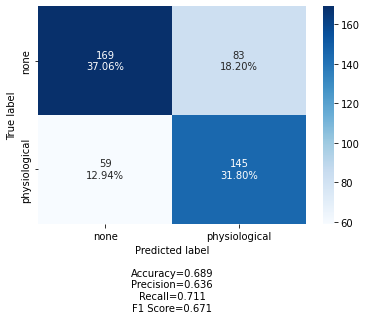

In [ ]:
make_confusion_matrix(r1, group_names=uniqueClassesMaslowLabel, categories=uniqueClassesMaslow, cmap='Blues')

In [ ]:
x_test_text = x_test_text.reset_index(drop = True)
x_test_text[0:5]

0                       Shawn is out shopping one day.
1    So Sam decided to quit playing tennis prematur...
2                       Sara then takes a cup to work.
3                   Jimmy couldn't wait to go fishing.
4    Jack was building a sand castle with turrets, ...
Name: sentence, dtype: object

In [ ]:
print(uniqueClassesMaslowLabel)
print(uniqueClassesMaslow)

[0, 1]
['none', 'physiological']


In [ ]:
y_test

array([[1., 0.],
       [1., 0.],
       [0., 1.],
       [1., 0.],
       [1., 0.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [1., 0.],
       [1., 0.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [1., 0.],
       [1., 0.],
       [0., 1.],
       [0., 1.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [0., 1.],
       [1., 0.],
       [1., 0.],
       [0., 1.],
       [1., 0.],
       [0., 1.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [0., 1.],
       [1., 0.],
       [1., 0.],
       [0., 1.],
       [1., 0.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [0., 1.],
       [0., 1.],
       [0., 1.],
       [1., 0.],
       [0., 1.],
       [1., 0.],
       [1., 0.],
       [0., 1.],
       [1., 0.],
       [0., 1.],
       [1., 0.],
       [1., 0.],
       [1., 0.],
       [0., 1.],
       [0., 1.],
       [1., 0.

In [ ]:
count = 0
for i in range(0,len(review_predictions)):
    if review_predictions[i] != 0 and integer_label[i] == 0 and count != 10:
        print(x_test_text[i])
        count = count + 1

Jimmy couldn't wait to go fishing.
Wade's trash was still sitting in the garage.
Simon leaned down to pick up a compact disk from the floor.
Sam was angry that Beth forgot to buy him beer.
Agnes rescheduled her appointment for the following day.
It took us three days to climb the mountain.
Tom saw previews for a movie.
I needed to start my homework.
He decided to go for a run to tire himself out.
It was the best cake she ever tasted.


#### One Vs All -> Stability and ALL

##### Cleaning the Data

In [ ]:
df1 = df.drop(columns = ['action','motivation'])

In [ ]:
def clean(string):
    res = string.strip('][').split(', ')
    lis = []
    for word in res:
        q = word.strip('][').split(', ')
        w = q[0].lstrip('\"')[:-1]
        if w == '' or w == 'na':
            lis.append('none')
        else:
            lis.append(w)
    string = lis
    for classes in lis:
        if classes not in uniqueClasses:
            uniqueClasses.append(classes)
    return string

In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['maslow'][i] = clean(df1['maslow'][i]);
uniqueClassesMaslow = uniqueClasses

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['reiss'][i] = clean(df1['reiss'][i]);
uniqueClassesReiss = uniqueClasses

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
df2 = df1
df3 = df2.explode('maslow')

In [ ]:
df3 = df3[df3['motiveworkerid'] != 'none']
df3 = df3[['motiveworkerid','sentence','maslow','reiss']]
df3 = df3.drop_duplicates(subset = ['sentence']).reset_index(drop = True)

In [ ]:
df3.head()

,motiveworkerid,sentence,maslow,reiss
0,ann0,I began making fish curry for my boyfriend and I.,physiological,[food]
1,ann0,I decided not to read a recipe since I've made...,spiritual growth,[indep]
2,ann0,I let the curry sit before tasting.,esteem,"[competition, approval, romance]"
3,ann0,"When it was time to taste, I was disgusted.",spiritual growth,[none]
4,ann0,I accidentally used a whole garlic instead of ...,none,[none]


In [ ]:
df3.maslow.unique()

array(['physiological', 'spiritual growth', 'esteem', 'none', 'love',
       'stability'], dtype=object)

In [ ]:
df3 = df3.replace(to_replace = ["esteem","spiritual growth",'love','physiological'], value = "none")
df3.head()

,motiveworkerid,sentence,maslow,reiss
0,ann0,I began making fish curry for my boyfriend and I.,none,[food]
1,ann0,I decided not to read a recipe since I've made...,none,[indep]
2,ann0,I let the curry sit before tasting.,none,"[competition, approval, romance]"
3,ann0,"When it was time to taste, I was disgusted.",none,[none]
4,ann0,I accidentally used a whole garlic instead of ...,none,[none]


##### Cleaning the Data for NLP tasks

In [ ]:
df3.shape

(10670, 4)

(array([0, 1]), <a list of 2 Text major ticklabel objects>)

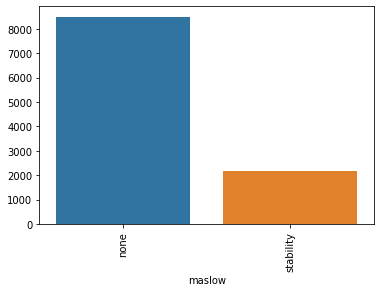

In [ ]:
c = df3.groupby('maslow')['maslow'].count()
sns.barplot(x = c.index, y = c.values)
plt.xticks(rotation = 90)

In [ ]:
df3[['sentence','maslow']].groupby('maslow').count()

,sentence
maslow,
none,8496
stability,2174


In [ ]:
undersampling_count = df3[['sentence','maslow']].groupby('maslow').count().min()[0]
print(undersampling_count)
lis = list(df3['maslow'].unique())
print(lis)

2174
['none', 'stability']


In [ ]:
# UNDERSAMPLING
dontSeeIndex = 1
from sklearn.utils import shuffle
print(type(lis))
print(lis)
dataframes = []
for i in range(len(lis)):
    dataframe = 't' + str(i)
    dataframe = df3[df3['maslow'] == lis[i]]
    dataframe = dataframe.reset_index()
    dataframe = dataframe.drop(columns = 'index')
    if i!=dontSeeIndex:
        dataframe = shuffle(dataframe)
        dataframe = dataframe.iloc[:2174][:]
    dataframes.append(dataframe)
dataframes[0].head(1)

<class 'list'>
['none', 'stability']


,motiveworkerid,sentence,maslow,reiss
3315,ann0,Anna was a German who lived during the 1940s.,none,[none]


In [ ]:
df3 = pd.concat(dataframes)
df3 = shuffle(df3)
df3 = df3.reset_index()
df3 = df3.drop(columns = 'index')
df3[['sentence','maslow']].groupby('maslow').count()

,sentence
maslow,
none,2174
stability,2174


In [ ]:
lb = LabelEncoder() 
df3['maslowLabel'] = lb.fit_transform(df3['maslow'])

In [ ]:
print(df3['maslow'].unique())
print(df3['maslowLabel'].unique())

['none' 'stability']
[0 1]


In [ ]:
uniqueClassesMaslow = list(df3['maslow'].unique())
uniqueClassesMaslowLabel = list(df3['maslowLabel'].unique())
print(uniqueClassesMaslowLabel)
print(uniqueClassesMaslow)

[0, 1]
['none', 'stability']


In [ ]:
df4 = df3.copy()

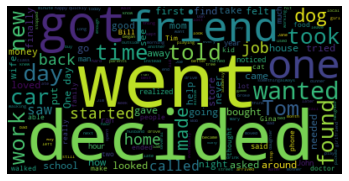

In [ ]:
common_words = ''
for i in df4.sentence:
    i = str(i)
    tokens = i.split()
    common_words += " ".join(tokens) + " "
wordcloud = WordCloud().generate(common_words)   
plt.imshow(wordcloud, interpolation = 'bilinear')  # bilinear is used to display smooth images
plt.axis('off')
plt.show()

In [ ]:
k = pd.Series(np.concatenate([x.split() for x in df4.sentence])).value_counts()
a = df4['sentence'].str.lower().str.cat(sep=' ')
words = nltk.tokenize.word_tokenize(a)
word_dist = nltk.FreqDist(words)
print (word_dist)
print(len(word_dist))
rslt = pd.DataFrame(word_dist.most_common(30),
                    columns=['Word', 'Frequency'])
print(rslt)

<FreqDist with 4987 samples and 44334 outcomes>
4987
       Word  Frequency
0         .       4207
1       the       1837
2        to       1654
3         a       1260
4        he       1110
5       was        964
6       she        916
7       and        866
8       her        665
9       his        617
10        ,        615
11        i        560
12       it        508
13       in        444
14       of        412
15      for        411
16      had        371
17       on        334
18     they        265
19       at        249
20       up        241
21     that        231
22       my        230
23     with        227
24      out        217
25  decided        209
26      him        207
27      n't        203
28       's        200
29      but        199


In [ ]:
print(df4.sentence.map(lambda x: len(x)).max())

72


In [ ]:
lengths = df4["sentence"].str.len()
argmax = np.where(lengths == lengths.max())[0]
df4.iloc[argmax].head(1)

,motiveworkerid,sentence,maslow,reiss,maslowLabel
2639,ann0,Everyone in Victor's life gave him a really ha...,none,[none],0


##### Model BERT

https://www.section.io/engineering-education/classification-model-using-bert-and-tensorflow/

In [ ]:
!pip install -q -U "tensorflow-text==2.8.*"
!pip install -q tf-models-official==2.7.0

In [ ]:
import os
import shutil
import tensorflow as tf
import tensorflow_hub as hub
import tensorflow_text as text
from official.nlp import optimization  # to create AdamW optimizer
import matplotlib.pyplot as plt
tf.get_logger().setLevel('ERROR')

In [ ]:
bert_preprocess = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_preprocess/3")
bert_encoder = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4")

In [ ]:
text_input = tf.keras.layers.Input(shape=(), dtype=tf.string, name='text')
preprocessed_text = bert_preprocess(text_input)
outputs = bert_encoder(preprocessed_text)
l = tf.keras.layers.Dropout(0.1, name="dropout")(outputs['pooled_output'])
l = tf.keras.layers.Dense(2, activation='softmax', name="output")(l)

In [ ]:
model = tf.keras.Model(inputs=[text_input], outputs = [l])

In [ ]:
import keras
METRICS = [
      keras.metrics.TruePositives(name='tp'),
      keras.metrics.FalsePositives(name='fp'),
      keras.metrics.TrueNegatives(name='tn'),
      keras.metrics.FalseNegatives(name='fn'), 
      keras.metrics.CategoricalCrossentropy(name='categorical_cross_entropy'),
      keras.metrics.Precision(name='precision'),
      keras.metrics.Recall(name='recall'),
      keras.metrics.AUC(name='auc'),
      keras.metrics.AUC(name='prc', curve='PR'), # precision-recall curve
]

In [ ]:
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics='accuracy')

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(df4['sentence'],df4['maslowLabel'],test_size = 0.2, random_state = 0, stratify = df4['maslowLabel'])

In [ ]:
x_train_text = x_train 
x_test_text = x_test
y_train_text = y_train
y_test_text = y_test

In [ ]:
print(x_train.shape)
print(x_test.shape)

(3478,)
(870,)


In [ ]:
print(x_train.shape)
print(x_test.shape)

(3478,)
(870,)


In [ ]:
from tensorflow.keras.utils import to_categorical
y_train = to_categorical(y_train)
y_test =  to_categorical(y_test)

In [ ]:
history = model.fit(x_train, y_train,epochs=10,verbose=1,validation_data = (x_test,y_test))   

Epoch 1/10
109/109 [==============================] - 66s 470ms/step - loss: 0.7299 - accuracy: 0.5224 - val_loss: 0.6797 - val_accuracy: 0.5552
Epoch 2/10
109/109 [==============================] - 47s 435ms/step - loss: 0.6975 - accuracy: 0.5474 - val_loss: 0.6914 - val_accuracy: 0.5448
Epoch 3/10
109/109 [==============================] - 48s 443ms/step - loss: 0.6893 - accuracy: 0.5719 - val_loss: 0.6924 - val_accuracy: 0.5253
Epoch 4/10
109/109 [==============================] - 46s 426ms/step - loss: 0.6961 - accuracy: 0.5604 - val_loss: 0.6552 - val_accuracy: 0.6356
Epoch 5/10
109/109 [==============================] - 48s 439ms/step - loss: 0.6756 - accuracy: 0.5785 - val_loss: 0.6535 - val_accuracy: 0.6402
Epoch 6/10
109/109 [==============================] - 47s 429ms/step - loss: 0.6836 - accuracy: 0.5768 - val_loss: 0.6560 - val_accuracy: 0.6149
Epoch 7/10
109/109 [==============================] - 47s 431ms/step - loss: 0.6784 - accuracy: 0.5742 - val_loss: 0.6803 - val_ac

In [ ]:
model.evaluate(x_test, y_test)

28/28 [==============================] - 9s 334ms/step - loss: 0.6573 - accuracy: 0.5920


[0.6572766304016113, 0.5919540524482727]

In [ ]:
print(history.history.keys())

dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])


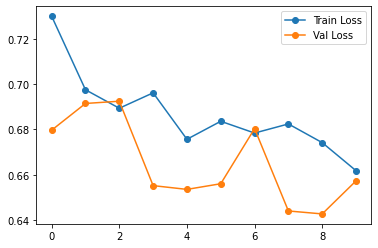

In [ ]:
plt.plot(history.history['loss'], '-o', label='Train Loss')
plt.plot(history.history['val_loss'], '-o', label = 'Val Loss')
plt.legend()

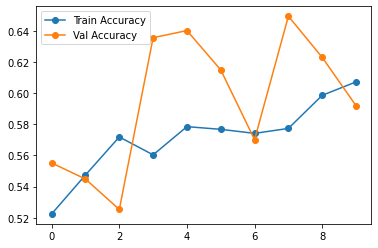

In [ ]:
plt.plot(history.history['accuracy'], '-o', label='Train Accuracy')
plt.plot(history.history['val_accuracy'], '-o', label = 'Val Accuracy')
plt.legend()

##### Evaluation and Analysis

In [ ]:
y_pred = model.predict(x_test)

In [ ]:
y_pred[2]

array([0.47654483, 0.5234552 ], dtype=float32)

In [ ]:
review_predictions = []
for prediction in y_pred:
    x = prediction
    review_predictions.append(np.argmax(x))

review_predictions = np.array(review_predictions)
review_predictions.reshape(1,-1)
review_predictions.shape

(870,)

In [ ]:
review_predictions

array([0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1,
       1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1,
       0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0,
       1, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1,
       1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1,
       1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1,
       0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1,
       0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1,
       1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1,

In [ ]:
k = pd.DataFrame(review_predictions, columns = ['Label'])
k.groupby('Label')['Label'].count()

Label
0    166
1    704
Name: Label, dtype: int64

In [ ]:
type(y_test_text)

pandas.core.series.Series

In [ ]:
r1 = sklearn.metrics.confusion_matrix(review_predictions, y_test_text)
print(r1)

[[123  43]
 [312 392]]


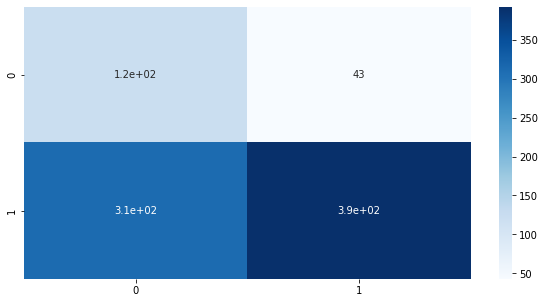

In [ ]:
f = plt.figure()
f.set_figwidth(10)
f.set_figheight(5)
sns.heatmap(r1, annot=True, cmap = 'Blues')

In [ ]:
lb.classes_

array(['none', 'stability'], dtype=object)

In [ ]:
y_test_text

1742    0
2172    1
2167    1
3884    0
3726    1
       ..
1892    1
1766    0
4004    1
141     0
3771    0
Name: maslowLabel, Length: 870, dtype: int64

In [ ]:
text_label = pd.Series(lb.inverse_transform(y_test_text))
integer_label = pd.Series(y_test_text)

In [ ]:
integer_label = integer_label.reset_index(drop = True)
integer_label[0:20]

0     0
1     1
2     1
3     0
4     1
5     0
6     0
7     1
8     1
9     1
10    1
11    0
12    0
13    1
14    1
15    1
16    1
17    1
18    0
19    0
Name: maslowLabel, dtype: int64

In [ ]:
text_label[0:20]

0          none
1     stability
2     stability
3          none
4     stability
5          none
6          none
7     stability
8     stability
9     stability
10    stability
11         none
12         none
13    stability
14    stability
15    stability
16    stability
17    stability
18         none
19         none
dtype: object

In [ ]:
def make_confusion_matrix(cf,group_names=None,categories='auto',count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    '''
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html
                   
    title:         Title for the heatmap. Default is None.
    '''


    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)
    
    if title:
        plt.title(title)

In [ ]:
print(uniqueClassesMaslowLabel)
print(uniqueClassesMaslow)

[0, 1]
['none', 'stability']


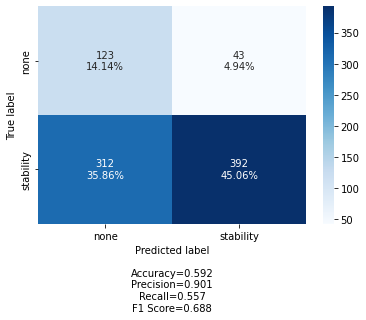

In [ ]:
make_confusion_matrix(r1, group_names=uniqueClassesMaslowLabel, categories=uniqueClassesMaslow, cmap='Blues')

In [ ]:
x_test_text = x_test_text.reset_index(drop = True)
x_test_text[0:5]

0    frank told Randy he was shy as well and wanted...
1    When she was moving towards one, another car c...
2                        Cullen was expecting to lose.
3    They took it to their history teacher to find ...
4    It wasn't until she decided to do so anyway th...
Name: sentence, dtype: object

In [ ]:
print(uniqueClassesMaslowLabel)
print(uniqueClassesMaslow)

[0, 1]
['none', 'stability']


In [ ]:
y_test

array([[1., 0.],
       [0., 1.],
       [0., 1.],
       ...,
       [0., 1.],
       [1., 0.],
       [1., 0.]], dtype=float32)

In [ ]:
count = 0
for i in range(0,len(review_predictions)):
    if review_predictions[i] != 0 and integer_label[i] == 0 and count != 10:
        print(x_test_text[i])
        count = count + 1

They took it to their history teacher to find out.
Bob bought an oil change business on a busy highway.
Her parents said that she needed to pass her English test first.
Kim was grocery shopping.
Bert Johnson was miles away from home when it started snowing.
They agreed to a truce and began to train together for the race.
He bought the ticket through a proxy.
The new bus had fresh ice cold water, the family drank some quickly.
Therefore, he received a lower haircut.
When they arrived at the restaurant it was really busy.


#### All Classes Reiss

##### Cleaning the Data

In [ ]:
df1 = df.drop(columns = ['action','motivation'])

In [ ]:
def clean(string):
    res = string.strip('][').split(', ')
    lis = []
    for word in res:
        q = word.strip('][').split(', ')
        w = q[0].lstrip('\"')[:-1]
        if w == '' or w == 'na':
            lis.append('none')
        else:
            lis.append(w)
    string = lis
    for classes in lis:
        if classes not in uniqueClasses:
            uniqueClasses.append(classes)
    return string

In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['maslow'][i] = clean(df1['maslow'][i]);
uniqueClassesMaslow = uniqueClasses

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['reiss'][i] = clean(df1['reiss'][i]);
uniqueClassesReiss = uniqueClasses

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
df2 = df1
df3 = df2.explode('reiss')

In [ ]:
df3 = df3[df3['motiveworkerid'] != 'none']
df3 = df3[['motiveworkerid','sentence','maslow','reiss']]
df3 = df3.drop_duplicates(subset = ['sentence']).reset_index(drop = True)

In [ ]:
df3.head()

,motiveworkerid,sentence,maslow,reiss
0,ann0,I began making fish curry for my boyfriend and I.,[physiological],food
1,ann0,I decided not to read a recipe since I've made...,[spiritual growth],indep
2,ann0,I let the curry sit before tasting.,"[esteem, love]",competition
3,ann0,"When it was time to taste, I was disgusted.",[spiritual growth],none
4,ann0,I accidentally used a whole garlic instead of ...,[none],none


In [ ]:
'''
from sklearn.utils import shuffle
k1 = df3[df3['maslow'] == 'none'] 
k2 = df3[df3['maslow'] == 'physiological']
df3 = pd.concat([k1,k2],axis = 0)
df3 = shuffle(df3)
df3 = df3.reset_index()
df3 = df3.drop(columns = 'index')
'''

"\nfrom sklearn.utils import shuffle\nk1 = df3[df3['maslow'] == 'none'] \nk2 = df3[df3['maslow'] == 'physiological']\ndf3 = pd.concat([k1,k2],axis = 0)\ndf3 = shuffle(df3)\ndf3 = df3.reset_index()\ndf3 = df3.drop(columns = 'index')\n"

##### Cleaning the Data for NLP tasks

In [ ]:
df3.shape

(10670, 4)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19]), <a list of 20 Text major ticklabel objects>)

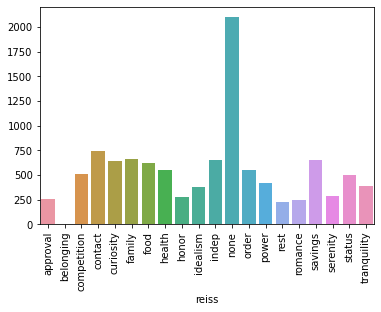

In [ ]:
c = df3.groupby('reiss')['reiss'].count()
sns.barplot(x = c.index, y = c.values)
plt.xticks(rotation = 90)

In [ ]:
df3 = df3[df3['reiss']!='belonging']
df3[['sentence','reiss']].groupby('reiss').count()

,sentence
reiss,
approval,255
competition,510
contact,744
curiosity,639
family,661
food,627
health,548
honor,279
idealism,380


In [ ]:
undersampling_count = df3[['sentence','reiss']].groupby('reiss').count().min()[0]
print(undersampling_count)
lis = list(df3['reiss'].unique())
print(lis)

229
['food', 'indep', 'competition', 'none', 'romance', 'contact', 'serenity', 'rest', 'status', 'approval', 'curiosity', 'savings', 'tranquility', 'health', 'idealism', 'power', 'order', 'honor', 'family']


In [ ]:
lis[16]

'order'

In [ ]:
# UNDERSAMPLING

dontSeeIndex = 16
from sklearn.utils import shuffle
lis = list(df3['reiss'].unique())
print(type(lis))
print(lis)
dataframes = []
for i in range(len(lis)):
    dataframe = 't' + str(i)
    dataframe = df3[df3['reiss'] == lis[i]]
    dataframe = dataframe.reset_index()
    dataframe = dataframe.drop(columns = 'index')
    if i!=dontSeeIndex:
        dataframe = shuffle(dataframe)
        dataframe = dataframe.iloc[:229][:]
    dataframes.append(dataframe)
dataframes[0].head(1)
dataframes[5].head(1)

<class 'list'>
['food', 'indep', 'competition', 'none', 'romance', 'contact', 'serenity', 'rest', 'status', 'approval', 'curiosity', 'savings', 'tranquility', 'health', 'idealism', 'power', 'order', 'honor', 'family']


,motiveworkerid,sentence,maslow,reiss
675,ann0,Sonya blocked it and no one ever messed with h...,[love],contact


In [ ]:
df3 = pd.concat(dataframes)
df3 = shuffle(df3)
df3 = df3.reset_index()
df3 = df3.drop(columns = 'index')
df3[['sentence','reiss']].groupby('reiss').count()

,sentence
reiss,
approval,229
competition,229
contact,229
curiosity,229
family,229
food,229
health,229
honor,229
idealism,229


In [ ]:
lb = LabelEncoder() 
df3['reissLabel'] = lb.fit_transform(df3['reiss'])

In [ ]:
print(df3['reiss'].unique())
print(df3['reissLabel'].unique())

['contact' 'food' 'order' 'power' 'rest' 'competition' 'serenity'
 'savings' 'status' 'none' 'family' 'indep' 'idealism' 'romance'
 'approval' 'honor' 'health' 'tranquility' 'curiosity']
[ 2  5 11 12 13  1 16 15 17 10  4  9  8 14  0  7  6 18  3]


In [ ]:
uniqueClassesReiss = list(df3['reiss'].unique())
uniqueClassesReissLabel = list(df3['reissLabel'].unique())
print(uniqueClassesReissLabel)
print(uniqueClassesReiss)

[2, 5, 11, 12, 13, 1, 16, 15, 17, 10, 4, 9, 8, 14, 0, 7, 6, 18, 3]
['contact', 'food', 'order', 'power', 'rest', 'competition', 'serenity', 'savings', 'status', 'none', 'family', 'indep', 'idealism', 'romance', 'approval', 'honor', 'health', 'tranquility', 'curiosity']


In [ ]:
df4 = df3.copy()

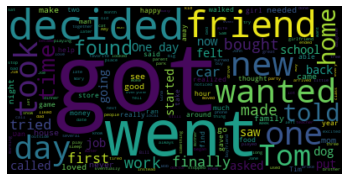

In [ ]:
common_words = ''
for i in df4.sentence:
    i = str(i)
    tokens = i.split()
    common_words += " ".join(tokens) + " "
wordcloud = WordCloud().generate(common_words)   
plt.imshow(wordcloud, interpolation = 'bilinear')  # bilinear is used to display smooth images
plt.axis('off')
plt.show()

In [ ]:
k = pd.Series(np.concatenate([x.split() for x in df4.sentence])).value_counts()
a = df4['sentence'].str.lower().str.cat(sep=' ')
words = nltk.tokenize.word_tokenize(a)
word_dist = nltk.FreqDist(words)
print (word_dist)
print(len(word_dist))
rslt = pd.DataFrame(word_dist.most_common(30),
                    columns=['Word', 'Frequency'])
print(rslt)

<FreqDist with 5180 samples and 47430 outcomes>
5180
       Word  Frequency
0         .       4515
1       the       1958
2        to       1801
3         a       1310
4        he       1164
5       was       1102
6       she        994
7       and        929
8       her        750
9         ,        693
10      his        651
11        i        603
12       it        526
13       in        468
14      for        431
15       of        420
16      had        404
17       on        371
18     they        300
19       at        263
20       up        250
21      out        242
22     with        242
23     that        231
24       my        228
25      him        224
26      n't        211
27  decided        209
28     when        208
29     went        206


In [ ]:
print(df4.sentence.map(lambda x: len(x)).max())

72


In [ ]:
lengths = df4["sentence"].str.len()
argmax = np.where(lengths == lengths.max())[0]
df4.iloc[argmax].head(1)

,motiveworkerid,sentence,maslow,reiss,reissLabel
4398,ann0,"Just then, Bethany walked in and told him it w...",[esteem],status,17


##### Model BERT

https://www.section.io/engineering-education/classification-model-using-bert-and-tensorflow/

In [ ]:
!pip install -q -U "tensorflow-text==2.8.*"
!pip install -q tf-models-official==2.7.0

     |████████████████████████████████| 4.9 MB 4.7 MB/s 
     |████████████████████████████████| 1.8 MB 4.6 MB/s 
     |████████████████████████████████| 352 kB 74.4 MB/s 
     |████████████████████████████████| 596 kB 63.4 MB/s 
     |████████████████████████████████| 238 kB 73.7 MB/s 
     |████████████████████████████████| 99 kB 10.5 MB/s 
     |████████████████████████████████| 1.1 MB 50.5 MB/s 
     |████████████████████████████████| 1.2 MB 54.1 MB/s 
     |████████████████████████████████| 116 kB 73.0 MB/s 
     |████████████████████████████████| 48.3 MB 66.1 MB/s 
     |████████████████████████████████| 43 kB 2.4 MB/s 


In [ ]:
import os
import shutil
import tensorflow as tf
import tensorflow_hub as hub
import tensorflow_text as text
from official.nlp import optimization  # to create AdamW optimizer
import matplotlib.pyplot as plt
tf.get_logger().setLevel('ERROR')

In [ ]:
bert_preprocess = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_preprocess/3")
bert_encoder = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4")

In [ ]:
text_input = tf.keras.layers.Input(shape=(), dtype=tf.string, name='text')
preprocessed_text = bert_preprocess(text_input)
outputs = bert_encoder(preprocessed_text)
l = tf.keras.layers.Dropout(0.1, name="dropout")(outputs['pooled_output'])
l = tf.keras.layers.Dense(19, activation='softmax', name="output")(l)

In [ ]:
model = tf.keras.Model(inputs=[text_input], outputs = [l])

In [ ]:
import keras
METRICS = [
      keras.metrics.TruePositives(name='tp'),
      keras.metrics.FalsePositives(name='fp'),
      keras.metrics.TrueNegatives(name='tn'),
      keras.metrics.FalseNegatives(name='fn'), 
      keras.metrics.CategoricalCrossentropy(name='categorical_cross_entropy'),
      keras.metrics.Precision(name='precision'),
      keras.metrics.Recall(name='recall'),
      keras.metrics.AUC(name='auc'),
      keras.metrics.AUC(name='prc', curve='PR'), # precision-recall curve
]

In [ ]:
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics='accuracy')

In [ ]:
x_train, x_test, y_train, y_test = train_test_split(df4['sentence'],df4['reissLabel'],test_size = 0.2, random_state = 0, stratify = df4['reissLabel'])

In [ ]:
x_train_text = x_train 
x_test_text = x_test
y_train_text = y_train
y_test_text = y_test

In [ ]:
print(x_train.shape)
print(x_test.shape)

(3738,)
(935,)


In [ ]:
print(x_train.shape)
print(x_test.shape)

(3738,)
(935,)


In [ ]:
from tensorflow.keras.utils import to_categorical
y_train = to_categorical(y_train)
y_test =  to_categorical(y_test)

In [ ]:
checkpoint_filepath = '/tmp/checkpoint'
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True)

callback = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    min_delta=0,
    patience=5,
    verbose=0,
    mode='auto',
    baseline=None,
    restore_best_weights=False
)

# Model weights are saved at the end of every epoch, if it's the best seen
# so far.
history = model.fit(x_train, y_train,epochs=50, verbose=1, validation_data = (x_test,y_test),callbacks=[model_checkpoint_callback, callback])
#history = model.fit(x_train, y_train,epochs=10,verbose=1,validation_data = (x_test,y_test))   

Epoch 1/50
117/117 [==============================] - 51s 438ms/step - loss: 2.9676 - accuracy: 0.0987 - val_loss: 2.9234 - val_accuracy: 0.1219
Epoch 2/50
117/117 [==============================] - 47s 401ms/step - loss: 2.9467 - accuracy: 0.1030 - val_loss: 2.8897 - val_accuracy: 0.1176
Epoch 3/50
117/117 [==============================] - 47s 403ms/step - loss: 2.9059 - accuracy: 0.1180 - val_loss: 2.8907 - val_accuracy: 0.1219
Epoch 4/50
117/117 [==============================] - 49s 416ms/step - loss: 2.8792 - accuracy: 0.1174 - val_loss: 2.8560 - val_accuracy: 0.1230
Epoch 5/50
117/117 [==============================] - 49s 420ms/step - loss: 2.8492 - accuracy: 0.1335 - val_loss: 2.8883 - val_accuracy: 0.1273
Epoch 6/50
117/117 [==============================] - 49s 416ms/step - loss: 2.8394 - accuracy: 0.1263 - val_loss: 2.8258 - val_accuracy: 0.1455
Epoch 7/50
117/117 [==============================] - 47s 402ms/step - loss: 2.8240 - accuracy: 0.1396 - val_loss: 2.8326 - val_ac

In [ ]:
model.load_weights(checkpoint_filepath)
model.evaluate(x_test, y_test)

30/30 [==============================] - 10s 337ms/step - loss: 2.7070 - accuracy: 0.2000


[2.706963062286377, 0.20000000298023224]

In [ ]:
print(history.history.keys())

dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])


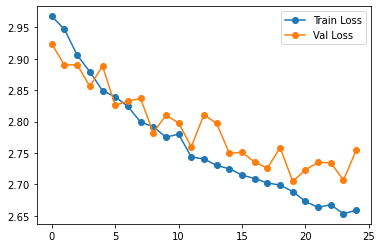

In [ ]:
plt.plot(history.history['loss'], '-o', label='Train Loss')
plt.plot(history.history['val_loss'], '-o', label = 'Val Loss')
plt.legend()

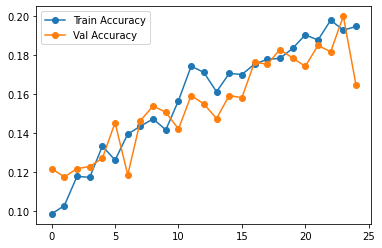

In [ ]:
plt.plot(history.history['accuracy'], '-o', label='Train Accuracy')
plt.plot(history.history['val_accuracy'], '-o', label = 'Val Accuracy')
plt.legend()

##### Evaluation and Analysis

In [ ]:
y_pred = model.predict(x_test)

In [ ]:
y_pred[2]

array([0.03629725, 0.20766877, 0.02573187, 0.0547201 , 0.02611773,
       0.00873184, 0.05137726, 0.03466963, 0.02047459, 0.06439573,
       0.04016173, 0.09863585, 0.05895555, 0.02556933, 0.01694024,
       0.03897963, 0.08543685, 0.05447096, 0.05066517], dtype=float32)

In [ ]:
review_predictions = []
for prediction in y_pred:
    x = prediction
    review_predictions.append(np.argmax(x))

review_predictions = np.array(review_predictions)
review_predictions.reshape(1,-1)
review_predictions.shape

(935,)

In [ ]:
review_predictions

array([ 1, 11,  1,  0, 11,  1, 18, 13, 11, 11, 11, 16, 11, 11,  1,  9,  1,
        1,  5, 11,  0, 11,  5, 11, 11, 11, 11, 11,  4, 11,  1,  1,  5,  6,
        4, 14,  1,  1,  1,  5,  4, 11,  9, 11,  5,  5, 16, 11,  4,  6,  9,
       11,  1, 11,  5, 11,  1, 11, 11, 11, 11, 16,  9,  1, 16, 11, 11,  1,
        4,  9, 11,  4,  4, 11,  1, 11, 13,  1, 11, 15, 14, 11,  1, 11, 13,
       11, 11, 14, 11, 18,  1,  4, 11, 14, 16,  1,  6, 11, 11, 14, 14,  6,
       11, 14, 11, 11,  4,  4, 11, 18, 11, 11,  1,  6,  1, 11,  1, 11,  3,
       11, 11,  4,  9,  1,  1, 13, 13,  5, 11, 11,  6, 18,  6, 18, 11,  6,
       14,  6, 11, 11, 11, 11,  4, 11, 11,  5, 18, 14, 16, 16,  6,  6, 11,
        6, 11,  1, 11,  1, 11, 11,  6,  4,  1, 14, 11,  0,  1,  9,  6,  4,
       11, 11,  1, 16,  1,  4, 18, 16, 14,  1,  4, 11, 13,  9, 11,  4, 11,
        1, 11, 11,  6, 18, 11, 16,  1, 11, 11,  1, 11,  2,  1, 14, 18,  9,
       11,  4,  9, 14, 11, 11,  1,  4, 11,  4, 13, 11, 11,  6,  4, 11, 11,
        4, 11, 11, 11, 15

In [ ]:
k = pd.DataFrame(review_predictions, columns = ['Label'])
k.groupby('Label')['Label'].count()

Label
0       7
1     143
2       4
3       5
4      69
5      46
6      46
7       1
9      44
11    400
13     15
14     58
15      7
16     39
18     51
Name: Label, dtype: int64

In [ ]:
type(y_test_text)

pandas.core.series.Series

In [ ]:
r1 = sklearn.metrics.confusion_matrix(review_predictions, y_test_text)
print(r1)

[[ 0  0  1  1  1  0  0  1  1  0  0  0  1  0  0  0  0  1  0]
 [ 9 24  3  7  2  2  3 13  6 12  5  8 17  0  5  8  6  8  5]
 [ 0  0  1  0  0  1  0  0  0  0  0  0  0  0  0  0  1  1  0]
 [ 1  0  0  0  1  0  0  0  1  0  0  0  0  0  1  0  0  1  0]
 [ 4  1 11  0 15  2  2  2  4  3  4  3  2  3  3  3  1  4  2]
 [ 0  1  2  1  5 15  5  1  1  0  0  3  1  4  0  2  1  0  4]
 [ 0  3  1  3  1  0  7  3  2  1  2  7  1  5  2  4  1  2  1]
 [ 0  0  0  0  0  0  0  0  1  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 4  1  3  4  0  1  1  1  1  7  1  4  5  0  0  3  4  4  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [23 11 16 24 11 19 20 18 19 18 24 70 15 25  8 21 14 19 25]
 [ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 1  2  0  0  0  1  0  0  0  0  2  0  0  4  0  0  4  1  0]
 [ 1  1  6  0  5  1  1  1  4  1  0  3  1  0 27  1  3  2  0]
 [ 0  0  0  0  0  0  0  0  3  0  0  2  0  0  0  2  0  0  0]
 [ 2  0  1  4  2  3  2  2  2  2  2  2  1

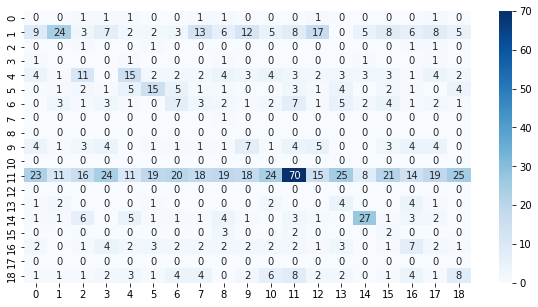

In [ ]:
f = plt.figure()
f.set_figwidth(10)
f.set_figheight(5)
sns.heatmap(r1, annot=True, cmap = 'Blues')

In [ ]:
lb.classes_

array(['approval', 'competition', 'contact', 'curiosity', 'family',
       'food', 'health', 'honor', 'idealism', 'indep', 'none', 'order',
       'power', 'rest', 'romance', 'savings', 'serenity', 'status',
       'tranquility'], dtype=object)

In [ ]:
y_test_text

3572    18
4191     3
2074     7
3334    17
968     15
        ..
3417    12
4662    13
4372     4
3625    17
1767    11
Name: reissLabel, Length: 935, dtype: int64

In [ ]:
text_label = pd.Series(lb.inverse_transform(y_test_text))
integer_label = pd.Series(y_test_text)

In [ ]:
integer_label = integer_label.reset_index(drop = True)
integer_label[0:20]

0     18
1      3
2      7
3     17
4     15
5      1
6     13
7     16
8     17
9     11
10    15
11     5
12    11
13    18
14     3
15    17
16     3
17     0
18     5
19     0
Name: reissLabel, dtype: int64

In [ ]:
text_label[0:20]

0     tranquility
1       curiosity
2           honor
3          status
4         savings
5     competition
6            rest
7        serenity
8          status
9           order
10        savings
11           food
12          order
13    tranquility
14      curiosity
15         status
16      curiosity
17       approval
18           food
19       approval
dtype: object

In [ ]:
def make_confusion_matrix(cf,group_names=None,categories='auto',count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    '''
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html
                   
    title:         Title for the heatmap. Default is None.
    '''


    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=(15,25))
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)
    
    if title:
        plt.title(title)

In [ ]:
print(uniqueClassesReissLabel)
print(uniqueClassesReiss)

[2, 5, 11, 12, 13, 1, 16, 15, 17, 10, 4, 9, 8, 14, 0, 7, 6, 18, 3]
['contact', 'food', 'order', 'power', 'rest', 'competition', 'serenity', 'savings', 'status', 'none', 'family', 'indep', 'idealism', 'romance', 'approval', 'honor', 'health', 'tranquility', 'curiosity']


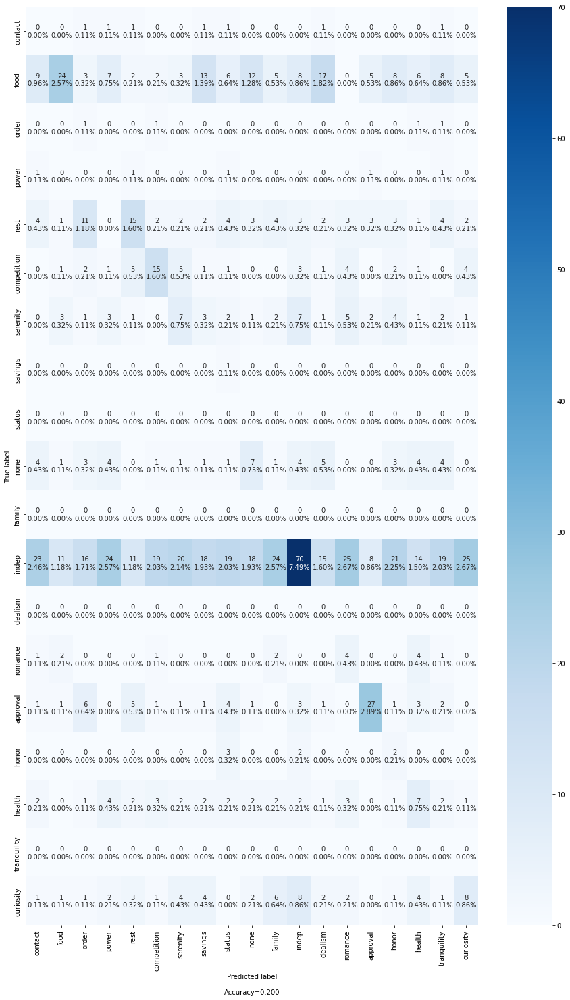

In [ ]:
make_confusion_matrix(r1, group_names=uniqueClassesReissLabel, categories=uniqueClassesReiss, cmap='Blues')

In [ ]:
x_test_text = x_test_text.reset_index(drop = True)
x_test_text[0:5]

0                 Jacqueline is afraid of earthquakes.
1                          Liam needed a new computer.
2    Greg was humbled as he realized that winning w...
3    I shopped around for bands and found out that ...
4          He thought he didn't have anything to lose.
Name: sentence, dtype: object

In [ ]:
print(uniqueClassesReissLabel)
print(uniqueClassesReiss)

[2, 5, 11, 12, 13, 1, 16, 15, 17, 10, 4, 9, 8, 14, 0, 7, 6, 18, 3]
['contact', 'food', 'order', 'power', 'rest', 'competition', 'serenity', 'savings', 'status', 'none', 'family', 'indep', 'idealism', 'romance', 'approval', 'honor', 'health', 'tranquility', 'curiosity']


In [ ]:
y_test

array([[0., 0., 0., ..., 0., 0., 1.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)

In [ ]:
count = 0
for i in range(0,len(review_predictions)):
    if review_predictions[i] != 0 and integer_label[i] == 0 and count != 10:
        print(x_test_text[i])
        count = count + 1

He auditioned for a TV show.
She made it where no one could tag her in photos anymore.
Gabriel realized he was being a baby and decided to get bad grades.
So he bought shoes with typical laces.
Once they began spray painting, Jerome took off and ran.
Tommy was excited about getting a new puppy.
Kate always recycles.
Fred was glad to see the snow had stopped.
When she got it though she regretted it.
All of a sudden, his guitar string broke.


#### BERT 2

In [ ]:
import pandas as pd 
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns 

from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import confusion_matrix 
from sklearn.model_selection import train_test_split
import sklearn

from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from nltk.corpus import stopwords  
from nltk.stem import WordNetLemmatizer
from nltk.stem import PorterStemmer
from collections import Counter 
import wordcloud
from nltk.corpus import stopwords 
from textblob import Word 
import re
from string import punctuation
import nltk

In [ ]:
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [ ]:
df = pd.read_csv('t.csv')

##### Cleaning the Data

In [ ]:
df1 = df.drop(columns = ['action','motivation'])

In [ ]:
def clean(string):
    res = string.strip('][').split(', ')
    lis = []
    for word in res:
        q = word.strip('][').split(', ')
        w = q[0].lstrip('\"')[:-1]
        if w == '' or w == 'na':
            lis.append('none')
        else:
            lis.append(w)
    string = lis
    for classes in lis:
        if classes not in uniqueClasses:
            uniqueClasses.append(classes)
    return string

In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['maslow'][i] = clean(df1['maslow'][i]);
uniqueClassesMaslow = uniqueClasses

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
uniqueClasses = []
for i in range(0,df1.shape[0]):
    df1['reiss'][i] = clean(df1['reiss'][i]);
uniqueClassesReiss = uniqueClasses

In [ ]:
df2 = df1
df3 = df2.explode('reiss')

In [ ]:
df3 = df3[df3['motiveworkerid'] != 'none']
df3 = df3[['motiveworkerid','sentence','maslow','reiss']]
df3 = df3.drop_duplicates(subset = ['sentence']).reset_index(drop = True)

In [ ]:
df3.head()

In [ ]:
'''
from sklearn.utils import shuffle
k1 = df3[df3['maslow'] == 'none'] 
k2 = df3[df3['maslow'] == 'physiological']
df3 = pd.concat([k1,k2],axis = 0)
df3 = shuffle(df3)
df3 = df3.reset_index()
df3 = df3.drop(columns = 'index')
'''

##### Cleaning the Data for NLP tasks

In [ ]:
df3.shape

In [ ]:
c = df3.groupby('maslow')['maslow'].count()
sns.barplot(x = c.index, y = c.values)
plt.xticks(rotation = 90)

In [ ]:
df3[['sentence','maslow']].groupby('maslow').count()

In [ ]:
undersampling_count = df3[['sentence','maslow']].groupby('maslow').count().min()[0]
print(undersampling_count)
print(list(df3['maslow'].unique()))

In [ ]:
# UNDERSAMPLING

dontSeeIndex = 0
from sklearn.utils import shuffle
lis = list(df3['reiss'].unique())
print(type(lis))
print(lis)
dataframes = []
for i in range(len(lis)):
    dataframe = 't' + str(i)
    dataframe = df3[df3['maslow'] == lis[i]]
    dataframe = dataframe.reset_index()
    dataframe = dataframe.drop(columns = 'index')
    if i!=dontSeeIndex:
        dataframe = shuffle(dataframe)
        dataframe = dataframe.iloc[:1139][:]
    dataframes.append(dataframe)
dataframes[0].head(1)
dataframes[5].head(1)

In [ ]:
df3 = pd.concat(dataframes)
df3 = shuffle(df3)
df3 = df3.reset_index()
df3 = df3.drop(columns = 'index')
df3[['sentence','maslow']].groupby('maslow').count()

In [ ]:
lb = LabelEncoder() 
df3['maslowLabel'] = lb.fit_transform(df3['maslow'])

In [ ]:
print(df3['maslow'].unique())
print(df3['maslowLabel'].unique())

In [ ]:
uniqueClassesMaslow = list(df3['maslow'].unique())
uniqueClassesMaslowLabel = list(df3['maslowLabel'].unique())
print(uniqueClassesMaslowLabel)
print(uniqueClassesMaslow)

In [ ]:
df4 = df3.copy()

In [ ]:
common_words = ''
for i in df4.sentence:
    i = str(i)
    tokens = i.split()
    common_words += " ".join(tokens) + " "
wordcloud = WordCloud().generate(common_words)   
plt.imshow(wordcloud, interpolation = 'bilinear')  # bilinear is used to display smooth images
plt.axis('off')
plt.show()

In [ ]:
k = pd.Series(np.concatenate([x.split() for x in df4.sentence])).value_counts()
a = df4['sentence'].str.lower().str.cat(sep=' ')
words = nltk.tokenize.word_tokenize(a)
word_dist = nltk.FreqDist(words)
print (word_dist)
print(len(word_dist))
rslt = pd.DataFrame(word_dist.most_common(30),
                    columns=['Word', 'Frequency'])
print(rslt)

In [ ]:
print(df4.sentence.map(lambda x: len(x)).max())

In [ ]:
lengths = df4["sentence"].str.len()
argmax = np.where(lengths == lengths.max())[0]
df4.iloc[argmax].head(1)

##### Model Bert

https://colab.research.google.com/drive/1Zx58T7hGvOtvfhSfIcus_92ddeqrloB8#scrollTo=E2BPgRJ7YBK0

In [ ]:
df4.head(3)

In [ ]:
df4 = df4[['sentence','reiss','reissLabel']]

In [ ]:
!pip install transformers

In [ ]:
from torch.utils.data import Dataset, DataLoader
import random
import torch
from torch import nn, optim
from torch.utils.data import Dataset, DataLoader
import torch.nn.functional as F
from transformers import BertModel, BertTokenizer, AdamW, get_linear_schedule_with_warmup
from collections import defaultdict
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
from sklearn.metrics import confusion_matrix, classification_report

In [ ]:
from transformers import BertTokenizer, BertModel
import torch

PRE_TRAINED_MODEL_NAME = 'bert-base-uncased'
tokenizer = BertTokenizer.from_pretrained(PRE_TRAINED_MODEL_NAME)

In [ ]:
token_lens = []
for txt in df4.sentence:
  tokens = tokenizer.encode(txt, max_length=512,truncation=True)
  token_lens.append(len(tokens))

In [ ]:
sns.distplot(token_lens)
plt.xlabel('Token count');

In [ ]:
MAX_LEN = 25

In [ ]:
class Classification(Dataset):

  def __init__(self, sentences, targets, tokenizer, max_len):
    self.sentences = sentences
    self.targets = targets
    self.tokenizer = tokenizer
    self.max_len = max_len
  
  def __len__(self):
    return len(self.sentences)
  
  def __getitem__(self, item):
    sentence = str(self.sentences[item])
    target = self.targets[item]

    encoding = self.tokenizer.encode_plus(
      sentence,
      add_special_tokens=True,
      max_length=self.max_len,
      return_token_type_ids=False,
      padding='max_length',
      return_attention_mask=True,
      return_tensors='pt',
      truncation=True
    )

    return {
      'sentence_text': sentence,
      'input_ids': encoding['input_ids'].flatten(),
      'attention_mask': encoding['attention_mask'].flatten(),
      'targets': torch.tensor(target, dtype=torch.long)
    }

In [ ]:
RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)
torch.manual_seed(RANDOM_SEED)
torch.cuda.manual_seed_all(RANDOM_SEED)
random.seed(RANDOM_SEED)

In [ ]:
df_train, df_test = train_test_split(df4, test_size=0.2, random_state=RANDOM_SEED)
df_val, df_test = train_test_split(df_test, test_size=0.5, random_state=RANDOM_SEED)

In [ ]:
df_train.shape, df_val.shape, df_test.shape

In [ ]:
def seed_worker(worker_id):
    worker_seed = RANDOM_SEED
    np.random.seed(worker_seed)
    random.seed(worker_seed)

g = torch.Generator()
g.manual_seed(RANDOM_SEED)
def create_data_loader(df, tokenizer, max_len, batch_size):
  ds = Classification(
    sentences=df.sentence.to_numpy(),
    targets=df['maslowLabel'].to_numpy(),
    tokenizer=tokenizer,
    max_len=max_len
  )

  return DataLoader(
    ds,
    batch_size=batch_size,
    worker_init_fn=seed_worker,
    generator=g,
    num_workers=1
    
  )

In [ ]:
df4.head()

In [ ]:
BATCH_SIZE = 16

train_data_loader = create_data_loader(df_train, tokenizer, MAX_LEN, BATCH_SIZE)
val_data_loader = create_data_loader(df_val, tokenizer, MAX_LEN, BATCH_SIZE)
test_data_loader = create_data_loader(df_test, tokenizer, MAX_LEN, BATCH_SIZE)

In [ ]:
data = next(iter(train_data_loader))
data.keys()

In [ ]:
print(data['input_ids'].shape)
print(data['attention_mask'].shape)
print(data['targets'].shape)

In [ ]:
bert_model = BertModel.from_pretrained(PRE_TRAINED_MODEL_NAME,return_dict=False)

In [ ]:
#last_hidden_state.shape

In [ ]:
bert_model.config.hidden_size

In [ ]:
#pooled_output.shape

In [ ]:
class SentimentClassifier(nn.Module):

  def __init__(self, n_classes):
    super(SentimentClassifier, self).__init__()
    self.bert = BertModel.from_pretrained(PRE_TRAINED_MODEL_NAME)
    self.drop = nn.Dropout(p=0.3)
    self.out = nn.Linear(self.bert.config.hidden_size, n_classes)
  
  def forward(self, input_ids, attention_mask):
    _, pooled_output = self.bert(
      input_ids=input_ids,
      attention_mask=attention_mask,
      return_dict=False
    )
    output = self.drop(pooled_output)
    return self.out(output)

In [ ]:
class_names = list(df4['maslow'].unique())

In [ ]:
model = SentimentClassifier(len(class_names))
model = model.to(device)

In [ ]:
input_ids = data['input_ids'].to(device)
attention_mask = data['attention_mask'].to(device)

print(input_ids.shape) # batch size x seq length
print(attention_mask.shape) # batch size x seq length

In [ ]:
F.softmax(model(input_ids, attention_mask), dim=1)

In [ ]:
EPOCHS = 10

optimizer = AdamW(model.parameters(), lr=2e-5, correct_bias=False)
total_steps = len(train_data_loader) * EPOCHS

scheduler = get_linear_schedule_with_warmup(
  optimizer,
  num_warmup_steps=0,
  num_training_steps=total_steps
)

loss_fn = nn.CrossEntropyLoss().to(device)

In [ ]:
def train_epoch(
  model, 
  data_loader, 
  loss_fn, 
  optimizer, 
  device, 
  scheduler, 
  n_examples
):
  model = model.train()

  losses = []
  correct_predictions = 0
  
  for d in data_loader:
    input_ids = d["input_ids"].to(device)
    attention_mask = d["attention_mask"].to(device)
    targets = d["targets"].to(device)

    outputs = model(
      input_ids=input_ids,
      attention_mask=attention_mask
    )

    _, preds = torch.max(outputs, dim=1)
    loss = loss_fn(outputs, targets)

    correct_predictions += torch.sum(preds == targets)
    losses.append(loss.item())

    loss.backward()
    nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
    optimizer.step()
    scheduler.step()
    optimizer.zero_grad()

  return correct_predictions.double() / n_examples, np.mean(losses)

In [ ]:
def eval_model(model, data_loader, loss_fn, device, n_examples):
  model = model.eval()

  losses = []
  correct_predictions = 0

  with torch.no_grad():
    for d in data_loader:
      input_ids = d["input_ids"].to(device)
      attention_mask = d["attention_mask"].to(device)
      targets = d["targets"].to(device)

      outputs = model(
        input_ids=input_ids,
        attention_mask=attention_mask
      )
      _, preds = torch.max(outputs, dim=1)

      loss = loss_fn(outputs, targets)

      correct_predictions += torch.sum(preds == targets)
      losses.append(loss.item())

  return correct_predictions.double() / n_examples, np.mean(losses)

In [ ]:
%%time

history = defaultdict(list)
best_accuracy = 0

for epoch in range(EPOCHS):

  print(f'Epoch {epoch + 1}/{EPOCHS}')
  print('-' * 10)

  train_acc, train_loss = train_epoch(
    model,
    train_data_loader,    
    loss_fn, 
    optimizer, 
    device, 
    scheduler, 
    len(df_train)
  )

  print(f'Train loss {train_loss} accuracy {train_acc}')

  val_acc, val_loss = eval_model(
    model,
    val_data_loader,
    loss_fn, 
    device, 
    len(df_val)
  )

  print(f'Val   loss {val_loss} accuracy {val_acc}')
  print()

  history['train_acc'].append(train_acc)
  history['train_loss'].append(train_loss)
  history['val_acc'].append(val_acc)
  history['val_loss'].append(val_loss)

  if val_acc > best_accuracy:
    torch.save(model.state_dict(), 'best_model_state.pth')
    best_accuracy = val_acc

In [ ]:
#plt.plot(history['train_acc'], label='train accuracy')
#plt.plot(history['val_acc'], label='validation accuracy')

#plt.title('Training history')
#plt.ylabel('Accuracy')
#plt.xlabel('Epoch')
#plt.legend()
#plt.ylim([0, 1]);

In [ ]:
test_acc, _ = eval_model(
  model,
  test_data_loader,
  loss_fn,
  device,
  len(df_test)
)

test_acc.item()

In [ ]:
def get_predictions(model, data_loader):
  model = model.eval()
  
  review_texts = []
  predictions = []
  prediction_probs = []
  real_values = []

  with torch.no_grad():
    for d in data_loader:

      texts = d["sentence_text"]
      input_ids = d["input_ids"].to(device)
      attention_mask = d["attention_mask"].to(device)
      targets = d["targets"].to(device)

      outputs = model(
        input_ids=input_ids,
        attention_mask=attention_mask
      )
      _, preds = torch.max(outputs, dim=1)

      probs = F.softmax(outputs, dim=1)

      review_texts.extend(texts)
      predictions.extend(preds)
      prediction_probs.extend(probs)
      real_values.extend(targets)

  predictions = torch.stack(predictions).cpu()
  prediction_probs = torch.stack(prediction_probs).cpu()
  real_values = torch.stack(real_values).cpu()
  return review_texts, predictions, prediction_probs, real_values

In [ ]:
y_review_texts, y_pred, y_pred_probs, y_test = get_predictions(
  model,
  test_data_loader
)

In [ ]:
print(classification_report(y_test, y_pred, target_names=class_names))

In [ ]:
def show_confusion_matrix(confusion_matrix):
  hmap = sns.heatmap(confusion_matrix, annot=True, fmt="d", cmap="Blues")
  hmap.yaxis.set_ticklabels(hmap.yaxis.get_ticklabels(), rotation=0, ha='right')
  hmap.xaxis.set_ticklabels(hmap.xaxis.get_ticklabels(), rotation=30, ha='right')
  plt.ylabel('True category')
  plt.xlabel('Predicted category');

cm = confusion_matrix(y_test, y_pred)
df_cm = pd.DataFrame(cm, index=class_names, columns=class_names)
show_confusion_matrix(df_cm)

In [ ]:
idx = 2
review_text = y_review_texts[idx]
true_sentiment = y_test[idx]
pred_df = pd.DataFrame({
  'class_names': class_names,
  'values': y_pred_probs[idx]
})

In [ ]:
sns.barplot(x='values', y='class_names', data=pred_df, orient='h')
plt.ylabel('sentiment')
plt.xlabel('probability')
plt.xlim([0, 1]);

##### Model Roberta

https://colab.research.google.com/github/DhavalTaunk08/NLP_scripts/blob/master/sentiment_analysis_using_roberta.ipynb#scrollTo=mhqvtY2SIup7

In [ ]:
df4.head(3)

In [ ]:
df4 = df4[['sentence','maslow','maslowLabel']]

In [ ]:
!pip install transformers

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
import torch
import seaborn as sns
import transformers
import json
from tqdm import tqdm
from torch.utils.data import Dataset, DataLoader
from transformers import RobertaModel, RobertaTokenizer
import logging
logging.basicConfig(level=logging.ERROR)
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
from sklearn.metrics import confusion_matrix, classification_report
import torch

In [ ]:
# Defining some key variables that will be used later on in the training
MAX_LEN = 256
TRAIN_BATCH_SIZE = 8
VALID_BATCH_SIZE = 4
# EPOCHS = 1
LEARNING_RATE = 1e-05
tokenizer = RobertaTokenizer.from_pretrained('roberta-base', truncation=True, do_lower_case=True)

In [ ]:
df4.head()

In [ ]:
new_df = df4.copy()

In [ ]:
class SentimentData(Dataset):
    def __init__(self, dataframe, tokenizer, max_len):
        self.tokenizer = tokenizer
        self.data = dataframe
        self.text = dataframe.sentence
        self.targets = self.data.maslowLabel
        self.max_len = max_len

    def __len__(self):
        return len(self.text)

    def __getitem__(self, index):
        text = str(self.text[index])
        text = " ".join(text.split())

        inputs = self.tokenizer.encode_plus(
            text,
            None,
            add_special_tokens=True,
            max_length=self.max_len,
            pad_to_max_length=True,
            return_token_type_ids=True
        )
        ids = inputs['input_ids']
        mask = inputs['attention_mask']
        token_type_ids = inputs["token_type_ids"]


        return {
            'ids': torch.tensor(ids, dtype=torch.long),
            'mask': torch.tensor(mask, dtype=torch.long),
            'token_type_ids': torch.tensor(token_type_ids, dtype=torch.long),
            'targets': torch.tensor(self.targets[index], dtype=torch.float)
        }

In [ ]:
train_size = 0.8
train_data=new_df.sample(frac=train_size,random_state=200)
test_data=new_df.drop(train_data.index).reset_index(drop=True)
train_data = train_data.reset_index(drop=True)
print("FULL Dataset: {}".format(new_df.shape))
print("TRAIN Dataset: {}".format(train_data.shape))
print("TEST Dataset: {}".format(test_data.shape))

training_set = SentimentData(train_data, tokenizer, MAX_LEN)
testing_set = SentimentData(test_data, tokenizer, MAX_LEN)

In [ ]:
train_params = {'batch_size': TRAIN_BATCH_SIZE,
                'shuffle': True,
                'num_workers': 0
                }

test_params = {'batch_size': VALID_BATCH_SIZE,
                'shuffle': True,
                'num_workers': 0
                }

training_loader = DataLoader(training_set, **train_params)
testing_loader = DataLoader(testing_set, **test_params)

In [ ]:
class RobertaClass(torch.nn.Module):
    def __init__(self):
        super(RobertaClass, self).__init__()
        self.l1 = RobertaModel.from_pretrained("roberta-base")
        self.pre_classifier = torch.nn.Linear(768, 768)
        self.dropout = torch.nn.Dropout(0.3)
        self.classifier = torch.nn.Linear(768, 6)

    def forward(self, input_ids, attention_mask, token_type_ids):
        output_1 = self.l1(input_ids=input_ids, attention_mask=attention_mask, token_type_ids=token_type_ids)
        hidden_state = output_1[0]
        pooler = hidden_state[:, 0]
        pooler = self.pre_classifier(pooler)
        pooler = torch.nn.ReLU()(pooler)
        pooler = self.dropout(pooler)
        output = self.classifier(pooler)
        return output

In [ ]:
model = RobertaClass()
model.to(device)

In [ ]:
# Creating the loss function and optimizer
loss_function = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(params =  model.parameters(), lr=LEARNING_RATE)

In [ ]:
def calcuate_accuracy(preds, targets):
    n_correct = (preds==targets).sum().item()
    return n_correct

In [ ]:
# Defining the training function on the 80% of the dataset for tuning the distilbert model

def train(epoch):
    tr_loss = 0
    n_correct = 0
    nb_tr_steps = 0
    nb_tr_examples = 0
    model.train()
    for _,data in tqdm(enumerate(training_loader, 0)):
        ids = data['ids'].to(device, dtype = torch.long)
        mask = data['mask'].to(device, dtype = torch.long)
        token_type_ids = data['token_type_ids'].to(device, dtype = torch.long)
        targets = data['targets'].to(device, dtype = torch.long)

        outputs = model(ids, mask, token_type_ids)
        loss = loss_function(outputs, targets)
        tr_loss += loss.item()
        big_val, big_idx = torch.max(outputs.data, dim=1)
        n_correct += calcuate_accuracy(big_idx, targets)

        nb_tr_steps += 1
        nb_tr_examples+=targets.size(0)
        
        if _%5000==0:
            loss_step = tr_loss/nb_tr_steps
            accu_step = (n_correct*100)/nb_tr_examples 
            print(f"Training Loss per 5000 steps: {loss_step}")
            print(f"Training Accuracy per 5000 steps: {accu_step}")

        optimizer.zero_grad()
        loss.backward()
        # # When using GPU
        optimizer.step()

    print(f'The Total Accuracy for Epoch {epoch}: {(n_correct*100)/nb_tr_examples}')
    epoch_loss = tr_loss/nb_tr_steps
    epoch_accu = (n_correct*100)/nb_tr_examples
    print(f"Training Loss Epoch: {epoch_loss}")
    print(f"Training Accuracy Epoch: {epoch_accu}")

    return 

In [ ]:
EPOCHS = 5
for epoch in range(EPOCHS):
    train(epoch)

In [ ]:
def valid(model, testing_loader):
    model.eval()
    n_correct = 0; n_wrong = 0; total = 0; tr_loss=0; nb_tr_steps=0; nb_tr_examples=0
    with torch.no_grad():
        for _, data in tqdm(enumerate(testing_loader, 0)):
            ids = data['ids'].to(device, dtype = torch.long)
            mask = data['mask'].to(device, dtype = torch.long)
            token_type_ids = data['token_type_ids'].to(device, dtype=torch.long)
            targets = data['targets'].to(device, dtype = torch.long)
            outputs = model(ids, mask, token_type_ids).squeeze()
            loss = loss_function(outputs, targets)
            tr_loss += loss.item()
            big_val, big_idx = torch.max(outputs.data, dim=1)
            n_correct += calcuate_accuracy(big_idx, targets)

            nb_tr_steps += 1
            nb_tr_examples+=targets.size(0)
            
            if _%5000==0:
                loss_step = tr_loss/nb_tr_steps
                accu_step = (n_correct*100)/nb_tr_examples
                print(f"Validation Loss per 100 steps: {loss_step}")
                print(f"Validation Accuracy per 100 steps: {accu_step}")
    epoch_loss = tr_loss/nb_tr_steps
    epoch_accu = (n_correct*100)/nb_tr_examples
    print(f"Validation Loss Epoch: {epoch_loss}")
    print(f"Validation Accuracy Epoch: {epoch_accu}")
    
    return epoch_accu

In [ ]:
acc = valid(model, testing_loader)
print("Accuracy on test data = %0.2f%%" % acc)

# NLP

### Base Bert Model + Multiclass classification

#### Libraries

In [ ]:
!pip install -q -U "tensorflow-text==2.8.*"
!pip install -q tf-models-official==2.7.0
!pip install transformers

     |████████████████████████████████| 4.9 MB 32.5 MB/s 
     |████████████████████████████████| 1.8 MB 18.0 MB/s 
     |████████████████████████████████| 352 kB 39.8 MB/s 
     |████████████████████████████████| 43 kB 686 kB/s 
     |████████████████████████████████| 1.2 MB 40.6 MB/s 
     |████████████████████████████████| 238 kB 47.1 MB/s 
     |████████████████████████████████| 99 kB 6.9 MB/s 
     |████████████████████████████████| 116 kB 46.9 MB/s 
     |████████████████████████████████| 1.1 MB 40.0 MB/s 
     |████████████████████████████████| 596 kB 39.6 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 4.7 MB 7.7 MB/s 
     |████████████████████████████████| 6.6 MB 51.1 MB/s 
     |████████████████████████████████| 101 kB 6.5 MB/s 


In [ ]:
import pandas as pd 
import numpy as np
import seaborn as sns 
import matplotlib.pyplot as plt
from sklearn.utils import shuffle
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from tensorflow.keras.utils import to_categorical
import sklearn

import os
import shutil
import tensorflow as tf
import tensorflow_hub as hub
import tensorflow_text as text
from official.nlp import optimization  # to create AdamW optimizer
import keras
tf.get_logger().setLevel('ERROR')

from nltk.corpus import stopwords  
from nltk.stem import WordNetLemmatizer
from nltk.stem import PorterStemmer
from string import punctuation
from collections import Counter 
import wordcloud
from nltk.corpus import stopwords 
from textblob import Word 
import re
import nltk

In [ ]:
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

#### Cleaning and Getting Final_dataset

In [ ]:
!gdown --id 1OePgl70Y-lX81dMtN4FxJu9dtmwGSbr9

/usr/local/lib/python3.7/dist-packages/gdown/cli.py:131: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  category=FutureWarning,
Downloading...
From: https://drive.google.com/uc?id=1OePgl70Y-lX81dMtN4FxJu9dtmwGSbr9
To: /content/t.xlsx
100% 5.71M/5.71M [00:00<00:00, 183MB/s]


In [ ]:
df = pd.read_excel('t.xlsx')

In [ ]:
df['context'] = df['context'].fillna('')
df = df[df['motiveworkerid'] != 'none']
df1 = df.copy()
df1['motiveworkerid'].unique()

array(['ann0', 'ann1', 'ann2', 'ann3', 'ann4', 'ann5', 'ann6'],
      dtype=object)

In [ ]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 65522 entries, 0 to 86905
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   storyid         65522 non-null  object
 1   linenum         65522 non-null  int64 
 2   char            65522 non-null  object
 3   motiveworkerid  65522 non-null  object
 4   context         65522 non-null  object
 5   sentence        65522 non-null  object
 6   action          65522 non-null  object
 7   motivation      65522 non-null  object
 8   maslow          65522 non-null  object
 9   reiss           65522 non-null  object
dtypes: int64(1), object(9)
memory usage: 5.5+ MB


In [ ]:
df1.isna().sum()

storyid           0
linenum           0
char              0
motiveworkerid    0
context           0
sentence          0
action            0
motivation        0
maslow            0
reiss             0
dtype: int64

In [ ]:
df1.head()

,storyid,linenum,char,motiveworkerid,context,sentence,action,motivation,maslow,reiss
0,a2ddbb50-e45b-4ad3-becf-b2d8475172bf,1,I (myself),ann0,,I began making fish curry for my boyfriend and I.,yes,"[""eat some food""]","[""physiological""]","[""food""]"
1,a2ddbb50-e45b-4ad3-becf-b2d8475172bf,1,I (myself),ann1,,I began making fish curry for my boyfriend and I.,yes,"[""to be nice""]","[""love"", ""physiological""]","[""family"", ""romance"", ""food""]"
2,a2ddbb50-e45b-4ad3-becf-b2d8475172bf,1,I (myself),ann2,,I began making fish curry for my boyfriend and I.,yes,"[""to satisfy a craving.""]","[""physiological""]","[""food""]"
4,a2ddbb50-e45b-4ad3-becf-b2d8475172bf,2,I (myself),ann0,I began making fish curry for my boyfriend and I.,I decided not to read a recipe since I've made...,yes,"[""to help out""]","[""spiritual growth""]","[""indep""]"
5,a2ddbb50-e45b-4ad3-becf-b2d8475172bf,2,I (myself),ann1,I began making fish curry for my boyfriend and I.,I decided not to read a recipe since I've made...,yes,"[""confidence""]","[""physiological""]","[""food""]"


In [ ]:
df1['sentence'] = df1['context'] + df1['sentence']
df1.drop(columns = ['context','storyid','linenum','char','action','motivation'], inplace = True)
df1.head()

,motiveworkerid,sentence,maslow,reiss
0,ann0,I began making fish curry for my boyfriend and I.,"[""physiological""]","[""food""]"
1,ann1,I began making fish curry for my boyfriend and I.,"[""love"", ""physiological""]","[""family"", ""romance"", ""food""]"
2,ann2,I began making fish curry for my boyfriend and I.,"[""physiological""]","[""food""]"
4,ann0,I began making fish curry for my boyfriend and...,"[""spiritual growth""]","[""indep""]"
5,ann1,I began making fish curry for my boyfriend and...,"[""physiological""]","[""food""]"


In [ ]:
def stringToList(string):
    res = string.strip('][').split(', ')
    lis = []
    for word in res:
        q = word.strip('][').split(', ')
        w = q[0].lstrip('\"')[:-1]
        if w == '' or w == 'na':
            lis.append('none')
        else:
            lis.append(w)
    string = lis
    return string

for i in range(0,df1.shape[0]):
    if isinstance(df1.iloc[i][2], str):
        string = df1.iloc[i][2]
        lis = stringToList(string)
        df1.iloc[i][2] = lis 
    
for i in range(0,df1.shape[0]):
    if isinstance(df1.iloc[i][3], str):
        string = df1.iloc[i][3]
        lis = stringToList(string)
        df1.iloc[i][3] = lis 

In [ ]:
df1.head()

,motiveworkerid,sentence,maslow,reiss
0,ann0,I began making fish curry for my boyfriend and I.,[physiological],[food]
1,ann1,I began making fish curry for my boyfriend and I.,"[love, physiological]","[family, romance, food]"
2,ann2,I began making fish curry for my boyfriend and I.,[physiological],[food]
4,ann0,I began making fish curry for my boyfriend and...,[spiritual growth],[indep]
5,ann1,I began making fish curry for my boyfriend and...,[physiological],[food]


In [ ]:
df2 = df1.copy()
df2 = df1.explode(column = ['maslow'])
#df2 = df2.explode(column = ['reiss'])
df2.head()

,motiveworkerid,sentence,maslow,reiss
0,ann0,I began making fish curry for my boyfriend and I.,physiological,[food]
1,ann1,I began making fish curry for my boyfriend and I.,love,"[family, romance, food]"
1,ann1,I began making fish curry for my boyfriend and I.,physiological,"[family, romance, food]"
2,ann2,I began making fish curry for my boyfriend and I.,physiological,[food]
4,ann0,I began making fish curry for my boyfriend and...,spiritual growth,[indep]


In [ ]:
unique_sentences = list(df2['sentence'].unique())
unique_major_category_maslow = []
unique_major_category_reiss = []
maslow_list = list(df2['maslow'].unique())
unique_sentences[0:2]

['I began making fish curry for my boyfriend and I.',
 "I began making fish curry for my boyfriend and I.I decided not to read a recipe since I've made so many in my life."]

In [ ]:
'''
for i in range(len(unique_sentences)):
    filter = df2['sentence'] == unique_sentences[i]
    test = df2[filter]
    maslow_list_count = []
    for j in range(len(maslow_list)):
        maslow_list_count.append(0)
    for j in range(test.shape[0]):
        category = test.iloc[j][2]
        category = str(category)
        if category in maslow_list:
            index = maslow_list.index(category)
            maslow_list_count[index] = maslow_list_count[index] + 1 
    max_index = maslow_list_count.index(max(maslow_list_count))
    unique_major_category.append(maslow_list[max_index])
'''

"\nfor i in range(len(unique_sentences)):\n    filter = df2['sentence'] == unique_sentences[i]\n    test = df2[filter]\n    maslow_list_count = []\n    for j in range(len(maslow_list)):\n        maslow_list_count.append(0)\n    for j in range(test.shape[0]):\n        category = test.iloc[j][2]\n        category = str(category)\n        if category in maslow_list:\n            index = maslow_list.index(category)\n            maslow_list_count[index] = maslow_list_count[index] + 1 \n    max_index = maslow_list_count.index(max(maslow_list_count))\n    unique_major_category.append(maslow_list[max_index])\n"

In [ ]:
for i in range(len(unique_sentences)):
    filter = df2['sentence'] == unique_sentences[i]
    test = df2[filter]
    unique_major_category_maslow.append(test['maslow'].mode()[0])

df2 = df1.explode(column = 'reiss')
reiss_list = list(df2['reiss'].unique())
for i in range(len(unique_sentences)):
    filter = df2['sentence'] == unique_sentences[i]
    test = df2[filter]
    unique_major_category_reiss.append(test['reiss'].mode()[0])

In [ ]:
print(len(unique_sentences))
print(len(unique_major_category_maslow))
print(len(unique_major_category_reiss))

20593
20593
20593


In [ ]:
df2 = pd.DataFrame(
    {'sentence': unique_sentences,
     'maslow': unique_major_category_maslow,
     'reiss': unique_major_category_reiss
    })
df2.head(30)

,sentence,maslow,reiss
0,I began making fish curry for my boyfriend and I.,physiological,food
1,I began making fish curry for my boyfriend and...,spiritual growth,indep
2,I began making fish curry for my boyfriend and...,esteem,competition
3,I began making fish curry for my boyfriend and...,spiritual growth,health
4,I began making fish curry for my boyfriend and...,none,none
5,Jervis has been single for a long time.He want...,love,romance
6,Jervis has been single for a long time.|He wan...,love,romance
7,Jervis has been single for a long time.|He wan...,love,romance
8,Jervis has been single for a long time.|He wan...,love,romance
9,Ray couldn't get an irritating tune out of his...,none,none


In [ ]:
for i in range(df2.shape[0]):
    sentence = df2.iloc[i][0]
    lis = sentence.split()
    newlis = []
    ch = '|'
    for word in lis:
        if ch in word: 
            new_word = word.replace(ch,'')
            newlis.append(new_word)
        else:
            newlis.append(word) 
    df2.iloc[i][0] = ' '.join(map(str,newlis))

df2.head(30)

,sentence,maslow,reiss
0,I began making fish curry for my boyfriend and I.,physiological,food
1,I began making fish curry for my boyfriend and...,spiritual growth,indep
2,I began making fish curry for my boyfriend and...,esteem,competition
3,I began making fish curry for my boyfriend and...,spiritual growth,health
4,I began making fish curry for my boyfriend and...,none,none
5,Jervis has been single for a long time.He want...,love,romance
6,Jervis has been single for a long time.He want...,love,romance
7,Jervis has been single for a long time.He want...,love,romance
8,Jervis has been single for a long time.He want...,love,romance
9,Ray couldn't get an irritating tune out of his...,none,none


In [ ]:
unique_sentences = list(df2['sentence'].unique())
unique_major_category_maslow = []
unique_major_category_reiss = []
maslow_list = list(df2['maslow'].unique())
reiss_list = list(df2['reiss'].unique())
unique_sentences[0:2]

['I began making fish curry for my boyfriend and I.',
 "I began making fish curry for my boyfriend and I.I decided not to read a recipe since I've made so many in my life."]

In [ ]:
for i in range(len(unique_sentences)):
    filter = df2['sentence'] == unique_sentences[i]
    test = df2[filter]
    unique_major_category_maslow.append(test['maslow'].mode()[0])
    unique_major_category_reiss.append(test['reiss'].mode()[0])    

In [ ]:
print(len(unique_sentences))
print(len(unique_major_category_maslow))
print(len(unique_major_category_reiss))

20593
20593
20593


In [ ]:
final_data = pd.DataFrame(
    {'sentence': unique_sentences,
     'maslow': unique_major_category_maslow,
     'reiss': unique_major_category_reiss
    })

In [ ]:
final_data.to_csv('Data.csv',index = False)
from google.colab import files 
files.download('Data.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

#### Understanding Final Dataset

In [ ]:
#!gdown --id 1ygTJQRj72xrwx4ReBWeAEnzb6EN4eZ

In [ ]:
final_data = pd.read_csv('Data.csv')
final_data.head()

,sentence,maslow,reiss
0,I began making fish curry for my boyfriend and I.,physiological,food
1,I began making fish curry for my boyfriend and...,spiritual growth,indep
2,I began making fish curry for my boyfriend and...,esteem,competition
3,I began making fish curry for my boyfriend and...,spiritual growth,health
4,I began making fish curry for my boyfriend and...,none,none


In [ ]:
final_data[['sentence','maslow','reiss']].groupby(['maslow']).count()

,sentence,reiss
maslow,,
esteem,5187,5187
love,4502,4502
none,2543,2543
physiological,2277,2277
spiritual growth,2360,2360
stability,3724,3724


In [ ]:
final_data[['sentence','maslow','reiss']].groupby(['reiss']).count()

,sentence,maslow
reiss,,
approval,1865,1865
belonging,58,58
competition,1556,1556
contact,1876,1876
curiosity,1860,1860
family,1512,1512
food,1710,1710
health,1141,1141
honor,271,271


In [ ]:
filter = (final_data['maslow'] == 'none') & (final_data['reiss'] == 'none')
test_both_none = final_data[filter]
filter = (final_data['maslow'] != 'none') & (final_data['reiss'] == 'none')
test_reiss_only_none = final_data[filter]
filter = (final_data['maslow'] == 'none') & (final_data['reiss'] != 'none')
test_maslow_only_none = final_data[filter]

In [ ]:
print(final_data.shape) 
print(test_both_none.shape)
print(test_reiss_only_none.shape)
print(test_maslow_only_none.shape)

(20593, 3)
(1975, 3)
(1479, 3)
(568, 3)


In [ ]:
#final_data.to_csv('Data.csv',index = False)
#from google.colab import files 
#files.download('Data.csv')

maslow
esteem              5187
love                4502
none                2543
physiological       2277
spiritual growth    2360
stability           3724
Name: maslow, dtype: int64

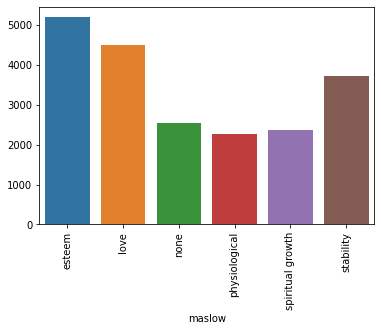

In [ ]:
c = final_data.groupby('maslow')['maslow'].count()
sns.barplot(x = c.index, y = c.values)
plt.xticks(rotation = 90)
final_data.groupby('maslow')['maslow'].count()

In [ ]:
out = final_data['sentence'].str.split().explode().value_counts()
print(out[:60])

to         22485
the        19840
a          19074
was        15089
and         9780
her         7652
his         7587
in          6081
of          5491
for         5489
he          5477
had         5433
she         4853
on          4445
I           4255
at          3408
it          3373
with        3185
went        2820
wanted      2723
that        2462
decided     2387
up          2200
got         2140
out         2131
my          2014
were        1807
new         1728
an          1698
him         1684
very        1611
all         1516
they        1473
but         1462
from        1439
day         1385
one         1349
is          1289
get         1254
not         1241
go          1215
didn't      1181
took        1176
so          1142
would       1125
be          1106
when        1102
some        1083
about       1053
into        1026
as           995
loved        993
told         958
always       935
found        902
have         901
bought       900
asked        840
them         8

In [ ]:
counter = final_data.copy()
counter['number_of_words'] = counter.sentence.apply(lambda x: len(x.split()))
counter = counter.sort_values(by = 'number_of_words',ascending = True)
counter.head(30)

,sentence,maslow,reiss,number_of_words
3191,Tiffany loved butterflies.,none,none,3
846,Dan loves Christmas.,none,none,3
13865,Dakota loved December.,esteem,approval,3
13554,Joe loved music.,spiritual growth,serenity,3
5179,Brock loves cars.,esteem,none,3
11281,Ian felt hyper.,none,none,3
5701,Lee loved motorcycles.,love,none,3
14284,Dean loved homecoming.,none,none,3
9100,George was hungry.,stability,food,3
13597,Abby loves popcorn.,physiological,food,3


In [ ]:
t = pd.DataFrame(counter[['number_of_words','sentence']].groupby('number_of_words').count())
t = t.reset_index()
t['number_of_words'] = 'words:' + t['number_of_words'].astype(str)

([0,
  1,
  2,
  3,
  4,
  5,
  6,
  7,
  8,
  9,
  10,
  11,
  12,
  13,
  14,
  15,
  16,
  17,
  18,
  19,
  20,
  21,
  22,
  23,
  24,
  25,
  26,
  27,
  28,
  29,
  30,
  31,
  32,
  33,
  34,
  35,
  36,
  37,
  38,
  39,
  40,
  41,
  42,
  43,
  44,
  45,
  46,
  47,
  48,
  49,
  50,
  51,
  52,
  53,
  54,
  55,
  56,
  57,
  58,
  59,
  60,
  61,
  62,
  63,
  64],
 <a list of 65 Text major ticklabel objects>)

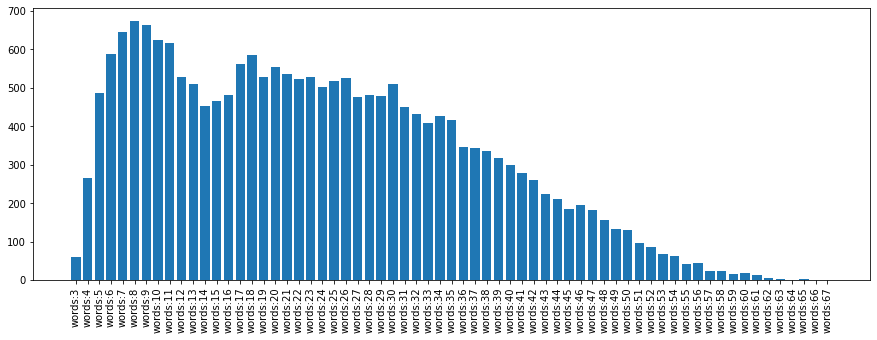

In [ ]:
fig = plt.figure(figsize=(15, 5))
  
# creating the bar plot
plt.bar(t['number_of_words'], t['sentence'])
plt.xticks(rotation=90)

Lets Remove stopwords and check

In [ ]:
def tokenization(string):
    words=nltk.word_tokenize(string)
    return ' '.join(words)

def removestopwords(string):
    for i in punctuation:
        string=string.replace(i,'')
    words=nltk.word_tokenize(string)
    k=[]
    eng_stop=stopwords.words('english')
    for each in words:
        if each not in eng_stop:
            k.append(each.lower())
    return ' '.join(k)

def stem(string):
    words = nltk.word_tokenize(string)
    ps = PorterStemmer()
    l = []
    for each in words:
        l.append(ps.stem(each))
    return ' '.join(l)

def lemmat(string):
    words=nltk.word_tokenize(string)
    ws=WordNetLemmatizer()
    l=[]
    for each in words:
        l.append(ws.lemmatize(each))
    return ' '.join(l)

def Refine(string):
    return stem(removestopwords(tokenization(string)))

In [ ]:
final_data.head()

,sentence,maslow,reiss
0,I began making fish curry for my boyfriend and I.,physiological,food
1,I began making fish curry for my boyfriend and...,spiritual growth,indep
2,I began making fish curry for my boyfriend and...,esteem,competition
3,I began making fish curry for my boyfriend and...,spiritual growth,health
4,I began making fish curry for my boyfriend and...,none,none


In [ ]:
refineddataframe = final_data.copy()
refineddataframe['sentence']=refineddataframe['sentence'].apply(lambda x: Refine(x))
refineddataframe.head()

,sentence,maslow,reiss
0,i began make fish curri boyfriend i,physiological,food
1,i began make fish curri boyfriend ii decid rea...,spiritual growth,indep
2,i began make fish curri boyfriend ii decid rea...,esteem,competition
3,i began make fish curri boyfriend ii decid rea...,spiritual growth,health
4,i began make fish curri boyfriend ii decid rea...,none,none


In [ ]:
out = refineddataframe['sentence'].str.split().explode().value_counts()
print(out[:60])

i         4383
want      3098
went      2827
decid     2592
nt        2582
day       2211
got       2144
go        1945
friend    1902
new       1787
one       1687
get       1683
love      1345
tri       1340
work      1330
play      1323
would     1284
could     1252
took      1182
look      1091
walk      1071
like      1052
start     1039
ask       1035
home      1015
told       959
alway      937
need       921
make       920
found      906
bought     904
school     892
time       889
the        849
first      841
saw        821
take       815
made       814
tom        813
call       807
my         794
dog        787
year       735
car        709
came       701
put        701
see        701
mom        676
realli     676
use        645
store      635
buy        619
watch      609
back       569
old        564
good       562
never      559
night      553
lot        544
man        539
Name: sentence, dtype: int64


In [ ]:
counter1 = refineddataframe.copy()
counter1['number_of_words'] = counter1.sentence.apply(lambda x: len(x.split()))
counter1 = counter1.sort_values(by = 'number_of_words',ascending = True)
counter1.head(30)

,sentence,maslow,reiss,number_of_words
14985,bob readi,love,none,2
4939,michael tourett,none,none,2
9100,georg hungri,stability,food,2
16707,i thirsti,physiological,food,2
12032,i confess,none,none,2
3675,tom bar,physiological,food,2
4954,nathan doctor,esteem,competition,2
10637,sarah swim,stability,health,2
19036,gina furiou,none,none,2
16654,yolanda mess,none,none,2


In [ ]:
t1 = pd.DataFrame(counter1[['number_of_words','sentence']].groupby('number_of_words').count())
t1 = t1.reset_index()
t1['number_of_words'] = 'words:' + t1['number_of_words'].astype(str)

([0,
  1,
  2,
  3,
  4,
  5,
  6,
  7,
  8,
  9,
  10,
  11,
  12,
  13,
  14,
  15,
  16,
  17,
  18,
  19,
  20,
  21,
  22,
  23,
  24,
  25,
  26,
  27,
  28,
  29,
  30,
  31,
  32,
  33,
  34,
  35,
  36,
  37,
  38],
 <a list of 39 Text major ticklabel objects>)

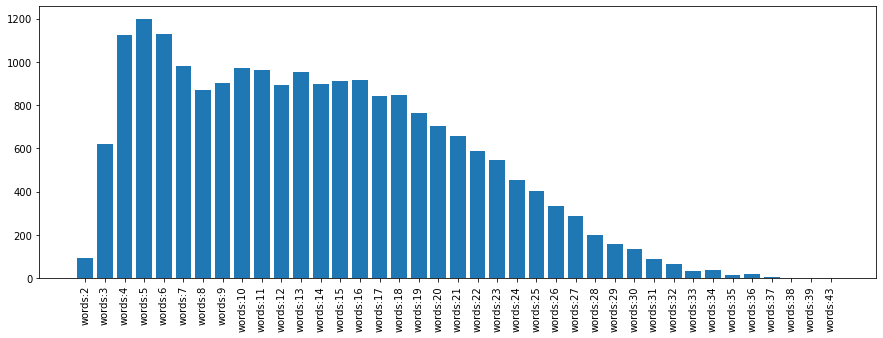

In [ ]:
fig = plt.figure(figsize=(15, 5))
# creating the bar plot
plt.bar(t1['number_of_words'], t1['sentence'])
plt.xticks(rotation=90)

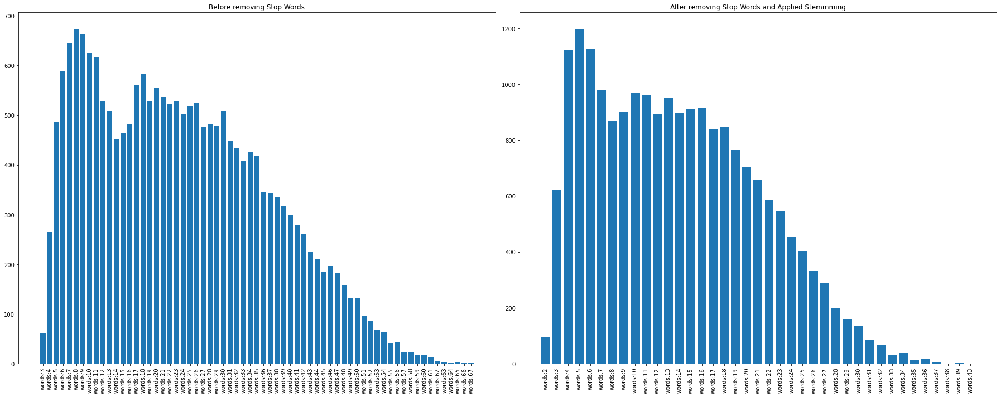

In [ ]:
fig = plt.figure(figsize=(25, 10))
plt.subplot(1, 2, 1)
plt.bar(t['number_of_words'], t['sentence'])
plt.xticks(rotation=90)
plt.title('Before removing Stop Words')

plt.subplot(1, 2, 2)
plt.bar(t1['number_of_words'], t1['sentence'])
plt.xticks(rotation=90)
plt.title('After removing Stop Words and Applied Stemmming')
plt.tight_layout()

#### Cleaning Data For NLP  -> Result df2 of uniform class

In [ ]:
final_data[['sentence','maslow']].groupby('maslow').count()

,sentence
maslow,
esteem,5187
love,4502
none,2543
physiological,2277
spiritual growth,2360
stability,3724


In [ ]:
undersampling_count = final_data[['sentence','maslow']].groupby('maslow').count().min()[0]
print(undersampling_count)
lis = list(final_data['maslow'].unique())
print(lis)

2277
['physiological', 'spiritual growth', 'esteem', 'none', 'love', 'stability']


In [ ]:
# UNDERSAMPLING
df1 = final_data.copy()
dontSeeIndex = 0
lis = list(df1['maslow'].unique())
print(type(lis))
print(lis)
dataframes = []
for i in range(len(lis)):
    dataframe = 't' + str(i)
    dataframe = df1[df1['maslow'] == lis[i]]
    dataframe = dataframe.reset_index()
    dataframe = dataframe.drop(columns = 'index')
    if i!=dontSeeIndex:
        dataframe = shuffle(dataframe)
        dataframe = dataframe.iloc[:2277][:]
    dataframes.append(dataframe)
dataframes[0].head(1)
dataframes[5].head(1)

<class 'list'>
['physiological', 'spiritual growth', 'esteem', 'none', 'love', 'stability']


,sentence,maslow,reiss
2331,Dan is reading a book.He sees a spider cross t...,stability,tranquility


In [ ]:
df1 = pd.concat(dataframes)
df1 = shuffle(df1)
df1 = df1.reset_index()
df1 = df1.drop(columns = 'index')
df1[['sentence','maslow']].groupby('maslow').count()

,sentence
maslow,
esteem,2277
love,2277
none,2277
physiological,2277
spiritual growth,2277
stability,2277


In [ ]:
df2 = df1.copy()
lb = LabelEncoder() 
df2['maslowLabel'] = lb.fit_transform(df2['maslow'])
print(df2['maslow'].unique())
print(df2['maslowLabel'].unique())

['love' 'physiological' 'esteem' 'none' 'stability' 'spiritual growth']
[1 3 0 2 5 4]


#### Base Model Bert

In [ ]:
non_uniform_dataframe = final_data.copy()
lb = LabelEncoder() 
non_uniform_dataframe['maslowLabel'] = lb.fit_transform(non_uniform_dataframe['maslow'])
uniqueClassesMaslowLabel = list(non_uniform_dataframe['maslowLabel'].unique())
uniqueClassesMaslow = list(non_uniform_dataframe['maslow'].unique())
print(non_uniform_dataframe['maslow'].unique())
print(non_uniform_dataframe['maslowLabel'].unique())

['physiological' 'spiritual growth' 'esteem' 'none' 'love' 'stability']
[3 4 0 2 1 5]


In [ ]:
non_uniform_dataframe.groupby('maslow').count()

,sentence,reiss,maslowLabel
maslow,,,
esteem,5187,5187,5187
love,4502,4502,4502
none,2543,2543,2543
physiological,2277,2277,2277
spiritual growth,2360,2360,2360
stability,3724,3724,3724


In [ ]:
bert_preprocess = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_preprocess/3")
bert_encoder = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4")

In [ ]:
text_input = tf.keras.layers.Input(shape=(), dtype=tf.string, name='text')
preprocessed_text = bert_preprocess(text_input)
outputs = bert_encoder(preprocessed_text)
l = tf.keras.layers.Dropout(0.1, name="dropout")(outputs['pooled_output'])
l = tf.keras.layers.Dense(6, activation='softmax', name="output")(l)

In [ ]:
model = tf.keras.Model(inputs=[text_input], outputs = [l])

In [ ]:
METRICS = [
      keras.metrics.TruePositives(name='tp'),
      keras.metrics.FalsePositives(name='fp'),
      keras.metrics.TrueNegatives(name='tn'),
      keras.metrics.FalseNegatives(name='fn'), 
      keras.metrics.CategoricalCrossentropy(name='categorical_cross_entropy'),
      keras.metrics.Precision(name='precision'),
      keras.metrics.Recall(name='recall'),
      keras.metrics.AUC(name='auc'),
      keras.metrics.AUC(name='prc', curve='PR'), # precision-recall curve
      'accuracy'
]
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=METRICS)
x_train, x_test, y_train, y_test = train_test_split(non_uniform_dataframe['sentence'],non_uniform_dataframe['maslowLabel'],test_size = 0.2, random_state = 0, stratify = non_uniform_dataframe['maslowLabel'])
x_val, x_test,y_val, y_test = train_test_split(x_train, y_train, test_size = 0.5,random_state = 0, stratify = y_train)
x_train_text = x_train 
x_test_text = x_test
y_train_text = y_train
y_test_text = y_test
print(x_train.shape)
print(x_test.shape)
print(x_val.shape)

(16474,)
(8237,)
(8237,)


In [ ]:
y_val = to_categorical(y_val)
y_train = to_categorical(y_train)
y_test =  to_categorical(y_test)

In [ ]:
checkpoint_filepath = '/tmp/checkpoint'
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True)

callback = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    min_delta=0,
    patience=5,
    verbose=0,
    mode='auto',
    baseline=None,
    restore_best_weights=False
)

# Model weights are saved at the end of every epoch, if it's the best seen
# so far.
history = model.fit(x_train, y_train,epochs=50, verbose=1, validation_data = (x_val,y_val),callbacks=[model_checkpoint_callback, callback])

Epoch 1/50
515/515 [==============================] - 275s 506ms/step - loss: 1.7508 - tp: 168.0000 - fp: 247.0000 - tn: 82123.0000 - fn: 16306.0000 - categorical_cross_entropy: 1.7508 - precision: 0.4048 - recall: 0.0102 - auc: 0.6192 - prc: 0.2439 - accuracy: 0.2668 - val_loss: 1.6264 - val_tp: 26.0000 - val_fp: 7.0000 - val_tn: 41178.0000 - val_fn: 8211.0000 - val_categorical_cross_entropy: 1.6264 - val_precision: 0.7879 - val_recall: 0.0032 - val_auc: 0.6957 - val_prc: 0.3578 - val_accuracy: 0.3696
Epoch 2/50
515/515 [==============================] - 261s 506ms/step - loss: 1.6531 - tp: 562.0000 - fp: 454.0000 - tn: 81916.0000 - fn: 15912.0000 - categorical_cross_entropy: 1.6531 - precision: 0.5531 - recall: 0.0341 - auc: 0.6776 - prc: 0.3106 - accuracy: 0.3306 - val_loss: 1.5753 - val_tp: 253.0000 - val_fp: 69.0000 - val_tn: 41116.0000 - val_fn: 7984.0000 - val_categorical_cross_entropy: 1.5753 - val_precision: 0.7857 - val_recall: 0.0307 - val_auc: 0.7191 - val_prc: 0.3847 - val

KeyboardInterrupt: ignored

In [ ]:
model.load_weights(checkpoint_filepath)
model.evaluate(x_test, y_test)

258/258 [==============================] - 86s 333ms/step - loss: 1.4174 - tp: 1138.0000 - fp: 509.0000 - tn: 40676.0000 - fn: 7099.0000 - categorical_cross_entropy: 1.4174 - precision: 0.6910 - recall: 0.1382 - auc: 0.7898 - prc: 0.4701 - accuracy: 0.4679


[1.4174212217330933,
 1138.0,
 509.0,
 40676.0,
 7099.0,
 1.4174212217330933,
 0.690953254699707,
 0.13815709948539734,
 0.7898277640342712,
 0.4700617790222168,
 0.46788880228996277]

In [ ]:
print(history.history.keys())

NameError: ignored

In [ ]:
plt.plot(history.history['loss'], '-o', label='Train Loss')
plt.plot(history.history['val_loss'], '-o', label = 'Val Loss')
plt.legend()

NameError: ignored

In [ ]:
plt.plot(history.history['accuracy'], '-o', label='Train Accuracy')
plt.plot(history.history['val_accuracy'], '-o', label = 'Val Accuracy')
plt.legend()

#### Evaluation and Analysis

In [ ]:
y_pred = model.predict(x_test)

In [ ]:
y_pred[2]

array([0.34901643, 0.11062192, 0.10527226, 0.05692647, 0.08771384,
       0.2904491 ], dtype=float32)

In [ ]:
review_predictions = []
for prediction in y_pred:
    x = prediction
    review_predictions.append(np.argmax(x))

review_predictions = np.array(review_predictions)
review_predictions.reshape(1,-1)
review_predictions.shape

(8237,)

In [ ]:
review_predictions

array([5, 4, 0, ..., 0, 4, 0])

In [ ]:
k = pd.DataFrame(review_predictions, columns = ['Label'])
k.groupby('Label')['Label'].count()

Label
0    2275
1    2144
2     208
3     669
4     614
5    2327
Name: Label, dtype: int64

In [ ]:
type(y_test_text)

pandas.core.series.Series

In [ ]:
r1 = sklearn.metrics.confusion_matrix(review_predictions, y_test_text)
print(r1)

[[1127  284  214   99  278  273]
 [ 329 1138  179  162  186  150]
 [  17   24   85   23   19   40]
 [  64   57   57  378   46   67]
 [ 141   62   87   37  227   60]
 [ 397  236  395  212  188  899]]


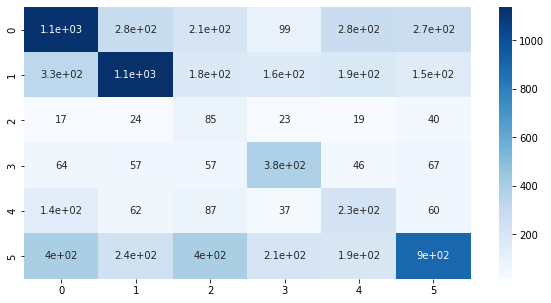

In [ ]:
f = plt.figure()
f.set_figwidth(10)
f.set_figheight(5)
sns.heatmap(r1, annot=True, cmap = 'Blues')

In [ ]:
lb.classes_

array(['esteem', 'love', 'none', 'physiological', 'spiritual growth',
       'stability'], dtype=object)

In [ ]:
y_test_text

19502    0
17710    0
19858    5
17596    5
7136     3
        ..
18657    5
4110     0
4687     0
14816    1
14156    5
Name: maslowLabel, Length: 8237, dtype: int64

In [ ]:
text_label = pd.Series(lb.inverse_transform(y_test_text))
integer_label = pd.Series(y_test_text)

In [ ]:
integer_label = integer_label.reset_index(drop = True)
integer_label[0:20]

0     0
1     0
2     5
3     5
4     3
5     0
6     5
7     4
8     0
9     0
10    4
11    1
12    5
13    0
14    0
15    0
16    2
17    5
18    0
19    1
Name: maslowLabel, dtype: int64

In [ ]:
text_label[0:20]

0               esteem
1               esteem
2            stability
3            stability
4        physiological
5               esteem
6            stability
7     spiritual growth
8               esteem
9               esteem
10    spiritual growth
11                love
12           stability
13              esteem
14              esteem
15              esteem
16                none
17           stability
18              esteem
19                love
dtype: object

In [ ]:
def make_confusion_matrix(cf,group_names=None,categories='auto',count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    '''
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html
                   
    title:         Title for the heatmap. Default is None.
    '''


    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)
    
    if title:
        plt.title(title)

In [ ]:
print(uniqueClassesMaslowLabel)
print(uniqueClassesMaslow)

[3, 4, 0, 2, 1, 5]
['physiological', 'spiritual growth', 'esteem', 'none', 'love', 'stability']


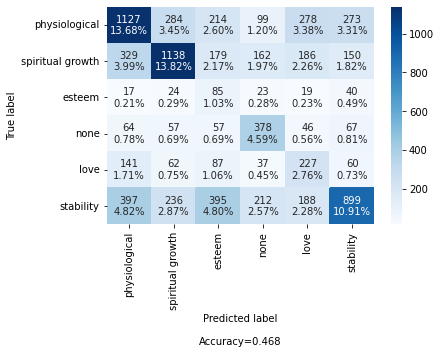

In [ ]:
make_confusion_matrix(r1, group_names=uniqueClassesMaslowLabel, categories=uniqueClassesMaslow, cmap='Blues')

In [ ]:
x_test_text = x_test_text.reset_index(drop = True)
x_test_text[0:5]

0    Alex likes to drive fast.|His mother warned hi...
1    Joan was an expert gardener who loved sunflowe...
2    Bryant went skiing for the first time ever.|Hi...
3    Doug loved to play mean pranks on everyone at ...
4    Eli got a new motorcycle last summer.He took i...
Name: sentence, dtype: object

In [ ]:
print(uniqueClassesMaslowLabel)
print(uniqueClassesMaslow)

[3, 4, 0, 2, 1, 5]
['physiological', 'spiritual growth', 'esteem', 'none', 'love', 'stability']


In [ ]:
y_test

array([[1., 0., 0., 0., 0., 0.],
       [1., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 1.],
       ...,
       [1., 0., 0., 0., 0., 0.],
       [0., 1., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 1.]], dtype=float32)

In [ ]:
count = 0
for i in range(0,len(review_predictions)):
    if review_predictions[i] != 0 and integer_label[i] == 0 and count != 10:
        print(x_test_text[i])
        count = count + 1

Alex likes to drive fast.|His mother warned him to drive more slowly.|Alex ignored her advice.One day Alex received a ticket for excessive speed.
Joan was an expert gardener who loved sunflowers.|One morning, she woke up to water her plants.She was surprised to find all of her sunflowers off of their stems!
Ted was excited about opening up his new electronics store.He had ordered the newest tablets, computers and cell phones to sell.
Linda loved it when strangers complimented her boy's blonde curls.|As the boy grew, Linda noticed his hair darken and straighten.|She got dye and a perm to restore his blonde curls.|They went to the doctor for the boy's rash from the harsh chemicals.When the doctor saw the boy's dark roots, he looked at Linda.
Tim was at an antique store.
I bumped my elbow on the table.|It hurt so much I let out a howl.|My daughter was staring at me and my son was laughing.|I made some stupid joke to mask the residual pain.Then I started to say grace.
I got accepted to col

#### Bert With Uniform Classes

In [ ]:
non_uniform_dataframe = df2.copy()
lb = LabelEncoder() 
non_uniform_dataframe['maslowLabel'] = lb.fit_transform(non_uniform_dataframe['maslow'])
uniqueClassesMaslowLabel = list(non_uniform_dataframe['maslowLabel'].unique())
uniqueClassesMaslow = list(non_uniform_dataframe['maslow'].unique())
print(non_uniform_dataframe['maslow'].unique())
print(non_uniform_dataframe['maslowLabel'].unique())

['stability' 'love' 'esteem' 'physiological' 'none' 'spiritual growth']
[5 1 0 3 2 4]


In [ ]:
non_uniform_dataframe.groupby('maslow').count()

,sentence,reiss,maslowLabel
maslow,,,
esteem,2277,2277,2277
love,2277,2277,2277
none,2277,2277,2277
physiological,2277,2277,2277
spiritual growth,2277,2277,2277
stability,2277,2277,2277


In [ ]:
bert_preprocess = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_preprocess/3")
bert_encoder = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4")

In [ ]:
text_input = tf.keras.layers.Input(shape=(), dtype=tf.string, name='text')
preprocessed_text = bert_preprocess(text_input)
outputs = bert_encoder(preprocessed_text)
l = tf.keras.layers.Dropout(0.1, name="dropout")(outputs['pooled_output'])
l = tf.keras.layers.Dense(6, activation='softmax', name="output")(l)

In [ ]:
model = tf.keras.Model(inputs=[text_input], outputs = [l])

In [ ]:
METRICS = [
      keras.metrics.TruePositives(name='tp'),
      keras.metrics.FalsePositives(name='fp'),
      keras.metrics.TrueNegatives(name='tn'),
      keras.metrics.FalseNegatives(name='fn'), 
      keras.metrics.CategoricalCrossentropy(name='categorical_cross_entropy'),
      keras.metrics.Precision(name='precision'),
      keras.metrics.Recall(name='recall'),
      keras.metrics.AUC(name='auc'),
      keras.metrics.AUC(name='prc', curve='PR'), # precision-recall curve
      'accuracy'
]
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=METRICS)
x_train, x_test, y_train, y_test = train_test_split(non_uniform_dataframe['sentence'],non_uniform_dataframe['maslowLabel'],test_size = 0.2, random_state = 0, stratify = non_uniform_dataframe['maslowLabel'])
x_train, x_val,y_train, y_val = train_test_split(x_train, y_train, test_size = 0.2,random_state = 0, stratify = y_train)
x_train_text = x_train 
x_test_text = x_test
y_train_text = y_train
y_test_text = y_test
print(x_train.shape)
print(x_test.shape)
print(x_val.shape)

(8743,)
(2733,)
(2186,)


In [ ]:
y_val = to_categorical(y_val)
y_train = to_categorical(y_train)
y_test =  to_categorical(y_test)

In [ ]:
checkpoint_filepath = '/tmp/checkpoint'
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True)

callback = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    min_delta=0,
    patience=5,
    verbose=0,
    mode='auto',
    baseline=None,
    restore_best_weights=False
)

# Model weights are saved at the end of every epoch, if it's the best seen
# so far.
history = model.fit(x_train, y_train,epochs=15, verbose=1, validation_data = (x_val,y_val),callbacks=[model_checkpoint_callback, callback])

Epoch 1/15
274/274 [==============================] - 154s 551ms/step - loss: 1.6724 - tp: 142.0000 - fp: 96.0000 - tn: 43619.0000 - fn: 8601.0000 - categorical_cross_entropy: 1.6724 - precision: 0.5966 - recall: 0.0162 - auc: 0.6637 - prc: 0.2927 - accuracy: 0.3072 - val_loss: 1.5956 - val_tp: 48.0000 - val_fp: 8.0000 - val_tn: 27312.0000 - val_fn: 5416.0000 - val_categorical_cross_entropy: 1.5956 - val_precision: 0.8571 - val_recall: 0.0088 - val_auc: 0.7213 - val_prc: 0.3672 - val_accuracy: 0.3693
Epoch 2/15
274/274 [==============================] - 146s 533ms/step - loss: 1.6488 - tp: 202.0000 - fp: 145.0000 - tn: 43570.0000 - fn: 8541.0000 - categorical_cross_entropy: 1.6488 - precision: 0.5821 - recall: 0.0231 - auc: 0.6789 - prc: 0.3063 - accuracy: 0.3259 - val_loss: 1.5973 - val_tp: 94.0000 - val_fp: 39.0000 - val_tn: 27281.0000 - val_fn: 5370.0000 - val_categorical_cross_entropy: 1.5973 - val_precision: 0.7068 - val_recall: 0.0172 - val_auc: 0.7131 - val_prc: 0.3413 - val_acc

In [ ]:
model.load_weights(checkpoint_filepath)
model.evaluate(x_test, y_test)

86/86 [==============================] - 28s 320ms/step - loss: 1.4985 - tp: 205.0000 - fp: 79.0000 - tn: 13586.0000 - fn: 2528.0000 - categorical_cross_entropy: 1.4985 - precision: 0.7218 - recall: 0.0750 - auc: 0.7565 - prc: 0.4195 - accuracy: 0.4131


[1.4984935522079468,
 205.0,
 79.0,
 13586.0,
 2528.0,
 1.4984935522079468,
 0.7218309640884399,
 0.07500914484262466,
 0.7565423846244812,
 0.41947245597839355,
 0.41309916973114014]

In [ ]:
print(history.history.keys())

dict_keys(['loss', 'tp', 'fp', 'tn', 'fn', 'categorical_cross_entropy', 'precision', 'recall', 'auc', 'prc', 'accuracy', 'val_loss', 'val_tp', 'val_fp', 'val_tn', 'val_fn', 'val_categorical_cross_entropy', 'val_precision', 'val_recall', 'val_auc', 'val_prc', 'val_accuracy'])


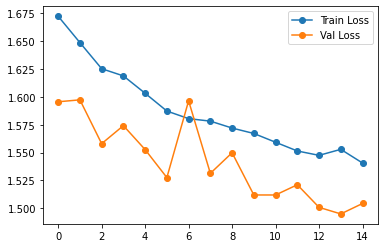

In [ ]:
plt.plot(history.history['loss'], '-o', label='Train Loss')
plt.plot(history.history['val_loss'], '-o', label = 'Val Loss')
plt.legend()

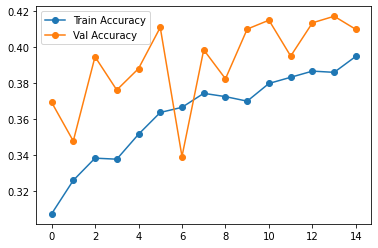

In [ ]:
plt.plot(history.history['accuracy'], '-o', label='Train Accuracy')
plt.plot(history.history['val_accuracy'], '-o', label = 'Val Accuracy')
plt.legend()

#### Evaluation and Analysis

In [ ]:
y_pred = model.predict(x_test)

In [ ]:
y_pred[2]

array([0.22645783, 0.07787503, 0.15920568, 0.05712438, 0.36055905,
       0.11877803], dtype=float32)

In [ ]:
review_predictions = []
for prediction in y_pred:
    x = prediction
    review_predictions.append(np.argmax(x))

review_predictions = np.array(review_predictions)
review_predictions.reshape(1,-1)
review_predictions.shape

(2733,)

In [ ]:
review_predictions

array([3, 4, 4, ..., 3, 1, 3])

In [ ]:
k = pd.DataFrame(review_predictions, columns = ['Label'])
k.groupby('Label')['Label'].count()

Label
0    490
1    329
2    352
3    519
4    796
5    247
Name: Label, dtype: int64

In [ ]:
#type(y_test_text)

In [ ]:
r1 = sklearn.metrics.confusion_matrix(review_predictions, y_test_text)
print(r1)

[[203  54  64  26  70  73]
 [ 36 184  39  21  30  19]
 [ 38  27 106  37  52  92]
 [ 34  47  74 273  35  56]
 [120 126 130  76 246  98]
 [ 25  17  42  23  23 117]]


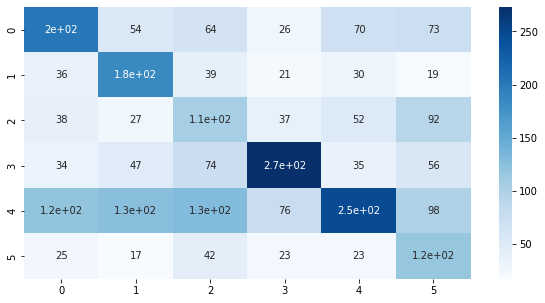

In [ ]:
f = plt.figure()
f.set_figwidth(10)
f.set_figheight(5)
sns.heatmap(r1, annot=True, cmap = 'Blues')

In [ ]:
#lb.classes_

In [ ]:
#y_test_text

In [ ]:
text_label = pd.Series(lb.inverse_transform(y_test_text))
integer_label = pd.Series(y_test_text)

In [ ]:
integer_label = integer_label.reset_index(drop = True)
#integer_label[0:20]

In [ ]:
#text_label[0:20]

In [ ]:
def make_confusion_matrix(cf,group_names=None,categories='auto',count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    '''
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html
                   
    title:         Title for the heatmap. Default is None.
    '''


    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)
    
    if title:
        plt.title(title)

In [ ]:
print(uniqueClassesMaslowLabel)
print(uniqueClassesMaslow)

[5, 1, 0, 3, 2, 4]
['stability', 'love', 'esteem', 'physiological', 'none', 'spiritual growth']


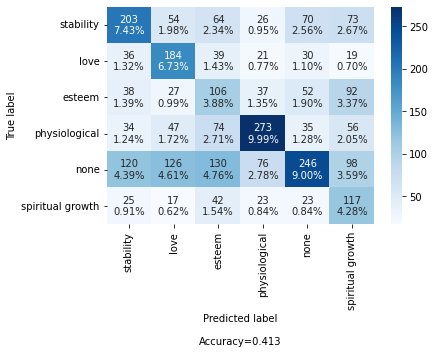

In [ ]:
make_confusion_matrix(r1, group_names=uniqueClassesMaslowLabel, categories=uniqueClassesMaslow, cmap='Blues')

In [ ]:
x_test_text = x_test_text.reset_index(drop = True)
x_test_text[0:5]

0                     One day Jim made some hot sauce.
1    A group of friends was always looking for some...
2    When I was a kid I wanted nothing more than to...
3    Vincent had two dogs that always fought.He cal...
4    Kate was leaving the grocery store at night.Sh...
Name: sentence, dtype: object

In [ ]:
print(uniqueClassesMaslowLabel)
print(uniqueClassesMaslow)

[5, 1, 0, 3, 2, 4]
['stability', 'love', 'esteem', 'physiological', 'none', 'spiritual growth']


In [ ]:
y_test

array([[0., 0., 1., 0., 0., 0.],
       [0., 1., 0., 0., 0., 0.],
       [0., 0., 0., 0., 1., 0.],
       ...,
       [0., 0., 0., 1., 0., 0.],
       [1., 0., 0., 0., 0., 0.],
       [0., 0., 0., 1., 0., 0.]], dtype=float32)

In [ ]:
count = 0
for i in range(0,len(review_predictions)):
    if review_predictions[i] != 0 and integer_label[i] == 0 and count != 10:
        print(x_test_text[i])
        count = count + 1

Tom and Mary shared a car.One day, Tom drove the car to run an errand.Mary needed the car to go to school, but the car was not available.Mary was angry at Tom.
Luke has a math test tomorrow.He has not studied at all.
Mary was walking through the hot desert.
Mary stopped at a stop sign on her way home from work.She witnessed someone run through the stop sign and get pulled over.The cop gave the person a ticket.Mary decided to be more cautious so she wouldn't miss any stop signs.She didn't miss any on the rest of the drive home.
Martin didn't like doing his homework.One day he decided to pay Will to do his homework for him.Martin enjoyed not having to do his homework.It didn't take long for Martin's bad decision to catch up with him.
The company got a call from an angry client.
Sally was painting her nails pink.
Tim was downtown with friends.He saw a cute girl walking by.His friends encouraged Tim to talk to her.Tim was too shy and chickened out.
Tim had bad luck with basketball.He never

### Making 2 classes from 6 Classes of Maslow

#### Libraries

In [ ]:
!pip install transformers
!pip install sentencepiece

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from sklearn.model_selection import train_test_split
from transformers import MarianMTModel, MarianTokenizer
from sklearn.utils import shuffle
import pandas as pd
from nltk.corpus import stopwords  
from nltk.stem import WordNetLemmatizer
from nltk.stem import PorterStemmer
from string import punctuation
from collections import Counter 
import wordcloud
from nltk.corpus import stopwords 
from textblob import Word 
import re
import nltk

In [ ]:
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

#### Cleaning Data For NLP  -> Result df2 of uniform class

In [ ]:
type1[['sentence','maslow']].groupby('maslow').count()

,sentence
maslow,
deficiency_needs,15690
growth_needs,2360
none,2543


In [ ]:
type2[['sentence','maslow']].groupby('maslow').count()

,sentence
maslow,
advanced_needs,7547
basic_needs,10503
none,2543


In [ ]:
'''
undersampling_count1 = type1[['sentence','maslow']].groupby('maslow').count().min()[0]
undersampling_count2 = type2[['sentence','maslow']].groupby('maslow').count().min()[0]
print(undersampling_count1)
print(undersampling_count2)
lis1 = list(type1['maslow'].unique())
lis2 = list(type2['maslow'].unique())
print(lis1)
print(lis2)
'''

"\nundersampling_count1 = type1[['sentence','maslow']].groupby('maslow').count().min()[0]\nundersampling_count2 = type2[['sentence','maslow']].groupby('maslow').count().min()[0]\nprint(undersampling_count1)\nprint(undersampling_count2)\nlis1 = list(type1['maslow'].unique())\nlis2 = list(type2['maslow'].unique())\nprint(lis1)\nprint(lis2)\n"

In [ ]:
# UNDERSAMPLING
'''
df1 = type1.copy()
dontSeeIndex = 1
dataframes = []
for i in range(len(lis1)):
    dataframe = 't' + str(i)
    dataframe = df1[df1['maslow'] == lis1[i]]
    dataframe = dataframe.reset_index()
    dataframe = dataframe.drop(columns = 'index')
    if i!=dontSeeIndex:
        dataframe = shuffle(dataframe)
        dataframe = dataframe.iloc[:2360][:]
    dataframes.append(dataframe)
df1 = pd.concat(dataframes)
df1 = shuffle(df1)
df1 = df1.reset_index()
df1 = df1.drop(columns = 'index')
df1[['sentence','maslow']].groupby('maslow').count()
'''

"\ndf1 = type1.copy()\ndontSeeIndex = 1\ndataframes = []\nfor i in range(len(lis1)):\n    dataframe = 't' + str(i)\n    dataframe = df1[df1['maslow'] == lis1[i]]\n    dataframe = dataframe.reset_index()\n    dataframe = dataframe.drop(columns = 'index')\n    if i!=dontSeeIndex:\n        dataframe = shuffle(dataframe)\n        dataframe = dataframe.iloc[:2360][:]\n    dataframes.append(dataframe)\ndf1 = pd.concat(dataframes)\ndf1 = shuffle(df1)\ndf1 = df1.reset_index()\ndf1 = df1.drop(columns = 'index')\ndf1[['sentence','maslow']].groupby('maslow').count()\n"

In [ ]:
df2oftype1 = type1.copy()
lb = LabelEncoder() 
df2oftype1['maslowLabel'] = lb.fit_transform(df2oftype1['maslow'])
print(df2oftype1['maslow'].unique())
print(df2oftype1['maslowLabel'].unique())

['deficiency_needs' 'growth_needs' 'none']
[0 1 2]


In [ ]:
df2oftype2 = type2.copy()
lb = LabelEncoder() 
df2oftype2['maslowLabel'] = lb.fit_transform(df2oftype2['maslow'])
print(df2oftype2['maslow'].unique())
print(df2oftype2['maslowLabel'].unique())

['basic_needs' 'advanced_needs' 'none']
[1 0 2]


In [ ]:
# UNDERSAMPLING
'''
df1 = type2.copy()
dontSeeIndex = 2
dataframes = []
for i in range(len(lis2)):
    dataframe = 't' + str(i)
    dataframe = df1[df1['maslow'] == lis2[i]]
    dataframe = dataframe.reset_index()
    dataframe = dataframe.drop(columns = 'index')
    if i!=dontSeeIndex:
        dataframe = shuffle(dataframe)
        dataframe = dataframe.iloc[:2543][:]
    dataframes.append(dataframe)
df1 = pd.concat(dataframes)
df1 = shuffle(df1)
df1 = df1.reset_index()
df1 = df1.drop(columns = 'index')
df1[['sentence','maslow']].groupby('maslow').count()
'''

"\ndf1 = type2.copy()\ndontSeeIndex = 2\ndataframes = []\nfor i in range(len(lis2)):\n    dataframe = 't' + str(i)\n    dataframe = df1[df1['maslow'] == lis2[i]]\n    dataframe = dataframe.reset_index()\n    dataframe = dataframe.drop(columns = 'index')\n    if i!=dontSeeIndex:\n        dataframe = shuffle(dataframe)\n        dataframe = dataframe.iloc[:2543][:]\n    dataframes.append(dataframe)\ndf1 = pd.concat(dataframes)\ndf1 = shuffle(df1)\ndf1 = df1.reset_index()\ndf1 = df1.drop(columns = 'index')\ndf1[['sentence','maslow']].groupby('maslow').count()\n"

In [ ]:
#df2oftype2 = df1.copy()
#lb = LabelEncoder() 
#df2oftype2['maslowLabel'] = lb.fit_transform(df2oftype2['maslow'])
#print(df2oftype2['maslow'].unique())
#print(df2oftype2['maslowLabel'].unique())

#### Uniform Model Bert for Type 1

In [ ]:
bert_preprocess = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_preprocess/3")
bert_encoder = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4")

In [ ]:
text_input = tf.keras.layers.Input(shape=(), dtype=tf.string, name='text')
preprocessed_text = bert_preprocess(text_input)
outputs = bert_encoder(preprocessed_text)
l = tf.keras.layers.Dropout(0.1, name="dropout")(outputs['pooled_output'])
l = tf.keras.layers.Dense(3, activation='softmax', name="output")(l)

In [ ]:
model = tf.keras.Model(inputs=[text_input], outputs = [l])

In [ ]:
METRICS = [
      keras.metrics.TruePositives(name='tp'),
      keras.metrics.FalsePositives(name='fp'),
      keras.metrics.TrueNegatives(name='tn'),
      keras.metrics.FalseNegatives(name='fn'), 
      keras.metrics.CategoricalCrossentropy(name='categorical_cross_entropy'),
      keras.metrics.Precision(name='precision'),
      keras.metrics.Recall(name='recall'),
      keras.metrics.AUC(name='auc'),
      keras.metrics.AUC(name='prc', curve='PR'), # precision-recall curve
      'accuracy'
]
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=METRICS)
x_train, x_test, y_train, y_test = train_test_split(df2oftype1['sentence'],df2oftype1['maslowLabel'],test_size = 0.2, random_state = 0, stratify = df2oftype1['maslowLabel'])
#x_train, x_val,y_train, y_val = train_test_split(x_train, y_train, test_size = 0.2,random_state = 0, stratify = y_train)
x_train_text = x_train 
x_test_text = x_test
y_train_text = y_train
y_test_text = y_test
print(x_train.shape)
print(x_test.shape)
#print(x_val.shape)

(16474,)
(4119,)


In [ ]:
unique, counts = np.unique(y_train, return_counts=True)
result = np.column_stack((unique, counts)) 
print (result)

[[    0 12552]
 [    1  1888]
 [    2  2034]]


In [ ]:
unique, counts = np.unique(y_test, return_counts=True)
result = np.column_stack((unique, counts)) 
print (result)

[[   0 3138]
 [   1  472]
 [   2  509]]


In [ ]:
#y_val = to_categorical(y_val)
y_train = to_categorical(y_train)
y_test =  to_categorical(y_test)

In [ ]:
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  1


In [ ]:
checkpoint_filepath = '/tmp/checkpoint'
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True)

# Model weights are saved at the end of every epoch, if it's the best seen
# so far.
history1 = model.fit(x_train, y_train,epochs=10, verbose=1, validation_data = (x_test,y_test),callbacks=[model_checkpoint_callback])

Epoch 1/10
515/515 [==============================] - 236s 432ms/step - loss: 0.7431 - tp: 12332.0000 - fp: 3882.0000 - tn: 29066.0000 - fn: 4142.0000 - categorical_cross_entropy: 0.7431 - precision: 0.7606 - recall: 0.7486 - auc: 0.8301 - prc: 0.7098 - accuracy: 0.7585 - val_loss: 0.6971 - val_tp: 3138.0000 - val_fp: 979.0000 - val_tn: 7259.0000 - val_fn: 981.0000 - val_categorical_cross_entropy: 0.6971 - val_precision: 0.7622 - val_recall: 0.7618 - val_auc: 0.8581 - val_prc: 0.7569 - val_accuracy: 0.7618
Epoch 2/10
515/515 [==============================] - 221s 430ms/step - loss: 0.7191 - tp: 12394.0000 - fp: 3847.0000 - tn: 29101.0000 - fn: 4080.0000 - categorical_cross_entropy: 0.7191 - precision: 0.7631 - recall: 0.7523 - auc: 0.8433 - prc: 0.7285 - accuracy: 0.7605 - val_loss: 0.7397 - val_tp: 3137.0000 - val_fp: 979.0000 - val_tn: 7259.0000 - val_fn: 982.0000 - val_categorical_cross_entropy: 0.7397 - val_precision: 0.7621 - val_recall: 0.7616 - val_auc: 0.8596 - val_prc: 0.7606

In [ ]:
model.load_weights(checkpoint_filepath)
model.evaluate(x_test, y_test)

129/129 [==============================] - 45s 347ms/step - loss: 0.6647 - tp: 3120.0000 - fp: 961.0000 - tn: 7277.0000 - fn: 999.0000 - categorical_cross_entropy: 0.6647 - precision: 0.7645 - recall: 0.7575 - auc: 0.8768 - prc: 0.7884 - accuracy: 0.7628


[0.6647448539733887,
 3120.0,
 961.0,
 7277.0,
 999.0,
 0.6647448539733887,
 0.7645184993743896,
 0.7574654221534729,
 0.8767637610435486,
 0.7883559465408325,
 0.7628065347671509]

In [ ]:
print(history1.history.keys())

dict_keys(['loss', 'tp', 'fp', 'tn', 'fn', 'categorical_cross_entropy', 'precision', 'recall', 'auc', 'prc', 'accuracy', 'val_loss', 'val_tp', 'val_fp', 'val_tn', 'val_fn', 'val_categorical_cross_entropy', 'val_precision', 'val_recall', 'val_auc', 'val_prc', 'val_accuracy'])


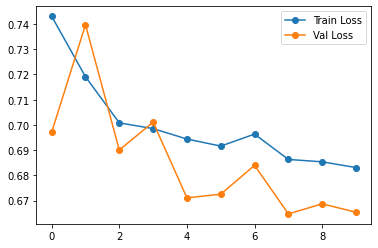

In [ ]:
plt.plot(history1.history['loss'], '-o', label='Train Loss')
plt.plot(history1.history['val_loss'], '-o', label = 'Val Loss')
plt.legend()

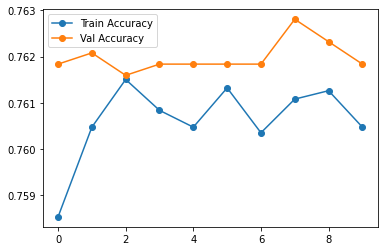

In [ ]:
plt.plot(history1.history['accuracy'], '-o', label='Train Accuracy')
plt.plot(history1.history['val_accuracy'], '-o', label = 'Val Accuracy')
plt.legend()

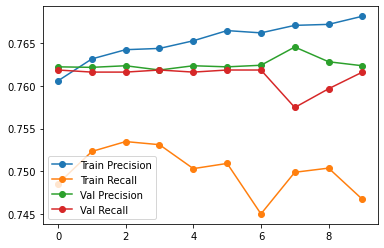

In [ ]:
plt.plot(history1.history['precision'], '-o', label='Train Precision')
plt.plot(history1.history['recall'], '-o', label = 'Train Recall')
plt.plot(history1.history['val_precision'], '-o', label='Val Precision')
plt.plot(history1.history['val_recall'], '-o', label = 'Val Recall')
plt.legend()

#### Evaluation and Analysis

In [ ]:
x_test.shape

(4119,)

In [ ]:
y_pred1 = model.predict(x_test)

In [ ]:
y_pred1[2]

array([0.73283255, 0.14648026, 0.12068721], dtype=float32)

In [ ]:
y_pred1.shape

(4119, 3)

In [ ]:
review_predictions1 = []
for prediction in y_pred1:
    x = prediction
    review_predictions1.append(np.argmax(x))

review_predictions1 = np.array(review_predictions1)
review_predictions1.reshape(1,-1)
review_predictions1.shape

(4119,)

In [ ]:
review_predictions1

array([0, 0, 0, ..., 0, 0, 0])

In [ ]:
k = pd.DataFrame(review_predictions1, columns = ['Label'])
k.groupby('Label')['Label'].count()

Label
0    4103
1      15
2       1
Name: Label, dtype: int64

In [ ]:
review_predictions1.shape

(4119,)

In [ ]:
y_test_text.shape

(4119,)

In [ ]:
#type(y_test_text)

In [ ]:
r1 = sklearn.metrics.confusion_matrix(review_predictions1, y_test_text)
print(r1)

[[3133  462  508]
 [   5    9    1]
 [   0    1    0]]


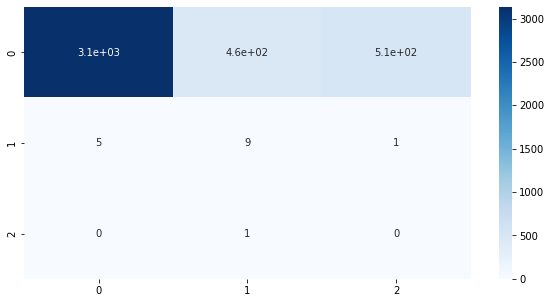

In [ ]:
f1 = plt.figure()
f1.set_figwidth(10)
f1.set_figheight(5)
sns.heatmap(r1, annot=True, cmap = 'Blues')

In [ ]:
#lb.classes_

In [ ]:
#y_test_text

In [ ]:
text_label = pd.Series(lb.inverse_transform(y_test_text))
integer_label = pd.Series(y_test_text)

In [ ]:
integer_label = integer_label.reset_index(drop = True)
#integer_label[0:20]

In [ ]:
#text_label[0:20]

In [ ]:
def make_confusion_matrix(cf,group_names=None,categories='auto',count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    '''
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html
                   
    title:         Title for the heatmap. Default is None.
    '''


    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)
    
    if title:
        plt.title(title)

In [ ]:
df2oftype1.head()
uniqueClassesMaslowLabel1 = list(df2oftype1['maslow'].unique())
uniqueClassesMaslow1 = list(df2oftype1['maslowLabel'].unique())

In [ ]:
print(uniqueClassesMaslowLabel1)
print(uniqueClassesMaslow1)

['deficiency_needs', 'growth_needs', 'none']
[0, 1, 2]


In [ ]:
print(classification_report(review_predictions1, y_test_text,target_names = ['deficiency_needs','growth_needs','none']))

                  precision    recall  f1-score   support

deficiency_needs       1.00      0.76      0.87      4103
    growth_needs       0.02      0.60      0.04        15
            none       0.00      0.00      0.00         1

        accuracy                           0.76      4119
       macro avg       0.34      0.45      0.30      4119
    weighted avg       0.99      0.76      0.86      4119



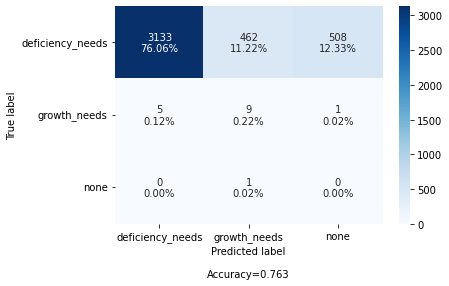

In [ ]:
make_confusion_matrix(r1, group_names=uniqueClassesMaslow1, categories=uniqueClassesMaslowLabel1, cmap='Blues')

In [ ]:
x_test_text = x_test_text.reset_index(drop = True)
x_test_text[0:5]

0          Max was trying browse the internet for fun.
1    My neighbor Steve went out for a walk today.He...
2    Today I decided to make my bed.I pulled the sh...
3    Michael was walking on the busy street.He foun...
4    Jake had wanted to be on the radio for as long...
Name: sentence, dtype: object

In [ ]:
y_test

array([[0., 1., 0.],
       [1., 0., 0.],
       [1., 0., 0.],
       ...,
       [1., 0., 0.],
       [0., 0., 1.],
       [1., 0., 0.]], dtype=float32)

In [ ]:
count = 0
for i in range(0,len(review_predictions1)):
    if review_predictions1[i] != 0 and integer_label[i] == 0 and count != 10:
        print(x_test_text[i])
        count = count + 1

Ray loved watching television.Countless hours were spent staring at the glowing screen.One day, the television broke down.Bored, Ray picked out a book lying on the shelf.Ray became more interested in books than TV from that day on.
Neil was visiting Northern Africa.His first stop was Egypt.He took a tour to learn about Egyptian history.Then he visited restaurants to taste Egyptian cuisine.
Marcus loved to play video games with all of his friends.One by one they grew into new interests leaving him behind.Marcus started feeling lonely, so he started playing online games.
Korine always loved the ocean.She had a fascination with all of the creatures that lived there too.One day she came across a beached dolphin.She called for help and got others to help her return it to sea.
Wally had been trained to work with sea life.He most often worked with dolphins.One day, he was asked to work with seals, sea lions and walruses.


#### Uniform Model Bert for Type 2

In [ ]:
df2oftype2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20593 entries, 0 to 20592
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   sentence     20593 non-null  object
 1   maslow       20593 non-null  object
 2   reiss        20593 non-null  object
 3   maslowLabel  20593 non-null  int64 
dtypes: int64(1), object(3)
memory usage: 643.7+ KB


In [ ]:
df2oftype2.head()

,sentence,maslow,reiss,maslowLabel
0,I began making fish curry for my boyfriend and I.,basic_needs,food,1
1,I began making fish curry for my boyfriend and...,advanced_needs,indep,0
2,I began making fish curry for my boyfriend and...,advanced_needs,competition,0
3,I began making fish curry for my boyfriend and...,advanced_needs,health,0
4,I began making fish curry for my boyfriend and...,none,none,2


In [ ]:
bert_preprocess = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_preprocess/3")
bert_encoder = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4")

In [ ]:
text_input = tf.keras.layers.Input(shape=(), dtype=tf.string, name='text')
preprocessed_text = bert_preprocess(text_input)
outputs = bert_encoder(preprocessed_text)
l = tf.keras.layers.Dropout(0.1, name="dropout")(outputs['pooled_output'])
l = tf.keras.layers.Dense(3, activation='softmax', name="output")(l)

In [ ]:
model = tf.keras.Model(inputs=[text_input], outputs = [l])

In [ ]:
METRICS = [
      keras.metrics.TruePositives(name='tp'),
      keras.metrics.FalsePositives(name='fp'),
      keras.metrics.TrueNegatives(name='tn'),
      keras.metrics.FalseNegatives(name='fn'), 
      keras.metrics.CategoricalCrossentropy(name='categorical_cross_entropy'),
      keras.metrics.Precision(name='precision'),
      keras.metrics.Recall(name='recall'),
      keras.metrics.AUC(name='auc'),
      keras.metrics.AUC(name='prc', curve='PR'), # precision-recall curve
      'accuracy'
]
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=METRICS)
x_train, x_test, y_train, y_test = train_test_split(df2oftype2['sentence'],df2oftype2['maslowLabel'],test_size = 0.2, random_state = 0, stratify = df2oftype2['maslowLabel'])
#x_train, x_val,y_train, y_val = train_test_split(x_train, y_train, test_size = 0.2,random_state = 0, stratify = y_train)
x_train_text = x_train 
x_test_text = x_test
y_train_text = y_train
y_test_text = y_test
print(x_train.shape)
print(x_test.shape)
#print(x_val.shape)

(16474,)
(4119,)


In [ ]:
unique, counts = np.unique(y_train, return_counts=True)
result = np.column_stack((unique, counts)) 
print (result)

[[   0 6038]
 [   1 8402]
 [   2 2034]]


In [ ]:
unique, counts = np.unique(y_test, return_counts=True)
result = np.column_stack((unique, counts)) 
print (result)

[[   0 1509]
 [   1 2101]
 [   2  509]]


In [ ]:
#y_val = to_categorical(y_val)
y_train = to_categorical(y_train)
y_test =  to_categorical(y_test)

In [ ]:
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  1


In [ ]:
checkpoint_filepath = '/tmp/checkpoint'
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True)

# Model weights are saved at the end of every epoch, if it's the best seen
# so far.
history1 = model.fit(x_train, y_train,epochs=10, verbose=1, validation_data = (x_test,y_test),callbacks=[model_checkpoint_callback])

Epoch 1/10
515/515 [==============================] - 234s 438ms/step - loss: 0.9821 - tp: 6094.0000 - fp: 5324.0000 - tn: 27624.0000 - fn: 10380.0000 - categorical_cross_entropy: 0.9821 - precision: 0.5337 - recall: 0.3699 - auc: 0.7075 - prc: 0.5099 - accuracy: 0.5084 - val_loss: 0.9487 - val_tp: 1584.0000 - val_fp: 1283.0000 - val_tn: 6955.0000 - val_fn: 2535.0000 - val_categorical_cross_entropy: 0.9487 - val_precision: 0.5525 - val_recall: 0.3846 - val_auc: 0.7266 - val_prc: 0.5417 - val_accuracy: 0.5276
Epoch 2/10
515/515 [==============================] - 222s 430ms/step - loss: 0.9426 - tp: 6940.0000 - fp: 4973.0000 - tn: 27975.0000 - fn: 9534.0000 - categorical_cross_entropy: 0.9426 - precision: 0.5826 - recall: 0.4213 - auc: 0.7375 - prc: 0.5593 - accuracy: 0.5514 - val_loss: 0.9053 - val_tp: 2026.0000 - val_fp: 1312.0000 - val_tn: 6926.0000 - val_fn: 2093.0000 - val_categorical_cross_entropy: 0.9053 - val_precision: 0.6070 - val_recall: 0.4919 - val_auc: 0.7634 - val_prc: 0.5

In [ ]:
model.load_weights(checkpoint_filepath)
model.evaluate(x_test, y_test)

129/129 [==============================] - 45s 347ms/step - loss: 0.8783 - tp: 1822.0000 - fp: 898.0000 - tn: 7340.0000 - fn: 2297.0000 - categorical_cross_entropy: 0.8783 - precision: 0.6699 - recall: 0.4423 - auc: 0.7835 - prc: 0.6415 - accuracy: 0.6038


[0.8783366680145264,
 1822.0,
 898.0,
 7340.0,
 2297.0,
 0.8783366680145264,
 0.6698529124259949,
 0.4423403739929199,
 0.7834696769714355,
 0.6414793729782104,
 0.6037873029708862]

In [ ]:
print(history1.history.keys())

dict_keys(['loss', 'tp', 'fp', 'tn', 'fn', 'categorical_cross_entropy', 'precision', 'recall', 'auc', 'prc', 'accuracy', 'val_loss', 'val_tp', 'val_fp', 'val_tn', 'val_fn', 'val_categorical_cross_entropy', 'val_precision', 'val_recall', 'val_auc', 'val_prc', 'val_accuracy'])


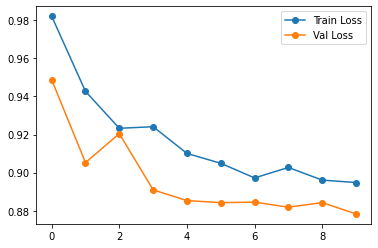

In [ ]:
plt.plot(history1.history['loss'], '-o', label='Train Loss')
plt.plot(history1.history['val_loss'], '-o', label = 'Val Loss')
plt.legend()

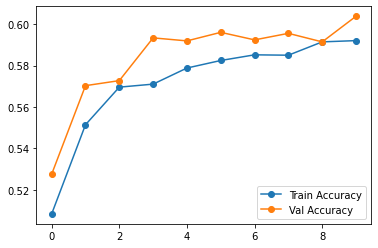

In [ ]:
plt.plot(history1.history['accuracy'], '-o', label='Train Accuracy')
plt.plot(history1.history['val_accuracy'], '-o', label = 'Val Accuracy')
plt.legend()

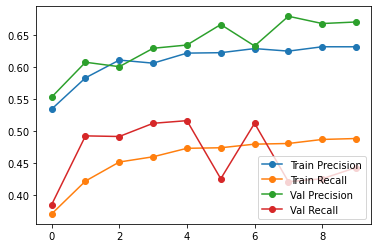

In [ ]:
plt.plot(history1.history['precision'], '-o', label='Train Precision')
plt.plot(history1.history['recall'], '-o', label = 'Train Recall')
plt.plot(history1.history['val_precision'], '-o', label='Val Precision')
plt.plot(history1.history['val_recall'], '-o', label = 'Val Recall')
plt.legend()

#### Evaluation and Analysis

In [ ]:
y_pred2 = model.predict(x_test)

In [ ]:
y_pred2[2]

array([0.272291  , 0.61634105, 0.11136786], dtype=float32)

In [ ]:
review_predictions2 = []
for prediction in y_pred2:
    x = prediction
    review_predictions2.append(np.argmax(x))

review_predictions2 = np.array(review_predictions2)
review_predictions2.reshape(1,-1)
review_predictions2.shape

(4119,)

In [ ]:
review_predictions2

array([0, 0, 1, ..., 1, 0, 1])

In [ ]:
k = pd.DataFrame(review_predictions2, columns = ['Label'])
k.groupby('Label')['Label'].count()

Label
0    1151
1    2876
2      92
Name: Label, dtype: int64

In [ ]:
#type(y_test_text)

In [ ]:
r2 = sklearn.metrics.confusion_matrix(review_predictions2, y_test_text)
print(r2)

[[ 720  329  102]
 [ 768 1734  374]
 [  21   38   33]]


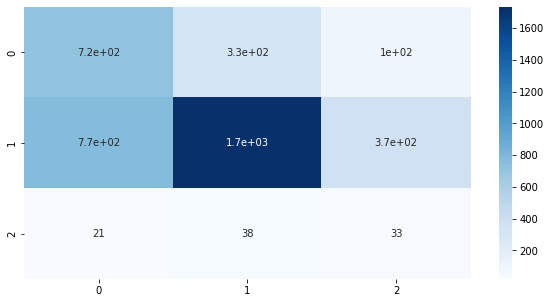

In [ ]:
f2 = plt.figure()
f2.set_figwidth(10)
f2.set_figheight(5)
sns.heatmap(r2, annot=True, cmap = 'Blues')

In [ ]:
#lb.classes_

In [ ]:
#y_test_text

In [ ]:
text_label = pd.Series(lb.inverse_transform(y_test_text))
integer_label = pd.Series(y_test_text)

In [ ]:
integer_label = integer_label.reset_index(drop = True)
#integer_label[0:20]

In [ ]:
#text_label[0:20]

In [ ]:
def make_confusion_matrix(cf,group_names=None,categories='auto',count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    '''
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html
                   
    title:         Title for the heatmap. Default is None.
    '''


    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)
    
    if title:
        plt.title(title)

In [ ]:
df2oftype2.head()
uniqueClassesMaslowLabel2 = list(df2oftype2['maslow'].unique())
uniqueClassesMaslow2 = list(df2oftype2['maslowLabel'].unique())

In [ ]:
print(uniqueClassesMaslowLabel2)
print(uniqueClassesMaslow2)

['basic_needs', 'advanced_needs', 'none']
[1, 0, 2]


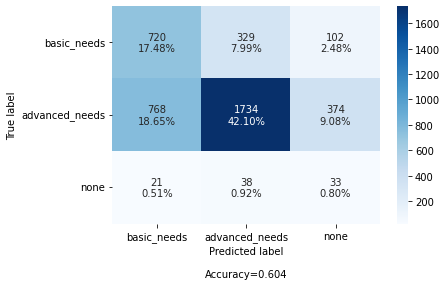

In [ ]:
make_confusion_matrix(r2, group_names=uniqueClassesMaslow2, categories=uniqueClassesMaslowLabel2, cmap='Blues')

In [ ]:
uniqueClassesMaslowLabel2

['basic_needs', 'advanced_needs', 'none']

In [ ]:
uniqueClassesMaslow2

[1, 0, 2]

In [ ]:
print(classification_report(review_predictions2, y_test_text,target_names = ['advanced_needs','basic_needs','none']))

                precision    recall  f1-score   support

advanced_needs       0.48      0.63      0.54      1151
   basic_needs       0.83      0.60      0.70      2876
          none       0.06      0.36      0.11        92

      accuracy                           0.60      4119
     macro avg       0.46      0.53      0.45      4119
  weighted avg       0.71      0.60      0.64      4119



In [ ]:
x_test_text = x_test_text.reset_index(drop = True)
x_test_text[0:5]

0    Lamie Mcramie knew it had to be done.His entir...
1    I received poor test results from the last exa...
2              My Dad and I went to an amusement park.
3                      I took my family to the movies.
4    I was taking a walk down the street and heard ...
Name: sentence, dtype: object

In [ ]:
y_test

array([[0., 1., 0.],
       [1., 0., 0.],
       [0., 1., 0.],
       ...,
       [1., 0., 0.],
       [1., 0., 0.],
       [1., 0., 0.]], dtype=float32)

In [ ]:
count = 0
for i in range(0,len(review_predictions2)):
    if review_predictions2[i] != 0 and integer_label[i] == 0 and count != 10:
        print(x_test_text[i])
        count = count + 1

Doug bought himself a boat.
I had not went to church at all in the past several years.I recently decided that I should start going again.The only problem was I didn't know where to go.I decided to try a Baptist church in my town.
I needed to buy new hinges for one of my doors.The nearest hardware store was forty minutes away by bus.I gathered my resourced and headed out.Including waiting for the bus it took me forty five minutes to arrive.
Sandy was invited to a slumber party at her friend's house.Sandy decided to decline the invitation because of a secret.
Pat enjoyed planting a garden every spring.
My son watched Stranger Things on Netflix.He got interested in paranormal shows.He started watching X-Files.
Craig was wandering along the seashore after a breakup.As he walked down the beach, he saw a glimmer in the water.
Karen rejected the supplemental coverage on her insurance.She wondered, after all, how often someone was struck by a car.Karen decided to text that question to her sist

### Augmentations

#### Testing Augmetations for the Final_data

Base Model(Bert with non uniform classes) Gave: 46.8 % Accuracy

*  62% Precission
* 16%  Recall



In [ ]:
import pandas as pd 
final_data = pd.read_csv('Data.csv')

In [ ]:
#bert_preprocess = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_preprocess/3")
#bert_encoder = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4")

In [ ]:
#x_train, x_test, y_train, y_test = train_test_split(final_data['sentence'],final_data['maslow'],test_size = 0.2, random_state = 0, stratify = final_data['maslow'])

In [ ]:
#text_input = tf.keras.layers.Input(shape=(), dtype=tf.string, name='text')
#preprocessed_text = bert_preprocess(text_input)
#l = bert_encoder(preprocessed_text)

In [ ]:
#from transformers import pipeline 
#model = pipeline('fill-mask', model = 'bert-base-uncased')
#pred = model('What is [MASK] name?')
#pred

In [ ]:
#from transformers import BertTokenizer, TFBertModel 
#tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
#model = TFBertModel.from_pretrained('bert-base-uncased')
#text = "What is your name?"
#encoded_input = tokenizer(text, return_tensors = 'tf')
#model(encoded_input)

In [ ]:
!pip install textattack

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 415 kB 8.7 MB/s 
     |████████████████████████████████| 101 kB 9.9 MB/s 
     |████████████████████████████████| 60 kB 6.1 MB/s 
     |████████████████████████████████| 769 kB 42.4 MB/s 
     |████████████████████████████████| 3.6 MB 46.8 MB/s 
     |████████████████████████████████| 401 kB 44.5 MB/s 
     |████████████████████████████████| 290 kB 61.4 MB/s 
     |████████████████████████████████| 41.4 MB 1.5 MB/s 
     |████████████████████████████████| 212 kB 22.0 MB/s 
     |████████████████████████████████| 141 kB 44.7 MB/s 
     |████████████████████████████████| 56 kB 4.6 MB/s 
     |████████████████████████████████| 4.4 MB 42.3 MB/s 
     |████████████████████████████████| 4.4 MB 37.0 MB/s 
     |████████████████████████████████| 4.2 MB 34.2 MB/s 
     |████████████████████████████████| 4.2 MB 43.2 MB/s 
     |███████████████████████████████

https://www.analyticsvidhya.com/blog/2022/02/text-data-augmentation-in-natural-language-processing-with-texattack/

In [ ]:
from textattack.augmentation import EmbeddingAugmenter,WordNetAugmenter,EasyDataAugmenter,CharSwapAugmenter,CheckListAugmenter,CLAREAugmenter
#import tensorflow_text
embed_aug = EmbeddingAugmenter()
wordnet_aug = WordNetAugmenter()
easy_aug = EasyDataAugmenter()
charswap_aug = CharSwapAugmenter()
checklist_aug = CheckListAugmenter()
clare_aug = CLAREAugmenter(model='distilroberta-base', tokenizer='distilroberta-base')  # CLARE builds on a pre-trained masked language model and modifies the inputs in a contextaware manner. 

[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
If you want to use `RobertaLMHeadModel` as a standalone, add `is_decoder=True.`


In [ ]:
text = "A boy pick up a rock at the beach.He felt the texture and inspected it for smoothness"
print(text)
print(embed_aug.augment(text))    #  augments text by replacing words with neighbors in the counter-fitted embedding space ensure their 
                                  # cosine similarity is at least 0.8.
print(wordnet_aug.augment(text))  # augments text by replacing words with synonyms provided by WordNet.
print(easy_aug.augment(text))     # augments text with a combination of word insertions, substitutions, and deletions.
print(charswap_aug.augment(text)) # augments text by substituting, deleting, inserting, and swapping adjacent characters
print(checklist_aug.augment(text)) # augments text by contraction/extension and by substituting names, locations and numbers.
#print(clare_aug.augment(text))     # augments text by replacing, inserting, and merging with a pre-trained masked language model.

A boy pick up a rock at the beach.He felt the texture and inspected it for smoothness
['A boy pick up a rock at the beach.He felt the texture and inspected it for sweetness']
['A boy filling up a rock at the beach.He felt the texture and inspected it for smoothness']
['A boy pick up a rock at the beach.He felt the and inspected it for smoothness', 'A boy pick son up a rock at the beach.He felt the texture and inspected it for smoothness', 'A boy woof up a rock at the beach.He felt the texture and inspected it for smoothness', 'beach boy pick up a rock at the A.He felt the texture and inspected it for smoothness']
['A boy pick up a ock at the beach.He felt the texture and inspected it for smoothness']
['A boy pick up a rock at the beach.He felt the texture and inspected it for smoothness']


In [ ]:
final_data.iloc[88][0]

'Every Sunday I get pizza.This Sunday I decided to try a new place.'

In [ ]:
text = "A monkey watched a crowd of children walk past his cage."
print(text)
print(embed_aug.augment(text))    
print(wordnet_aug.augment(text))  
print(easy_aug.augment(text))     
print(charswap_aug.augment(text)) 
print(checklist_aug.augment(text)) 
#print(clare_aug.augment(text))

A monkey watched a crowd of children walk past his cage.
['A ape watched a crowd of children walk past his cage.']
['A rapscallion watched a crowd of children walk past his cage.']
['A monkey watched a crowd of children walk past cage.', 'A monkey walk a crowd of children watched past his cage.', 'A monkey see a crowd of children walk past his cage.', 'A monkey watched a crowd of axerophthol children walk past his cage.']
['A monkey watched a crowd of children walk past his cag.']
['A monkey watched a crowd of children walk past his cage.']


In [ ]:
text = 'Yoshio was 31 years old and played modern video games.One day he had a hankering to play the old classic Nintendo.'
print(text)
print(embed_aug.augment(text))    
print(wordnet_aug.augment(text))  
print(easy_aug.augment(text))     
print(charswap_aug.augment(text)) 
print(checklist_aug.augment(text)) 
print(clare_aug.augment(text))

Yoshio was 31 years old and played modern video games.One day he had a hankering to play the old classic Nintendo.
['Yoshio was 31 years old and played modern video games.One day he had a hankering to play the former typical Nintendo.']
['Yoshio was 31 years honest-to-goodness and played modern video games.One day he had a hankering to spiel the old classic Nintendo.']
['Yoshio was 31 years old and played modern video games.One day he had He a hankering to play the old classic Nintendo.', 'Yoshio was 31 years old and played modern video games.One Day he had a hankering to meet the old classic Nintendo.', 'Yoshio was 31 years old and played to video games.One day he had a hankering modern play the old classic Nintendo.', 'Yoshio was 31 years old and played modern games.One day he had hankering to play the old classic Nintendo.']
['Yohsio was 31 years old and played modern video games.jne day he had a hankering to play the old classic Nintendo.']
['Melanee was 49 years old and played mod

In [ ]:
test = final_data[final_data['maslow'] == 'physiological']
test.shape

(2277, 3)

In [ ]:
test.head()

,sentence,maslow,reiss
0,I began making fish curry for my boyfriend and I.,physiological,food
11,Ray couldn't get an irritating tune out of his...,physiological,rest
12,Ray couldn't get an irritating tune out of his...,physiological,rest
25,Manuel was having a difficult time paying his ...,physiological,none
29,Kija has been researching methods of healthy e...,physiological,food


https://www.analyticsvidhya.com/blog/2021/08/nlpaug-a-python-library-to-augment-your-text-data/

In [ ]:
!pip install nlpaug

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 410 kB 25.9 MB/s 


In [ ]:
import os
os.environ["MODEL_DIR"] = '../model'

In [ ]:
import nlpaug.augmenter.char as nac
import nlpaug.augmenter.word as naw
import nlpaug.augmenter.sentence as nas
import nlpaug.flow as nafc

from nlpaug.util import Action

/usr/local/lib/python3.7/dist-packages/resampy/interpn.py:114: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.
  _resample_loop_p(x, t_out, interp_win, interp_delta, num_table, scale, y)


In [ ]:
test_sentence = 'A boy pick up a rock at the beach.He felt the texture and inspected it for smoothness'

In [ ]:
aug = naw.ContextualWordEmbsAug(
    model_path='bert-base-uncased', action="insert")
augmented_text = aug.augment(test_sentence)
print("Original:")
print(test_sentence)
print("Augmented Text:")
print(augmented_text)

Original:
A boy pick up a rock at the beach.He felt the texture and inspected it for smoothness
Augmented Text:
['a boy pick it up on a rock at the beach. then he easily felt the texture texture and inspected towards it for smoothness']


In [ ]:
test_sentence = test.iloc[0][0]
aug = naw.ContextualWordEmbsAug(
    model_path='roberta-base', action="substitute")
augmented_text = aug.augment(test_sentence)
print("Original:")
print(test_sentence)
print("Augmented Text:")
print(augmented_text)

Original:
I began making fish curry for my boyfriend and I.
Augmented Text:
['I learned making fish scales through my boyfriend Ben I.']


In [ ]:
test_sentence = test.iloc[0][0]
aug = naw.SynonymAug(aug_src='wordnet')
augmented_text = aug.augment(test_sentence)
print("Original:")
print(test_sentence)
print("Augmented Text:")
print(augmented_text)

Original:
I began making fish curry for my boyfriend and I.
Augmented Text:
['I began making fish curry for my fellow and One.']


https://github.com/makcedward/nlpaug/blob/master/example/textual_augmenter.ipynb

https://github.com/makcedward/nlpaug#augmenter

https://pypi.org/project/nlpaug/

https://www.analyticsvidhya.com/blog/2021/08/nlpaug-a-python-library-to-augment-your-text-data/

https://www.analyticsvidhya.com/blog/2022/02/text-data-augmentation-in-natural-language-processing-with-texattack/

https://textattack.readthedocs.io/en/latest/apidoc/textattack.augmentation.html

#### Augmentation for any type of Maslow Category Ready

In [ ]:
final_data = pd.read_csv('Data.csv')
final_data.head()

,sentence,maslow,reiss
0,I began making fish curry for my boyfriend and I.,physiological,food
1,I began making fish curry for my boyfriend and...,spiritual growth,indep
2,I began making fish curry for my boyfriend and...,esteem,competition
3,I began making fish curry for my boyfriend and...,spiritual growth,health
4,I began making fish curry for my boyfriend and...,none,none


In [ ]:
# Get the name of the first model
first_model_name = 'Helsinki-NLP/opus-mt-en-fr'

# Get the tokenizer
first_model_tkn = MarianTokenizer.from_pretrained(first_model_name)

# Load the pretrained model based on the name
first_model = MarianMTModel.from_pretrained(first_model_name)

/usr/local/lib/python3.7/dist-packages/transformers/models/marian/tokenization_marian.py:198: UserWarning: Recommended: pip install sacremoses.
  warnings.warn("Recommended: pip install sacremoses.")


In [ ]:
# Get the name of the second model
second_model_name = 'Helsinki-NLP/opus-mt-fr-en'

# Get the tokenizer
second_model_tkn = MarianTokenizer.from_pretrained(second_model_name)

# Load the pretrained model based on the name
second_model = MarianMTModel.from_pretrained(second_model_name)

/usr/local/lib/python3.7/dist-packages/transformers/models/marian/tokenization_marian.py:198: UserWarning: Recommended: pip install sacremoses.
  warnings.warn("Recommended: pip install sacremoses.")


In [ ]:
sentences = []
for i in range(final_data.shape[0]):
    sentences.append(final_data.iloc[i][0])
len(sentences)

20593

In [ ]:
final_data[['maslow','sentence']].groupby(['maslow']).count()

,sentence
maslow,
esteem,5187
love,4502
none,2543
physiological,2277
spiritual growth,2360
stability,3724


In [ ]:
print(final_data[['maslow','sentence']].groupby(['maslow']).count().max()[0])

5187


In [ ]:
dataframes = []
over_sampling_number =  final_data[['maslow','sentence']].groupby(['maslow']).count().max()[0]
unique_maslow_list = list(final_data['maslow'].unique())
for i in range(len(unique_maslow_list)):
    filter = final_data['maslow'] == unique_maslow_list[i]
    dataframe = final_data[filter]
    print(dataframe['maslow'].unique(),dataframe.shape[0])
    dataframes.append(dataframe)

['physiological'] 2277
['spiritual growth'] 2360
['esteem'] 5187
['none'] 2543
['love'] 4502
['stability'] 3724


In [ ]:
sentences_list = []
for dataframe in dataframes:
    sentences = []
    if dataframe.shape[0] < over_sampling_number:
        dataframe = shuffle(dataframe)
        samples_to_be_taken_for_augmentation = (over_sampling_number - dataframe.shape[0])
        dataframe = dataframe[0:samples_to_be_taken_for_augmentation]
        sentences = list(dataframe['sentence'])
        print(len(sentences),dataframe.shape[0],dataframe['maslow'].unique())
        sentences_list.append(sentences)

2277 2277 ['physiological']
2360 2360 ['spiritual growth']
2543 2543 ['none']
685 685 ['love']
1463 1463 ['stability']


In [ ]:
len(sentences_list)

5

In [ ]:
len(sentences_list[2])

2543

In [ ]:
final_augmented_texts = []

In [ ]:
def format_batch_texts(language_code, batch_texts):
    formated_bach = [">>{}<< {}".format(language_code, text) for text in batch_texts]
    return formated_bach


def perform_translation(batch_texts, model, tokenizer, language="fr"):
    # Prepare the text data into appropriate format for the model
    formated_batch_texts = format_batch_texts(language, batch_texts)
    
    # Generate translation using model
    translated = model.generate(**tokenizer(formated_batch_texts, return_tensors="pt", padding=True))

    # Convert the generated tokens indices back into text
    translated_texts = [tokenizer.decode(t, skip_special_tokens=True) for t in translated]
    
    return translated_texts


def combine_texts(original_texts, back_translated_batch):
    return set(original_texts + back_translated_batch) 

def perform_back_translation_with_augmentation(batch_texts, original_language="en", temporary_language="fr"):
    # Translate from Original to Temporary Language
    tmp_translated_batch = perform_translation(batch_texts, first_model, first_model_tkn, temporary_language)
    # Translate Back to English
    back_translated_batch = perform_translation(tmp_translated_batch, second_model, second_model_tkn, original_language)
    # Return The Final Result
    return combine_texts(sentences, back_translated_batch)
    
# Execute the function for Data Augmentation


#augmented_sentences = []
#for i in range(len(sentences_list)):
sentences = sentences_list[2]
sentences = sentences[2500:2544]
final_augmented = perform_back_translation_with_augmentation(sentences)
final_augmented = list(final_augmented)
print(len(final_augmented))
final_augmented_texts.extend(final_augmented)
print(len(final_augmented_texts))

/usr/local/lib/python3.7/dist-packages/transformers/generation_utils.py:1207: UserWarning: Neither `max_length` nor `max_new_tokens` have been set, `max_length` will default to 512 (`self.config.max_length`). Controlling `max_length` via the config is deprecated and `max_length` will be removed from the config in v5 of Transformers -- we recommend using `max_new_tokens` to control the maximum length of the generation.
  UserWarning,


84
4844


In [ ]:
category = []
for i in range(len(final_augmented_texts)):
    category.append('none')

In [ ]:
df = pd.DataFrame(list(zip(final_augmented_texts, category)),
               columns =['sentence', 'maslow'])
df.tail()

,sentence,maslow
4839,Kylie was at the mall looking for a new sweate...,none
4840,When I was at cub scout camp we all ate in the...,none
4841,Angie lit up a cigarette.She saw a young homel...,none
4842,Ron wanted a car.,none
4843,Cindy was playing with her mom's phone.When he...,none


In [ ]:
df.to_csv('augmented.csv',index = False)
from google.colab import files 
files.download('augmented.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
none_category = final_data[final_data['maslow'] == 'none']
none_category = none_category[['sentence','maslow']]
none_category['original'] = 1
none_category.head()

,sentence,maslow,original
4,I began making fish curry for my boyfriend and...,none,1
9,Ray couldn't get an irritating tune out of his...,none,1
26,Kija has been researching methods of healthy e...,none,1
30,Kija has been researching methods of healthy e...,none,1
31,Billy noticed he had trouble reading the chalk...,none,1


In [ ]:
none_category.shape

(2543, 3)

In [ ]:
none_category_augmented = pd.read_csv('augmented_none.csv')
none_category_augmented['original'] = 0
none_category_augmented.head()

,sentence,maslow,original
0,Frank couldn't sleep.,none,0
1,Donald was afraid of spiders.,none,0
2,Jane was eating for lunch.She didn't have her ...,none,0
3,Kate had a small box for garbage in her room n...,none,0
4,Lilo was always being tagged in awful photos.H...,none,0


In [ ]:
none_category_augmented.shape

(4844, 3)

In [ ]:
df = none_category.copy()
df = df.append(none_category_augmented)
df.head()

,sentence,maslow,original
4,I began making fish curry for my boyfriend and...,none,1
9,Ray couldn't get an irritating tune out of his...,none,1
26,Kija has been researching methods of healthy e...,none,1
30,Kija has been researching methods of healthy e...,none,1
31,Billy noticed he had trouble reading the chalk...,none,1


In [ ]:
df.shape

(7387, 3)

In [ ]:
df = df.drop_duplicates(keep='first')

In [ ]:
df = df.reset_index() 
df.drop(columns = ['index'],inplace = True) 
df.head()

,sentence,maslow,original
0,I began making fish curry for my boyfriend and...,none,1
1,Ray couldn't get an irritating tune out of his...,none,1
2,Kija has been researching methods of healthy e...,none,1
3,Kija has been researching methods of healthy e...,none,1
4,Billy noticed he had trouble reading the chalk...,none,1


In [ ]:
df[['original','sentence']].groupby('original').count()

,sentence
original,
0,4843
1,2543


In [ ]:
df1 = df[['sentence','maslow']]

In [ ]:
df1 = df1.drop_duplicates(keep = 'first')

In [ ]:
df1.shape

(4843, 2)

In [ ]:
df1.head()

,sentence,maslow
0,I began making fish curry for my boyfriend and...,none
1,Ray couldn't get an irritating tune out of his...,none
2,Kija has been researching methods of healthy e...,none
3,Kija has been researching methods of healthy e...,none
4,Billy noticed he had trouble reading the chalk...,none


In [ ]:
df1.to_csv('final_none.csv',index = False)
from google.colab import files 
files.download('final_none.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Making 2 classes from 6 Classes of Maslow and training after augmentations

#### Libraries

In [ ]:
!pip install -q -U "tensorflow-text==2.8.*"
!pip install -q tf-models-official==2.7.0
!pip install transformers

     |████████████████████████████████| 4.9 MB 8.5 MB/s 
     |████████████████████████████████| 1.8 MB 8.5 MB/s 
     |████████████████████████████████| 43 kB 2.2 MB/s 
     |████████████████████████████████| 238 kB 56.3 MB/s 
     |████████████████████████████████| 1.1 MB 55.1 MB/s 
     |████████████████████████████████| 596 kB 53.8 MB/s 
     |████████████████████████████████| 99 kB 10.4 MB/s 
     |████████████████████████████████| 352 kB 47.1 MB/s 
     |████████████████████████████████| 1.2 MB 61.8 MB/s 
     |████████████████████████████████| 116 kB 62.2 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 4.7 MB 7.1 MB/s 
     |████████████████████████████████| 6.6 MB 50.4 MB/s 
     |████████████████████████████████| 101 kB 8.3 MB/s 


In [ ]:
import pandas as pd 
import numpy as np
import seaborn as sns 
import matplotlib.pyplot as plt
from sklearn.utils import shuffle
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from tensorflow.keras.utils import to_categorical
from sklearn.metrics import classification_report
import sklearn

import os
import shutil
import tensorflow as tf
import tensorflow_hub as hub
import tensorflow_text as text
from official.nlp import optimization  # to create AdamW optimizer
import keras
tf.get_logger().setLevel('ERROR')

from nltk.corpus import stopwords  
from nltk.stem import WordNetLemmatizer
from nltk.stem import PorterStemmer
from string import punctuation
from collections import Counter 
import wordcloud
from nltk.corpus import stopwords 
from textblob import Word 
import re
import nltk

In [ ]:
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [ ]:
final_data = pd.read_csv('Data.csv')
final_data = final_data[final_data['maslow'] != 'none']
final_data = final_data[['sentence','maslow']]
final_none = pd.read_csv('final_none.csv')
frames = [final_data, final_none]
result = pd.concat(frames)
from sklearn.utils import shuffle
result = shuffle(result)
result['maslow'].unique()

array(['none', 'esteem', 'love', 'spiritual growth', 'stability',
       'physiological'], dtype=object)

In [ ]:
final_data = result.copy()
final_data[['sentence','maslow']].groupby('maslow').count()

,sentence
maslow,
esteem,5187
love,4502
none,4843
physiological,2277
spiritual growth,2360
stability,3724


https://canadacollege.edu/dreamers/docs/Maslows-Hierarchy-of-Needs.pdf

In [ ]:
final_data['maslow'].unique()

array(['none', 'esteem', 'love', 'spiritual growth', 'stability',
       'physiological'], dtype=object)

In [ ]:
type1 = final_data.copy() 
type2 = final_data.copy()
type1['maslow'] = type1['maslow'].replace(['physiological','esteem','love','stability','spiritual growth'],['deficiency_needs','deficiency_needs','deficiency_needs','deficiency_needs','growth_needs'])
type2['maslow'] = type2['maslow'].replace(['physiological','love','stability','esteem','spiritual growth'],['basic_needs','basic_needs','basic_needs','advanced_needs','advanced_needs'])
print(type1['maslow'].unique())
print(type2['maslow'].unique())

['none' 'deficiency_needs' 'growth_needs']
['none' 'advanced_needs' 'basic_needs']


#### Cleaning Data For NLP  -> Result df2oftype2, df2oftype1 of uniform class

In [ ]:
type1[['sentence','maslow']].groupby('maslow').count()

,sentence
maslow,
deficiency_needs,15690
growth_needs,2360
none,4843


In [ ]:
type2[['sentence','maslow']].groupby('maslow').count()

,sentence
maslow,
advanced_needs,7547
basic_needs,10503
none,4843


In [ ]:
'''
undersampling_count1 = type1[['sentence','maslow']].groupby('maslow').count().min()[0]
undersampling_count2 = type2[['sentence','maslow']].groupby('maslow').count().min()[0]
print(undersampling_count1)
print(undersampling_count2)
lis1 = list(type1['maslow'].unique())
lis2 = list(type2['maslow'].unique())
print(lis1)
print(lis2)
'''

"\nundersampling_count1 = type1[['sentence','maslow']].groupby('maslow').count().min()[0]\nundersampling_count2 = type2[['sentence','maslow']].groupby('maslow').count().min()[0]\nprint(undersampling_count1)\nprint(undersampling_count2)\nlis1 = list(type1['maslow'].unique())\nlis2 = list(type2['maslow'].unique())\nprint(lis1)\nprint(lis2)\n"

In [ ]:
# UNDERSAMPLING
'''
df1 = type1.copy()
dontSeeIndex = 1
dataframes = []
for i in range(len(lis1)):
    dataframe = 't' + str(i)
    dataframe = df1[df1['maslow'] == lis1[i]]
    dataframe = dataframe.reset_index()
    dataframe = dataframe.drop(columns = 'index')
    if i!=dontSeeIndex:
        dataframe = shuffle(dataframe)
        dataframe = dataframe.iloc[:2360][:]
    dataframes.append(dataframe)
df1 = pd.concat(dataframes)
df1 = shuffle(df1)
df1 = df1.reset_index()
df1 = df1.drop(columns = 'index')
df1[['sentence','maslow']].groupby('maslow').count()
'''

"\ndf1 = type1.copy()\ndontSeeIndex = 1\ndataframes = []\nfor i in range(len(lis1)):\n    dataframe = 't' + str(i)\n    dataframe = df1[df1['maslow'] == lis1[i]]\n    dataframe = dataframe.reset_index()\n    dataframe = dataframe.drop(columns = 'index')\n    if i!=dontSeeIndex:\n        dataframe = shuffle(dataframe)\n        dataframe = dataframe.iloc[:2360][:]\n    dataframes.append(dataframe)\ndf1 = pd.concat(dataframes)\ndf1 = shuffle(df1)\ndf1 = df1.reset_index()\ndf1 = df1.drop(columns = 'index')\ndf1[['sentence','maslow']].groupby('maslow').count()\n"

In [ ]:
df2oftype1 = type1.copy()
lb = LabelEncoder() 
df2oftype1['maslowLabel'] = lb.fit_transform(df2oftype1['maslow'])
print(df2oftype1['maslow'].unique())
print(df2oftype1['maslowLabel'].unique())

['none' 'deficiency_needs' 'growth_needs']
[2 0 1]


In [ ]:
df2oftype2 = type2.copy()
lb = LabelEncoder() 
df2oftype2['maslowLabel'] = lb.fit_transform(df2oftype2['maslow'])
print(df2oftype2['maslow'].unique())
print(df2oftype2['maslowLabel'].unique())

['none' 'advanced_needs' 'basic_needs']
[2 0 1]


In [ ]:
# UNDERSAMPLING
'''
df1 = type2.copy()
dontSeeIndex = 2
dataframes = []
for i in range(len(lis2)):
    dataframe = 't' + str(i)
    dataframe = df1[df1['maslow'] == lis2[i]]
    dataframe = dataframe.reset_index()
    dataframe = dataframe.drop(columns = 'index')
    if i!=dontSeeIndex:
        dataframe = shuffle(dataframe)
        dataframe = dataframe.iloc[:2543][:]
    dataframes.append(dataframe)
df1 = pd.concat(dataframes)
df1 = shuffle(df1)
df1 = df1.reset_index()
df1 = df1.drop(columns = 'index')
df1[['sentence','maslow']].groupby('maslow').count()
'''

"\ndf1 = type2.copy()\ndontSeeIndex = 2\ndataframes = []\nfor i in range(len(lis2)):\n    dataframe = 't' + str(i)\n    dataframe = df1[df1['maslow'] == lis2[i]]\n    dataframe = dataframe.reset_index()\n    dataframe = dataframe.drop(columns = 'index')\n    if i!=dontSeeIndex:\n        dataframe = shuffle(dataframe)\n        dataframe = dataframe.iloc[:2543][:]\n    dataframes.append(dataframe)\ndf1 = pd.concat(dataframes)\ndf1 = shuffle(df1)\ndf1 = df1.reset_index()\ndf1 = df1.drop(columns = 'index')\ndf1[['sentence','maslow']].groupby('maslow').count()\n"

In [ ]:
#df2oftype2 = df1.copy()
#lb = LabelEncoder() 
#df2oftype2['maslowLabel'] = lb.fit_transform(df2oftype2['maslow'])
#print(df2oftype2['maslow'].unique())
#print(df2oftype2['maslowLabel'].unique())

#### Uniform Model Bert for Type 1

In [ ]:
bert_preprocess = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_preprocess/3")
bert_encoder = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4")

In [ ]:
text_input = tf.keras.layers.Input(shape=(), dtype=tf.string, name='text')
preprocessed_text = bert_preprocess(text_input)
outputs = bert_encoder(preprocessed_text)
l = tf.keras.layers.Dropout(0.1, name="dropout")(outputs['pooled_output'])
l = tf.keras.layers.Dense(3, activation='softmax', name="output")(l)

In [ ]:
model = tf.keras.Model(inputs=[text_input], outputs = [l])

In [ ]:
METRICS = [
      keras.metrics.TruePositives(name='tp'),
      keras.metrics.FalsePositives(name='fp'),
      keras.metrics.TrueNegatives(name='tn'),
      keras.metrics.FalseNegatives(name='fn'), 
      keras.metrics.CategoricalCrossentropy(name='categorical_cross_entropy'),
      keras.metrics.Precision(name='precision'),
      keras.metrics.Recall(name='recall'),
      keras.metrics.AUC(name='auc'),
      keras.metrics.AUC(name='prc', curve='PR'), # precision-recall curve
      'accuracy'
]
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=METRICS)
x_train, x_test, y_train, y_test = train_test_split(df2oftype1['sentence'],df2oftype1['maslowLabel'],test_size = 0.2, random_state = 0, stratify = df2oftype1['maslowLabel'])
#x_train, x_val,y_train, y_val = train_test_split(x_train, y_train, test_size = 0.2,random_state = 0, stratify = y_train)
x_train_text = x_train 
x_test_text = x_test
y_train_text = y_train
y_test_text = y_test
print(x_train.shape)
print(x_test.shape)
#print(x_val.shape)

(18314,)
(4579,)


In [ ]:
unique, counts = np.unique(y_train, return_counts=True)
result = np.column_stack((unique, counts)) 
print (result)

[[    0 12552]
 [    1  1888]
 [    2  3874]]


In [ ]:
unique, counts = np.unique(y_test, return_counts=True)
result = np.column_stack((unique, counts)) 
print (result)

[[   0 3138]
 [   1  472]
 [   2  969]]


In [ ]:
#y_val = to_categorical(y_val)
y_train = to_categorical(y_train)
y_test =  to_categorical(y_test)

In [ ]:
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  1


In [ ]:
checkpoint_filepath = '/tmp/checkpoint'
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True)

# Model weights are saved at the end of every epoch, if it's the best seen
# so far.
history1 = model.fit(x_train, y_train,epochs=20, verbose=1, validation_data = (x_test,y_test),callbacks=[model_checkpoint_callback])

Epoch 1/10
573/573 [==============================] - 278s 485ms/step - loss: 0.7759 - tp: 11868.0000 - fp: 5069.0000 - tn: 31559.0000 - fn: 6446.0000 - categorical_cross_entropy: 0.7759 - precision: 0.7007 - recall: 0.6480 - auc: 0.8327 - prc: 0.7055 - accuracy: 0.6846 - val_loss: 0.7609 - val_tp: 3123.0000 - val_fp: 1383.0000 - val_tn: 7775.0000 - val_fn: 1456.0000 - val_categorical_cross_entropy: 0.7609 - val_precision: 0.6931 - val_recall: 0.6820 - val_auc: 0.8428 - val_prc: 0.7256 - val_accuracy: 0.6877
Epoch 2/10
573/573 [==============================] - 233s 406ms/step - loss: 0.7744 - tp: 11987.0000 - fp: 4998.0000 - tn: 31630.0000 - fn: 6327.0000 - categorical_cross_entropy: 0.7744 - precision: 0.7057 - recall: 0.6545 - auc: 0.8330 - prc: 0.7051 - accuracy: 0.6880 - val_loss: 0.7662 - val_tp: 3115.0000 - val_fp: 1349.0000 - val_tn: 7809.0000 - val_fn: 1464.0000 - val_categorical_cross_entropy: 0.7662 - val_precision: 0.6978 - val_recall: 0.6803 - val_auc: 0.8394 - val_prc: 0.

In [ ]:
model.load_weights(checkpoint_filepath)
model.evaluate(x_test, y_test)

144/144 [==============================] - 47s 323ms/step - loss: 0.7532 - tp: 2981.0000 - fp: 1215.0000 - tn: 7943.0000 - fn: 1598.0000 - categorical_cross_entropy: 0.7532 - precision: 0.7104 - recall: 0.6510 - auc: 0.8449 - prc: 0.7289 - accuracy: 0.6921


[0.7531598806381226,
 2981.0,
 1215.0,
 7943.0,
 1598.0,
 0.7531598806381226,
 0.7104384899139404,
 0.6510155200958252,
 0.8449353575706482,
 0.7289072871208191,
 0.6920725107192993]

In [ ]:
print(history1.history.keys())

dict_keys(['loss', 'tp', 'fp', 'tn', 'fn', 'categorical_cross_entropy', 'precision', 'recall', 'auc', 'prc', 'accuracy', 'val_loss', 'val_tp', 'val_fp', 'val_tn', 'val_fn', 'val_categorical_cross_entropy', 'val_precision', 'val_recall', 'val_auc', 'val_prc', 'val_accuracy'])


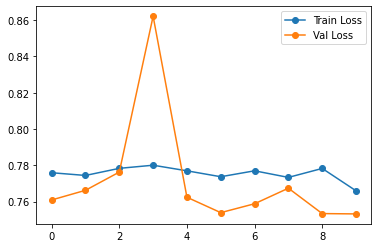

In [ ]:
plt.plot(history1.history['loss'], '-o', label='Train Loss')
plt.plot(history1.history['val_loss'], '-o', label = 'Val Loss')
plt.legend()

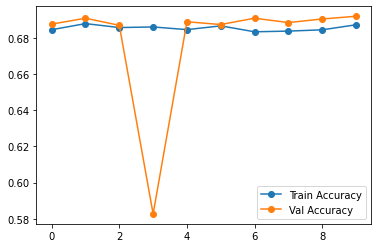

In [ ]:
plt.plot(history1.history['accuracy'], '-o', label='Train Accuracy')
plt.plot(history1.history['val_accuracy'], '-o', label = 'Val Accuracy')
plt.legend()

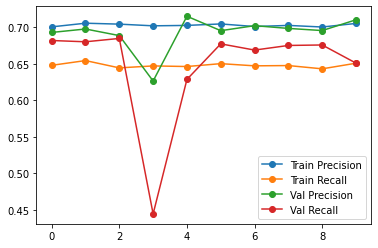

In [ ]:
plt.plot(history1.history['precision'], '-o', label='Train Precision')
plt.plot(history1.history['recall'], '-o', label = 'Train Recall')
plt.plot(history1.history['val_precision'], '-o', label='Val Precision')
plt.plot(history1.history['val_recall'], '-o', label = 'Val Recall')
plt.legend()

#### Evaluation and Analysis

In [ ]:
x_test.shape

(4579,)

In [ ]:
y_pred1 = model.predict(x_test)

In [ ]:
y_pred1[70]

array([0.385416  , 0.04853805, 0.56604594], dtype=float32)

In [ ]:
y_pred1.shape

(4579, 3)

In [ ]:
review_predictions1 = []
i = -1
for prediction in y_pred1:
    i = i + 1
    x = prediction
    review_predictions1.append(np.argmax(x))
    if i == 70:
        print(np.argmax(x))

review_predictions1 = np.array(review_predictions1)
review_predictions1.reshape(1,-1)
review_predictions1.shape

2


(4579,)

In [ ]:
review_predictions1

array([0, 0, 0, ..., 0, 0, 0])

In [ ]:
k = pd.DataFrame(review_predictions1, columns = ['Label'])
k.groupby('Label')['Label'].count()

Label
0    4358
1      15
2     206
Name: Label, dtype: int64

In [ ]:
review_predictions1.shape

(4579,)

In [ ]:
y_test_text.shape

(4579,)

In [ ]:
#type(y_test_text)
review_predictions1

array([0, 0, 0, ..., 0, 0, 0])

In [ ]:
#lb.classes_

In [ ]:
#y_test_text

In [ ]:
text_label = pd.Series(lb.inverse_transform(y_test_text))
integer_label = pd.Series(y_test_text)

In [ ]:
integer_label = integer_label.reset_index(drop = True)
#integer_label[0:20]

In [ ]:
#text_label[0:20]

In [ ]:
def make_confusion_matrix(cf,group_names=None,categories='auto',count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    '''
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html
                   
    title:         Title for the heatmap. Default is None.
    '''


    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)
    
    if title:
        plt.title(title)

In [ ]:
df2oftype1.head()
uniqueClassesMaslowLabel1 = list(df2oftype1['maslow'].unique())
uniqueClassesMaslow1 = list(df2oftype1['maslowLabel'].unique())
uniqueClassesMaslowLabel1 = ['deficiency_needs','growth_needs','none']
uniqueClassesMaslow1 = [0,1,2]
print(uniqueClassesMaslowLabel1)
print(uniqueClassesMaslow1)
print(classification_report(review_predictions1, y_test_text,target_names = ['deficiency_needs','growth_needs','none']))

['deficiency_needs', 'growth_needs', 'none']
[0, 1, 2]
                  precision    recall  f1-score   support

deficiency_needs       0.97      0.70      0.81      4358
    growth_needs       0.02      0.53      0.03        15
            none       0.11      0.52      0.18       206

        accuracy                           0.69      4579
       macro avg       0.37      0.59      0.34      4579
    weighted avg       0.93      0.69      0.78      4579



[[3053  444  861]
 [   7    8    0]
 [  78   20  108]]


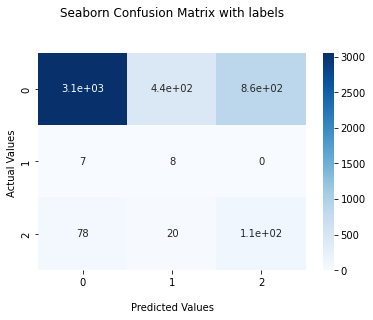

In [ ]:
import seaborn as sns
r1 = sklearn.metrics.confusion_matrix(review_predictions1, y_test_text)
print(r1)
ax = sns.heatmap(r1, annot=True, cmap='Blues')

ax.set_title('Seaborn Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ');

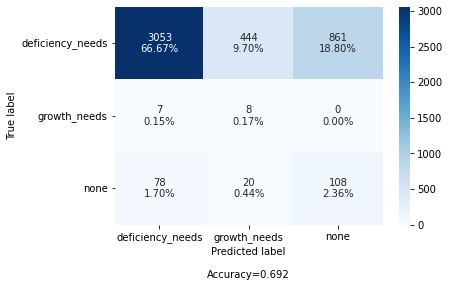

In [ ]:
make_confusion_matrix(r1, group_names=uniqueClassesMaslow1, categories=uniqueClassesMaslowLabel1, cmap='Blues')

In [ ]:
x_test_text = x_test_text.reset_index(drop = True)
x_test_text[0:5]

0    Jenny wanted her nails done.She asked her frie...
1    When I was a kid I wanted nothing more than to...
2    Solomon loved fast food.He found that it was a...
3    Joey and his daughter lived in a mobile home i...
4    Jasmine thinks the fish is disgusting.The rust...
Name: sentence, dtype: object

In [ ]:
y_test

array([[1., 0., 0.],
       [0., 1., 0.],
       [1., 0., 0.],
       ...,
       [1., 0., 0.],
       [0., 0., 1.],
       [1., 0., 0.]], dtype=float32)

In [ ]:
count = 0
for i in range(0,len(review_predictions1)):
    if review_predictions1[i] != 0 and integer_label[i] == 0 and count != 10:
        print(x_test_text[i])
        count = count + 1

Gordo hates the idea of having to give a presentation.Gordo begins drinking due to stress.Gordo loses self confidence.
Jolene found a little turtle in her garden.She brought it home and put it in the sink.When her husband came home, he was startled.
Lester notices that his feet are beginning to hurt.
The father dropped his kids off on the side on the street.They crawled to a box.
Dave was driving home on a busy highway.He was just putting along, until he saw the car in front of him brake.They braked suddenly and he was not prepared.He violently swerved, and came within inches of a near car.
Mariana was stranded on an island.She had long exhausted her supplies.
Eliza had just gone into labor.
Briana took out her curling iron.She pressed hard on the edges of her hair.The iron burned her her.
Donna was walking through the park when something caught her eye.
Renault stopped purchasing metal.The metal market in their country become worse.Traders felt eager to sell their shares.A panic fell 

#### Uniform Model Bert for Type 2

In [ ]:
df2oftype2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 22893 entries, 4741 to 12225
Data columns (total 3 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   sentence     22893 non-null  object
 1   maslow       22893 non-null  object
 2   maslowLabel  22893 non-null  int64 
dtypes: int64(1), object(2)
memory usage: 715.4+ KB


In [ ]:
df2oftype2.head()

,sentence,maslow,maslowLabel
4741,Trent has a brand-new tent for his birthday.,none,2
2037,Tom entered his dog into a dog show.,advanced_needs,0
4456,A man whistled a piece of jaunty on a subway c...,none,2
12860,Ava was at a slumber party.The kids started pl...,basic_needs,1
3250,Kevin had a classic 1969 convertible that need...,none,2


In [ ]:
bert_preprocess = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_preprocess/3")
bert_encoder = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4")

In [ ]:
text_input = tf.keras.layers.Input(shape=(), dtype=tf.string, name='text')
preprocessed_text = bert_preprocess(text_input)
outputs = bert_encoder(preprocessed_text)
l = tf.keras.layers.Dropout(0.1, name="dropout")(outputs['pooled_output'])
l = tf.keras.layers.Dense(3, activation='softmax', name="output")(l)

In [ ]:
model = tf.keras.Model(inputs=[text_input], outputs = [l])

In [ ]:
METRICS = [
      keras.metrics.TruePositives(name='tp'),
      keras.metrics.FalsePositives(name='fp'),
      keras.metrics.TrueNegatives(name='tn'),
      keras.metrics.FalseNegatives(name='fn'), 
      keras.metrics.CategoricalCrossentropy(name='categorical_cross_entropy'),
      keras.metrics.Precision(name='precision'),
      keras.metrics.Recall(name='recall'),
      keras.metrics.AUC(name='auc'),
      keras.metrics.AUC(name='prc', curve='PR'), # precision-recall curve
      'accuracy'
]
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=METRICS)
x_train, x_test, y_train, y_test = train_test_split(df2oftype2['sentence'],df2oftype2['maslowLabel'],test_size = 0.2, random_state = 0, stratify = df2oftype2['maslowLabel'])
#x_train, x_val,y_train, y_val = train_test_split(x_train, y_train, test_size = 0.2,random_state = 0, stratify = y_train)
x_train_text = x_train 
x_test_text = x_test
y_train_text = y_train
y_test_text = y_test
print(x_train.shape)
print(x_test.shape)
#print(x_val.shape)

(18314,)
(4579,)


In [ ]:
unique, counts = np.unique(y_train, return_counts=True)
result = np.column_stack((unique, counts)) 
print (result)

[[   0 6038]
 [   1 8402]
 [   2 3874]]


In [ ]:
unique, counts = np.unique(y_test, return_counts=True)
result = np.column_stack((unique, counts)) 
print (result)

[[   0 1509]
 [   1 2101]
 [   2  969]]


In [ ]:
#y_val = to_categorical(y_val)
y_train = to_categorical(y_train)
y_test =  to_categorical(y_test)

In [ ]:
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  1


In [ ]:
checkpoint_filepath = '/tmp/checkpoint'
model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_filepath,
    save_weights_only=True,
    monitor='val_accuracy',
    mode='max',
    save_best_only=True)

# Model weights are saved at the end of every epoch, if it's the best seen
# so far.
history1 = model.fit(x_train, y_train,epochs=20, verbose=1, validation_data = (x_test,y_test),callbacks=[model_checkpoint_callback])

Epoch 1/20
573/573 [==============================] - 253s 414ms/step - loss: 1.0666 - tp: 4550.0000 - fp: 4448.0000 - tn: 32180.0000 - fn: 13764.0000 - categorical_cross_entropy: 1.0666 - precision: 0.5057 - recall: 0.2484 - auc: 0.6351 - prc: 0.4554 - accuracy: 0.4608 - val_loss: 0.9910 - val_tp: 1279.0000 - val_fp: 811.0000 - val_tn: 8347.0000 - val_fn: 3300.0000 - val_categorical_cross_entropy: 0.9910 - val_precision: 0.6120 - val_recall: 0.2793 - val_auc: 0.6982 - val_prc: 0.5349 - val_accuracy: 0.5106
Epoch 2/20
573/573 [==============================] - 247s 430ms/step - loss: 1.0276 - tp: 5466.0000 - fp: 4517.0000 - tn: 32111.0000 - fn: 12848.0000 - categorical_cross_entropy: 1.0276 - precision: 0.5475 - recall: 0.2985 - auc: 0.6698 - prc: 0.4944 - accuracy: 0.4897 - val_loss: 1.0095 - val_tp: 1526.0000 - val_fp: 1174.0000 - val_tn: 7984.0000 - val_fn: 3053.0000 - val_categorical_cross_entropy: 1.0095 - val_precision: 0.5652 - val_recall: 0.3333 - val_auc: 0.6852 - val_prc: 0.5

In [ ]:
model.load_weights(checkpoint_filepath)
model.evaluate(x_test, y_test)

144/144 [==============================] - 48s 336ms/step - loss: 0.9194 - tp: 1805.0000 - fp: 885.0000 - tn: 8273.0000 - fn: 2774.0000 - categorical_cross_entropy: 0.9194 - precision: 0.6710 - recall: 0.3942 - auc: 0.7563 - prc: 0.6129 - accuracy: 0.5840


[0.919438898563385,
 1805.0,
 885.0,
 8273.0,
 2774.0,
 0.919438898563385,
 0.6710036993026733,
 0.39419087767601013,
 0.7562641501426697,
 0.6129021644592285,
 0.583970308303833]

In [ ]:
print(history1.history.keys())

dict_keys(['loss', 'tp', 'fp', 'tn', 'fn', 'categorical_cross_entropy', 'precision', 'recall', 'auc', 'prc', 'accuracy', 'val_loss', 'val_tp', 'val_fp', 'val_tn', 'val_fn', 'val_categorical_cross_entropy', 'val_precision', 'val_recall', 'val_auc', 'val_prc', 'val_accuracy'])


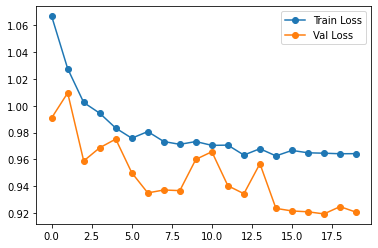

In [ ]:
plt.plot(history1.history['loss'], '-o', label='Train Loss')
plt.plot(history1.history['val_loss'], '-o', label = 'Val Loss')
plt.legend()

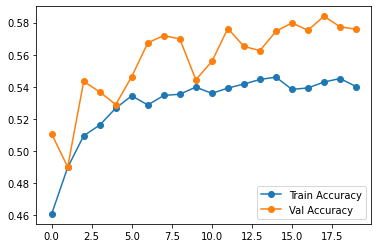

In [ ]:
plt.plot(history1.history['accuracy'], '-o', label='Train Accuracy')
plt.plot(history1.history['val_accuracy'], '-o', label = 'Val Accuracy')
plt.legend()

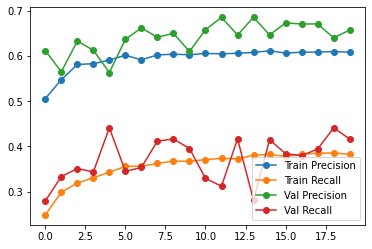

In [ ]:
plt.plot(history1.history['precision'], '-o', label='Train Precision')
plt.plot(history1.history['recall'], '-o', label = 'Train Recall')
plt.plot(history1.history['val_precision'], '-o', label='Val Precision')
plt.plot(history1.history['val_recall'], '-o', label = 'Val Recall')
plt.legend()

#### Evaluation and Analysis

In [ ]:
y_pred2 = model.predict(x_test)

In [ ]:
y_pred2[2]

array([0.20455839, 0.36546507, 0.42997652], dtype=float32)

In [ ]:
review_predictions2 = []
for prediction in y_pred2:
    x = prediction
    review_predictions2.append(np.argmax(x))

review_predictions2 = np.array(review_predictions2)
review_predictions2.reshape(1,-1)
review_predictions2.shape

(4579,)

In [ ]:
review_predictions2

array([1, 1, 2, ..., 1, 1, 1])

In [ ]:
k = pd.DataFrame(review_predictions2, columns = ['Label'])
k.groupby('Label')['Label'].count()

Label
0    1220
1    3005
2     354
Name: Label, dtype: int64

In [ ]:
#type(y_test_text)

In [ ]:
#lb.classes_

In [ ]:
#y_test_text

In [ ]:
text_label = pd.Series(lb.inverse_transform(y_test_text))
integer_label = pd.Series(y_test_text)

In [ ]:
integer_label = integer_label.reset_index(drop = True)
#integer_label[0:20]

In [ ]:
#text_label[0:20]

In [ ]:
def make_confusion_matrix(cf,group_names=None,categories='auto',count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    '''
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html
                   
    title:         Title for the heatmap. Default is None.
    '''


    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = ["{0:.2%}".format(value) for value in cf.flatten()/np.sum(cf)]
    else:
        group_percentages = blanks

    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    plt.figure(figsize=figsize)
    sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)
    
    if title:
        plt.title(title)

In [ ]:
df2oftype2.head()
uniqueClassesMaslowLabel2 = list(df2oftype2['maslow'].unique())
uniqueClassesMaslow2 = list(df2oftype2['maslowLabel'].unique())
uniqueClassesMaslowLabel2 = ['advanced_needs','basic_needs','none']
uniqueClassesMaslow2 = [0,1,2]
print(uniqueClassesMaslowLabel2)
print(uniqueClassesMaslow2)
print(classification_report(review_predictions2, y_test_text,target_names = uniqueClassesMaslowLabel2))

['advanced_needs', 'basic_needs', 'none']
[0, 1, 2]
                precision    recall  f1-score   support

advanced_needs       0.51      0.63      0.56      1220
   basic_needs       0.82      0.58      0.68      3005
          none       0.19      0.51      0.27       354

      accuracy                           0.58      4579
     macro avg       0.51      0.57      0.50      4579
  weighted avg       0.69      0.58      0.61      4579



[[ 764  264  192]
 [ 680 1729  596]
 [  65  108  181]]


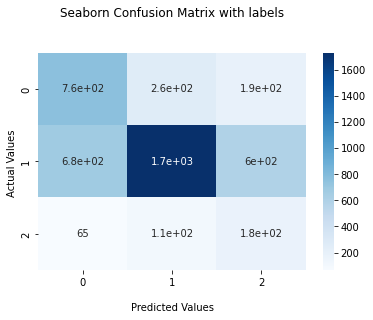

In [ ]:
import seaborn as sns
r2 = sklearn.metrics.confusion_matrix(review_predictions2, y_test_text)
print(r2)
ax = sns.heatmap(r2, annot=True, cmap='Blues')

ax.set_title('Seaborn Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ');

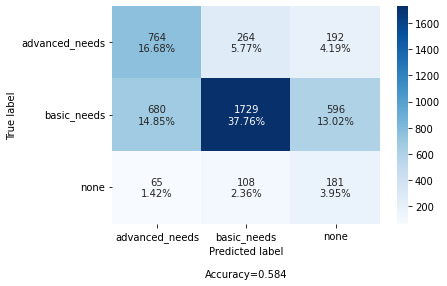

In [ ]:
make_confusion_matrix(r2, group_names=uniqueClassesMaslow2, categories=uniqueClassesMaslowLabel2, cmap='Blues')

In [ ]:
uniqueClassesMaslowLabel2

['advanced_needs', 'basic_needs', 'none']

In [ ]:
uniqueClassesMaslow2

[0, 1, 2]

In [ ]:
x_test_text = x_test_text.reset_index(drop = True)
x_test_text[0:5]

0    Jennie and Tom has been together for five year...
1    I sold books on amazon from 2007 to 2011.One d...
2    Kyle woke up with a very bad cold, the day he ...
3    Sam got a new vacuum sealer.She wanted to try ...
4    Rebecca is playing in a soccer game.She is pla...
Name: sentence, dtype: object

In [ ]:
y_test

array([[0., 1., 0.],
       [0., 1., 0.],
       [1., 0., 0.],
       ...,
       [0., 1., 0.],
       [0., 1., 0.],
       [0., 0., 1.]], dtype=float32)

In [ ]:
count = 0
for i in range(0,len(review_predictions2)):
    if review_predictions2[i] != 0 and integer_label[i] == 0 and count != 10:
        print(x_test_text[i])
        count = count + 1

Kyle woke up with a very bad cold, the day he started his new job.
Jean loved listening to all different kinds of music.She didn't sing or play instruments- she just appreciated sound.
The lawn needed mowed.Candy asked her son to mow the lawn.He whined that he was too busy.Candy grounded her son for one week.
Nicki and her dad always went camping every summer.They loved being outdoors in the wilderness seeing the animals.Nicki became gravely ill before their recent trip.
Yesterday i took my dog to the dog park.My dog loves playing with the dogs there.But this time another dog came and bit my dog.
I loved working on Mechanical Turk.Alas, there was not enough work during Christmas break.Luckily, a natural language processing researched posted lots of work.His work gave me enough money to get through the break.I decided to thank him with a heartfelt thank you note.
A nice man was at the park one day.He noticed a young kid watching the nice man fly his kite.
Rob was really hoping to work o

### Even More Augmentations

#### Testing Augmetations for the Final_data

Base Model(Bert with non uniform classes) Gave: 46.8 % Accuracy

*  62% Precission
* 16%  Recall



In [ ]:
import pandas as pd 
final_data = pd.read_csv('Data.csv')

In [ ]:
#bert_preprocess = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_preprocess/3")
#bert_encoder = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/4")

In [ ]:
#x_train, x_test, y_train, y_test = train_test_split(final_data['sentence'],final_data['maslow'],test_size = 0.2, random_state = 0, stratify = final_data['maslow'])

In [ ]:
#text_input = tf.keras.layers.Input(shape=(), dtype=tf.string, name='text')
#preprocessed_text = bert_preprocess(text_input)
#l = bert_encoder(preprocessed_text)

In [ ]:
#from transformers import pipeline 
#model = pipeline('fill-mask', model = 'bert-base-uncased')
#pred = model('What is [MASK] name?')
#pred

In [ ]:
#from transformers import BertTokenizer, TFBertModel 
#tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
#model = TFBertModel.from_pretrained('bert-base-uncased')
#text = "What is your name?"
#encoded_input = tokenizer(text, return_tensors = 'tf')
#model(encoded_input)

In [ ]:
!pip install textattack

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 415 kB 8.7 MB/s 
     |████████████████████████████████| 101 kB 9.9 MB/s 
     |████████████████████████████████| 60 kB 6.1 MB/s 
     |████████████████████████████████| 769 kB 42.4 MB/s 
     |████████████████████████████████| 3.6 MB 46.8 MB/s 
     |████████████████████████████████| 401 kB 44.5 MB/s 
     |████████████████████████████████| 290 kB 61.4 MB/s 
     |████████████████████████████████| 41.4 MB 1.5 MB/s 
     |████████████████████████████████| 212 kB 22.0 MB/s 
     |████████████████████████████████| 141 kB 44.7 MB/s 
     |████████████████████████████████| 56 kB 4.6 MB/s 
     |████████████████████████████████| 4.4 MB 42.3 MB/s 
     |████████████████████████████████| 4.4 MB 37.0 MB/s 
     |████████████████████████████████| 4.2 MB 34.2 MB/s 
     |████████████████████████████████| 4.2 MB 43.2 MB/s 
     |███████████████████████████████

https://www.analyticsvidhya.com/blog/2022/02/text-data-augmentation-in-natural-language-processing-with-texattack/

In [ ]:
from textattack.augmentation import EmbeddingAugmenter,WordNetAugmenter,EasyDataAugmenter,CharSwapAugmenter,CheckListAugmenter,CLAREAugmenter
#import tensorflow_text
embed_aug = EmbeddingAugmenter()
wordnet_aug = WordNetAugmenter()
easy_aug = EasyDataAugmenter()
charswap_aug = CharSwapAugmenter()
checklist_aug = CheckListAugmenter()
clare_aug = CLAREAugmenter(model='distilroberta-base', tokenizer='distilroberta-base')  # CLARE builds on a pre-trained masked language model and modifies the inputs in a contextaware manner. 

[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!
If you want to use `RobertaLMHeadModel` as a standalone, add `is_decoder=True.`


In [ ]:
text = "A boy pick up a rock at the beach.He felt the texture and inspected it for smoothness"
print(text)
print(embed_aug.augment(text))    #  augments text by replacing words with neighbors in the counter-fitted embedding space ensure their 
                                  # cosine similarity is at least 0.8.
print(wordnet_aug.augment(text))  # augments text by replacing words with synonyms provided by WordNet.
print(easy_aug.augment(text))     # augments text with a combination of word insertions, substitutions, and deletions.
print(charswap_aug.augment(text)) # augments text by substituting, deleting, inserting, and swapping adjacent characters
print(checklist_aug.augment(text)) # augments text by contraction/extension and by substituting names, locations and numbers.
#print(clare_aug.augment(text))     # augments text by replacing, inserting, and merging with a pre-trained masked language model.

A boy pick up a rock at the beach.He felt the texture and inspected it for smoothness
['A boy pick up a rock at the beach.He felt the texture and inspected it for sweetness']
['A boy filling up a rock at the beach.He felt the texture and inspected it for smoothness']
['A boy pick up a rock at the beach.He felt the and inspected it for smoothness', 'A boy pick son up a rock at the beach.He felt the texture and inspected it for smoothness', 'A boy woof up a rock at the beach.He felt the texture and inspected it for smoothness', 'beach boy pick up a rock at the A.He felt the texture and inspected it for smoothness']
['A boy pick up a ock at the beach.He felt the texture and inspected it for smoothness']
['A boy pick up a rock at the beach.He felt the texture and inspected it for smoothness']


In [ ]:
final_data.iloc[88][0]

'Every Sunday I get pizza.This Sunday I decided to try a new place.'

In [ ]:
text = "A monkey watched a crowd of children walk past his cage."
print(text)
print(embed_aug.augment(text))    
print(wordnet_aug.augment(text))  
print(easy_aug.augment(text))     
print(charswap_aug.augment(text)) 
print(checklist_aug.augment(text)) 
#print(clare_aug.augment(text))

A monkey watched a crowd of children walk past his cage.
['A ape watched a crowd of children walk past his cage.']
['A rapscallion watched a crowd of children walk past his cage.']
['A monkey watched a crowd of children walk past cage.', 'A monkey walk a crowd of children watched past his cage.', 'A monkey see a crowd of children walk past his cage.', 'A monkey watched a crowd of axerophthol children walk past his cage.']
['A monkey watched a crowd of children walk past his cag.']
['A monkey watched a crowd of children walk past his cage.']


In [ ]:
text = 'Yoshio was 31 years old and played modern video games.One day he had a hankering to play the old classic Nintendo.'
print(text)
print(embed_aug.augment(text))    
print(wordnet_aug.augment(text))  
print(easy_aug.augment(text))     
print(charswap_aug.augment(text)) 
print(checklist_aug.augment(text)) 
print(clare_aug.augment(text))

Yoshio was 31 years old and played modern video games.One day he had a hankering to play the old classic Nintendo.
['Yoshio was 31 years old and played modern video games.One day he had a hankering to play the former typical Nintendo.']
['Yoshio was 31 years honest-to-goodness and played modern video games.One day he had a hankering to spiel the old classic Nintendo.']
['Yoshio was 31 years old and played modern video games.One day he had He a hankering to play the old classic Nintendo.', 'Yoshio was 31 years old and played modern video games.One Day he had a hankering to meet the old classic Nintendo.', 'Yoshio was 31 years old and played to video games.One day he had a hankering modern play the old classic Nintendo.', 'Yoshio was 31 years old and played modern games.One day he had hankering to play the old classic Nintendo.']
['Yohsio was 31 years old and played modern video games.jne day he had a hankering to play the old classic Nintendo.']
['Melanee was 49 years old and played mod

In [ ]:
test = final_data[final_data['maslow'] == 'physiological']
test.shape

(2277, 3)

In [ ]:
test.head()

,sentence,maslow,reiss
0,I began making fish curry for my boyfriend and I.,physiological,food
11,Ray couldn't get an irritating tune out of his...,physiological,rest
12,Ray couldn't get an irritating tune out of his...,physiological,rest
25,Manuel was having a difficult time paying his ...,physiological,none
29,Kija has been researching methods of healthy e...,physiological,food


https://www.analyticsvidhya.com/blog/2021/08/nlpaug-a-python-library-to-augment-your-text-data/

In [ ]:
!pip install nlpaug

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 410 kB 25.9 MB/s 


In [ ]:
import os
os.environ["MODEL_DIR"] = '../model'

In [ ]:
import nlpaug.augmenter.char as nac
import nlpaug.augmenter.word as naw
import nlpaug.augmenter.sentence as nas
import nlpaug.flow as nafc

from nlpaug.util import Action

/usr/local/lib/python3.7/dist-packages/resampy/interpn.py:114: NumbaWarning: The TBB threading layer requires TBB version 2019.5 or later i.e., TBB_INTERFACE_VERSION >= 11005. Found TBB_INTERFACE_VERSION = 9107. The TBB threading layer is disabled.
  _resample_loop_p(x, t_out, interp_win, interp_delta, num_table, scale, y)


In [ ]:
test_sentence = 'A boy pick up a rock at the beach.He felt the texture and inspected it for smoothness'

In [ ]:
aug = naw.ContextualWordEmbsAug(
    model_path='bert-base-uncased', action="insert")
augmented_text = aug.augment(test_sentence)
print("Original:")
print(test_sentence)
print("Augmented Text:")
print(augmented_text)

Original:
A boy pick up a rock at the beach.He felt the texture and inspected it for smoothness
Augmented Text:
['a boy pick it up on a rock at the beach. then he easily felt the texture texture and inspected towards it for smoothness']


In [ ]:
test_sentence = test.iloc[0][0]
aug = naw.ContextualWordEmbsAug(
    model_path='roberta-base', action="substitute")
augmented_text = aug.augment(test_sentence)
print("Original:")
print(test_sentence)
print("Augmented Text:")
print(augmented_text)

Original:
I began making fish curry for my boyfriend and I.
Augmented Text:
['I learned making fish scales through my boyfriend Ben I.']


In [ ]:
test_sentence = test.iloc[0][0]
aug = naw.SynonymAug(aug_src='wordnet')
augmented_text = aug.augment(test_sentence)
print("Original:")
print(test_sentence)
print("Augmented Text:")
print(augmented_text)

Original:
I began making fish curry for my boyfriend and I.
Augmented Text:
['I began making fish curry for my fellow and One.']


https://github.com/makcedward/nlpaug/blob/master/example/textual_augmenter.ipynb

https://github.com/makcedward/nlpaug#augmenter

https://pypi.org/project/nlpaug/

https://www.analyticsvidhya.com/blog/2021/08/nlpaug-a-python-library-to-augment-your-text-data/

https://www.analyticsvidhya.com/blog/2022/02/text-data-augmentation-in-natural-language-processing-with-texattack/

https://textattack.readthedocs.io/en/latest/apidoc/textattack.augmentation.html

#### Augmentation for any type of Maslow Category Ready

https://huggingface.co/Helsinki-NLP

In [ ]:
!pip install transformers
!pip install sentencepiece
from transformers import MarianMTModel, MarianTokenizer

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 4.7 MB 8.3 MB/s 
     |████████████████████████████████| 101 kB 10.4 MB/s 
     |████████████████████████████████| 6.6 MB 36.8 MB/s 
     |████████████████████████████████| 596 kB 58.1 MB/s 
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.2 MB 8.3 MB/s 


In [ ]:
from sklearn.utils import shuffle

In [ ]:
final_data = pd.read_csv('Data.csv')
final_data.head()

,sentence,maslow,reiss
0,I began making fish curry for my boyfriend and I.,physiological,food
1,I began making fish curry for my boyfriend and...,spiritual growth,indep
2,I began making fish curry for my boyfriend and...,esteem,competition
3,I began making fish curry for my boyfriend and...,spiritual growth,health
4,I began making fish curry for my boyfriend and...,none,none


In [ ]:
# Get the name of the first model
first_model_name = 'Helsinki-NLP/opus-mt-en-es'

# Get the tokenizer
first_model_tkn = MarianTokenizer.from_pretrained(first_model_name)

# Load the pretrained model based on the name
first_model = MarianMTModel.from_pretrained(first_model_name)

/usr/local/lib/python3.7/dist-packages/transformers/models/marian/tokenization_marian.py:198: UserWarning: Recommended: pip install sacremoses.
  warnings.warn("Recommended: pip install sacremoses.")


In [ ]:
# Get the name of the second model
second_model_name = 'Helsinki-NLP/opus-mt-es-en'

# Get the tokenizer
second_model_tkn = MarianTokenizer.from_pretrained(second_model_name)

# Load the pretrained model based on the name
second_model = MarianMTModel.from_pretrained(second_model_name)

/usr/local/lib/python3.7/dist-packages/transformers/models/marian/tokenization_marian.py:198: UserWarning: Recommended: pip install sacremoses.
  warnings.warn("Recommended: pip install sacremoses.")


In [ ]:
sentences = []
for i in range(final_data.shape[0]):
    sentences.append(final_data.iloc[i][0])
len(sentences)

20593

In [ ]:
final_data[['maslow','sentence']].groupby(['maslow']).count()

,sentence
maslow,
esteem,5187
love,4502
none,2543
physiological,2277
spiritual growth,2360
stability,3724


In [ ]:
print(final_data[['maslow','sentence']].groupby(['maslow']).count().max()[0])

5187


In [ ]:
dataframes = []
over_sampling_number =  final_data[['maslow','sentence']].groupby(['maslow']).count().max()[0]
unique_maslow_list = list(final_data['maslow'].unique())
for i in range(len(unique_maslow_list)):
    filter = final_data['maslow'] == unique_maslow_list[i]
    dataframe = final_data[filter]
    print(dataframe['maslow'].unique(),dataframe.shape[0])
    dataframes.append(dataframe)

['physiological'] 2277
['spiritual growth'] 2360
['esteem'] 5187
['none'] 2543
['love'] 4502
['stability'] 3724


In [ ]:
sentences_list = []
for dataframe in dataframes:
    sentences = []
    if dataframe.shape[0] < over_sampling_number:
        dataframe = shuffle(dataframe)
        samples_to_be_taken_for_augmentation = (over_sampling_number - dataframe.shape[0])
        dataframe = dataframe[0:samples_to_be_taken_for_augmentation]
        sentences = list(dataframe['sentence'])
        print(len(sentences),dataframe.shape[0],dataframe['maslow'].unique())
        sentences_list.append(sentences)

2277 2277 ['physiological']
2360 2360 ['spiritual growth']
2543 2543 ['none']
685 685 ['love']
1463 1463 ['stability']


In [ ]:
len(sentences_list)

5

In [ ]:
len(sentences_list[2])

2543

In [ ]:
final_augmented_texts = []

In [ ]:
def format_batch_texts(language_code, batch_texts):
    formated_bach = [">>{}<< {}".format(language_code, text) for text in batch_texts]
    return formated_bach


def perform_translation(batch_texts, model, tokenizer, language="es"):
    # Prepare the text data into appropriate format for the model
    formated_batch_texts = format_batch_texts(language, batch_texts)
    
    # Generate translation using model
    translated = model.generate(**tokenizer(formated_batch_texts, return_tensors="pt", padding=True))

    # Convert the generated tokens indices back into text
    translated_texts = [tokenizer.decode(t, skip_special_tokens=True) for t in translated]
    
    return translated_texts


def combine_texts(original_texts, back_translated_batch):
    return set(original_texts + back_translated_batch) 

def perform_back_translation_with_augmentation(batch_texts, original_language="en", temporary_language="es"):
    # Translate from Original to Temporary Language
    tmp_translated_batch = perform_translation(batch_texts, first_model, first_model_tkn, temporary_language)
    # Translate Back to English
    back_translated_batch = perform_translation(tmp_translated_batch, second_model, second_model_tkn, original_language)
    # Return The Final Result
    return combine_texts(sentences, back_translated_batch)
    
# Execute the function for Data Augmentation


#augmented_sentences = []
#for i in range(len(sentences_list)):
sentences = sentences_list[2]
sentences = sentences[2500:2543]
final_augmented = perform_back_translation_with_augmentation(sentences)
final_augmented = list(final_augmented)
print(len(final_augmented))
final_augmented_texts.extend(final_augmented)
print(len(final_augmented_texts))

/usr/local/lib/python3.7/dist-packages/transformers/generation_utils.py:1207: UserWarning: Neither `max_length` nor `max_new_tokens` have been set, `max_length` will default to 512 (`self.config.max_length`). Controlling `max_length` via the config is deprecated and `max_length` will be removed from the config in v5 of Transformers -- we recommend using `max_new_tokens` to control the maximum length of the generation.
  UserWarning,


83
4724


In [ ]:
category = []
for i in range(len(final_augmented_texts)):
    category.append('none')

In [ ]:
df = pd.DataFrame(list(zip(final_augmented_texts, category)),
               columns =['sentence', 'maslow'])
df.tail()

,sentence,maslow
4719,Ryan cheated on his school essay.,none
4720,A monkey watched a crowd of children pass thro...,none
4721,Tina had an old car.She broke constantly.,none
4722,Zoe always makes good grades.One day she forgo...,none
4723,Terrell considered himself to be a good thief....,none


In [ ]:
df.to_csv('augmented.csv',index = False)
from google.colab import files 
files.download('augmented.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
none_category = final_data[final_data['maslow'] == 'none']
none_category = none_category[['sentence','maslow']]
none_category['original'] = 1
none_category.head()

,sentence,maslow,original
4,I began making fish curry for my boyfriend and...,none,1
9,Ray couldn't get an irritating tune out of his...,none,1
26,Kija has been researching methods of healthy e...,none,1
30,Kija has been researching methods of healthy e...,none,1
31,Billy noticed he had trouble reading the chalk...,none,1


In [ ]:
none_category.shape

(2543, 3)

In [ ]:
none_category_augmented = pd.read_csv('augmented_none.csv')
none_category_augmented['original'] = 0
none_category_augmented.head()

,sentence,maslow,original
0,It was the night of the energy ball.Becky stop...,none,0
1,A band was playing a college graduation.The Tr...,none,0
2,Sam and his friends decided to have a party at...,none,0
3,It was a very cold night.Ida was shivering.She...,none,0
4,Sam and his friends decided to throw a hotel p...,none,0


In [ ]:
none_category_augmented.shape

(4724, 3)

In [ ]:
df = none_category.copy()
df = df.append(none_category_augmented)
df.head()

,sentence,maslow,original
4,I began making fish curry for my boyfriend and...,none,1
9,Ray couldn't get an irritating tune out of his...,none,1
26,Kija has been researching methods of healthy e...,none,1
30,Kija has been researching methods of healthy e...,none,1
31,Billy noticed he had trouble reading the chalk...,none,1


In [ ]:
df.shape

(7267, 3)

In [ ]:
df = df.drop_duplicates(keep='first')

In [ ]:
df = df.reset_index() 
df.drop(columns = ['index'],inplace = True) 
df.head()

,sentence,maslow,original
0,I began making fish curry for my boyfriend and...,none,1
1,Ray couldn't get an irritating tune out of his...,none,1
2,Kija has been researching methods of healthy e...,none,1
3,Kija has been researching methods of healthy e...,none,1
4,Billy noticed he had trouble reading the chalk...,none,1


In [ ]:
df[['original','sentence']].groupby('original').count()

,sentence
original,
0,4723
1,2543


In [ ]:
df1 = df[['sentence','maslow']]

In [ ]:
df1 = df1.drop_duplicates(keep = 'first')

In [ ]:
df1.shape

(4723, 2)

In [ ]:
df1.head()

,sentence,maslow
0,I began making fish curry for my boyfriend and...,none
1,Ray couldn't get an irritating tune out of his...,none
2,Kija has been researching methods of healthy e...,none
3,Kija has been researching methods of healthy e...,none
4,Billy noticed he had trouble reading the chalk...,none


In [ ]:
df1.to_csv('final_none.csv',index = False)
from google.colab import files 
files.download('final_none.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

##### Appending French Augmentation file with Spanish Augmentation file to get new augmentation file

In [ ]:
final_o_f = pd.read_csv('final_none_orig_french.csv')
final_o_s = pd.read_csv('final_none_orig_spanish.csv')
print(final_o_f.shape)
print(final_o_s.shape)

(4843, 2)
(4723, 2)


In [ ]:
df = final_o_f.copy()
df = df.append(final_o_s)
df.head()

,sentence,maslow
0,I began making fish curry for my boyfriend and...,none
1,Ray couldn't get an irritating tune out of his...,none
2,Kija has been researching methods of healthy e...,none
3,Kija has been researching methods of healthy e...,none
4,Billy noticed he had trouble reading the chalk...,none


In [ ]:
df.shape

(9566, 2)

In [ ]:
df1 = df.copy()
df1 = df1.drop_duplicates(keep = 'first')

In [ ]:
df1.shape

(6908, 2)

In [ ]:
df1.to_csv('final_none.csv',index = False)
from google.colab import files 
files.download('final_none.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Other